In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperature
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperature
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperature
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    #print("Agg:")
    agg.columns = names
    #print(type(agg))
    #print(agg)

    #print("Test columns:")
    #print(agg.iloc[:, -36]) # Column containing response actual values (temperature) at time t

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    print(n_vars)
    print(len(data))
    print(type(data))

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    #print("Diff values:")
    #print(len(diff_values))
    #print(len(diff_values[0]))
    #print(len(diff_values_for_training))
    #print(len(diff_values_for_training[0]))
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    #print("Scaled values rows:")
    #print(len(scaled_values))

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        #print("Batch "+str(ws+1)+":")
        #print("Range: "+str(first)+"-"+str(last))
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
        #print("Supervised count:")
        #print(len(supervised_values))
        #print(len(supervised_values[0]))
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    print(n_vars)
    print(len(data))
    print(type(data))

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    #print("Diff values:")
    #print(len(diff_values))
    #print(len(diff_values[0]))
    #print(len(diff_values_for_training))
    #print(len(diff_values_for_training[0]))
    
    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        #print("Batch "+str(ws+1)+":")
        #print("Range: "+str(first)+"-"+str(last))
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
        #print("Supervised count:")
        #print(len(supervised_values))
        #print(len(supervised_values[0]))
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['temperatures'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
    #print("Train_X Fold "+str(i)+":")
    #print(len(train_X[i]))
    #print(len(train_X[i][0]))
    #print(len(train_X[i][0][0])) 
    #print("Train_y Fold "+str(i)+":")
    #print(len(train_y[i]))
    #print(len(train_y[i][0]))
    #print(train_y[i][0][0])
    #print("Validation_X Fold "+str(i)+":")
    #print(len(val_X[i]))
    #print(len(val_X[i][0]))
    #print(len(val_X[i][0][0]))
    #print("Validation_y Fold "+str(i)+":")
    #print(len(val_y[i]))
    #print(len(val_y[i][0]))
    #print(val_y[i][0][0])
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_scaling = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)
    dataset_scaling = list(itertools.chain(*dataset)) # Holds all 84 weather station rows to train the scaling function

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(vl_X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)    
    dataset_testing = list(itertools.chain(*dataset_test)) # Holds remaining 21 weather station rows for testing and validation

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + 12*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]


Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
Fold 1
Fold 2
Fold 3
Fold 4
Fold 5
Fold 1:
12
84
<class 'list'>
12
21
<class 'list'>
(84, 1, 1, 2040)
(11, 1, 1, 2040)
(10, 1, 1, 2040)
(84, 1, 2040)
(11, 1, 2040)
(10, 1, 2040)
(84, 2040)
(11, 2040)
(10, 2040)
[[0.39307412 0.69695044 0.32924264 ... 0.45808019 0.42952612 0.37788578]
 [0.45747266 0.51683609 0.42215989 ... 0.49422843 0.47691373 0.38882139]
 [0.38487242 0.62674714 0.3411641  ... 0.51032807 0.38244228 0.37363305]
 ...
 [0.54100851 0.46473952 0.46949509 ... 0.48025516 0.45504253 0.40583232]
 [0.44896719 0.51620076 0.3997195  ... 0.49696233 0.45170109 0.39611179]
 [0.46780073 0.52414231 0.42356241 ... 0.49301337 0.4881531  0.43772783]]
Fold 2:
12
168
<class 'list'>
12
42
<class 'list'>
(84, 1, 1, 2040)
(11, 1, 1, 2040)
(10, 1, 1, 2040)
(84, 1, 2040)
(11, 1, 2040)
(10, 1, 2040)
(84, 2040)
(11, 2040)
(10, 2040)
[[0.39307412 0

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 2040)
(11, 2040)


[I 2025-05-09 18:17:01,327] A new study created in memory with name: no-name-a67a12c3-e402-4adf-be04-a51655aa91a4


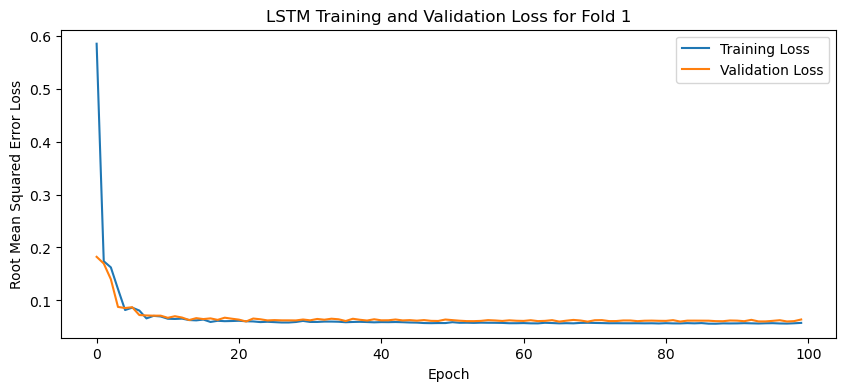

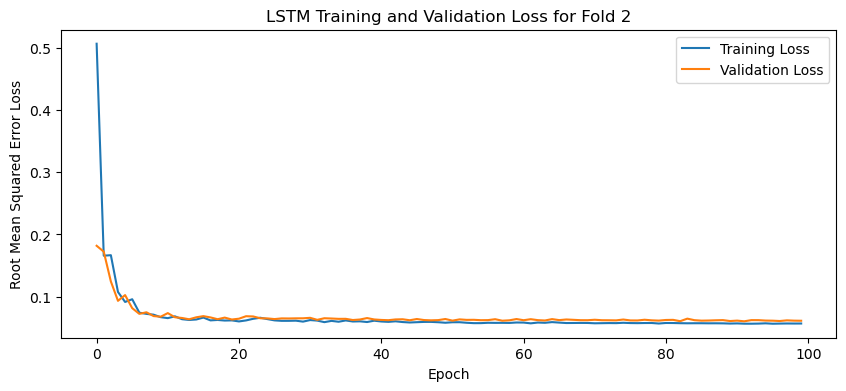

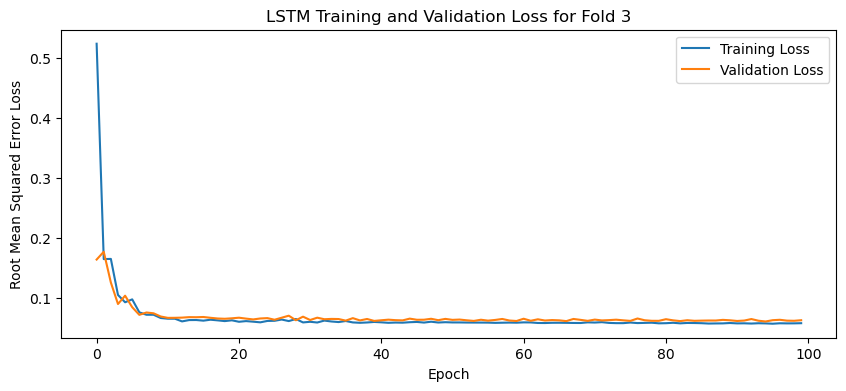

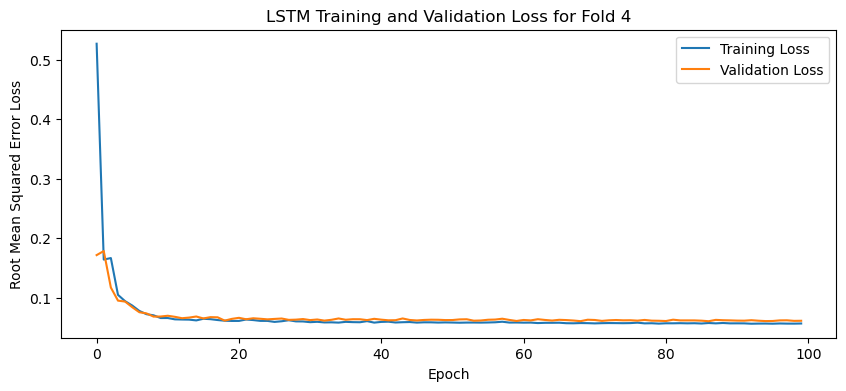

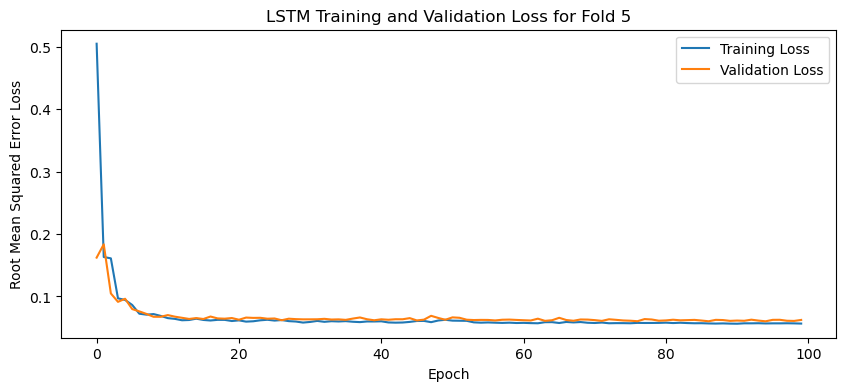

[I 2025-05-09 18:18:24,576] Trial 0 finished with value: 0.0428756020963192 and parameters: {'lr': 0.003099443601693227, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.44188015147480175}. Best is trial 0 with value: 0.0428756020963192.


Cross Validation Accuracies:
[0.04114830493927002, 0.0439470000565052, 0.04348344728350639, 0.04382322356104851, 0.04197603464126587]
Mean Cross Validation Accuracy:
0.0428756020963192
Standard Deviation of Cross Validation Accuracy:
0.0011142829870400418


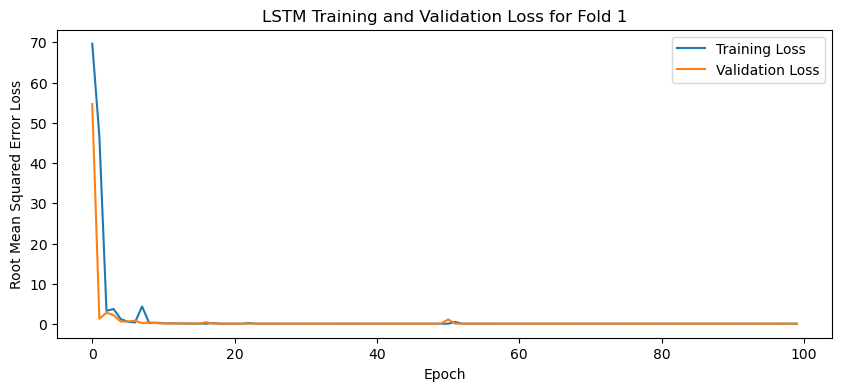

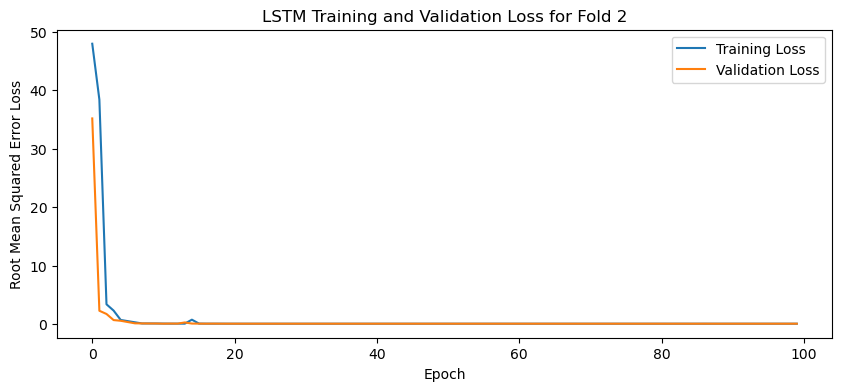

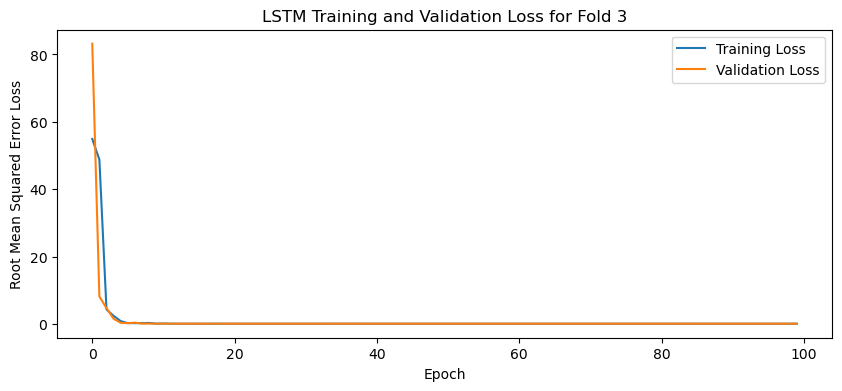

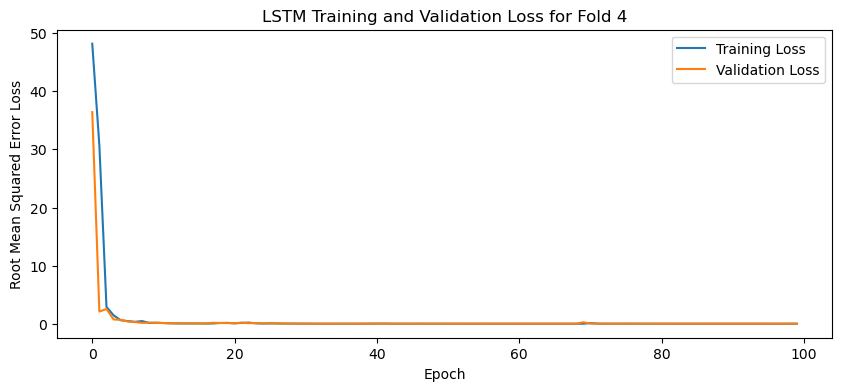

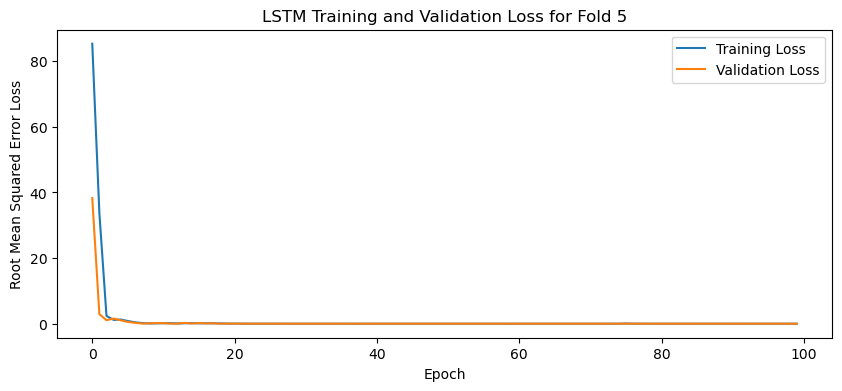

[I 2025-05-09 18:19:59,462] Trial 1 finished with value: 0.04380893334746361 and parameters: {'lr': 0.07841224827079028, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.10352288646226714}. Best is trial 0 with value: 0.0428756020963192.


Cross Validation Accuracies:
[0.04646953567862511, 0.04270849749445915, 0.041676536202430725, 0.044422831386327744, 0.04376726597547531]
Mean Cross Validation Accuracy:
0.04380893334746361
Standard Deviation of Cross Validation Accuracy:
0.0016257606458094426


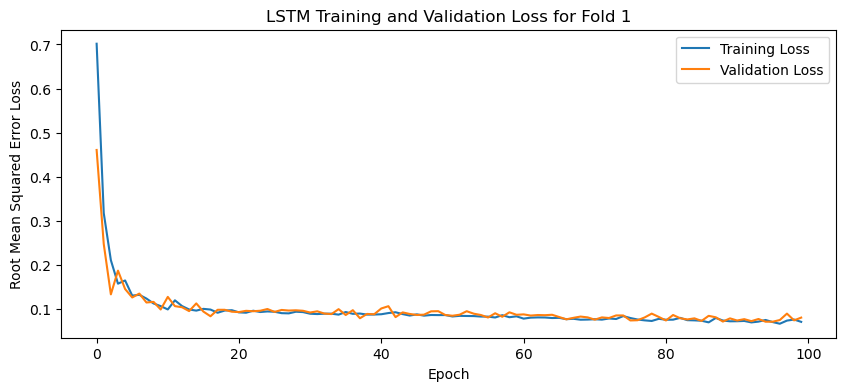

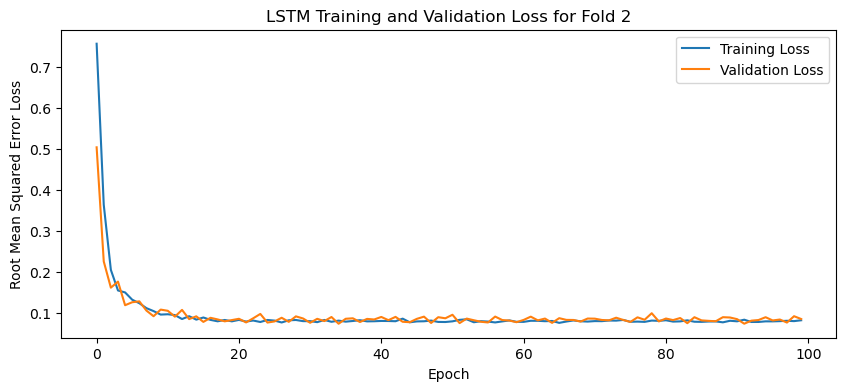

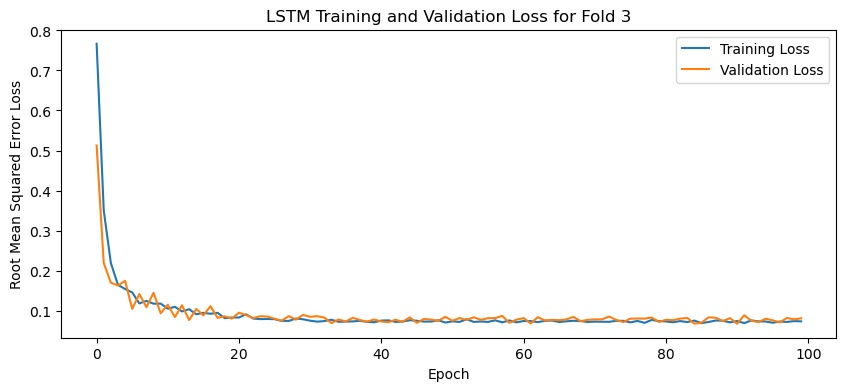

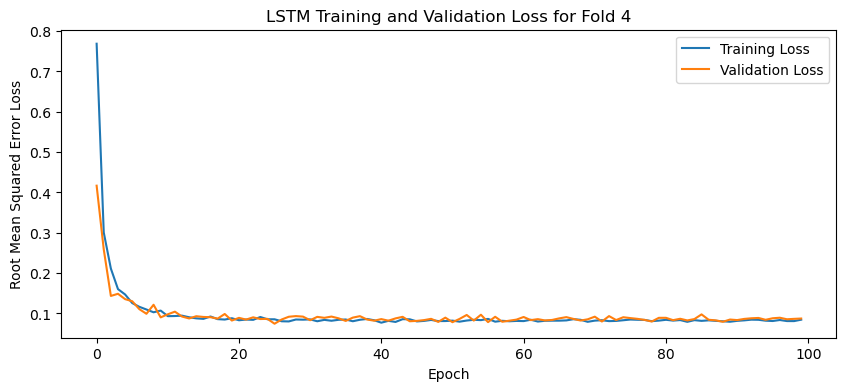

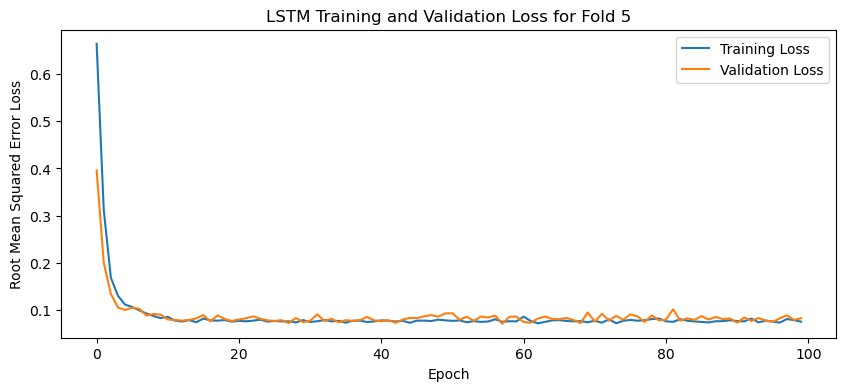

[I 2025-05-09 18:21:55,289] Trial 2 finished with value: 0.07186630591750146 and parameters: {'lr': 0.006690637909708276, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3917052509372745}. Best is trial 0 with value: 0.0428756020963192.


Cross Validation Accuracies:
[0.06690322607755661, 0.08229368180036545, 0.05985772982239723, 0.07870279997587204, 0.07157409191131592]
Mean Cross Validation Accuracy:
0.07186630591750146
Standard Deviation of Cross Validation Accuracy:
0.00805470383276327


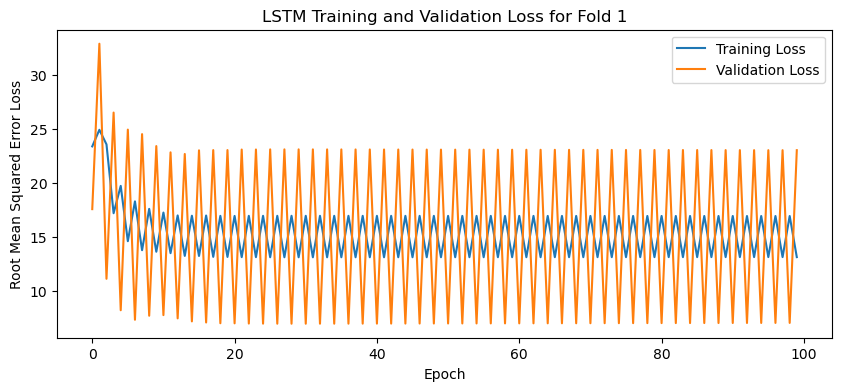

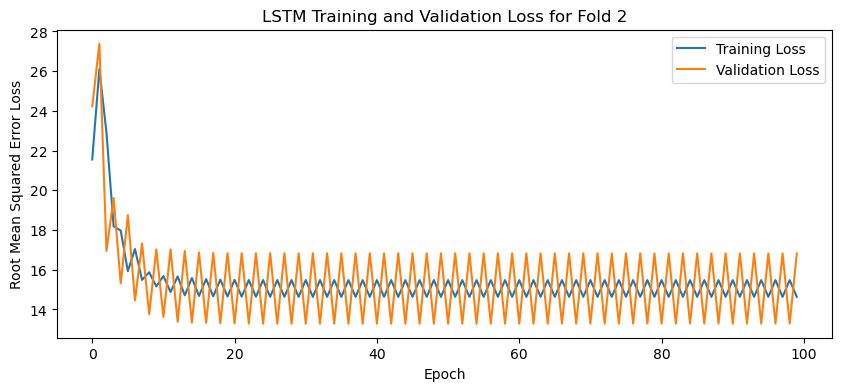

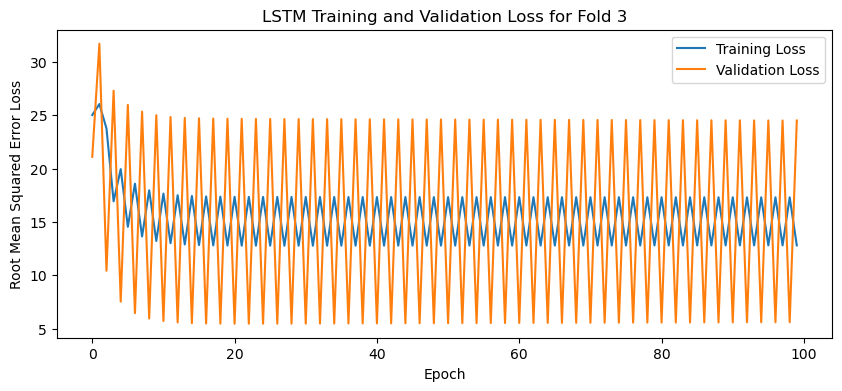

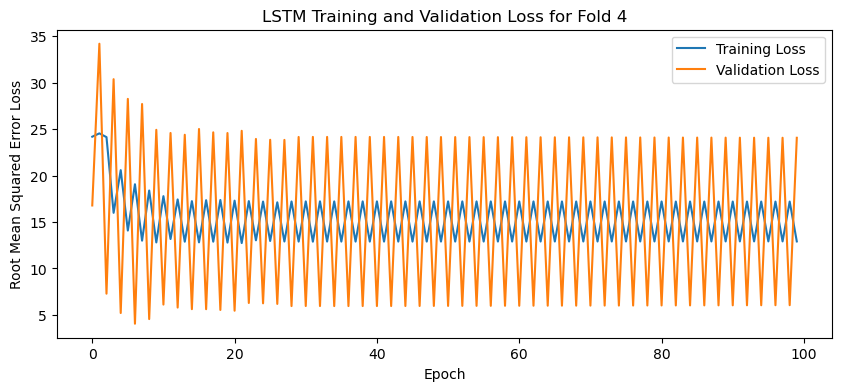

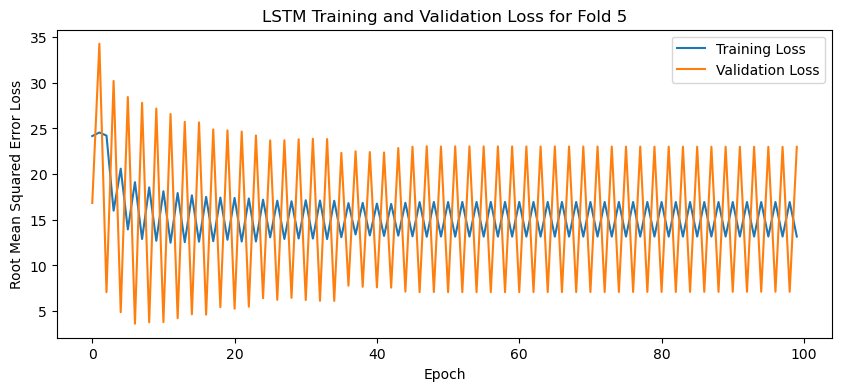

[I 2025-05-09 18:23:40,564] Trial 3 finished with value: 22.283441162109376 and parameters: {'lr': 0.23340853053376498, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.1438779648708581}. Best is trial 0 with value: 0.0428756020963192.


Cross Validation Accuracies:
[23.022031784057617, 16.823719024658203, 24.514875411987305, 24.069114685058594, 22.987464904785156]
Mean Cross Validation Accuracy:
22.283441162109376
Standard Deviation of Cross Validation Accuracy:
2.793480270105577


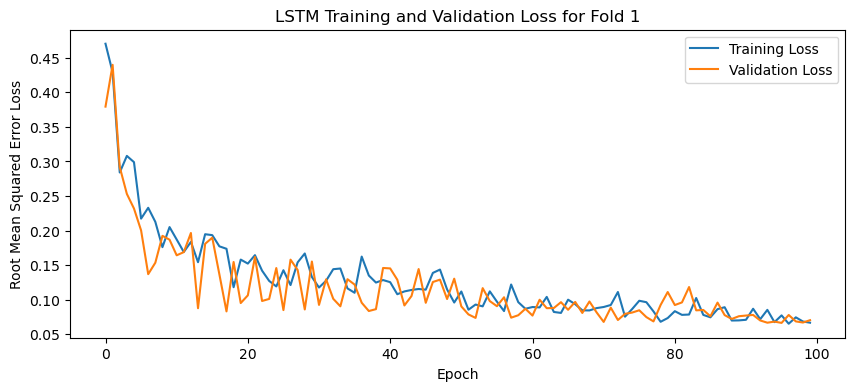

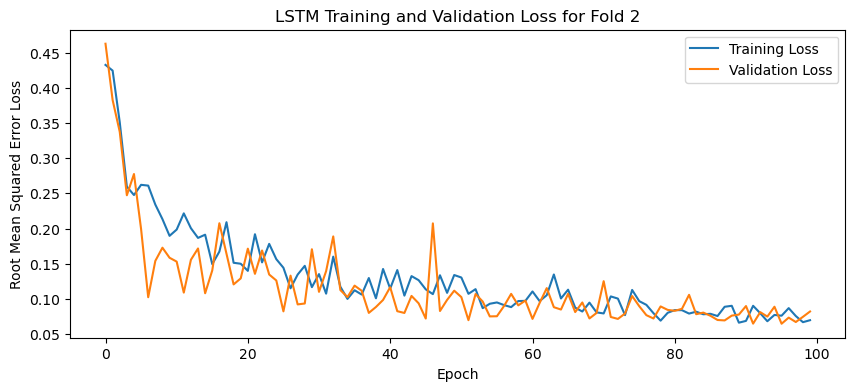

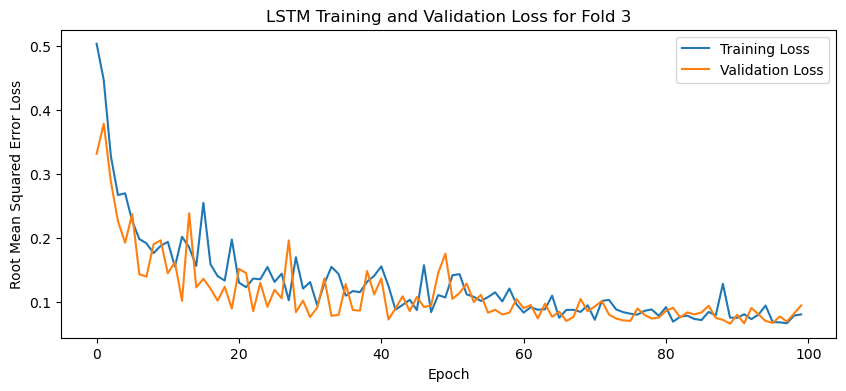

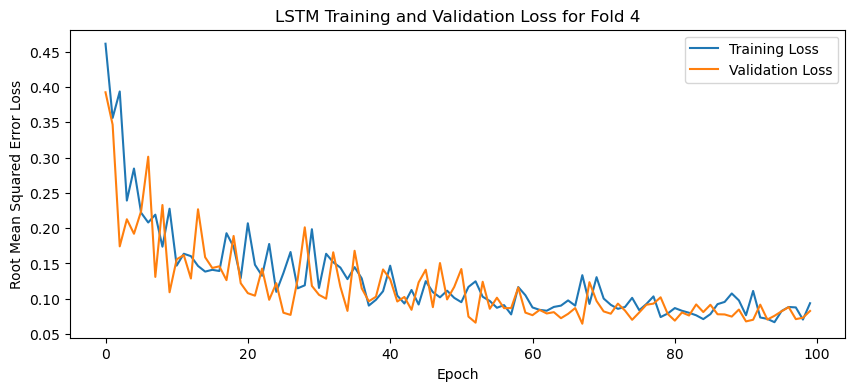

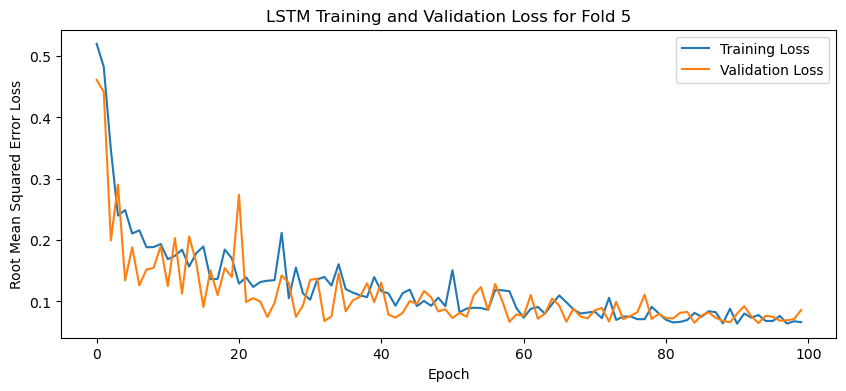

[I 2025-05-09 18:25:15,887] Trial 4 finished with value: 0.07016684487462044 and parameters: {'lr': 0.002103671104382104, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.34699441735711467}. Best is trial 0 with value: 0.0428756020963192.


Cross Validation Accuracies:
[0.05139824375510216, 0.06329332292079926, 0.08073459565639496, 0.07415127009153366, 0.08125679194927216]
Mean Cross Validation Accuracy:
0.07016684487462044
Standard Deviation of Cross Validation Accuracy:
0.011402154349478793


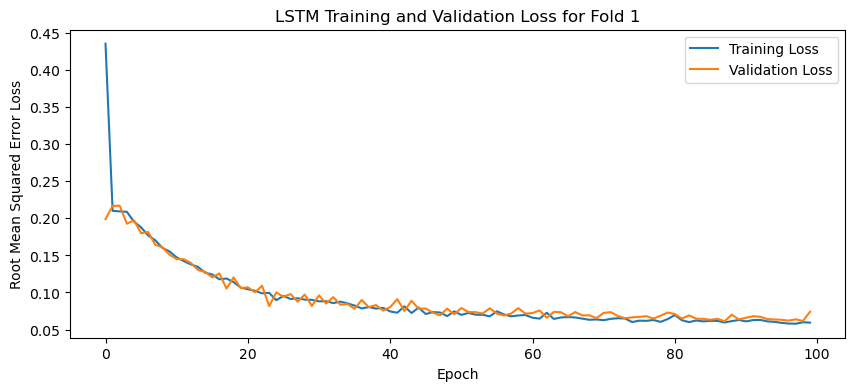

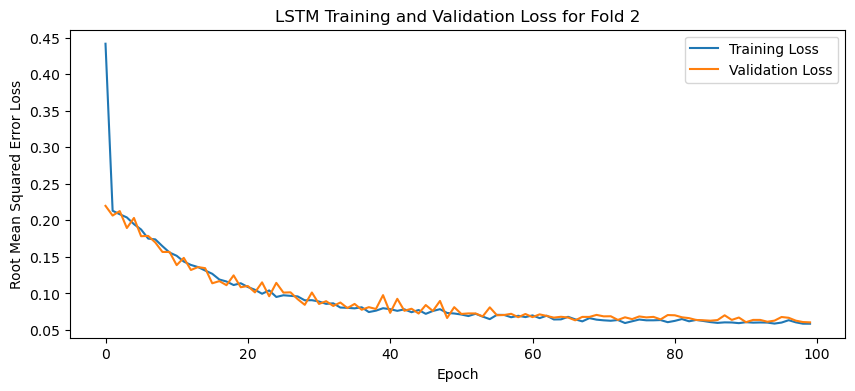

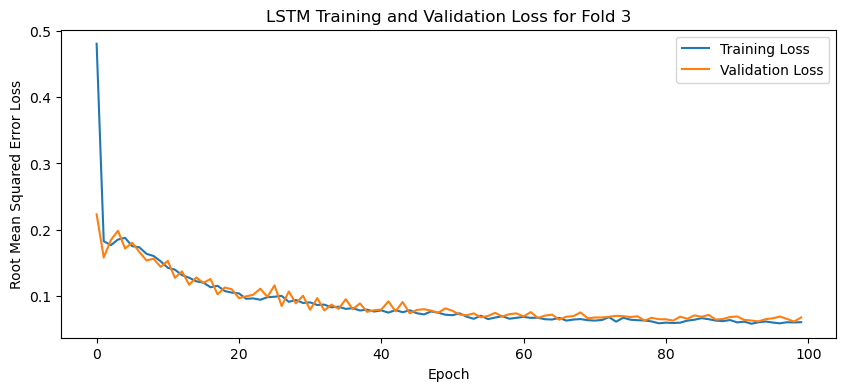

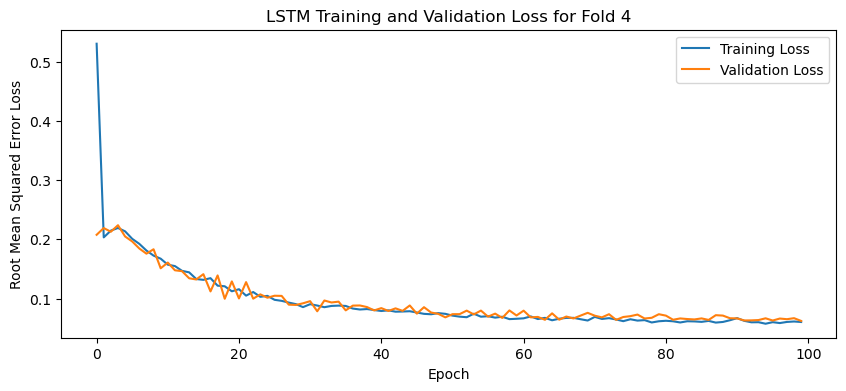

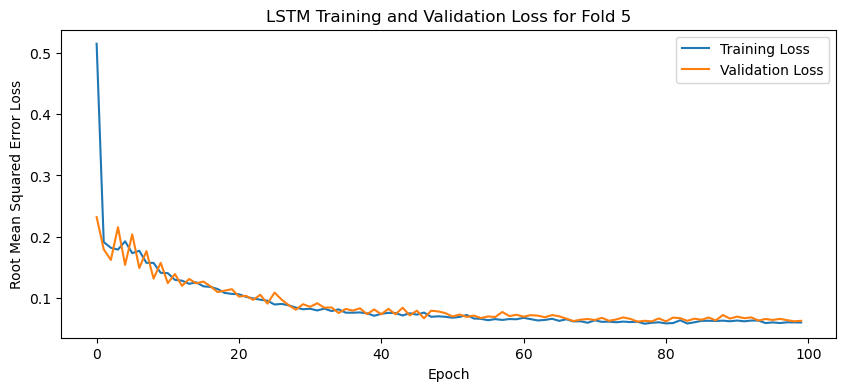

[I 2025-05-09 18:27:14,982] Trial 5 finished with value: 0.04970804452896118 and parameters: {'lr': 0.5994903178935854, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.35514491124226444}. Best is trial 0 with value: 0.0428756020963192.


Cross Validation Accuracies:
[0.04853438958525658, 0.05124938115477562, 0.051342856138944626, 0.05222819745540619, 0.0451853983104229]
Mean Cross Validation Accuracy:
0.04970804452896118
Standard Deviation of Cross Validation Accuracy:
0.0025780338675752087


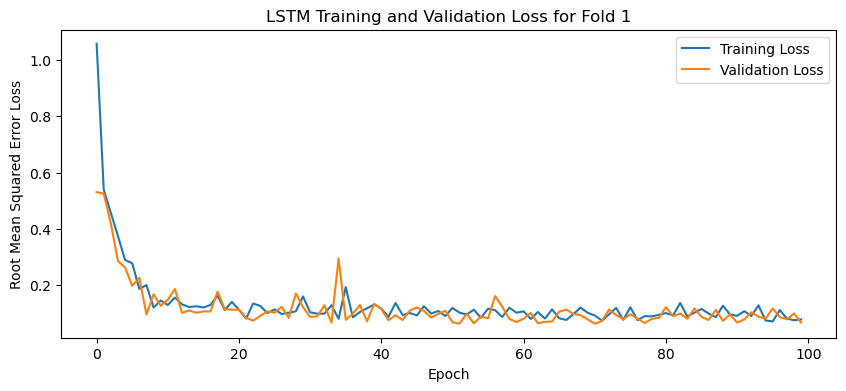

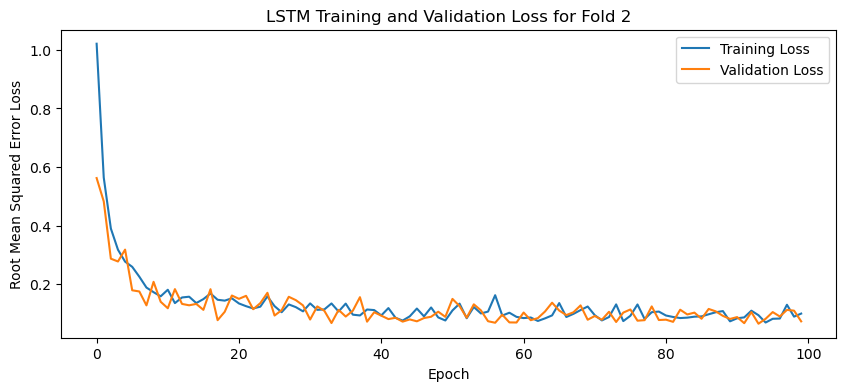

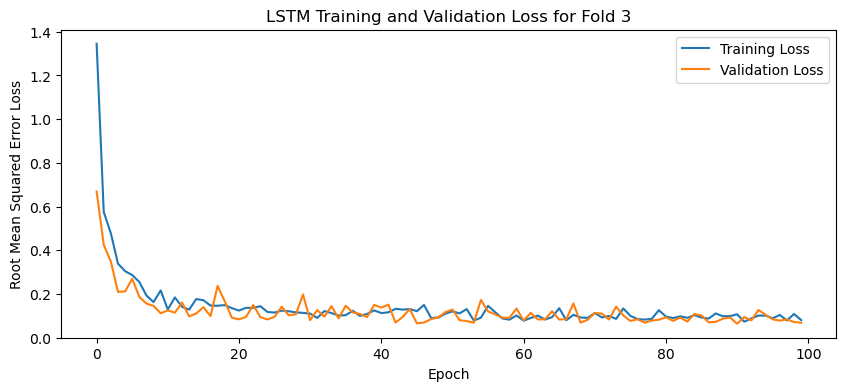

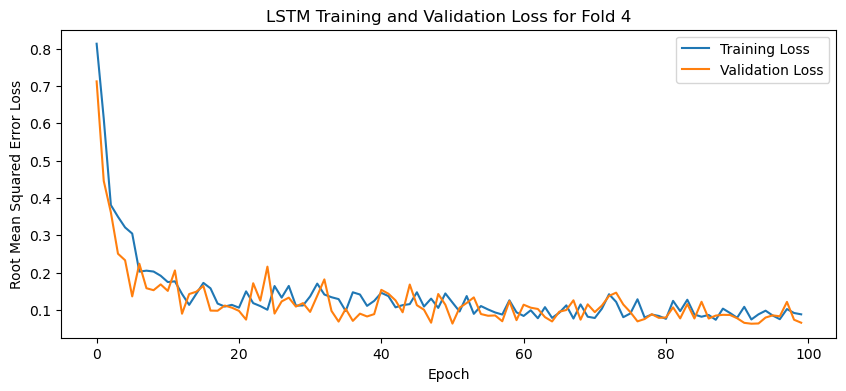

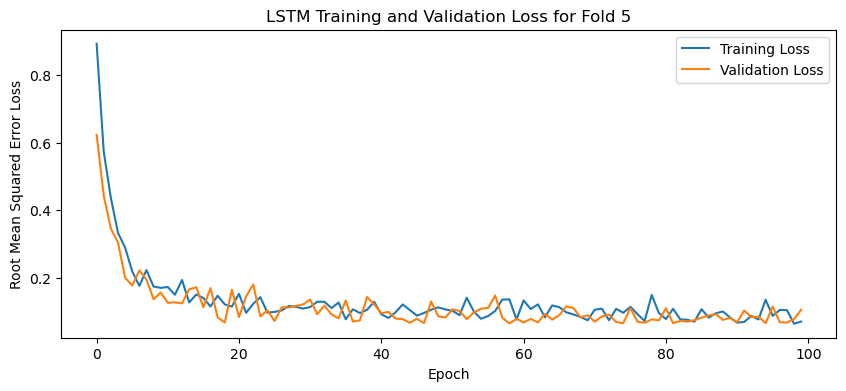

[I 2025-05-09 18:32:02,080] Trial 6 finished with value: 0.06245942637324333 and parameters: {'lr': 0.002901198469516066, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.4219012833817454}. Best is trial 0 with value: 0.0428756020963192.


Cross Validation Accuracies:
[0.050186481326818466, 0.06408078223466873, 0.051292672753334045, 0.05041716992855072, 0.0963200256228447]
Mean Cross Validation Accuracy:
0.06245942637324333
Standard Deviation of Cross Validation Accuracy:
0.0177172598511821


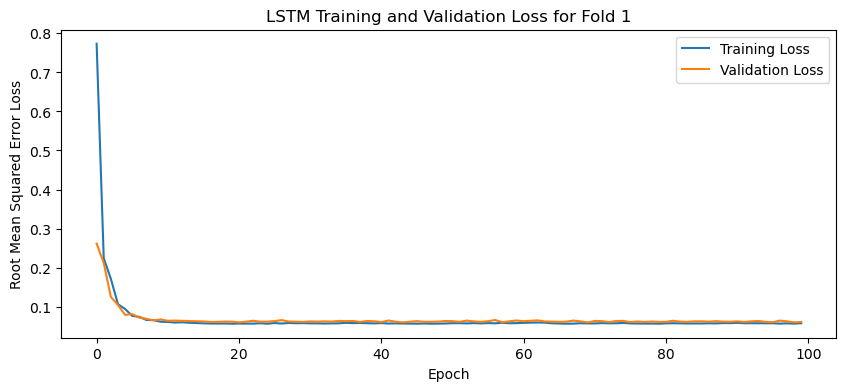

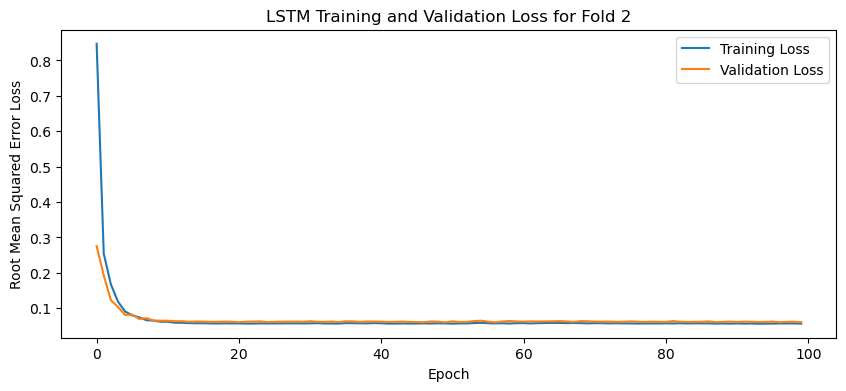

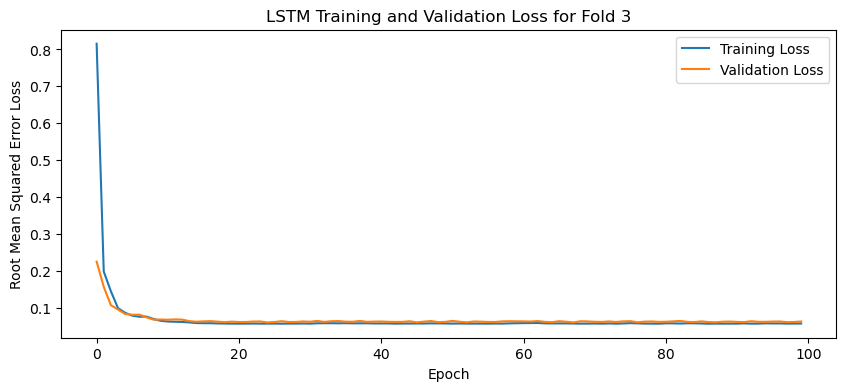

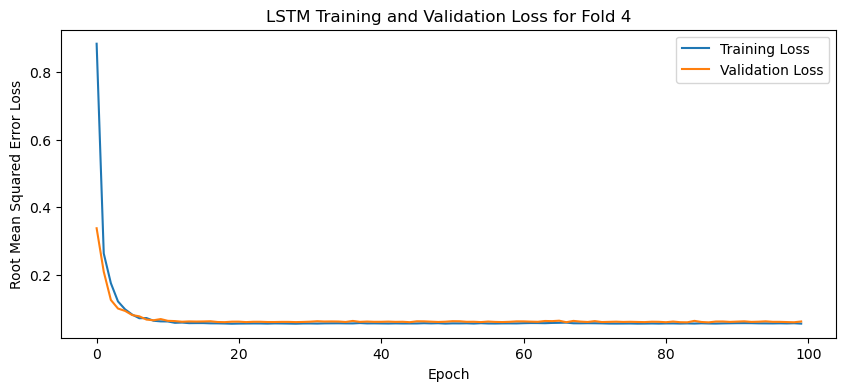

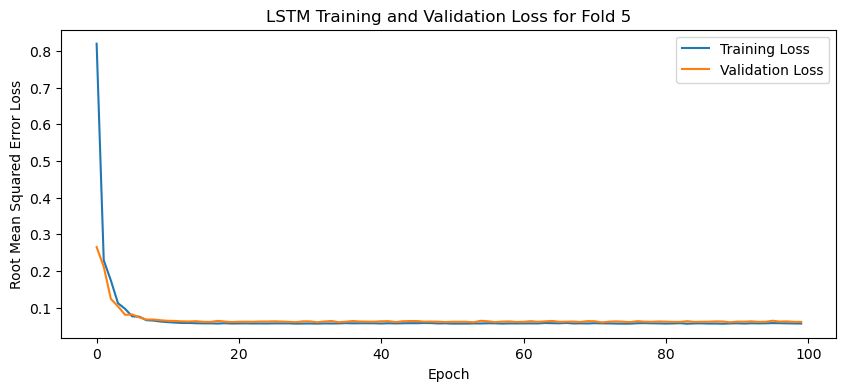

[I 2025-05-09 18:34:09,914] Trial 7 finished with value: 0.04368958845734596 and parameters: {'lr': 0.021598902546370695, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.3334260897965623}. Best is trial 0 with value: 0.0428756020963192.


Cross Validation Accuracies:
[0.044712524861097336, 0.04625805467367172, 0.041938457638025284, 0.0413229800760746, 0.04421592503786087]
Mean Cross Validation Accuracy:
0.04368958845734596
Standard Deviation of Cross Validation Accuracy:
0.0018214138553987807


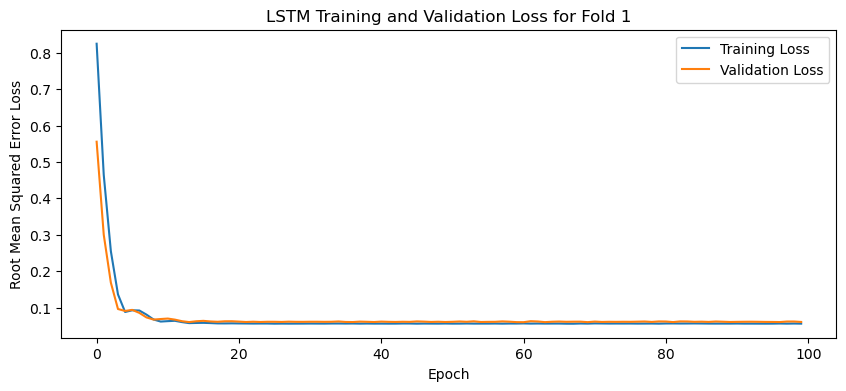

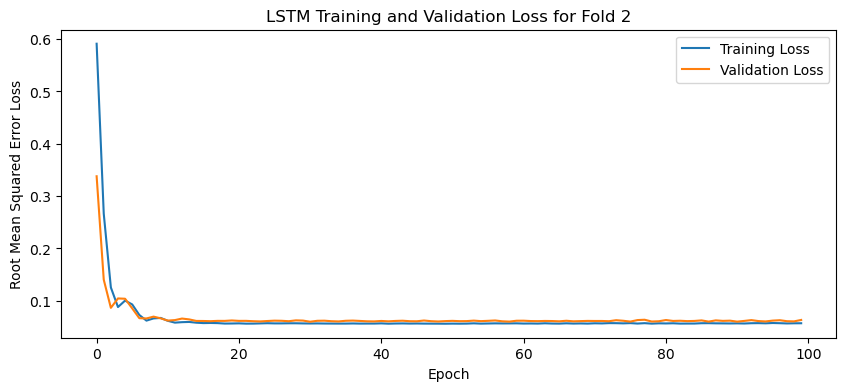

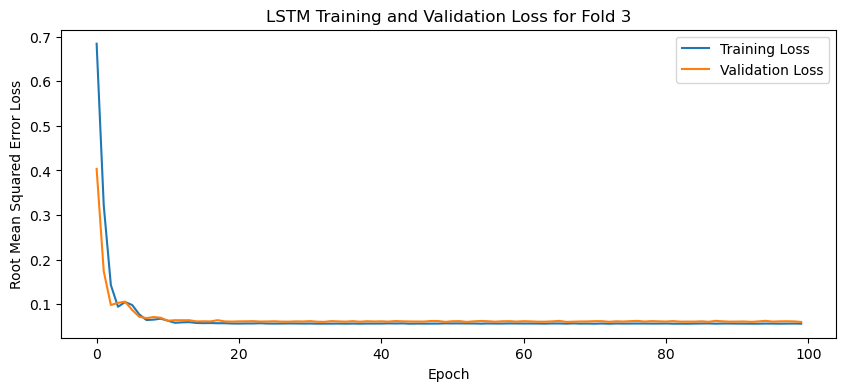

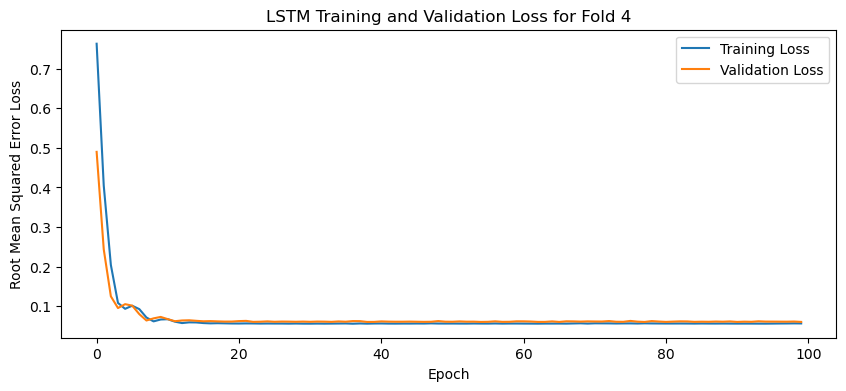

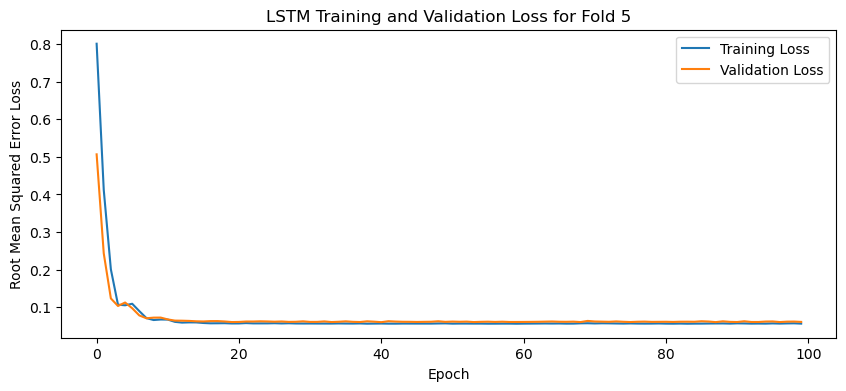

[I 2025-05-09 18:37:36,952] Trial 8 finished with value: 0.043634118139743806 and parameters: {'lr': 0.0011071053672625886, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.14110710562819775}. Best is trial 0 with value: 0.0428756020963192.


Cross Validation Accuracies:
[0.04303723946213722, 0.0403398759663105, 0.04509441554546356, 0.04454971104860306, 0.04514934867620468]
Mean Cross Validation Accuracy:
0.043634118139743806
Standard Deviation of Cross Validation Accuracy:
0.0018152133824725222


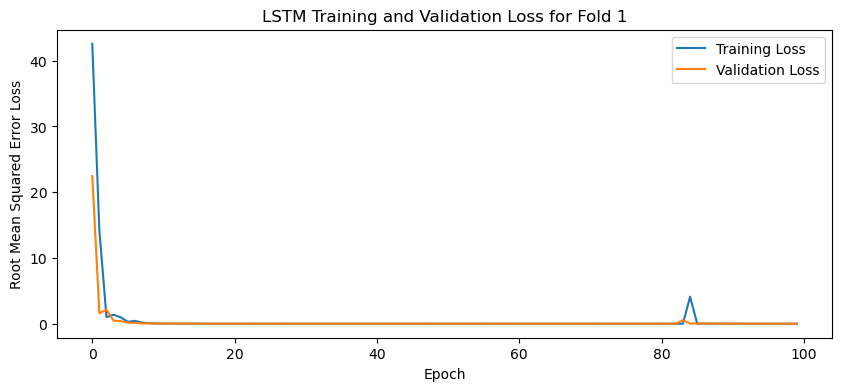

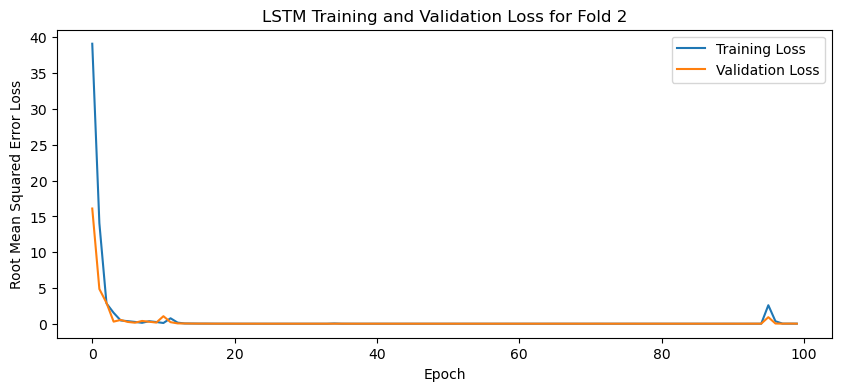

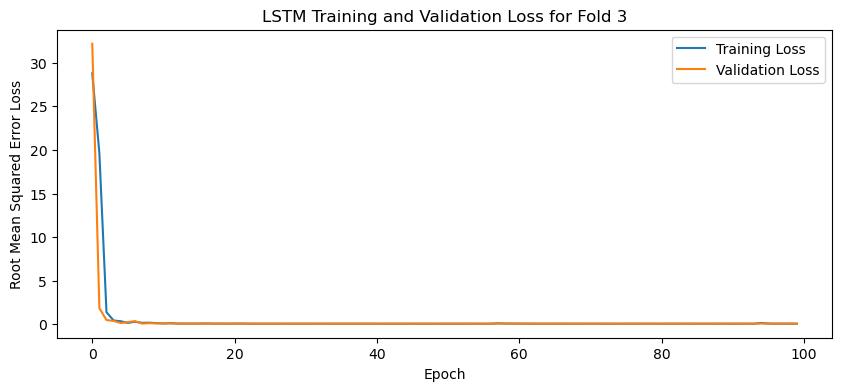

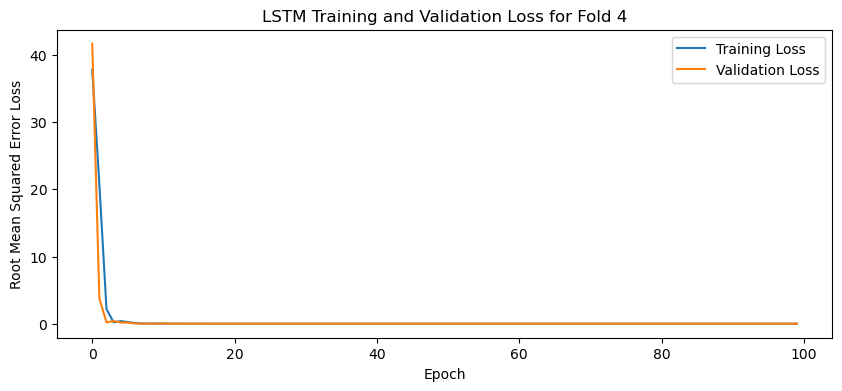

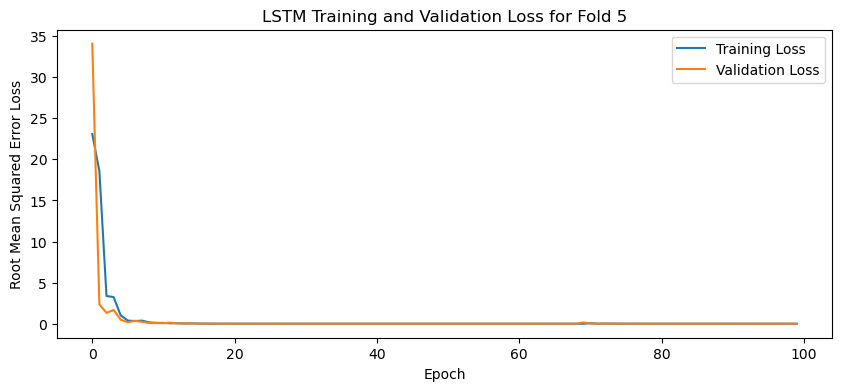

[I 2025-05-09 18:38:59,829] Trial 9 finished with value: 0.04437650963664055 and parameters: {'lr': 0.07597814420816303, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.11936881282054178}. Best is trial 0 with value: 0.0428756020963192.


Cross Validation Accuracies:
[0.04370211064815521, 0.04575894773006439, 0.047071054577827454, 0.04225323349237442, 0.043097201734781265]
Mean Cross Validation Accuracy:
0.04437650963664055
Standard Deviation of Cross Validation Accuracy:
0.0017760321962433324


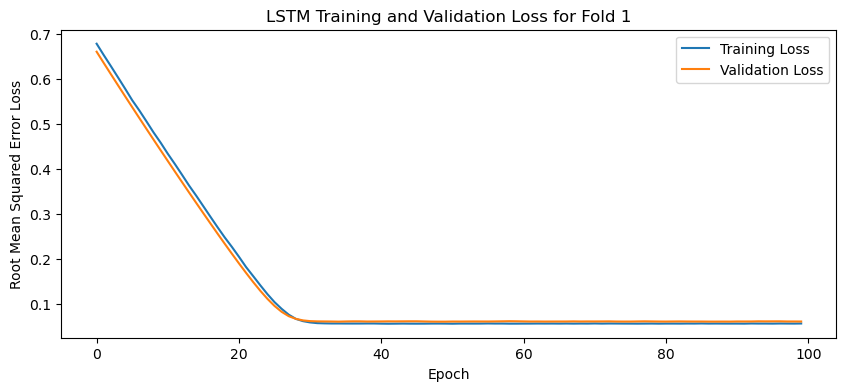

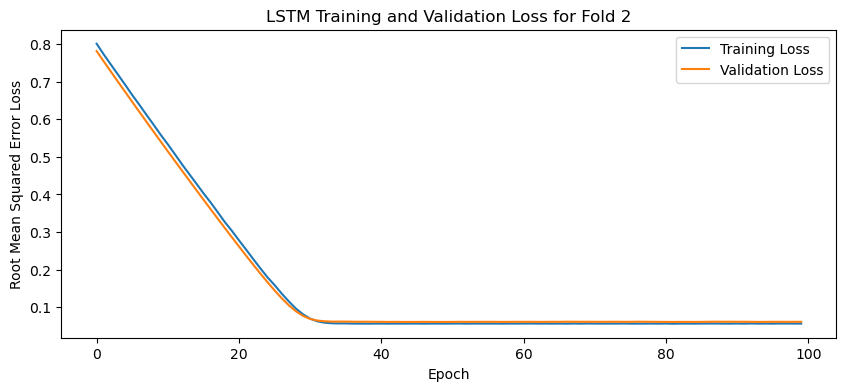

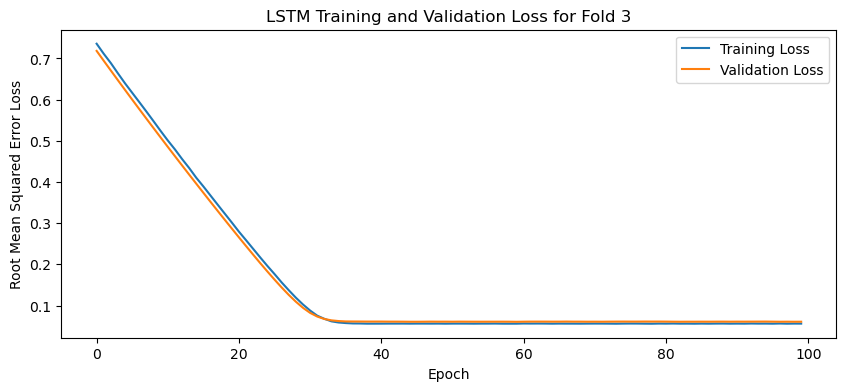

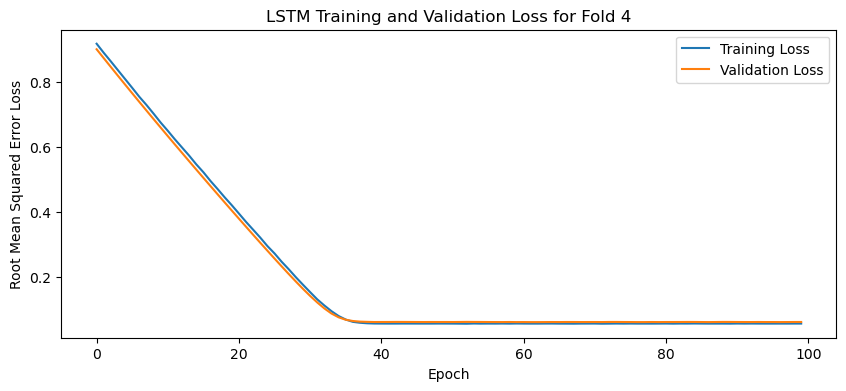

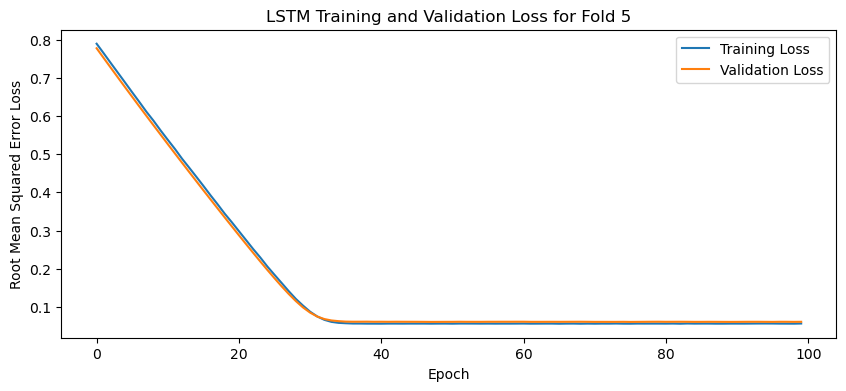

[I 2025-05-09 18:40:58,137] Trial 10 finished with value: 0.04275593087077141 and parameters: {'lr': 0.012721564896183245, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.491262769644122}. Best is trial 10 with value: 0.04275593087077141.


Cross Validation Accuracies:
[0.04286540672183037, 0.04289723560214043, 0.042903926223516464, 0.04237520694732666, 0.04273787885904312]
Mean Cross Validation Accuracy:
0.04275593087077141
Standard Deviation of Cross Validation Accuracy:
0.00019956512446672048


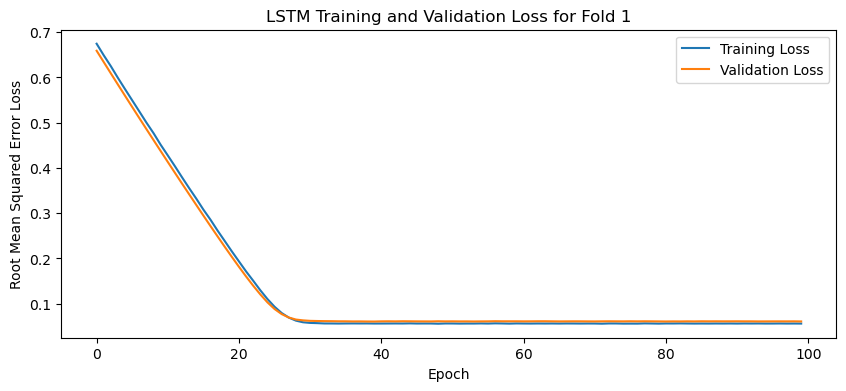

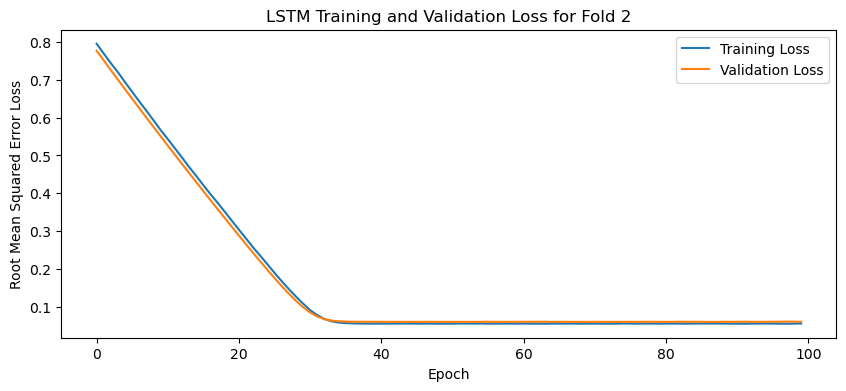

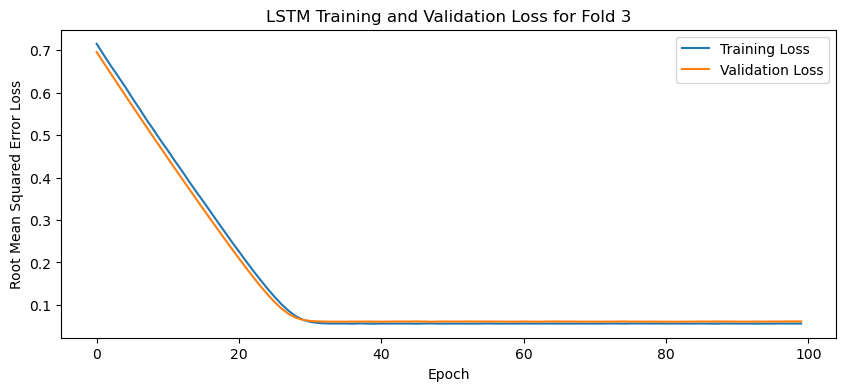

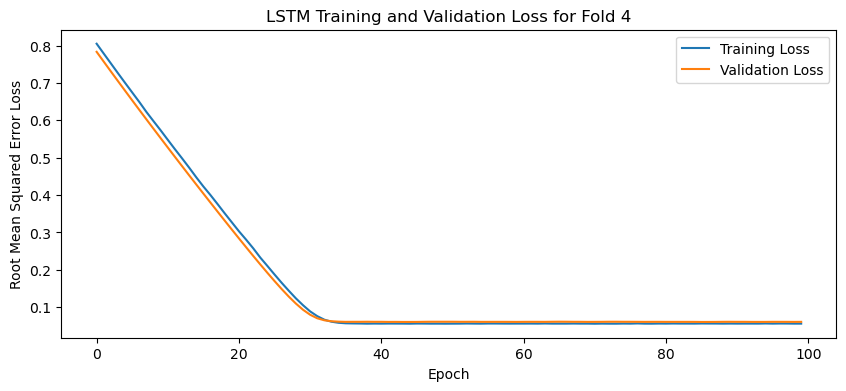

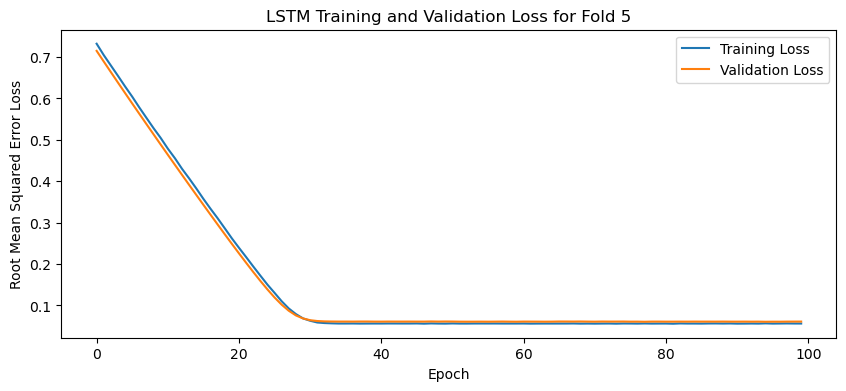

[I 2025-05-09 18:43:09,728] Trial 11 finished with value: 0.04255733042955399 and parameters: {'lr': 0.012561448830573117, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4977631911036607}. Best is trial 11 with value: 0.04255733042955399.


Cross Validation Accuracies:
[0.04278649389743805, 0.04258779063820839, 0.04225309565663338, 0.04259718209505081, 0.0425620898604393]
Mean Cross Validation Accuracy:
0.04255733042955399
Standard Deviation of Cross Validation Accuracy:
0.0001718216073741585


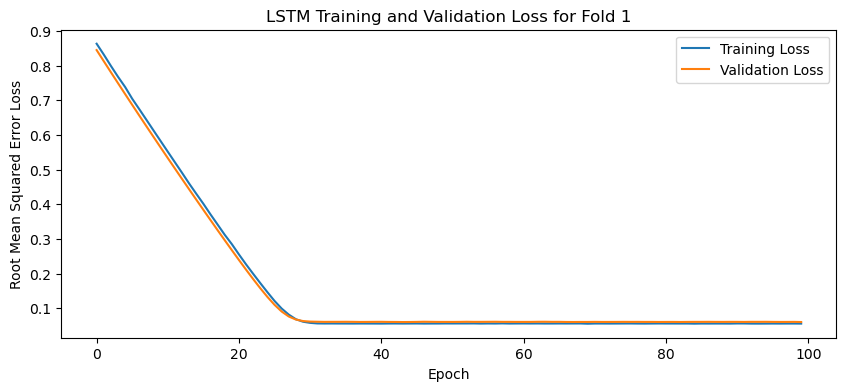

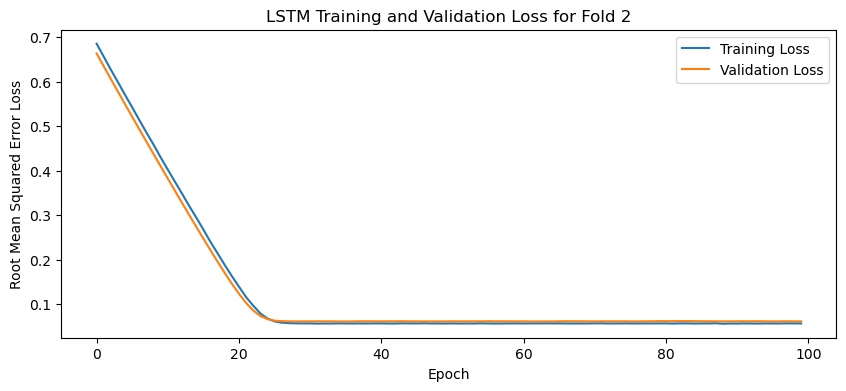

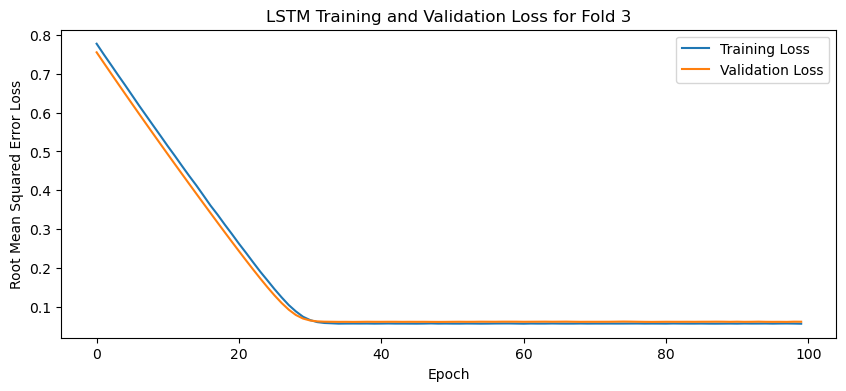

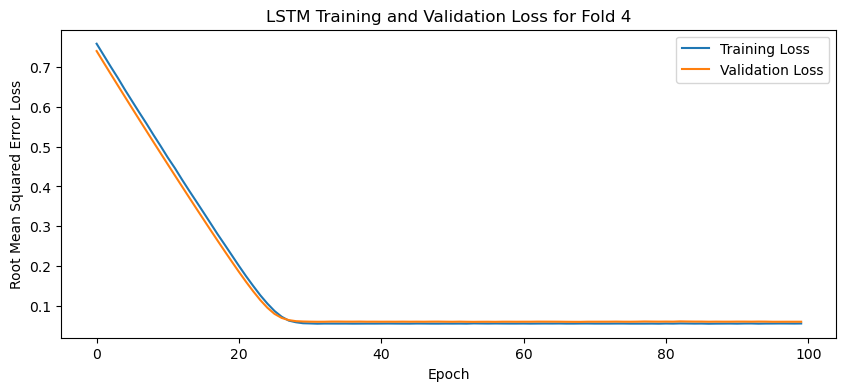

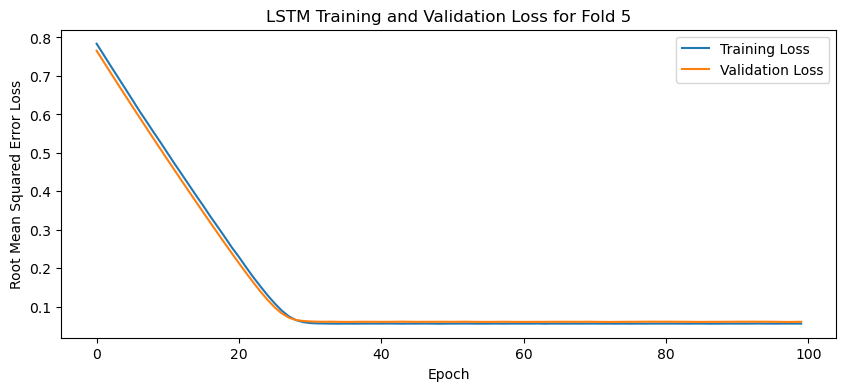

[I 2025-05-09 18:44:58,415] Trial 12 finished with value: 0.04282941594719887 and parameters: {'lr': 0.0141944826592912, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4963358550359016}. Best is trial 11 with value: 0.04255733042955399.


Cross Validation Accuracies:
[0.04309256002306938, 0.042766667902469635, 0.04298819229006767, 0.042876437306404114, 0.042423222213983536]
Mean Cross Validation Accuracy:
0.04282941594719887
Standard Deviation of Cross Validation Accuracy:
0.0002304762052632757


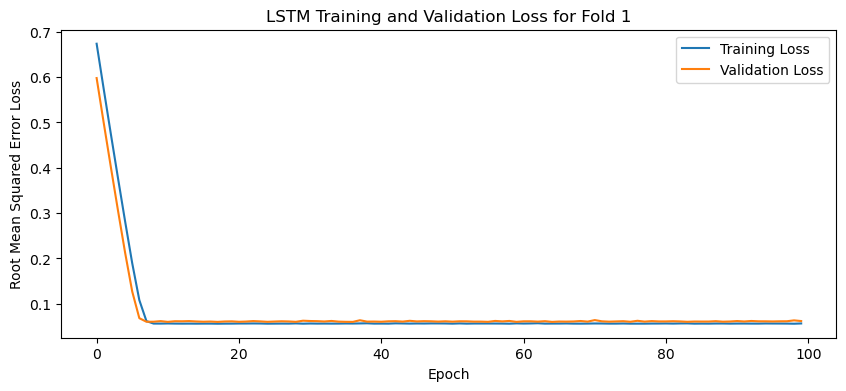

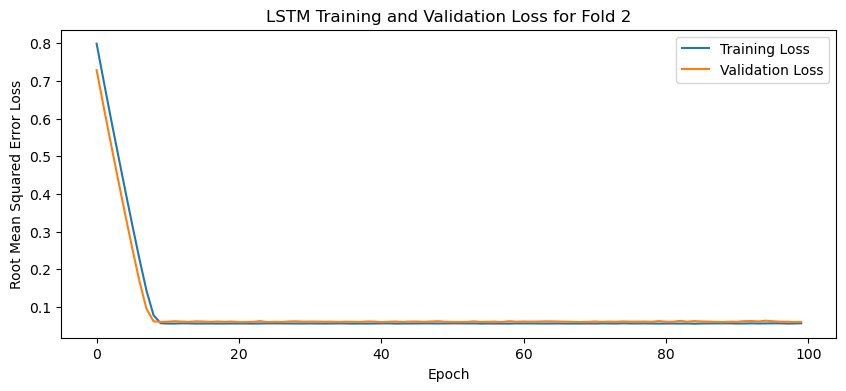

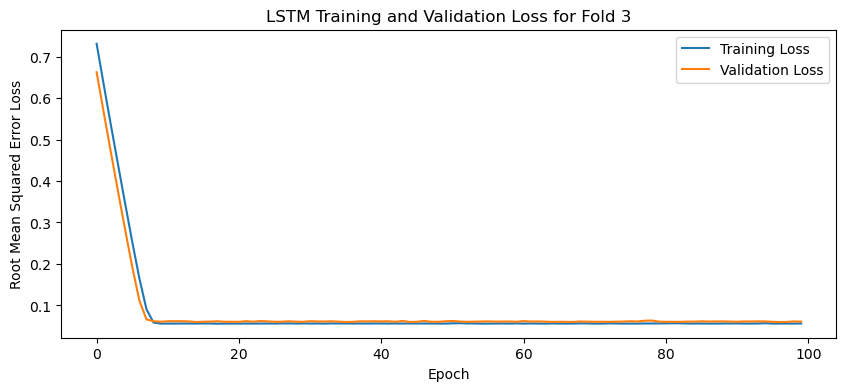

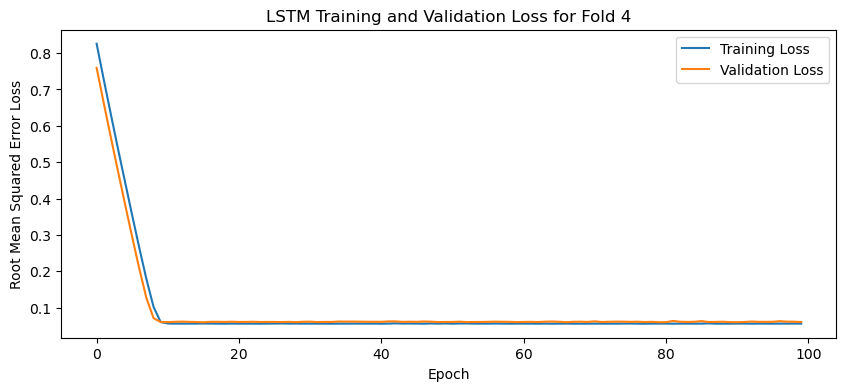

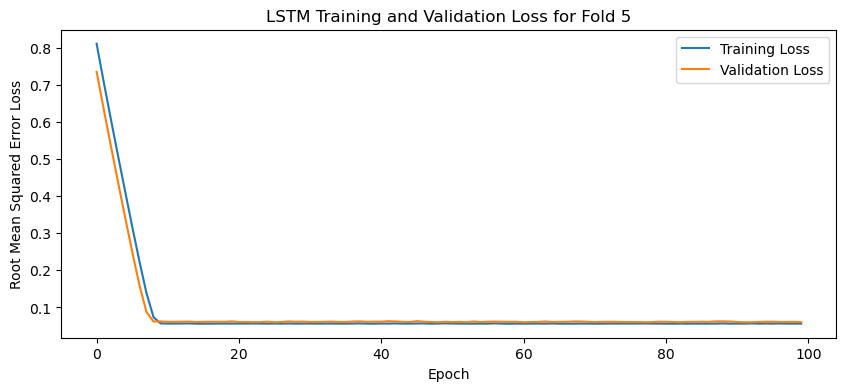

[I 2025-05-09 18:46:42,531] Trial 13 finished with value: 0.04369056448340416 and parameters: {'lr': 0.049432662099880016, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.24540715395206664}. Best is trial 11 with value: 0.04255733042955399.


Cross Validation Accuracies:
[0.04184330999851227, 0.045656200498342514, 0.04262104257941246, 0.04352368414402008, 0.044808585196733475]
Mean Cross Validation Accuracy:
0.04369056448340416
Standard Deviation of Cross Validation Accuracy:
0.0013926787527208352


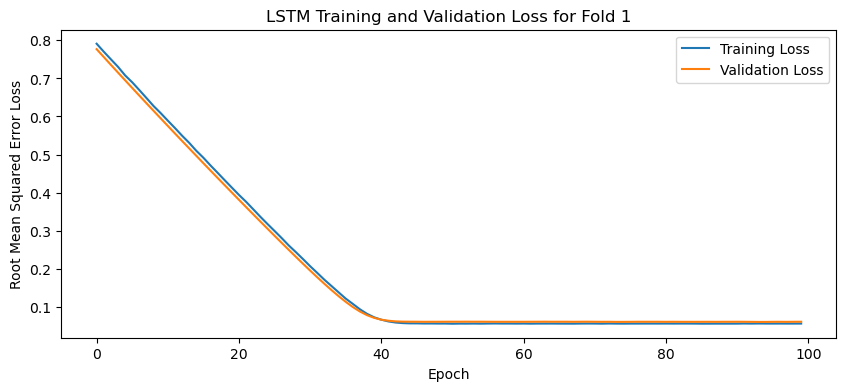

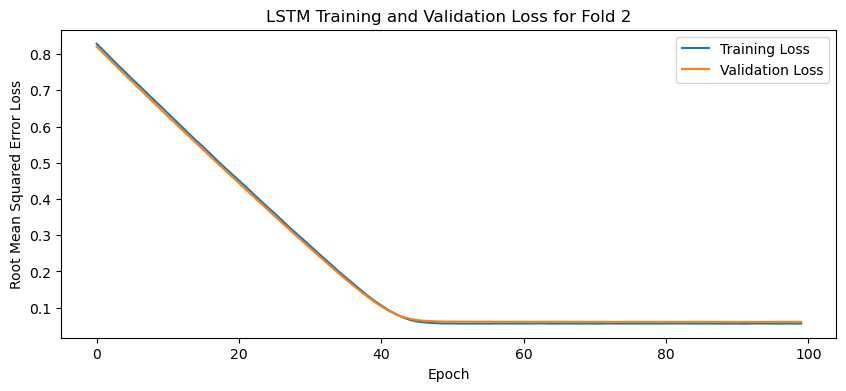

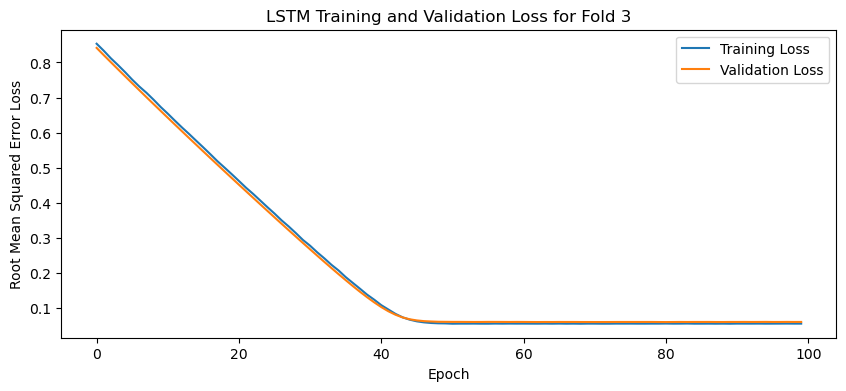

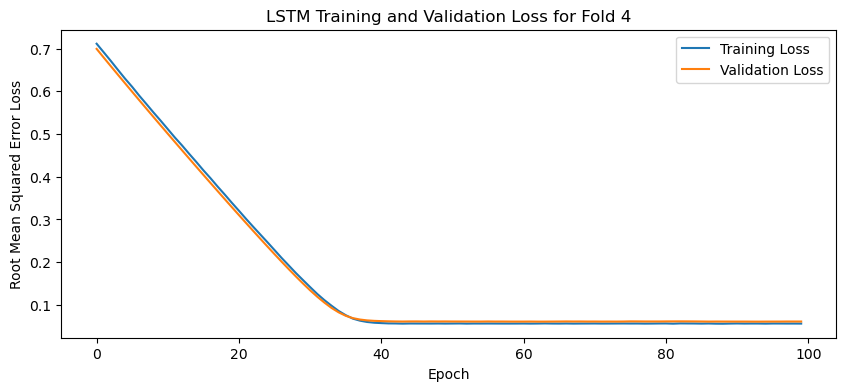

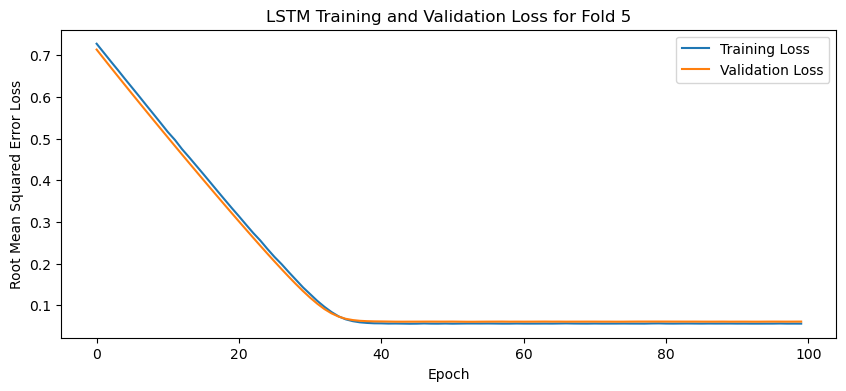

[I 2025-05-09 18:48:17,114] Trial 14 finished with value: 0.04256034791469574 and parameters: {'lr': 0.00993590112166716, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.49334220425244557}. Best is trial 11 with value: 0.04255733042955399.


Cross Validation Accuracies:
[0.042469896376132965, 0.04252538084983826, 0.04246579483151436, 0.042729198932647705, 0.04261146858334541]
Mean Cross Validation Accuracy:
0.04256034791469574
Standard Deviation of Cross Validation Accuracy:
9.946703073765733e-05


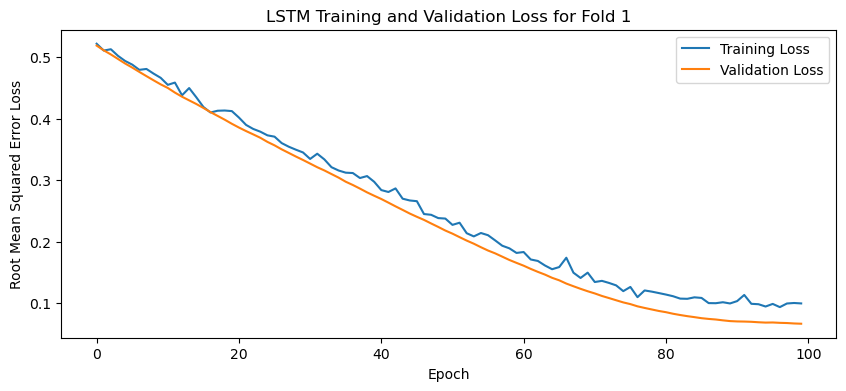

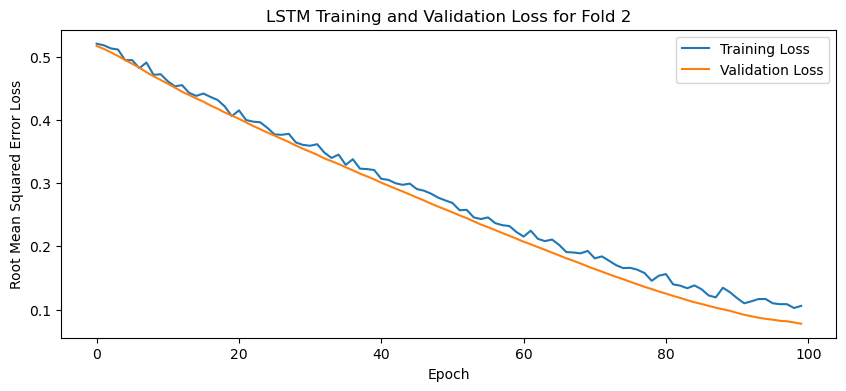

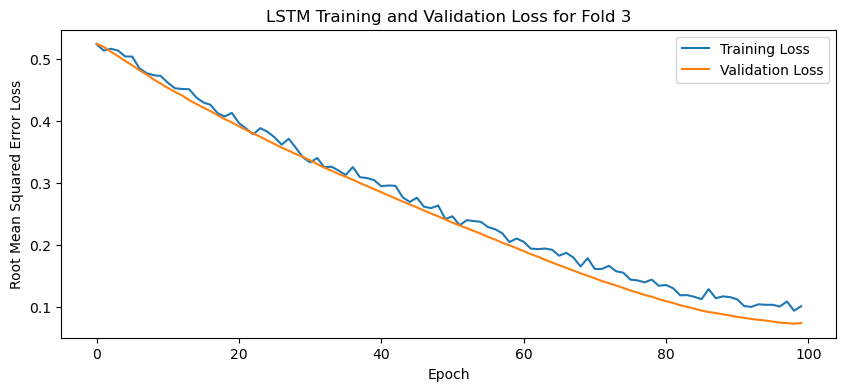

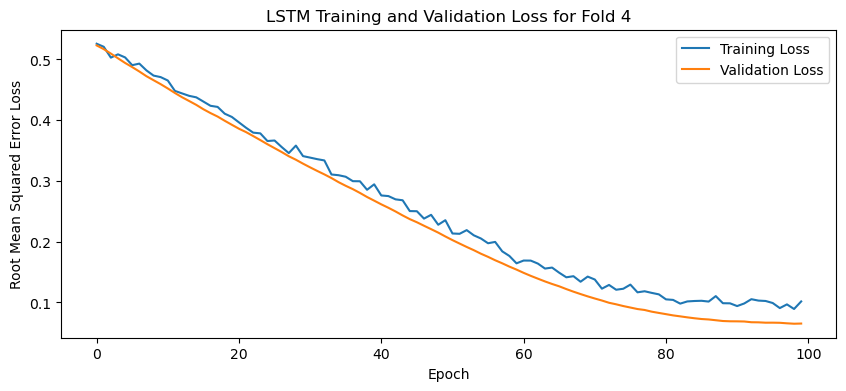

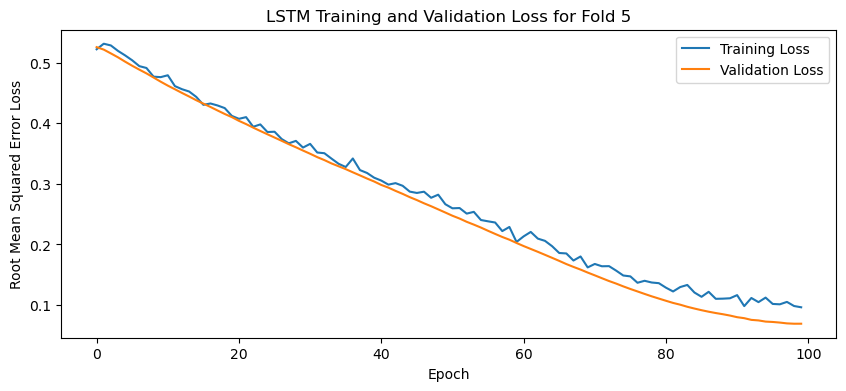

[I 2025-05-09 18:50:05,859] Trial 15 finished with value: 0.05086121261119843 and parameters: {'lr': 0.007132414078016405, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.24471425176372988}. Best is trial 11 with value: 0.04255733042955399.


Cross Validation Accuracies:
[0.046932753175497055, 0.05896541103720665, 0.0515739768743515, 0.045733071863651276, 0.051100850105285645]
Mean Cross Validation Accuracy:
0.05086121261119843
Standard Deviation of Cross Validation Accuracy:
0.004647022965644118


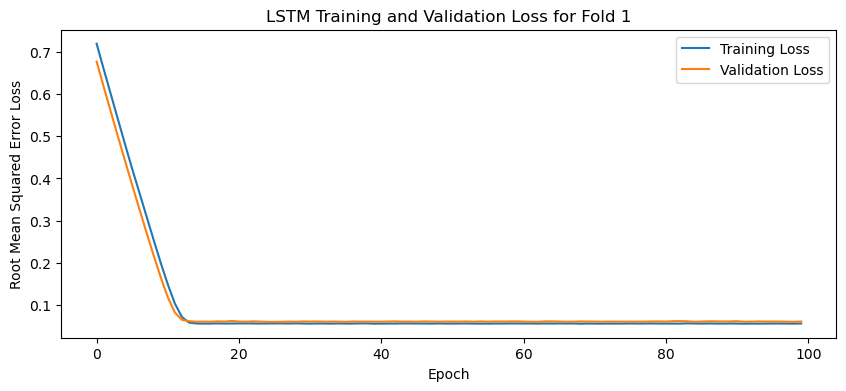

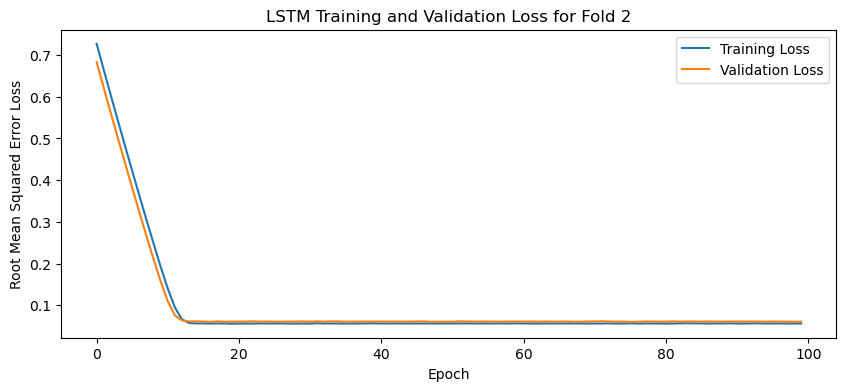

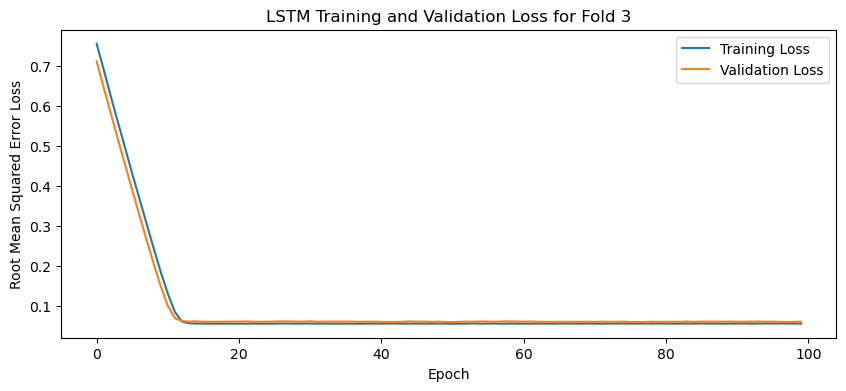

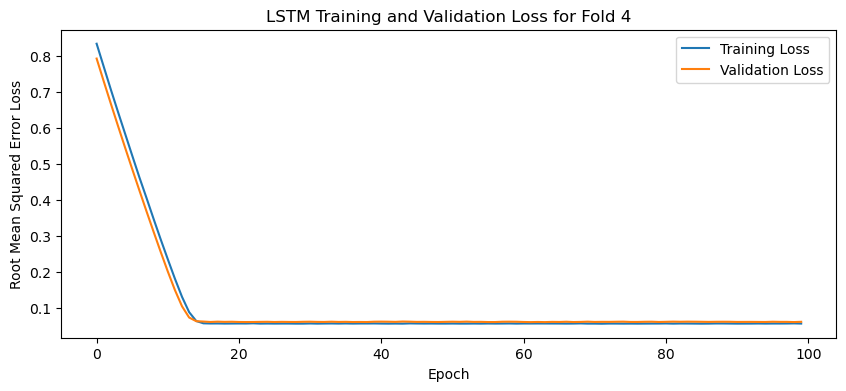

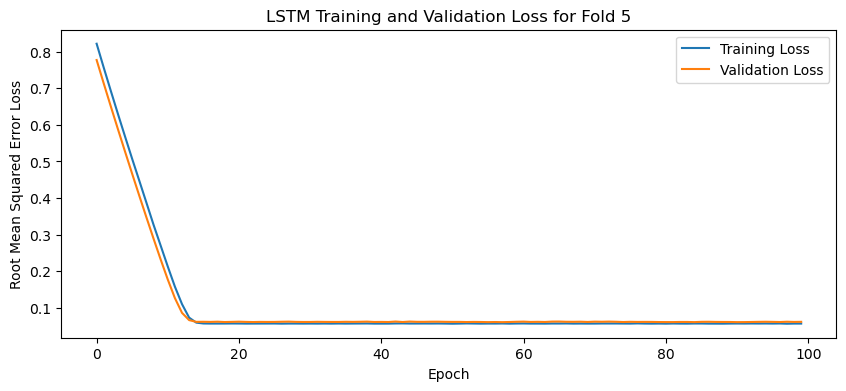

[I 2025-05-09 18:51:50,435] Trial 16 finished with value: 0.04242557212710381 and parameters: {'lr': 0.030383482799646144, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4509107832083294}. Best is trial 16 with value: 0.04242557212710381.


Cross Validation Accuracies:
[0.04209155961871147, 0.04231769219040871, 0.04230312630534172, 0.042425863444805145, 0.042989619076251984]
Mean Cross Validation Accuracy:
0.04242557212710381
Standard Deviation of Cross Validation Accuracy:
0.0003021074184723839


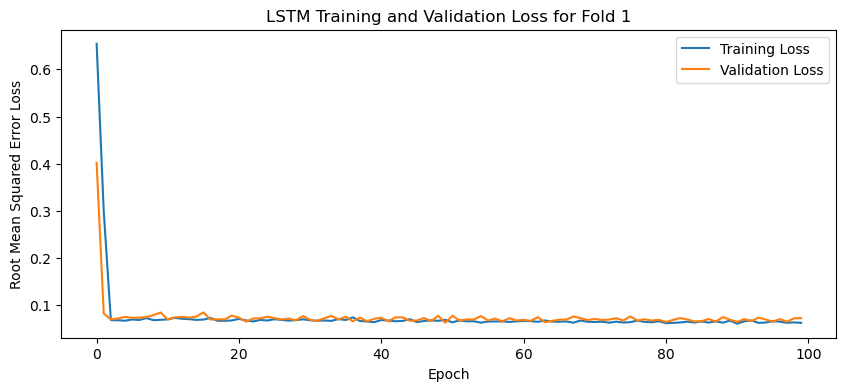

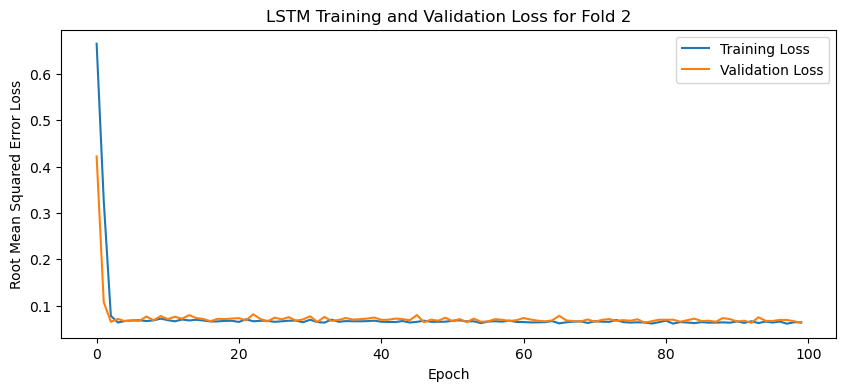

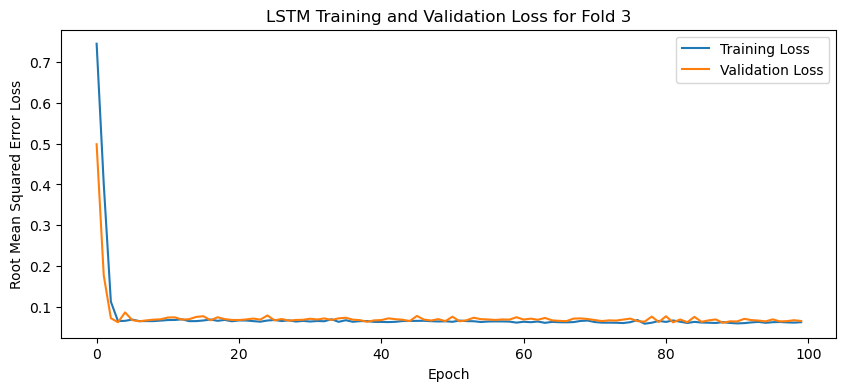

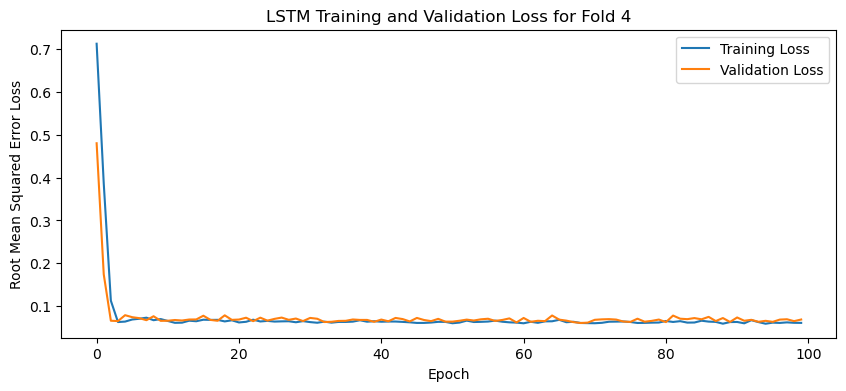

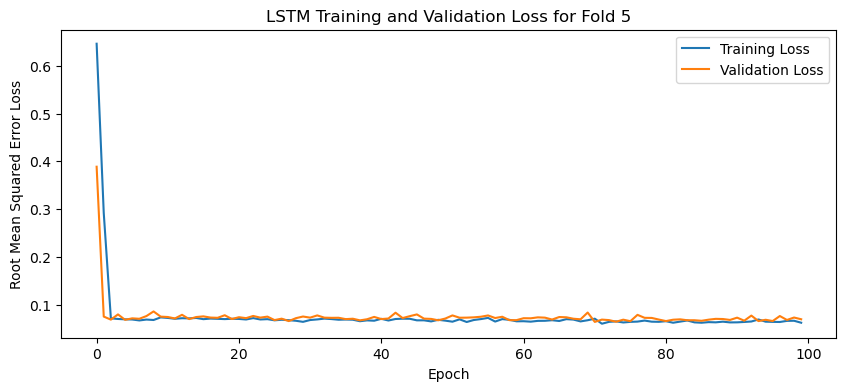

[I 2025-05-09 18:55:17,902] Trial 17 finished with value: 0.053004290163517 and parameters: {'lr': 0.1814524308001588, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.43816453208569084}. Best is trial 16 with value: 0.04242557212710381.


Cross Validation Accuracies:
[0.051642224192619324, 0.0514104962348938, 0.05629199370741844, 0.05330616235733032, 0.052370574325323105]
Mean Cross Validation Accuracy:
0.053004290163517
Standard Deviation of Cross Validation Accuracy:
0.001771841977917397


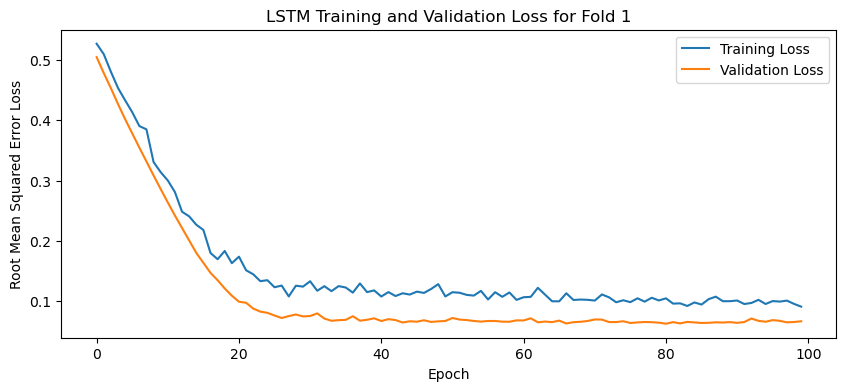

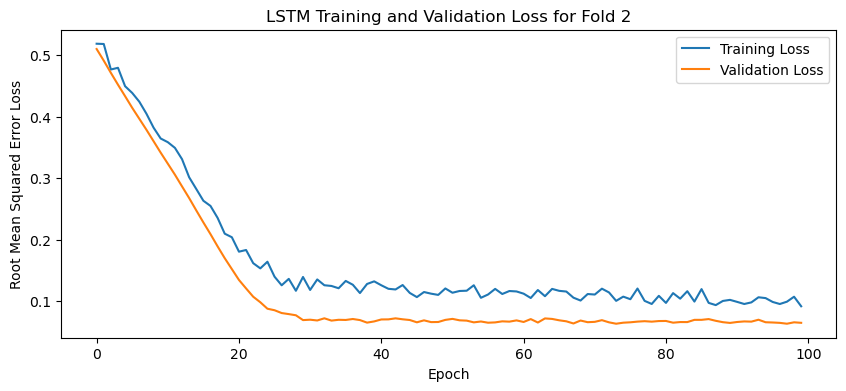

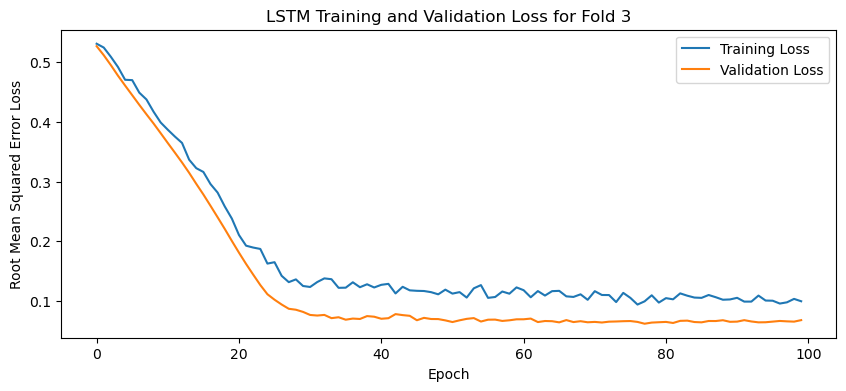

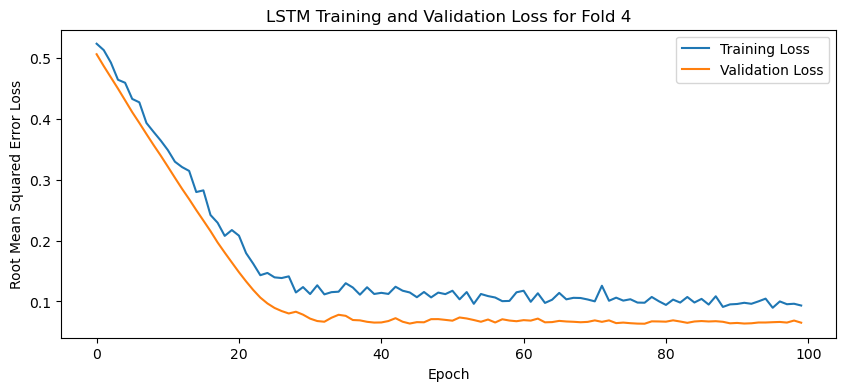

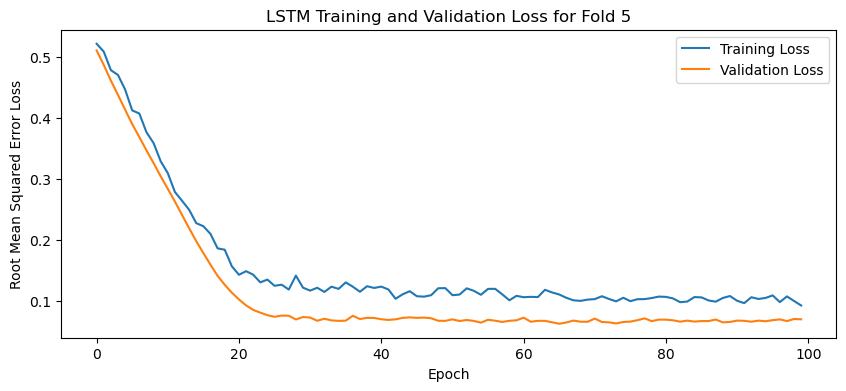

[I 2025-05-09 18:57:26,986] Trial 18 finished with value: 0.049023579061031344 and parameters: {'lr': 0.028463934949459452, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.3902840877135944}. Best is trial 16 with value: 0.04242557212710381.


Cross Validation Accuracies:
[0.04475909471511841, 0.049478184431791306, 0.05102172866463661, 0.04823622480034828, 0.0516226626932621]
Mean Cross Validation Accuracy:
0.049023579061031344
Standard Deviation of Cross Validation Accuracy:
0.00243968264646014


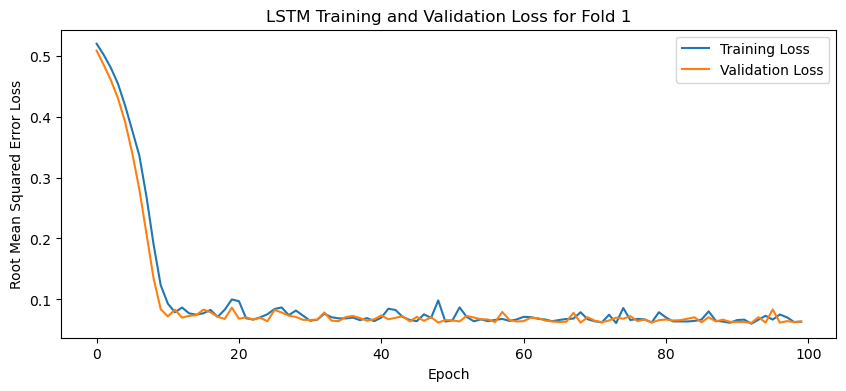

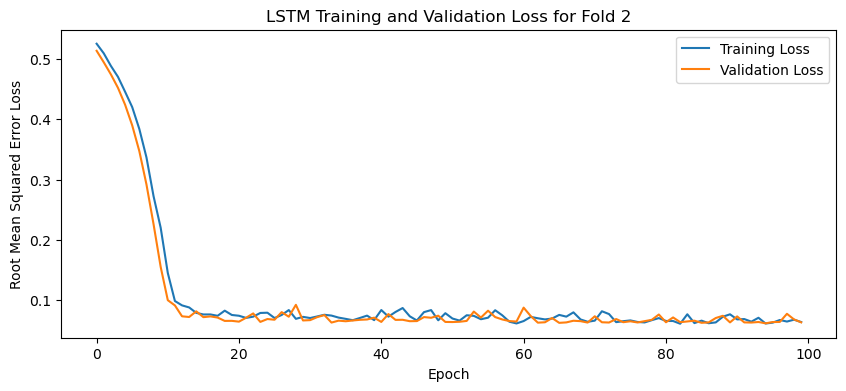

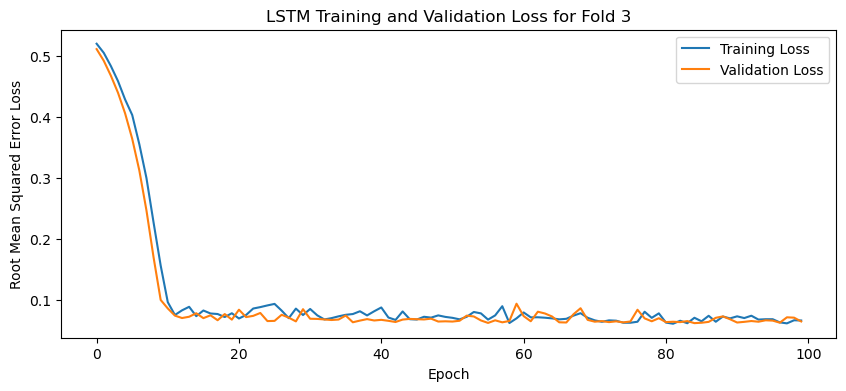

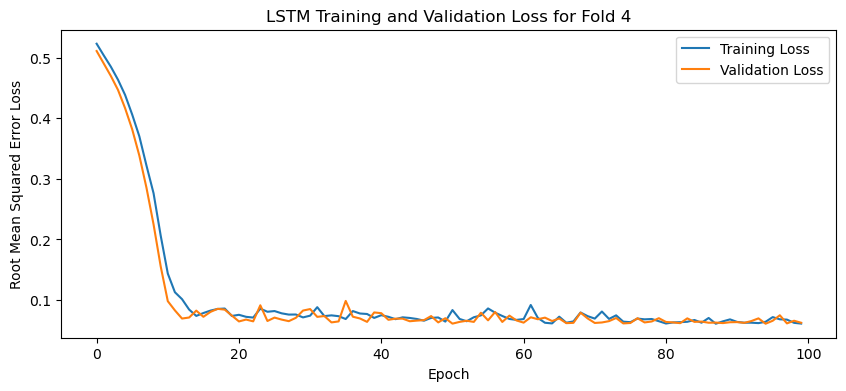

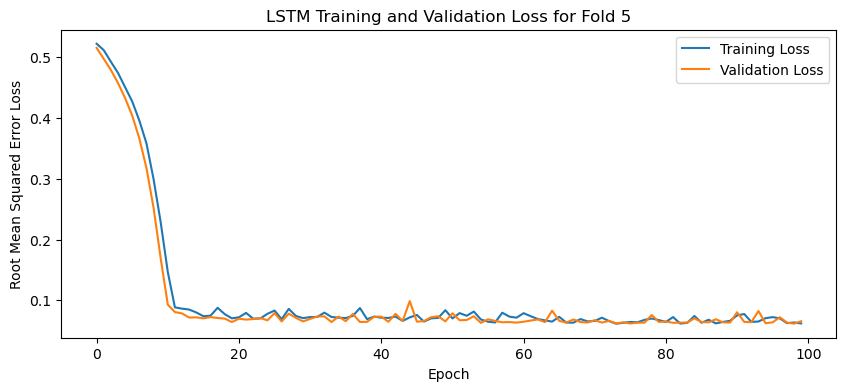

[I 2025-05-09 18:59:05,067] Trial 19 finished with value: 0.046762420982122424 and parameters: {'lr': 0.15271301249867375, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.26947017217115127}. Best is trial 16 with value: 0.04242557212710381.


Cross Validation Accuracies:
[0.05213135480880737, 0.04424116015434265, 0.04572666808962822, 0.04386325553059578, 0.04784966632723808]
Mean Cross Validation Accuracy:
0.046762420982122424
Standard Deviation of Cross Validation Accuracy:
0.003027944960105124


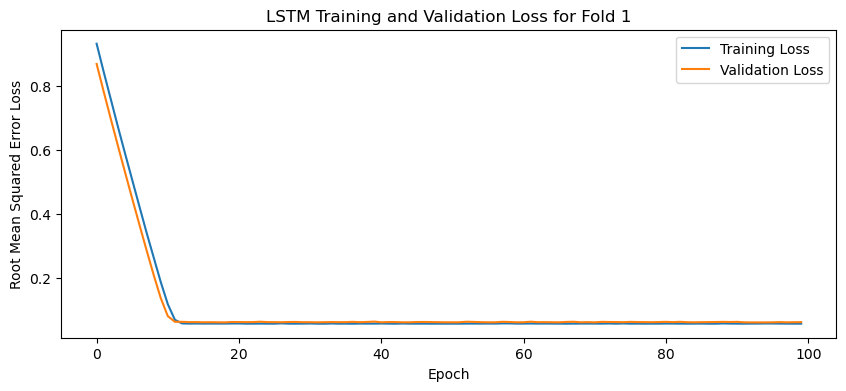

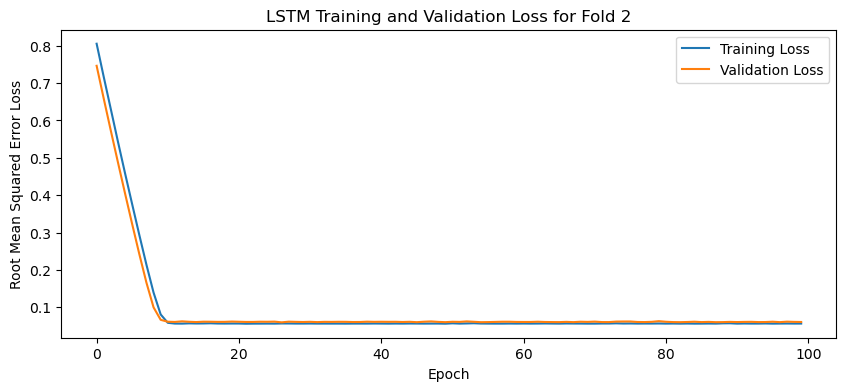

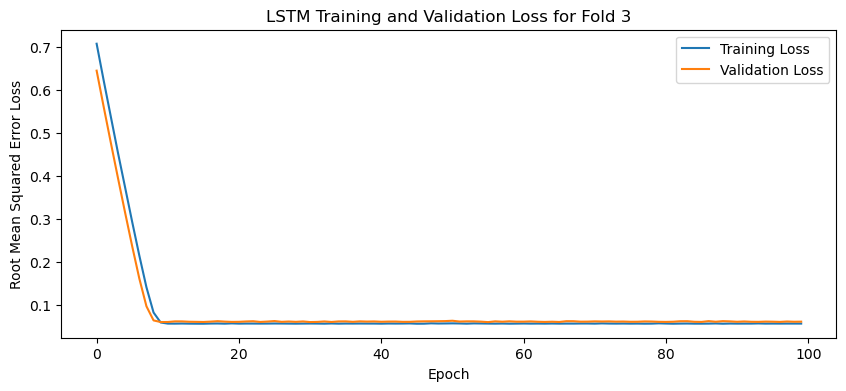

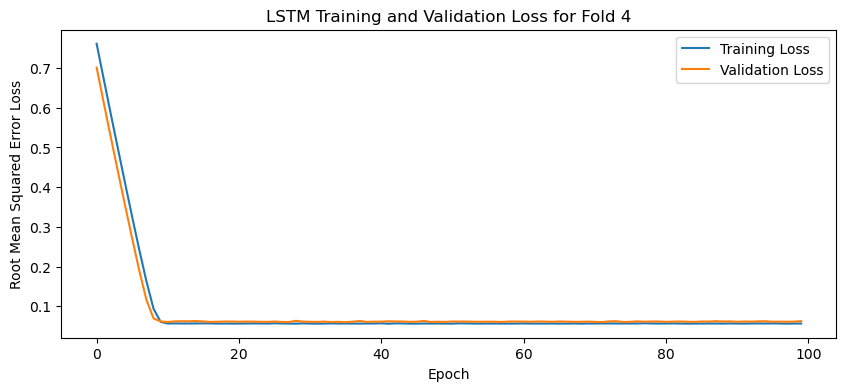

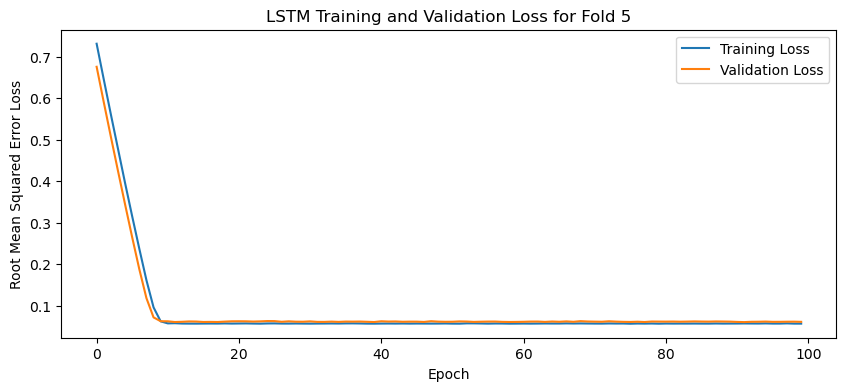

[I 2025-05-09 19:02:06,495] Trial 20 finished with value: 0.042437680065631866 and parameters: {'lr': 0.04297481279246411, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.46050448022483503}. Best is trial 16 with value: 0.04242557212710381.


Cross Validation Accuracies:
[0.04256856441497803, 0.04341281205415726, 0.042477793991565704, 0.040438681840896606, 0.04329054802656174]
Mean Cross Validation Accuracy:
0.042437680065631866
Standard Deviation of Cross Validation Accuracy:
0.0010670520040071592


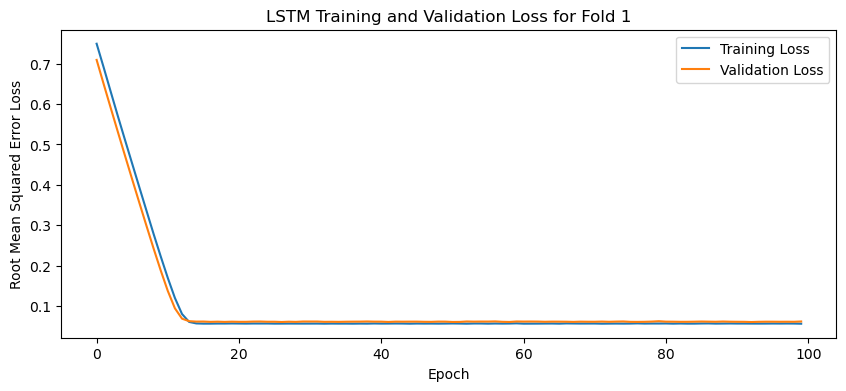

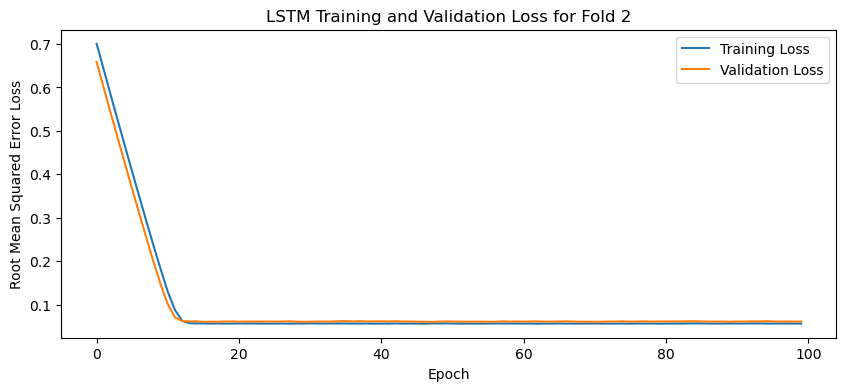

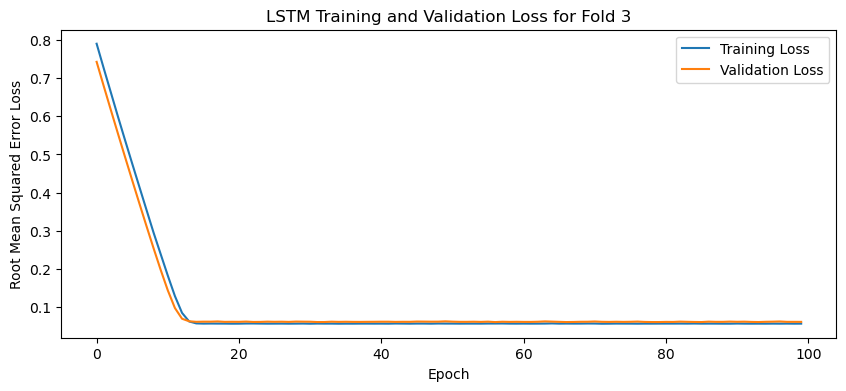

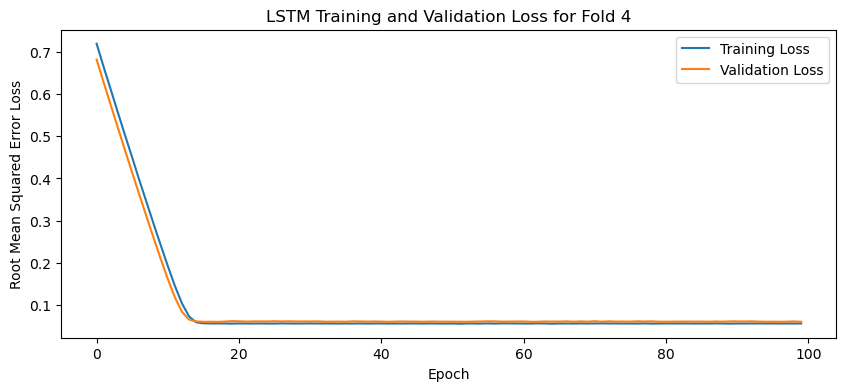

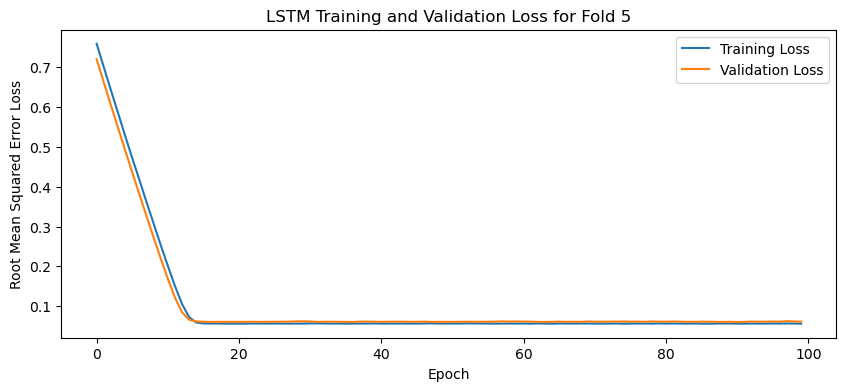

[I 2025-05-09 19:04:45,199] Trial 21 finished with value: 0.04243342652916908 and parameters: {'lr': 0.029024425044238193, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.45715466888734874}. Best is trial 16 with value: 0.04242557212710381.


Cross Validation Accuracies:
[0.04191582649946213, 0.04263750836253166, 0.04269217327237129, 0.043073203414678574, 0.04184842109680176]
Mean Cross Validation Accuracy:
0.04243342652916908
Standard Deviation of Cross Validation Accuracy:
0.0004749852380254627


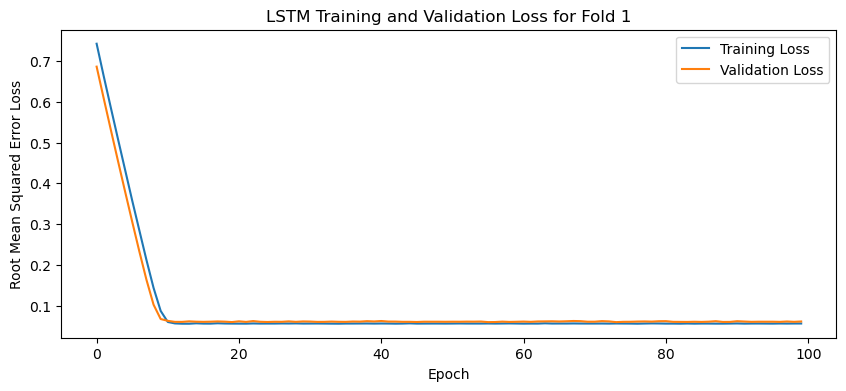

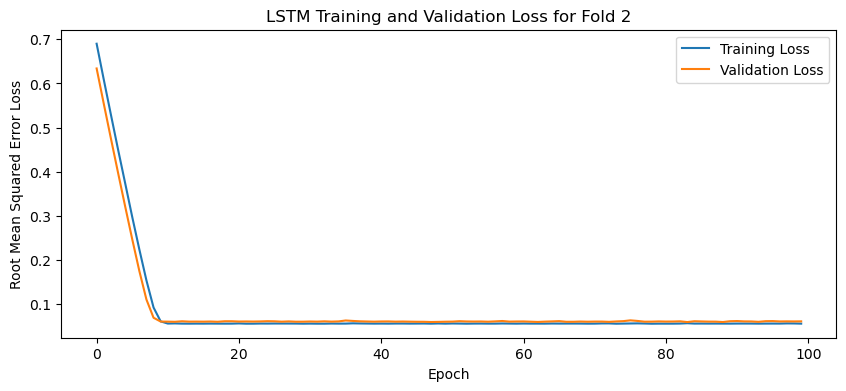

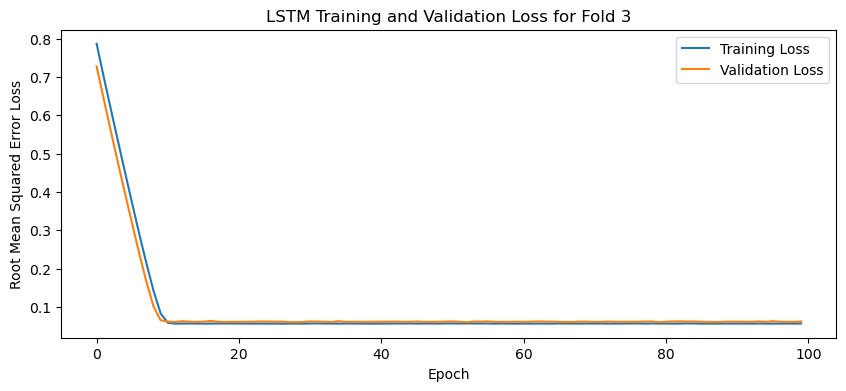

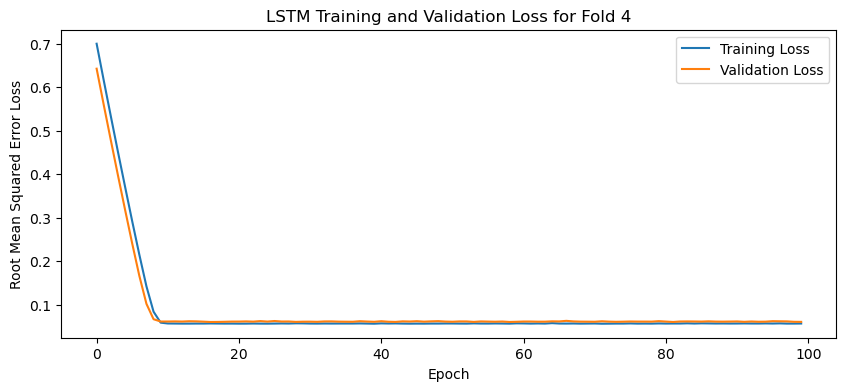

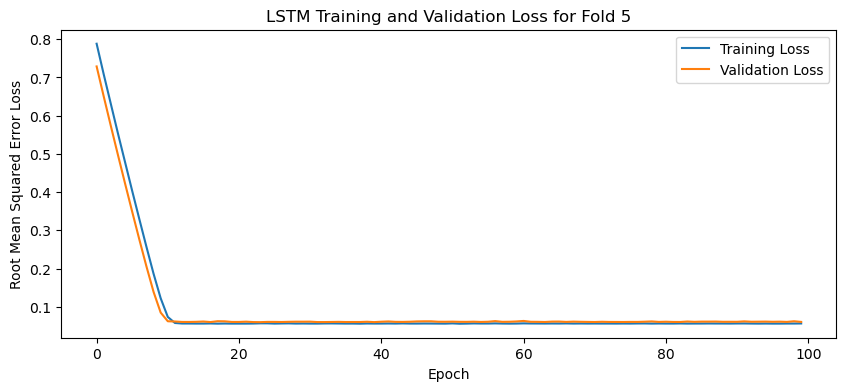

[I 2025-05-09 19:07:30,658] Trial 22 finished with value: 0.04259150102734566 and parameters: {'lr': 0.041341672332686104, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4369639206626636}. Best is trial 16 with value: 0.04242557212710381.


Cross Validation Accuracies:
[0.042610831558704376, 0.041520144790410995, 0.041395895183086395, 0.04388173297047615, 0.04354890063405037]
Mean Cross Validation Accuracy:
0.04259150102734566
Standard Deviation of Cross Validation Accuracy:
0.0010157719886550267


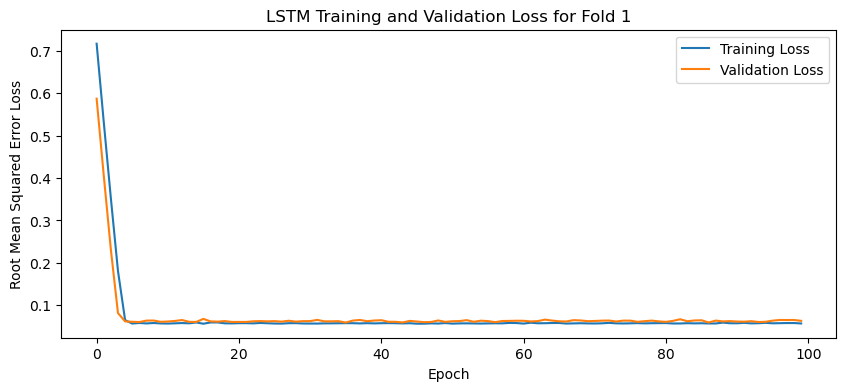

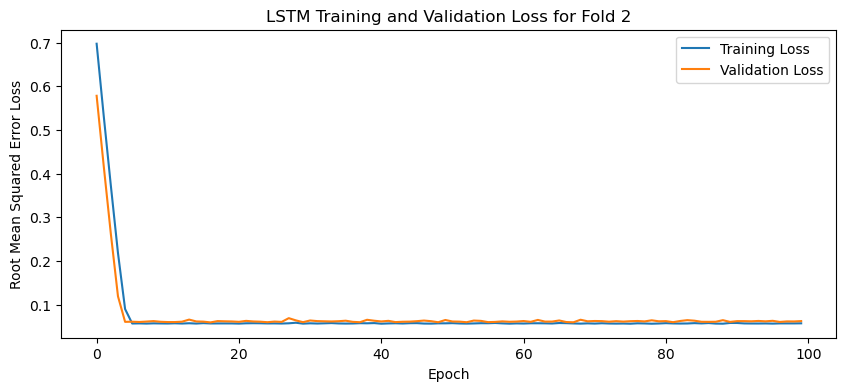

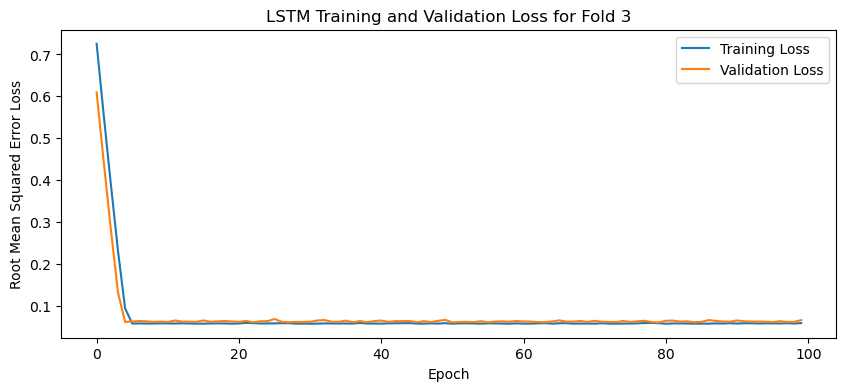

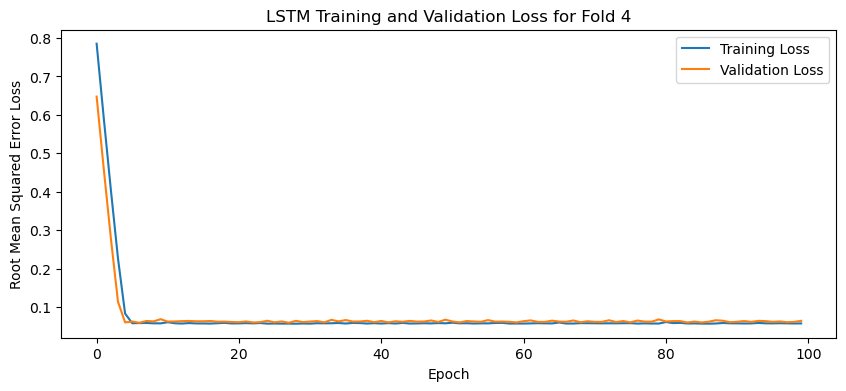

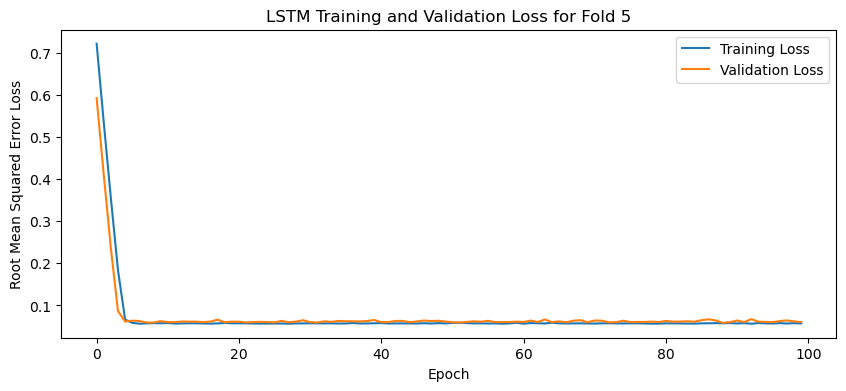

[I 2025-05-09 19:10:10,204] Trial 23 finished with value: 0.04273427203297615 and parameters: {'lr': 0.0887841905968682, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3973078313293751}. Best is trial 16 with value: 0.04242557212710381.


Cross Validation Accuracies:
[0.0415385439991951, 0.04350494220852852, 0.038828637450933456, 0.0407605916261673, 0.04903864488005638]
Mean Cross Validation Accuracy:
0.04273427203297615
Standard Deviation of Cross Validation Accuracy:
0.003490507438236661


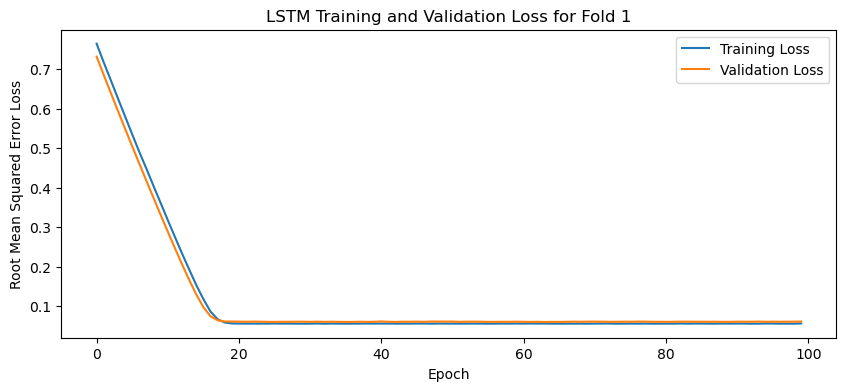

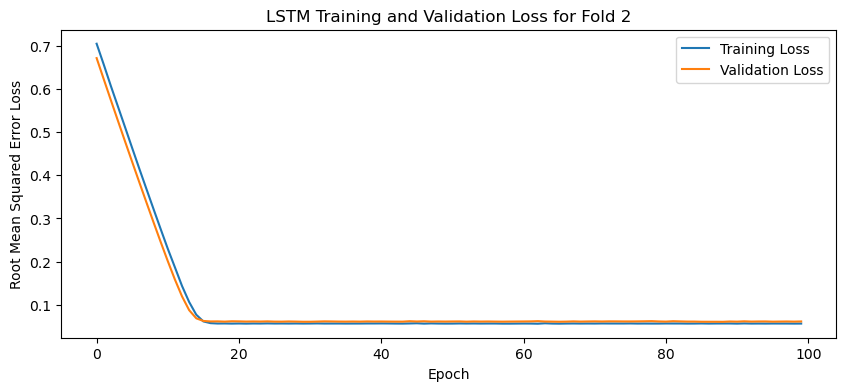

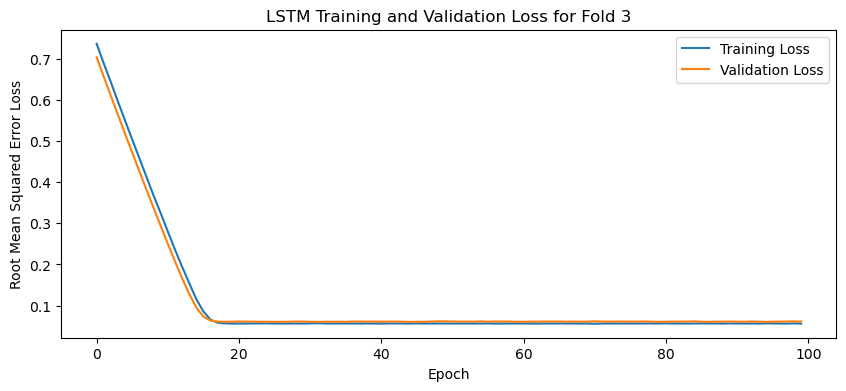

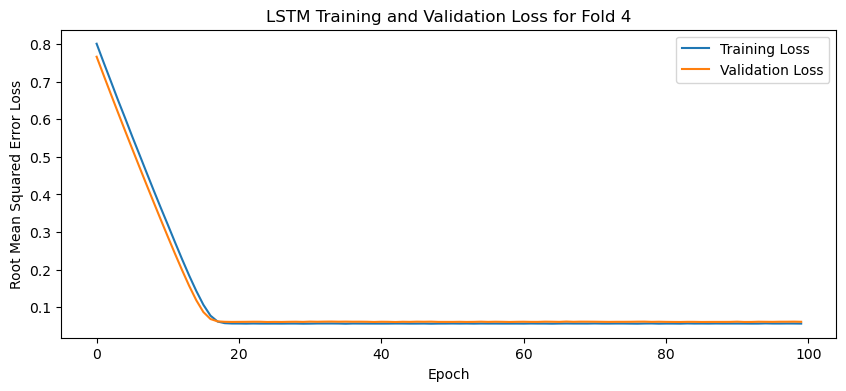

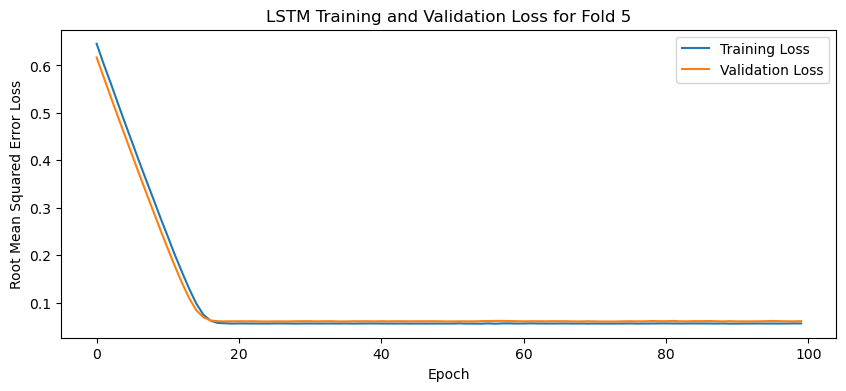

[I 2025-05-09 19:13:00,890] Trial 24 finished with value: 0.04230351001024246 and parameters: {'lr': 0.023094060867771292, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4660025282767919}. Best is trial 24 with value: 0.04230351001024246.


Cross Validation Accuracies:
[0.0417354516685009, 0.04225883632898331, 0.04266293719410896, 0.042467065155506134, 0.04239325970411301]
Mean Cross Validation Accuracy:
0.04230351001024246
Standard Deviation of Cross Validation Accuracy:
0.000312627321587125


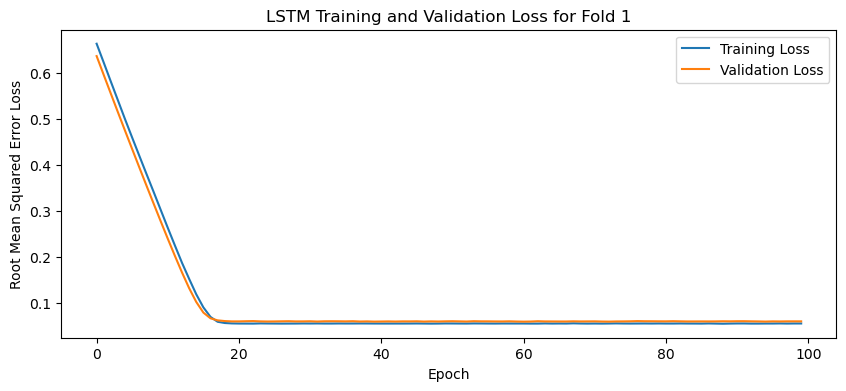

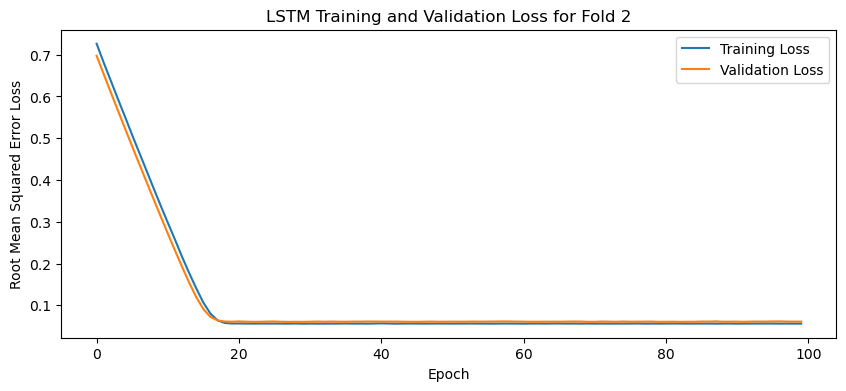

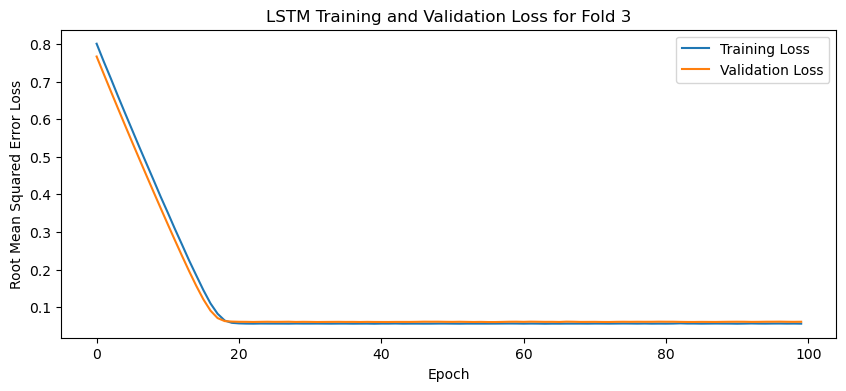

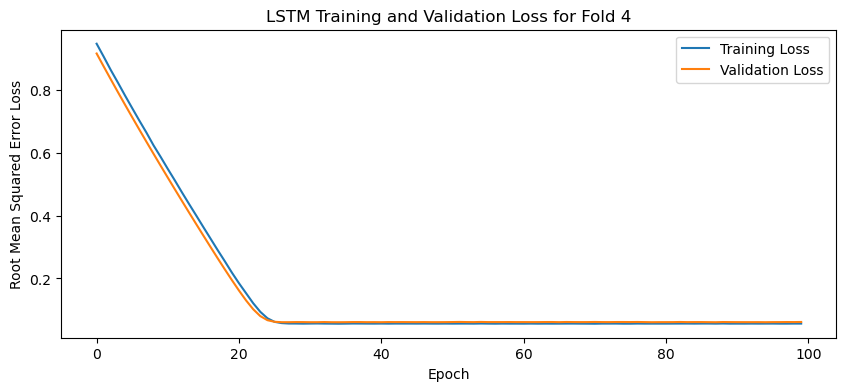

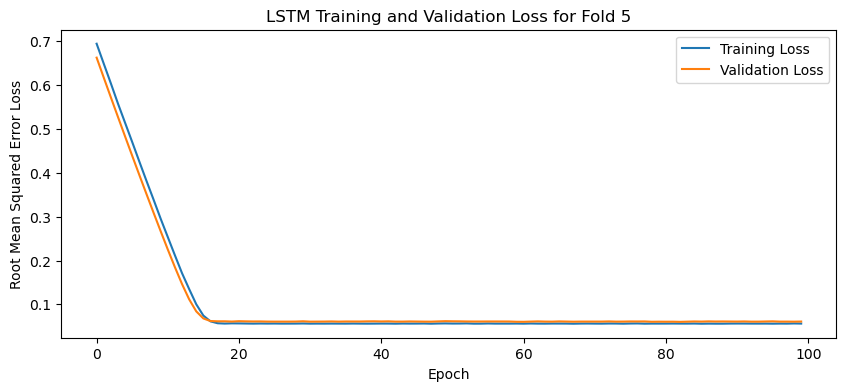

[I 2025-05-09 19:15:31,133] Trial 25 finished with value: 0.042280546575784686 and parameters: {'lr': 0.021628368036700416, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4669824117789497}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04262273758649826, 0.04249070584774017, 0.04203319177031517, 0.04172663763165474, 0.04252946004271507]
Mean Cross Validation Accuracy:
0.042280546575784686
Standard Deviation of Cross Validation Accuracy:
0.00034386597377389843


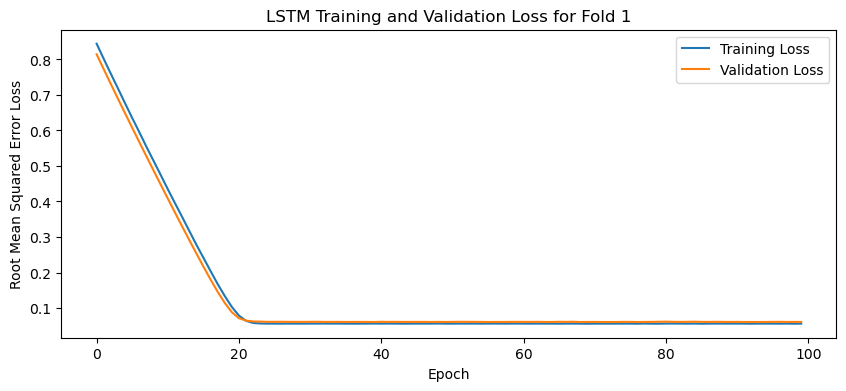

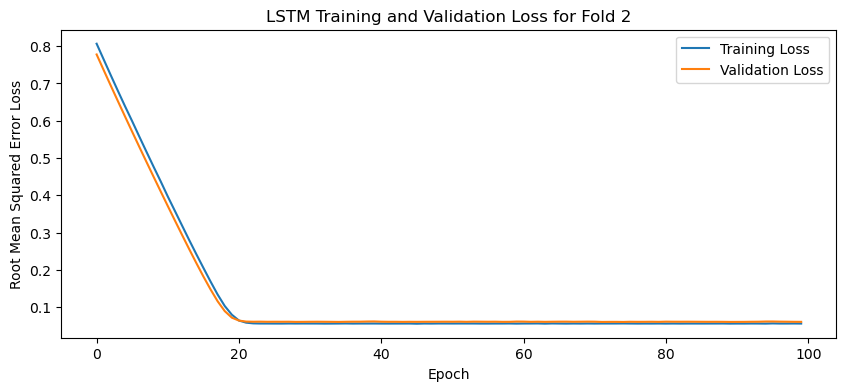

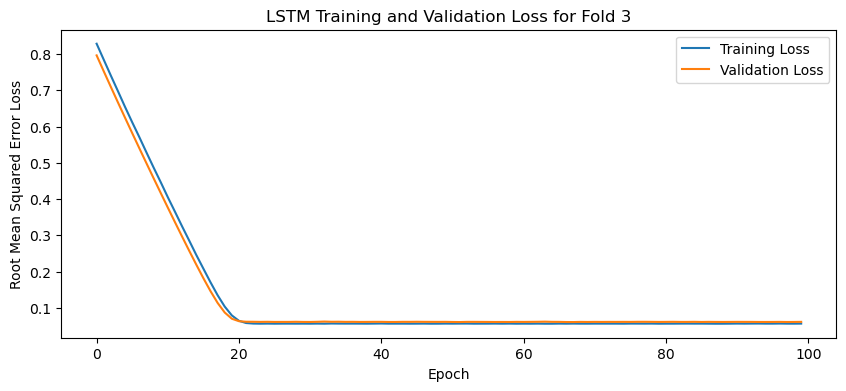

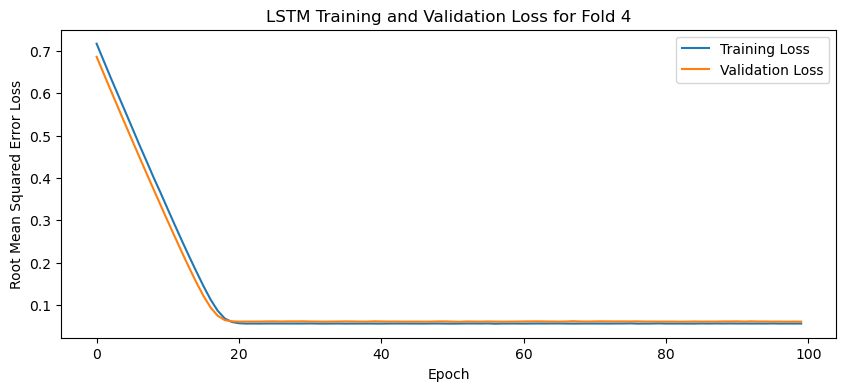

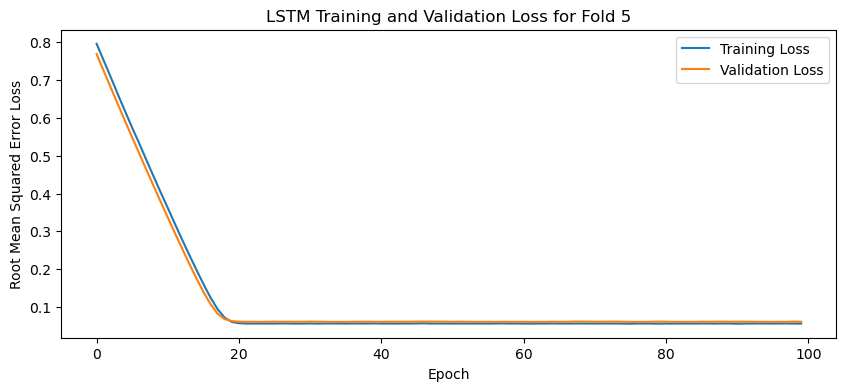

[I 2025-05-09 19:18:02,183] Trial 26 finished with value: 0.04297564998269081 and parameters: {'lr': 0.02043660676130117, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4086724833735388}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04299355298280716, 0.04295559599995613, 0.04260486364364624, 0.043390534818172455, 0.04293370246887207]
Mean Cross Validation Accuracy:
0.04297564998269081
Standard Deviation of Cross Validation Accuracy:
0.0002498376310674468


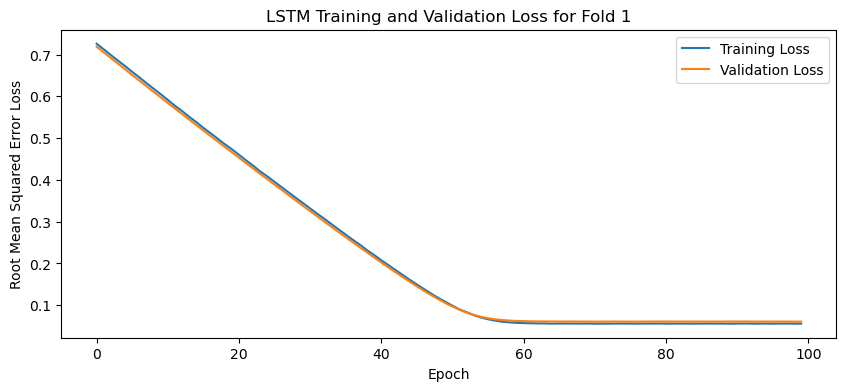

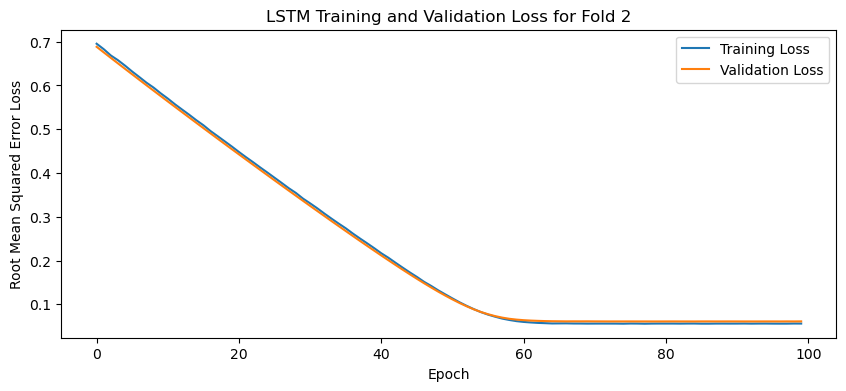

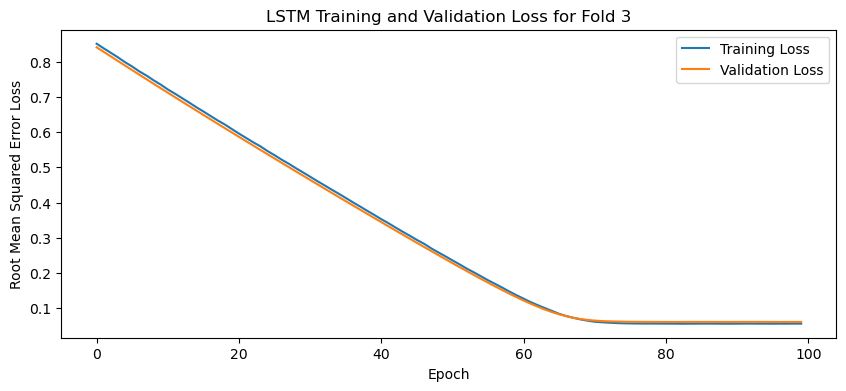

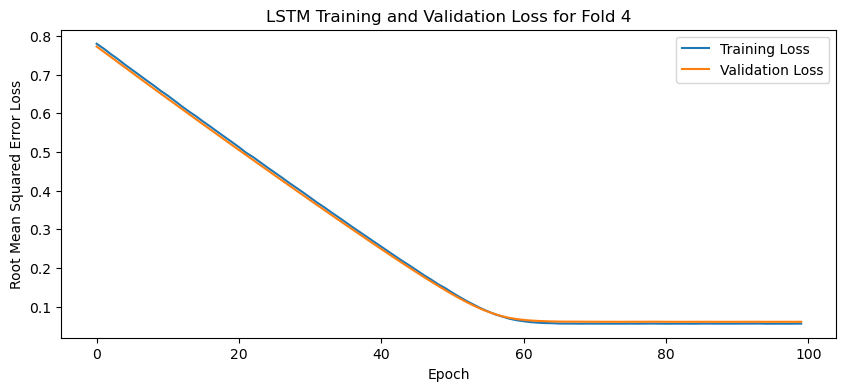

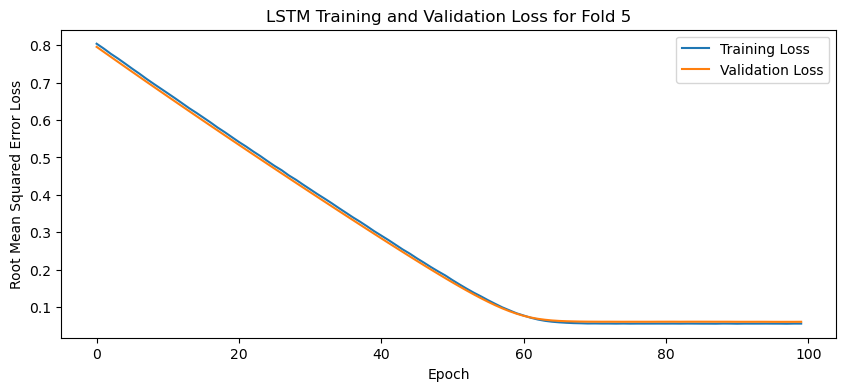

[I 2025-05-09 19:20:54,974] Trial 27 finished with value: 0.042612826079130174 and parameters: {'lr': 0.006455689863923896, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3678768493669653}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04282103478908539, 0.04244599491357803, 0.042571570724248886, 0.0426345095038414, 0.042591020464897156]
Mean Cross Validation Accuracy:
0.042612826079130174
Standard Deviation of Cross Validation Accuracy:
0.00012151638961586035


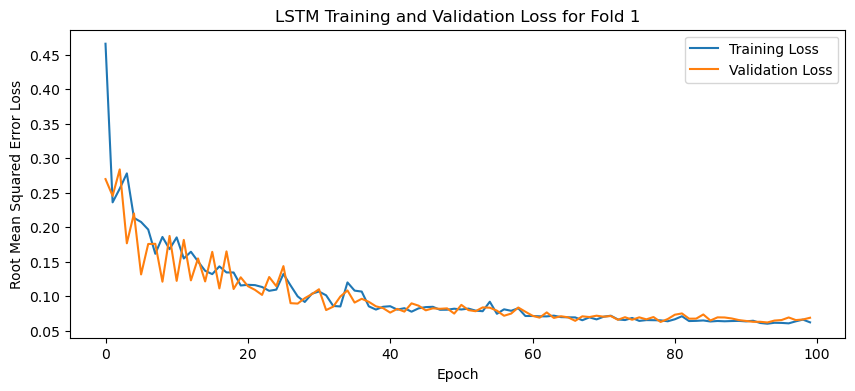

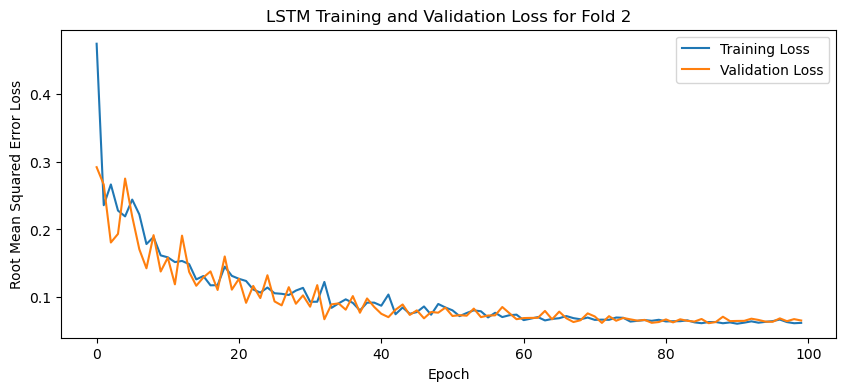

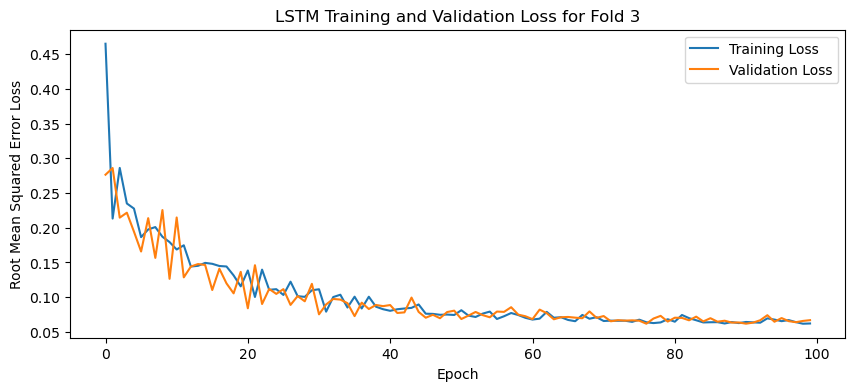

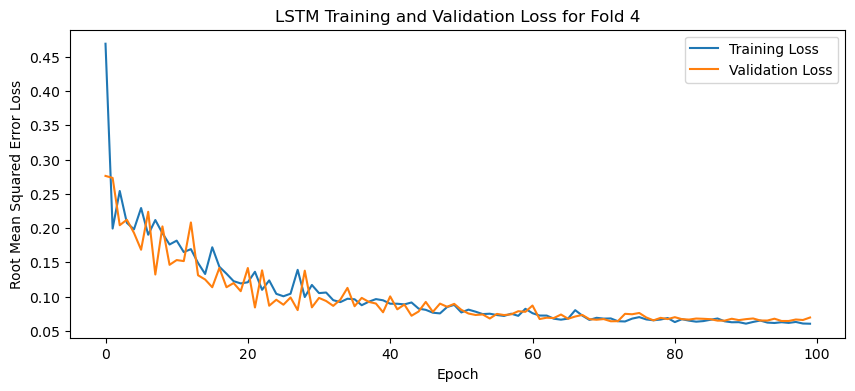

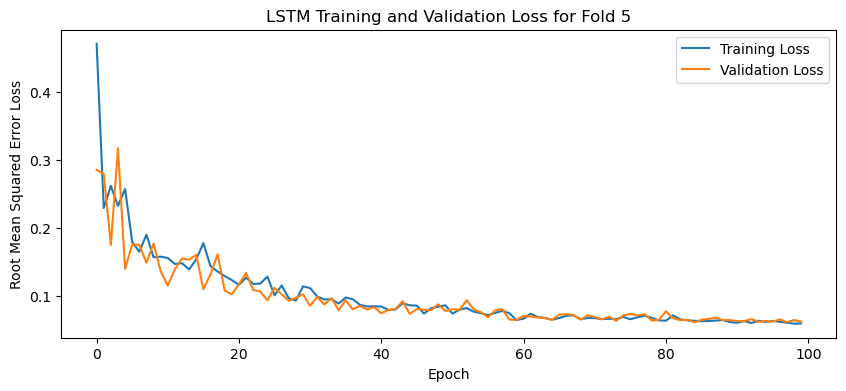

[I 2025-05-09 19:23:29,349] Trial 28 finished with value: 0.04608460962772369 and parameters: {'lr': 0.42989954609972664, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.29427004394990386}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04813242331147194, 0.04248850420117378, 0.047516535967588425, 0.04403812810778618, 0.048247456550598145]
Mean Cross Validation Accuracy:
0.04608460962772369
Standard Deviation of Cross Validation Accuracy:
0.0023682027610928895


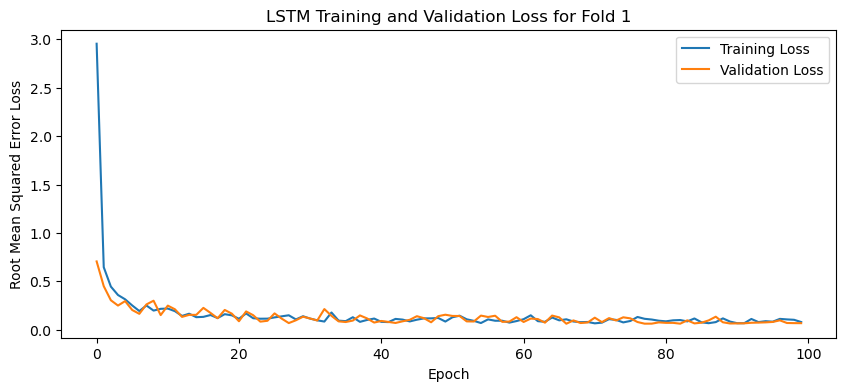

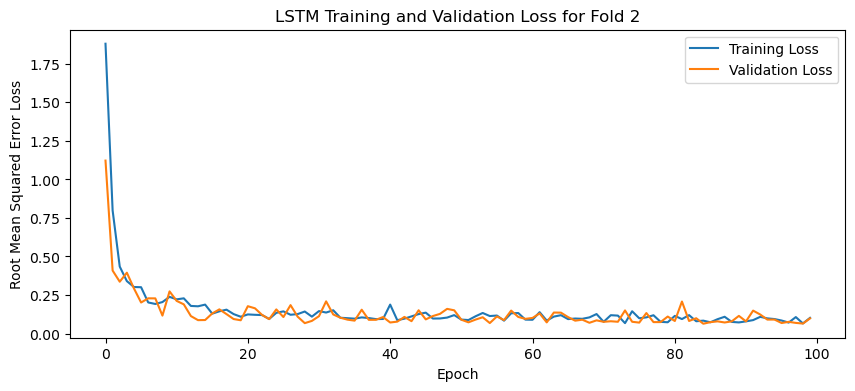

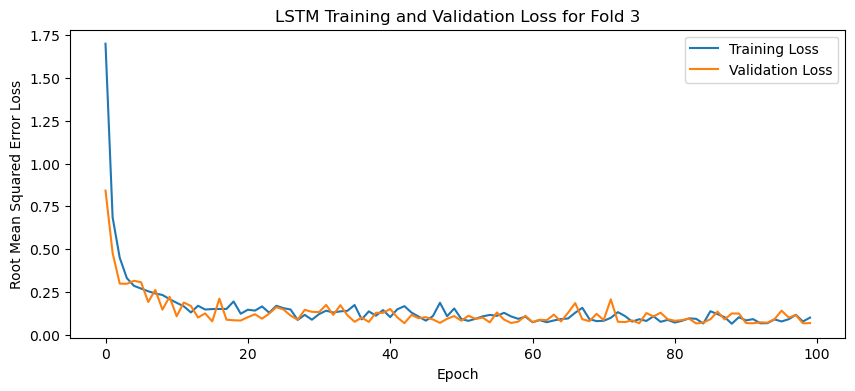

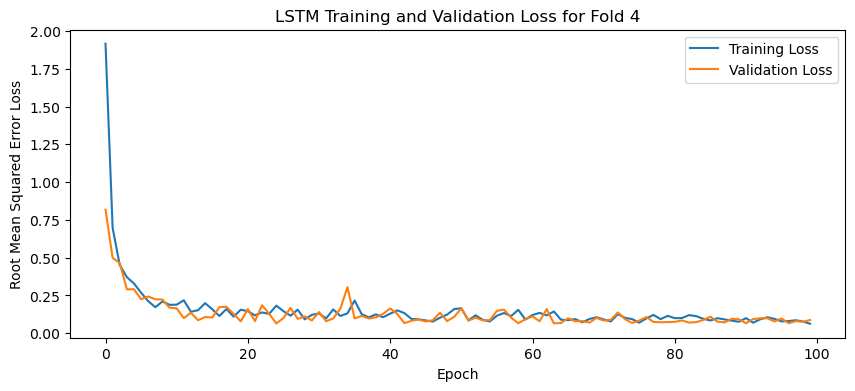

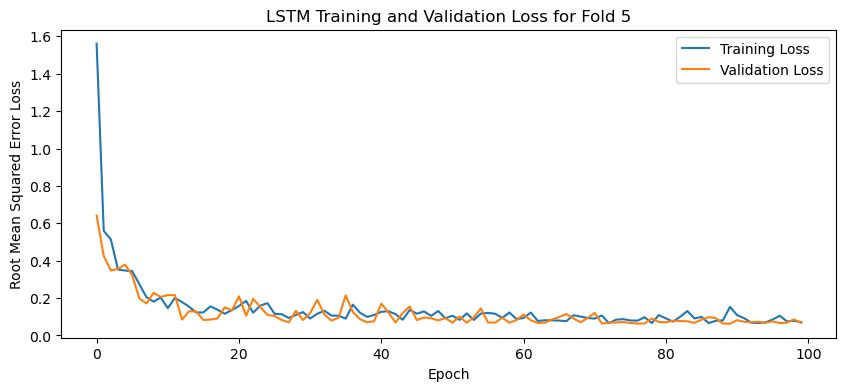

[I 2025-05-09 19:27:41,510] Trial 29 finished with value: 0.060889670997858046 and parameters: {'lr': 0.004312220523650818, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.4588243577732866}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.048605259507894516, 0.08395974338054657, 0.0463530458509922, 0.07428861409425735, 0.051241692155599594]
Mean Cross Validation Accuracy:
0.060889670997858046
Standard Deviation of Cross Validation Accuracy:
0.015277850947688564


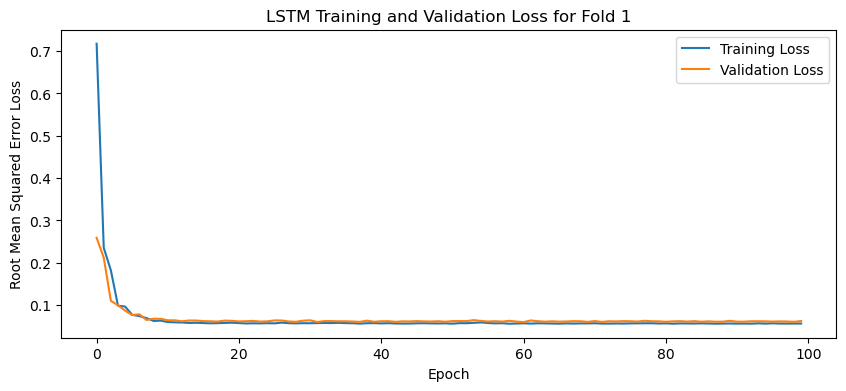

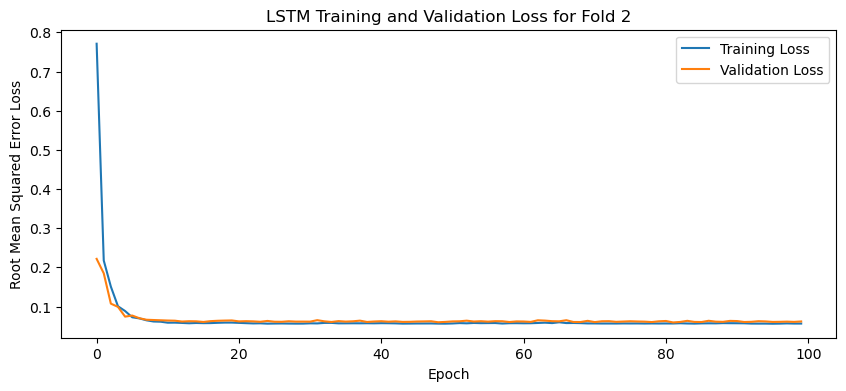

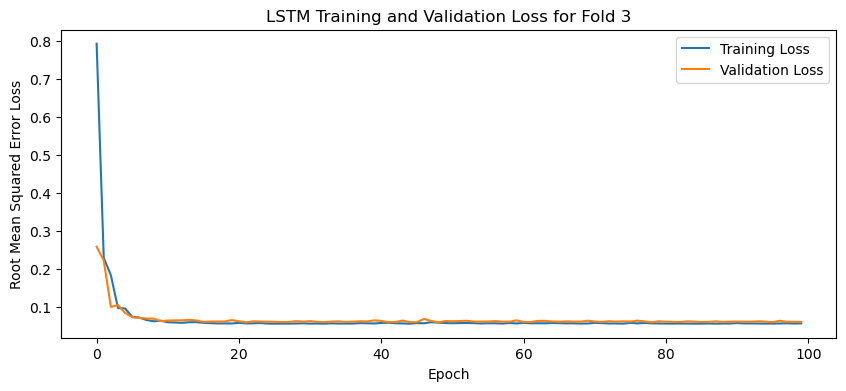

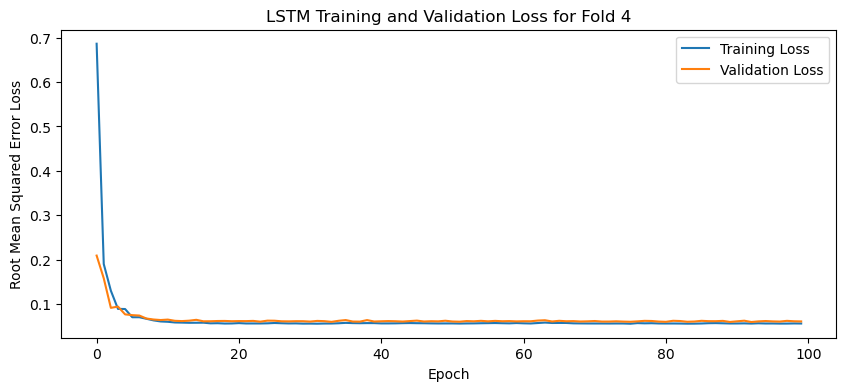

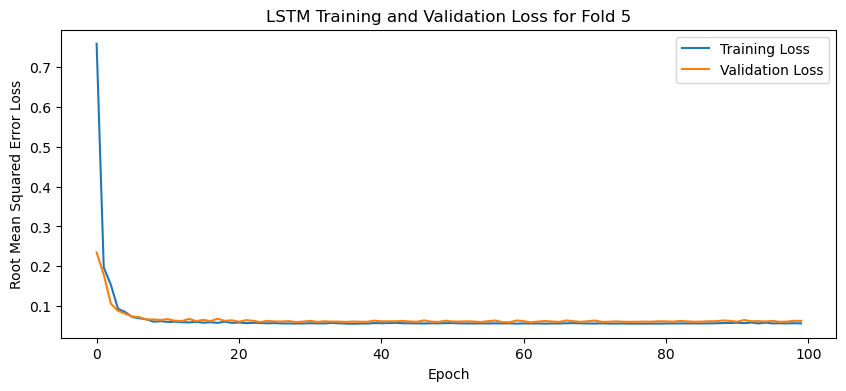

[I 2025-05-09 19:31:06,451] Trial 30 finished with value: 0.04358192235231399 and parameters: {'lr': 0.019069908734043902, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.32336828878667556}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04094185307621956, 0.04275394231081009, 0.04402053728699684, 0.04404820129275322, 0.04614507779479027]
Mean Cross Validation Accuracy:
0.04358192235231399
Standard Deviation of Cross Validation Accuracy:
0.0017108525164505743


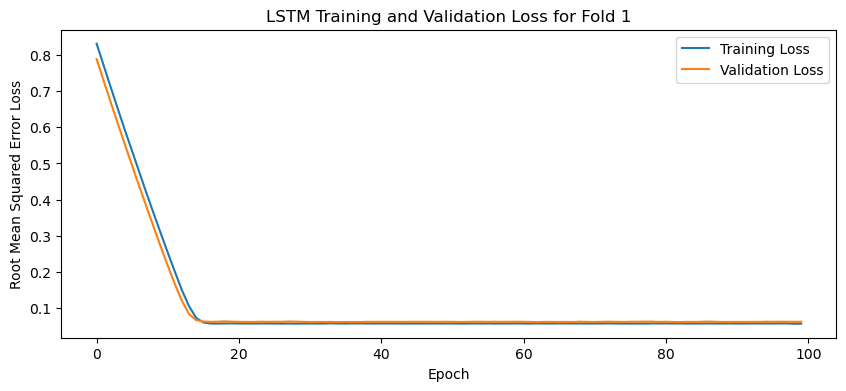

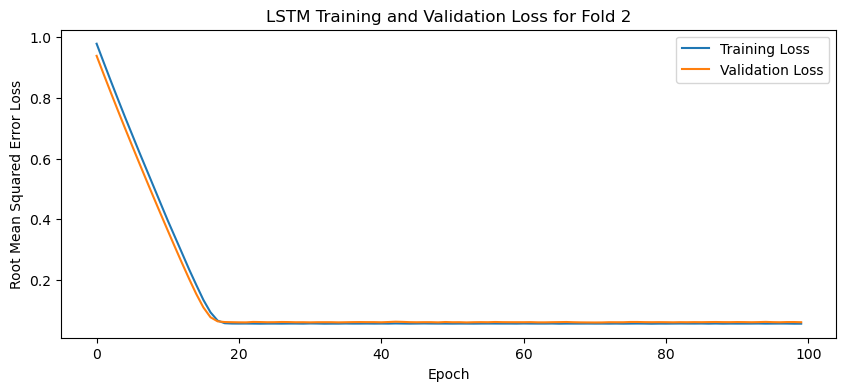

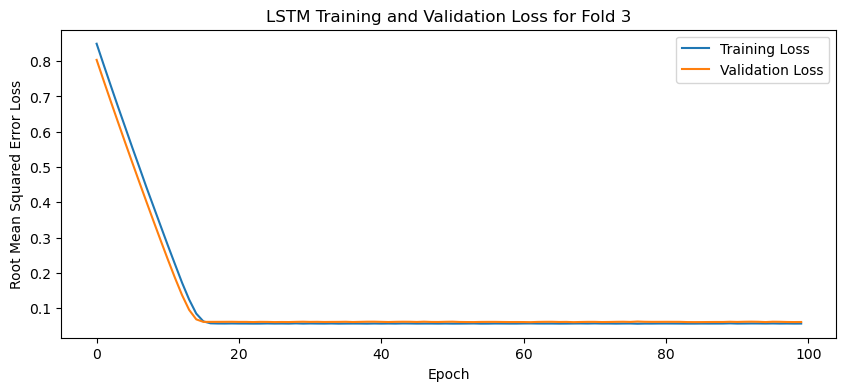

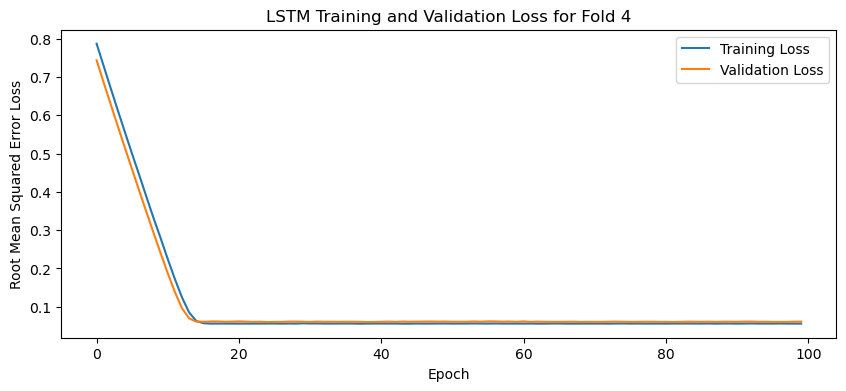

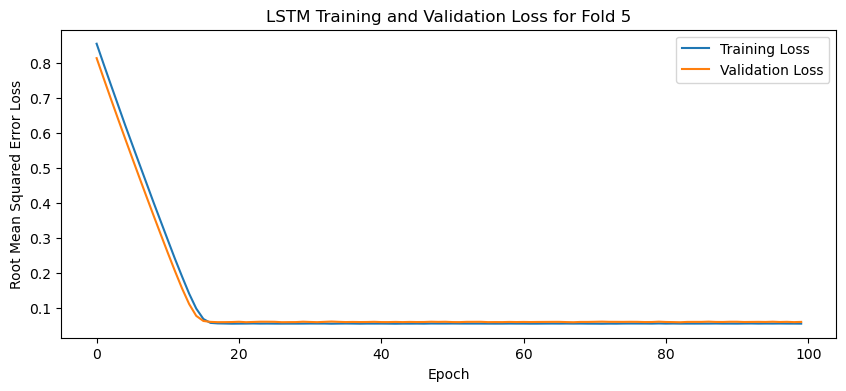

[I 2025-05-09 19:33:47,946] Trial 31 finished with value: 0.04262592047452927 and parameters: {'lr': 0.02923451188264517, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.46562923157502334}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04280365630984306, 0.04289339482784271, 0.04311510920524597, 0.04244529828429222, 0.04187214374542236]
Mean Cross Validation Accuracy:
0.04262592047452927
Standard Deviation of Cross Validation Accuracy:
0.00043433671363229


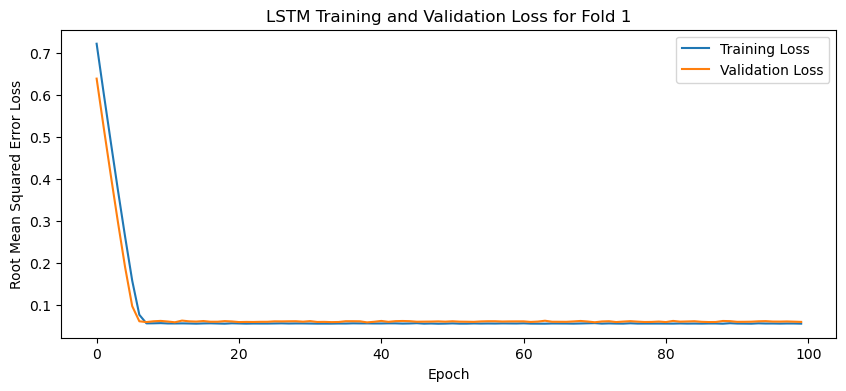

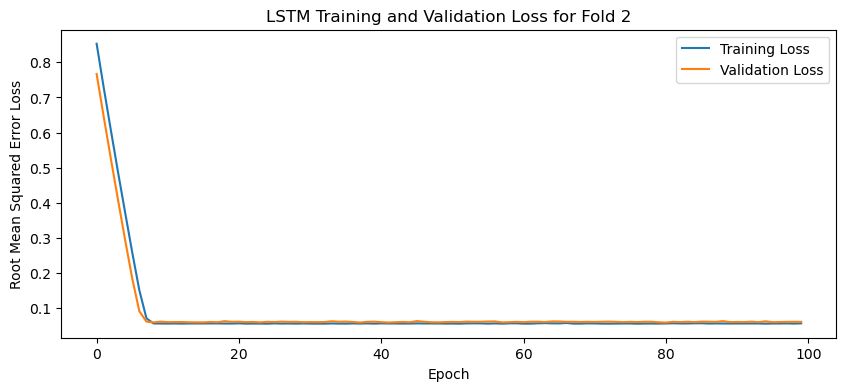

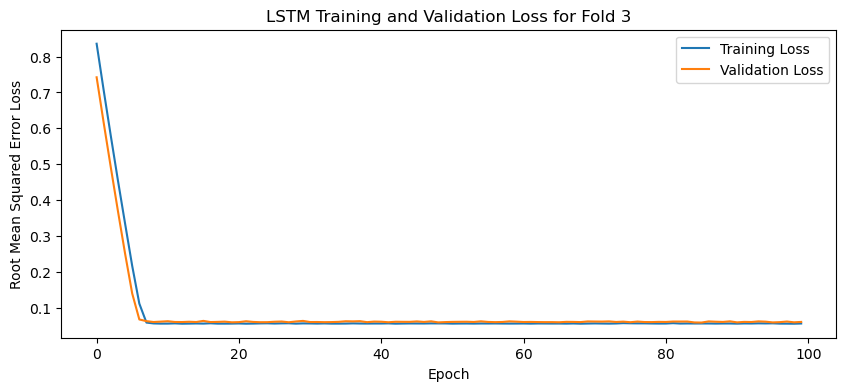

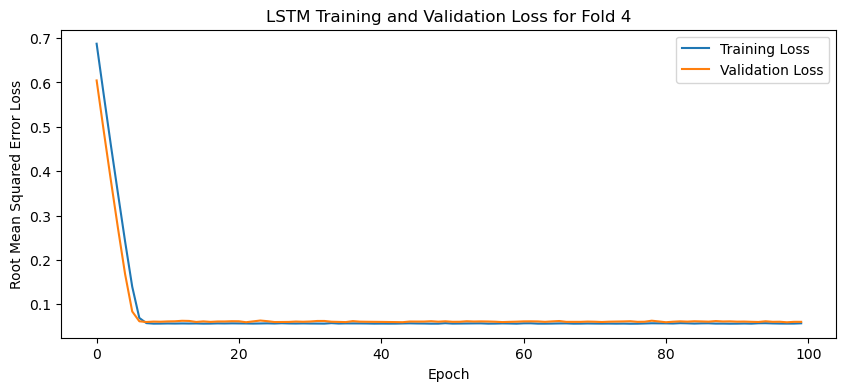

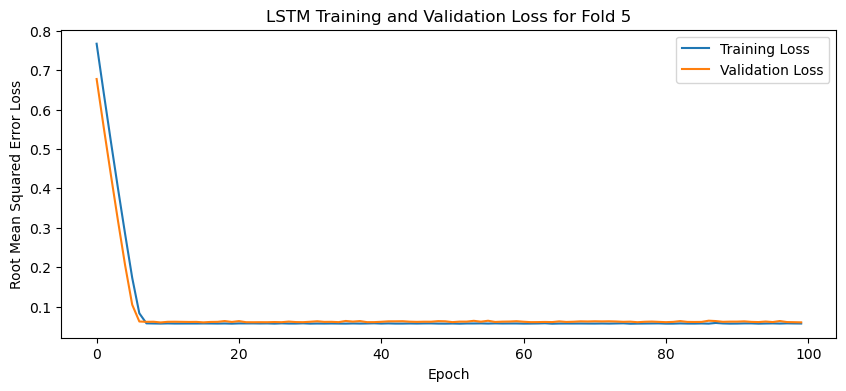

[I 2025-05-09 19:36:22,787] Trial 32 finished with value: 0.044932378083467485 and parameters: {'lr': 0.06156154132983197, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4667771768725546}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.043717943131923676, 0.04360233619809151, 0.04400197044014931, 0.04704608768224716, 0.046293552964925766]
Mean Cross Validation Accuracy:
0.044932378083467485
Standard Deviation of Cross Validation Accuracy:
0.0014443051877644764


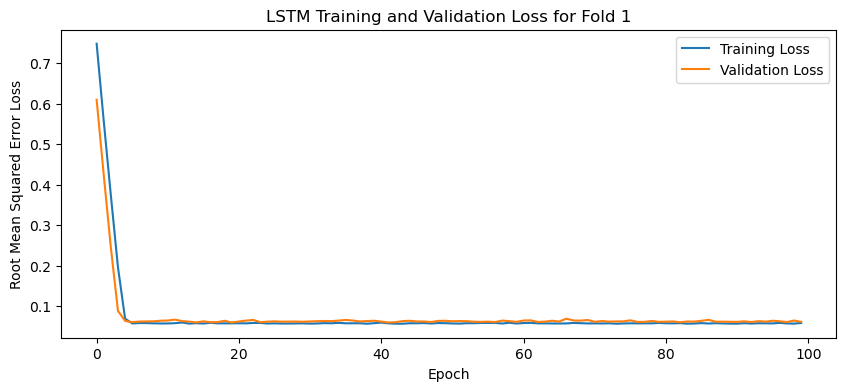

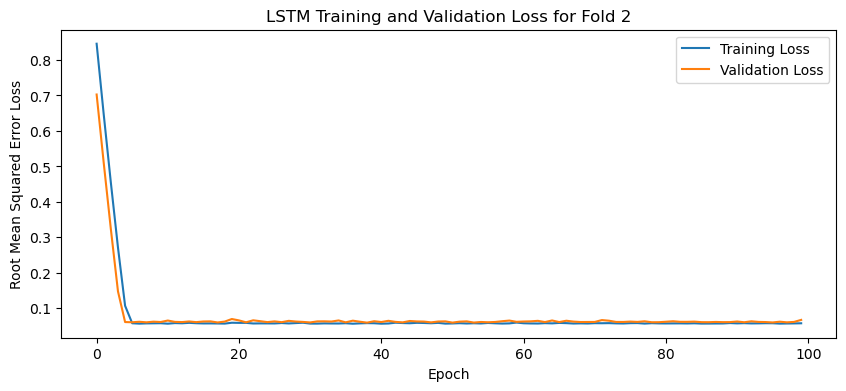

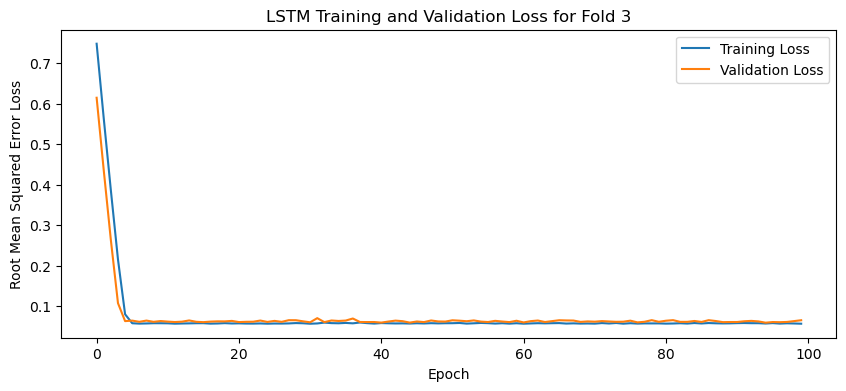

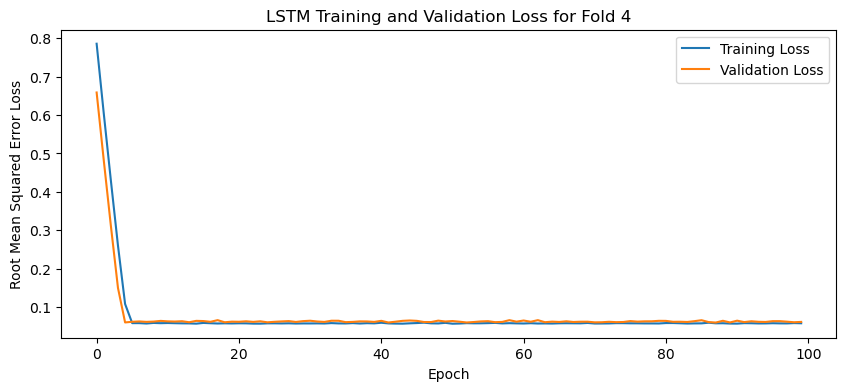

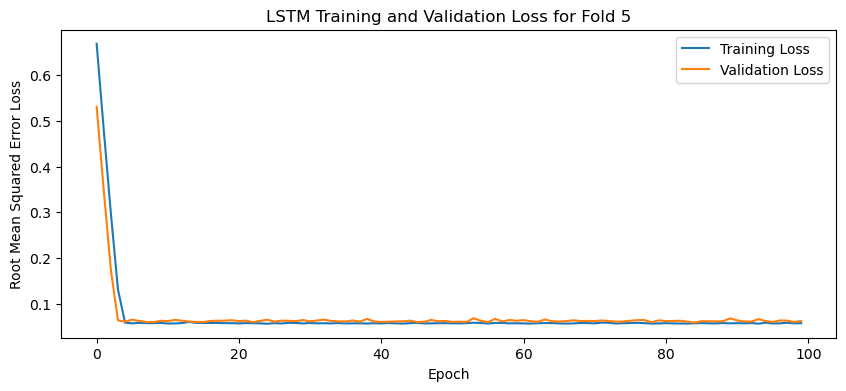

[I 2025-05-09 19:39:22,086] Trial 33 finished with value: 0.04307035356760025 and parameters: {'lr': 0.09393266057740626, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.41813648660643704}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04720788821578026, 0.038651417940855026, 0.040202293545007706, 0.04610058292746544, 0.04318958520889282]
Mean Cross Validation Accuracy:
0.04307035356760025
Standard Deviation of Cross Validation Accuracy:
0.003288417841122874


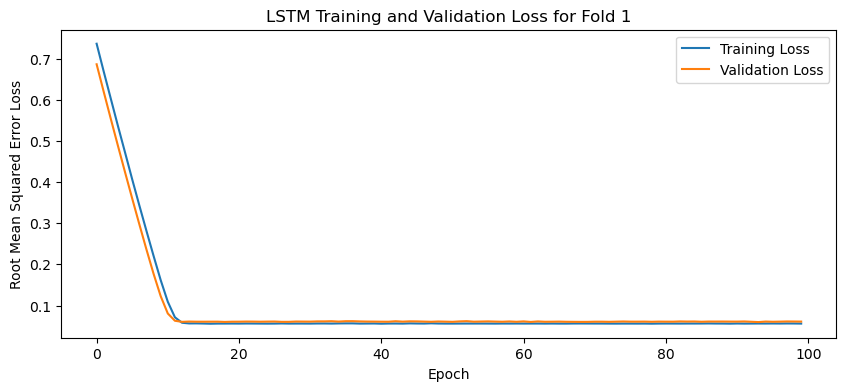

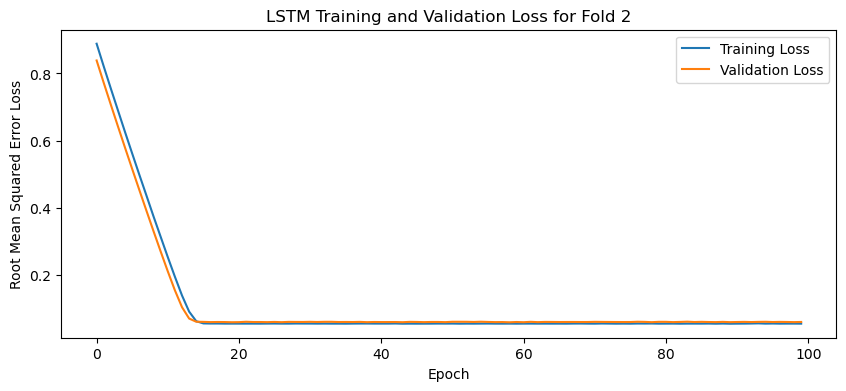

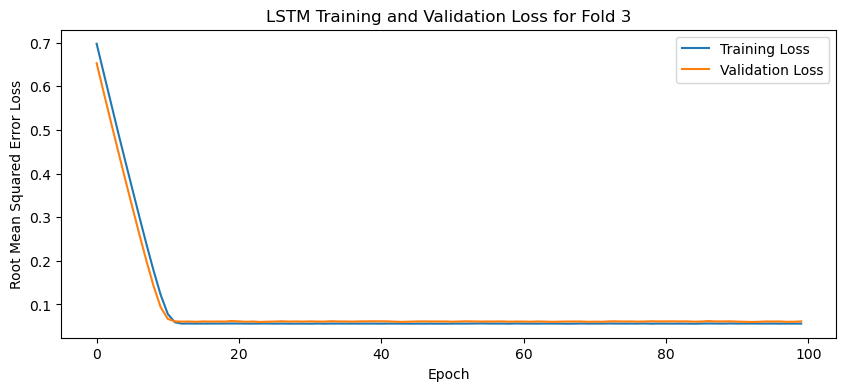

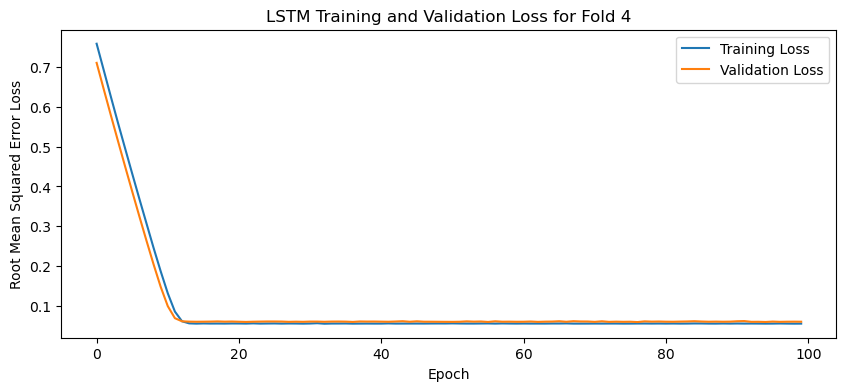

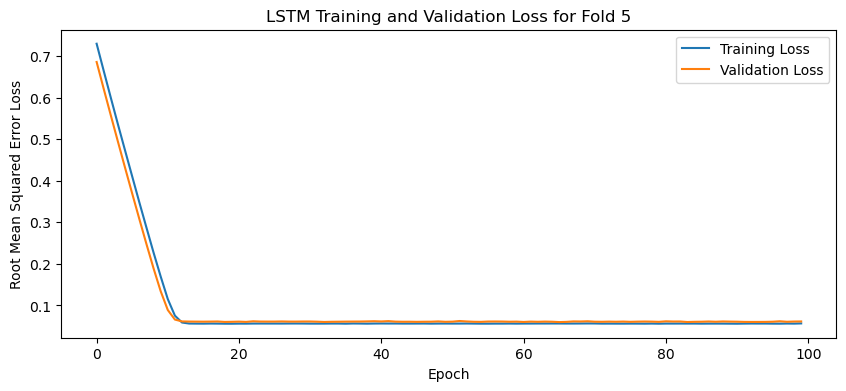

[I 2025-05-09 19:42:23,517] Trial 34 finished with value: 0.04254016652703285 and parameters: {'lr': 0.03351821127548981, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.37795476286368745}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.042341478168964386, 0.04240581765770912, 0.042507875710725784, 0.04339693859219551, 0.04204872250556946]
Mean Cross Validation Accuracy:
0.04254016652703285
Standard Deviation of Cross Validation Accuracy:
0.00045478455932748744


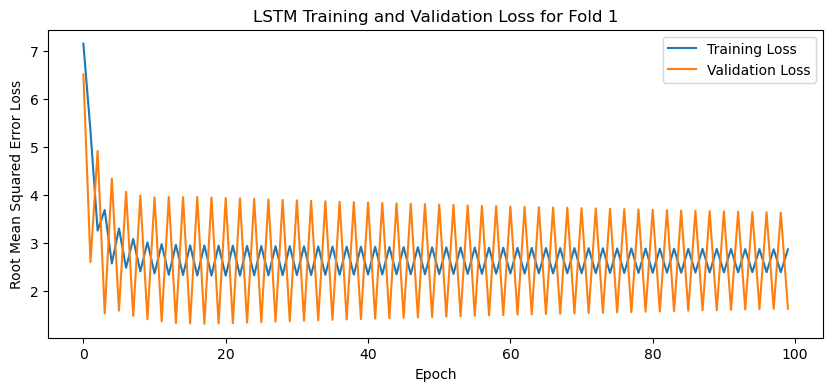

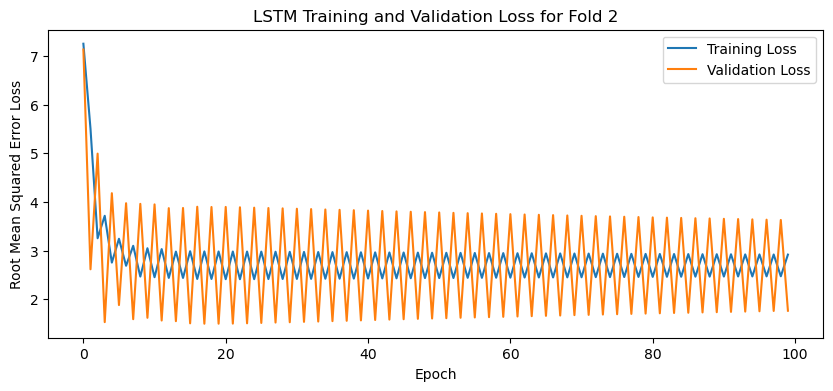

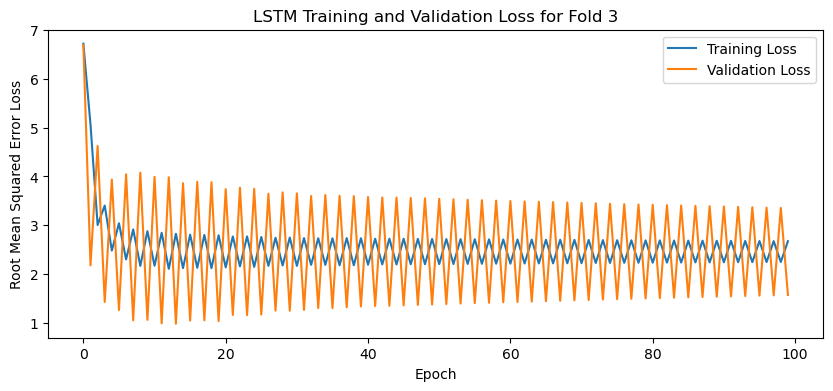

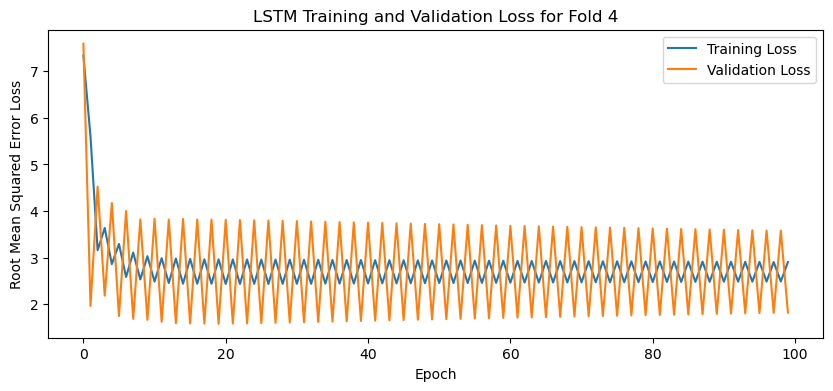

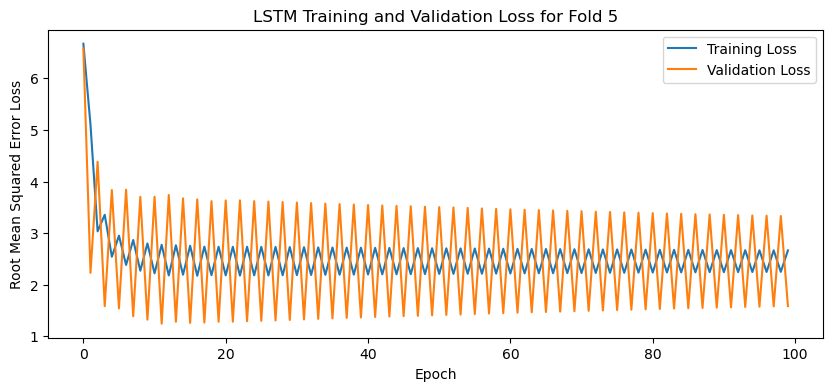

[I 2025-05-09 19:47:04,782] Trial 35 finished with value: 1.6792102575302124 and parameters: {'lr': 0.11982017412994407, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4398980466298932}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[1.648530125617981, 1.7636443376541138, 1.5653777122497559, 1.8273391723632812, 1.5911599397659302]
Mean Cross Validation Accuracy:
1.6792102575302124
Standard Deviation of Cross Validation Accuracy:
0.10072066978883942


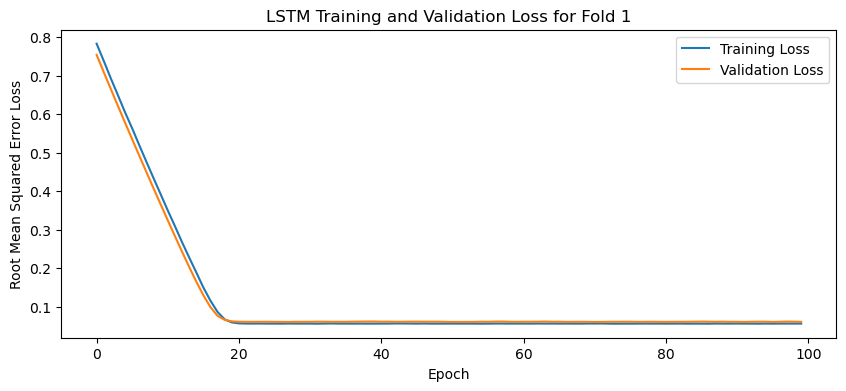

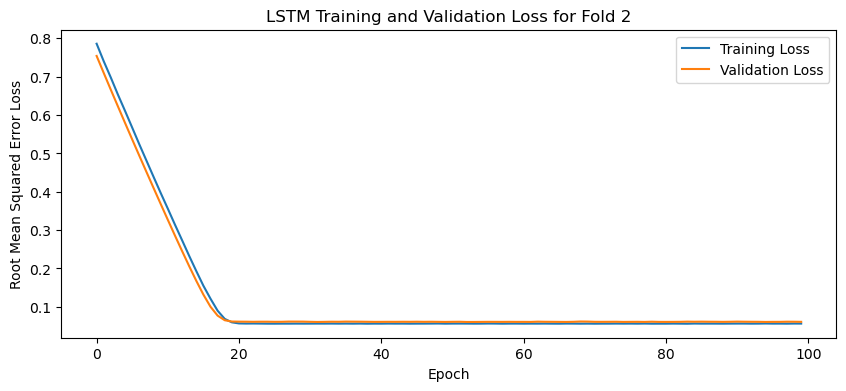

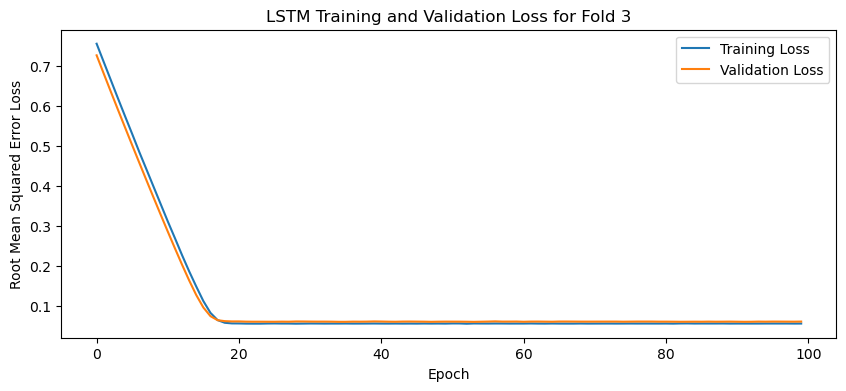

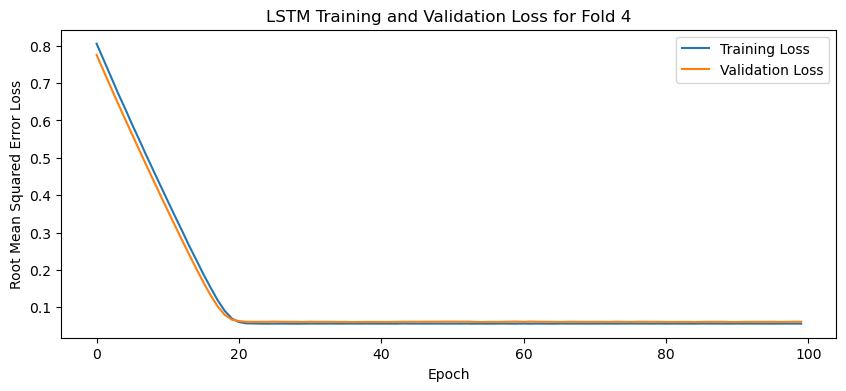

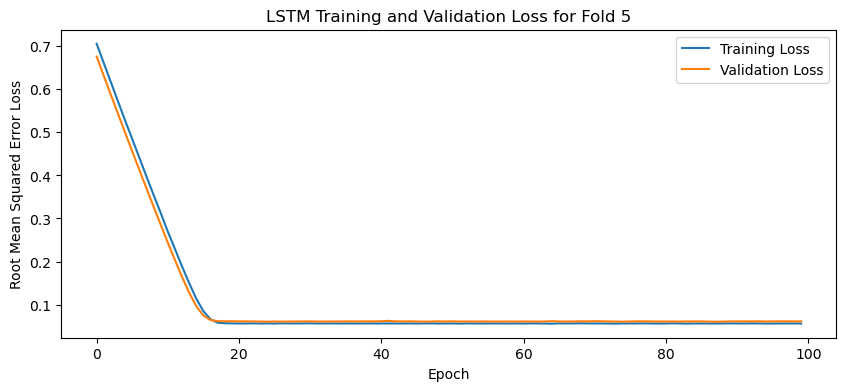

[I 2025-05-09 19:48:41,651] Trial 36 finished with value: 0.042609307914972305 and parameters: {'lr': 0.021928691020665136, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.462700376763308}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.042925819754600525, 0.04308412969112396, 0.04246395826339722, 0.04216008633375168, 0.042412545531988144]
Mean Cross Validation Accuracy:
0.042609307914972305
Standard Deviation of Cross Validation Accuracy:
0.0003427177991694099


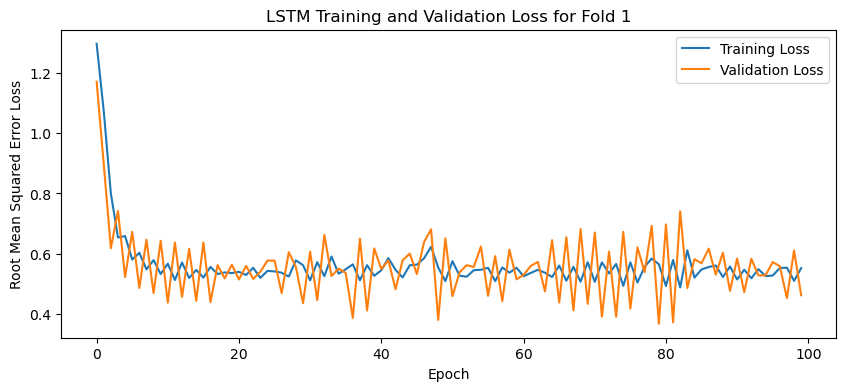

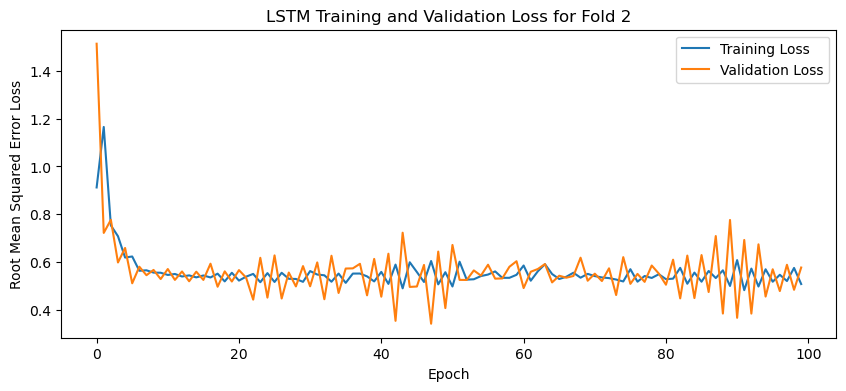

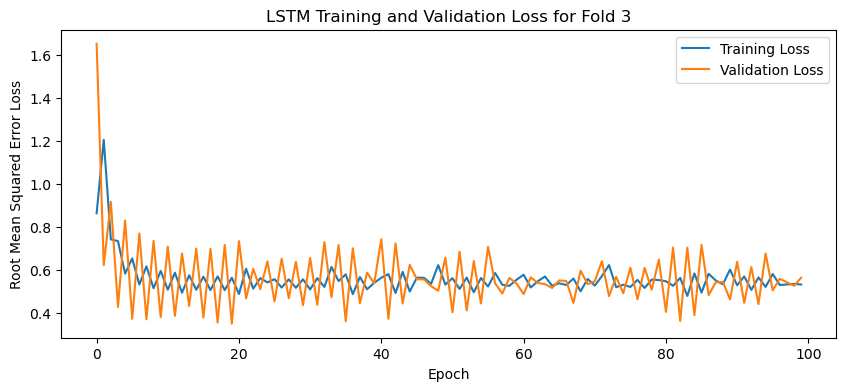

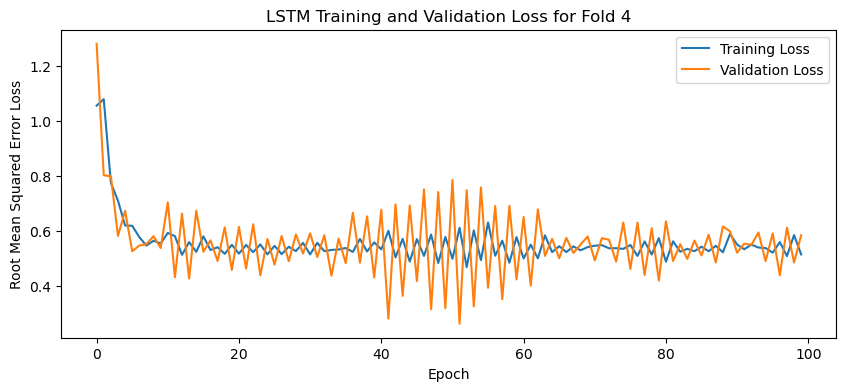

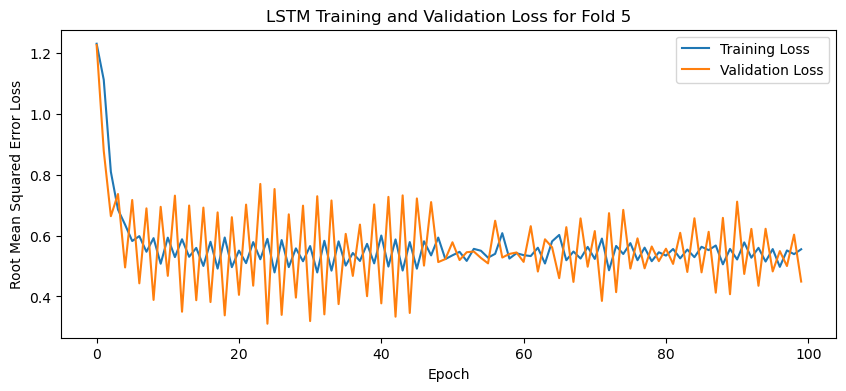

[I 2025-05-09 19:53:24,603] Trial 37 finished with value: 0.5277247130870819 and parameters: {'lr': 0.008282493646756197, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.19846469446786263}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.4554575979709625, 0.5750815272331238, 0.5708950161933899, 0.5885925889015198, 0.4485968351364136]
Mean Cross Validation Accuracy:
0.5277247130870819
Standard Deviation of Cross Validation Accuracy:
0.06212084709450991


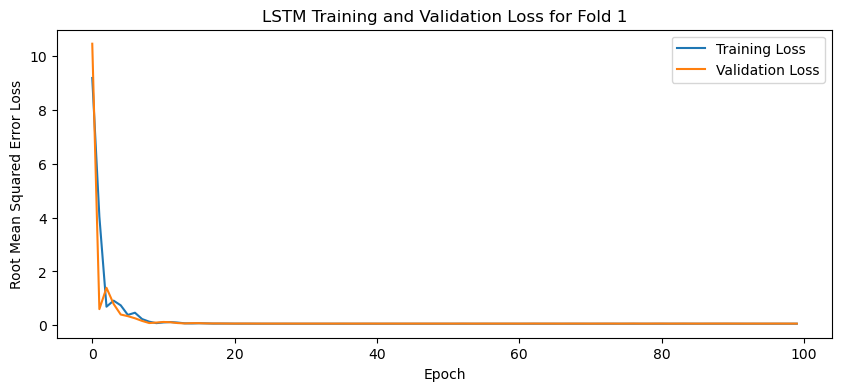

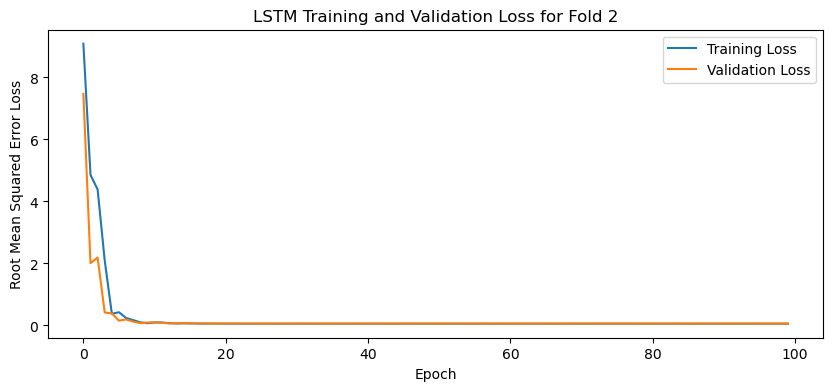

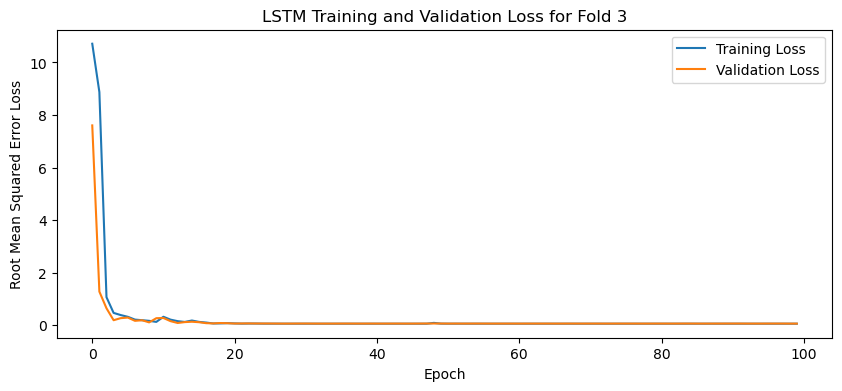

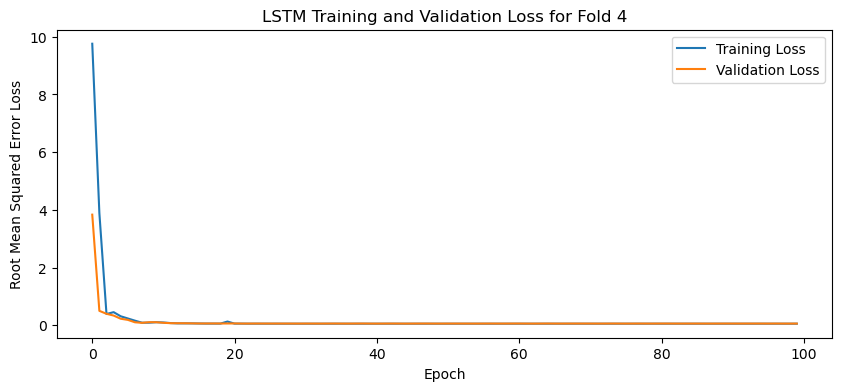

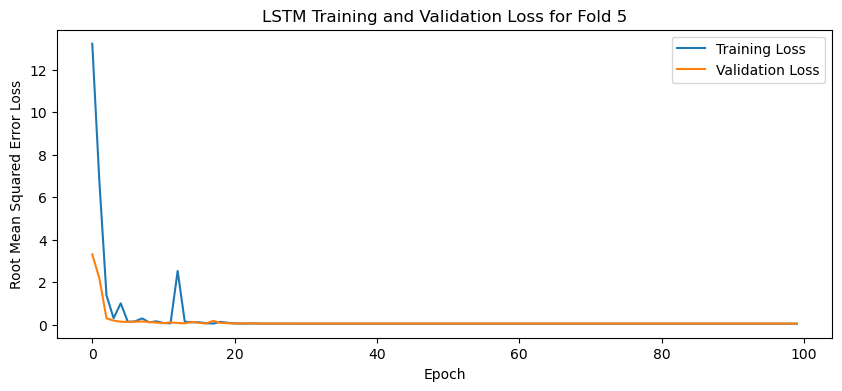

[I 2025-05-09 19:55:05,818] Trial 38 finished with value: 0.04412827491760254 and parameters: {'lr': 0.06215130635591324, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4170931602897756}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04461362957954407, 0.04483022168278694, 0.045336320996284485, 0.04353753477334976, 0.04232366755604744]
Mean Cross Validation Accuracy:
0.04412827491760254
Standard Deviation of Cross Validation Accuracy:
0.0010764065574540781


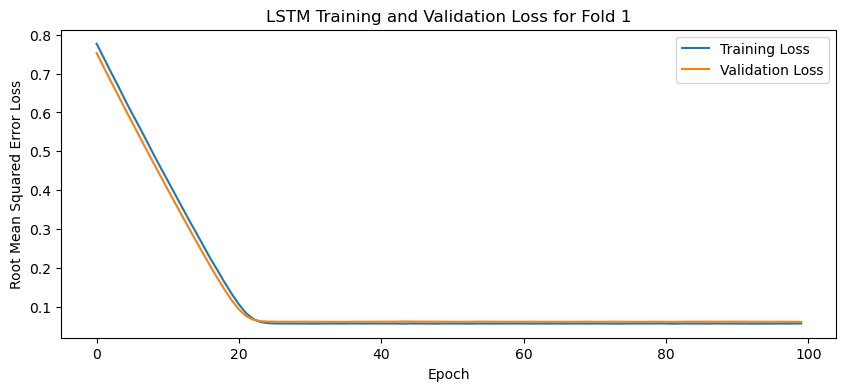

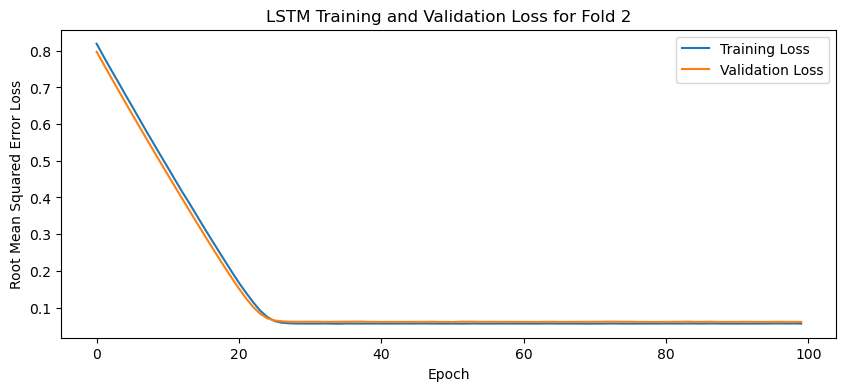

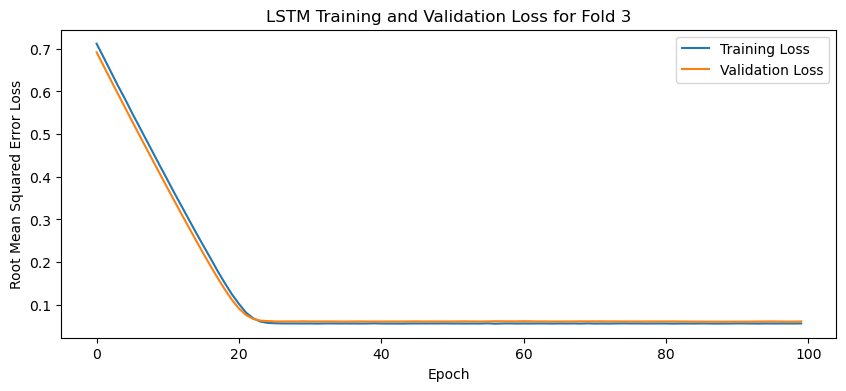

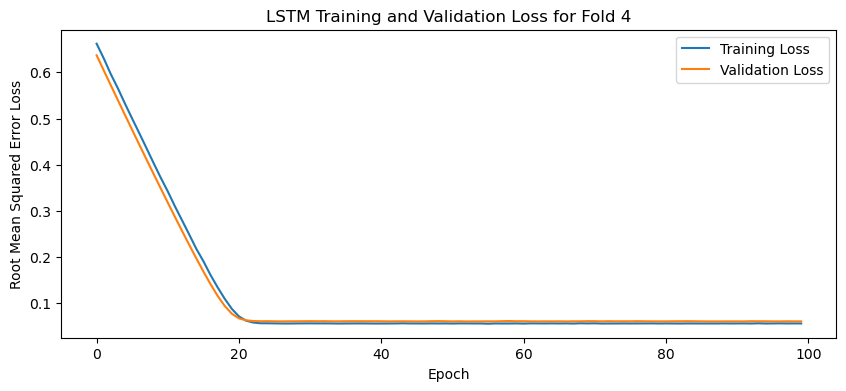

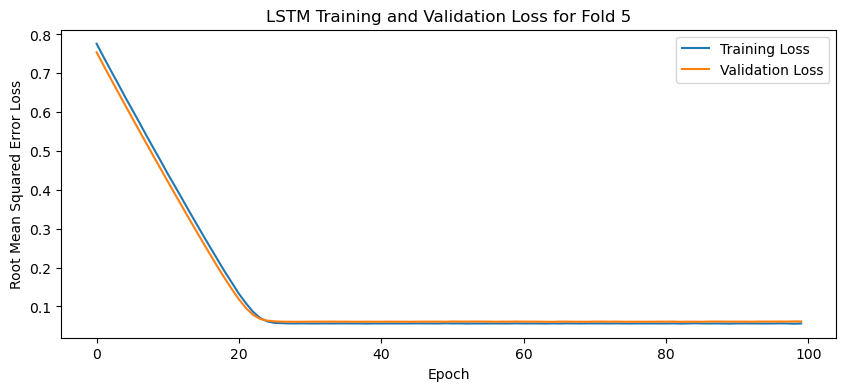

[I 2025-05-09 19:57:56,922] Trial 39 finished with value: 0.042663296312093736 and parameters: {'lr': 0.016606713821219827, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4789511201444056}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.043690696358680725, 0.04287218675017357, 0.04213402047753334, 0.04281183332204819, 0.04180774465203285]
Mean Cross Validation Accuracy:
0.042663296312093736
Standard Deviation of Cross Validation Accuracy:
0.0006531999489064398


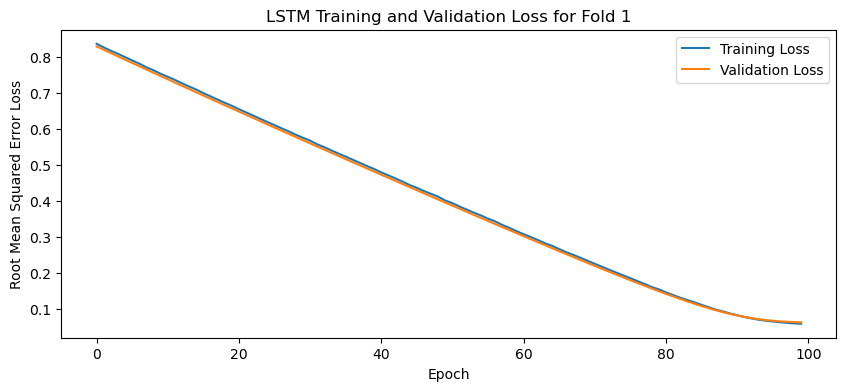

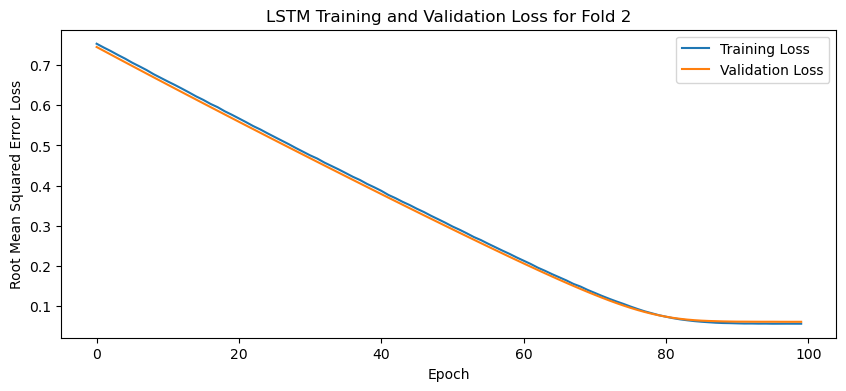

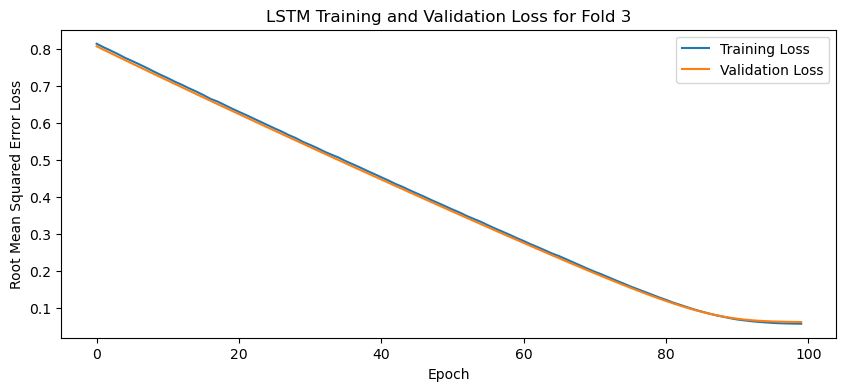

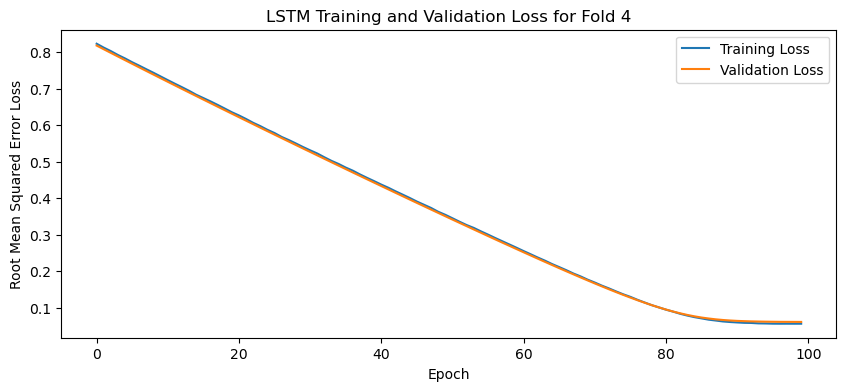

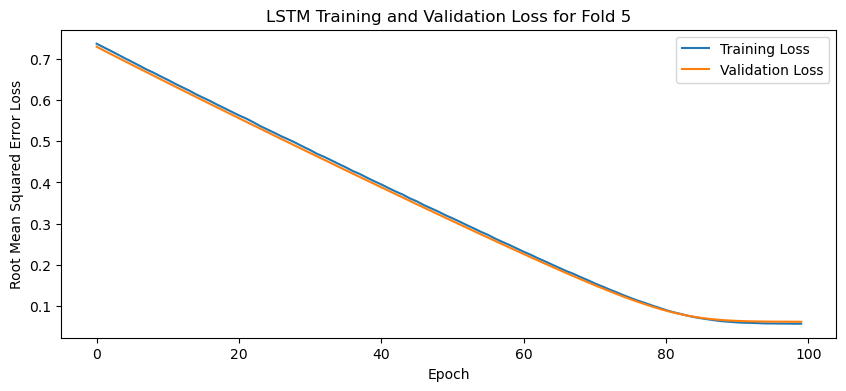

[I 2025-05-09 19:59:17,926] Trial 40 finished with value: 0.043254303932189944 and parameters: {'lr': 0.004438561997246336, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4385290509506343}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04470469430088997, 0.042640503495931625, 0.04365188628435135, 0.04280009865760803, 0.04247433692216873]
Mean Cross Validation Accuracy:
0.043254303932189944
Standard Deviation of Cross Validation Accuracy:
0.0008310362076466165


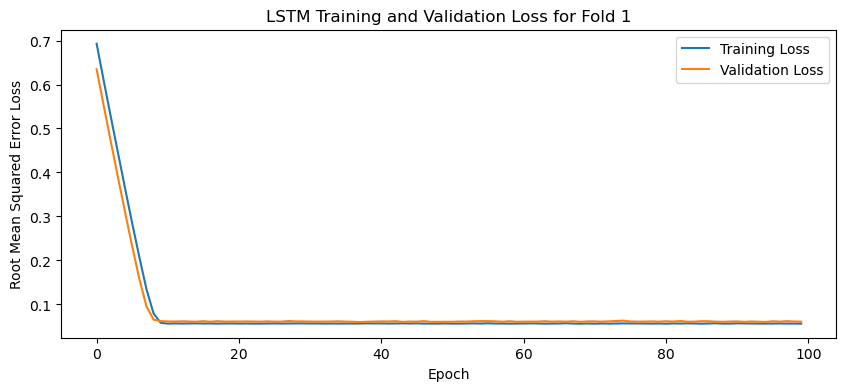

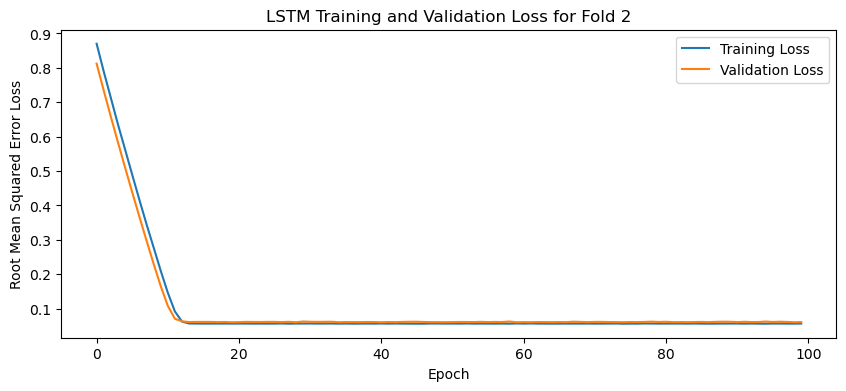

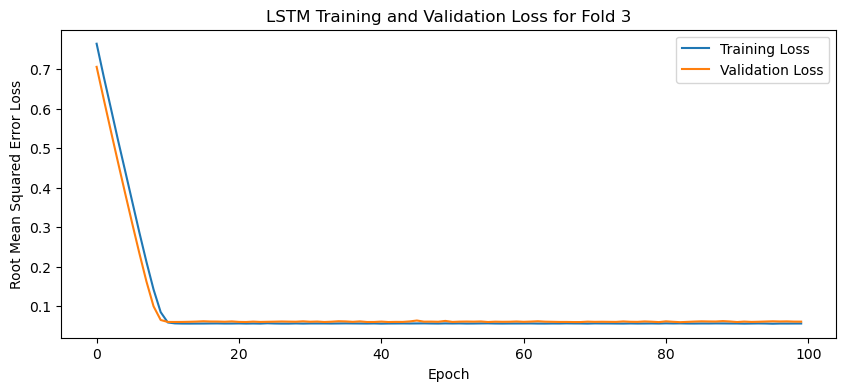

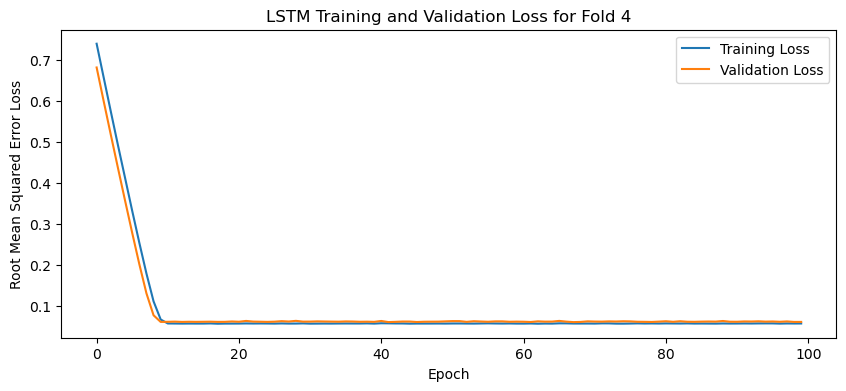

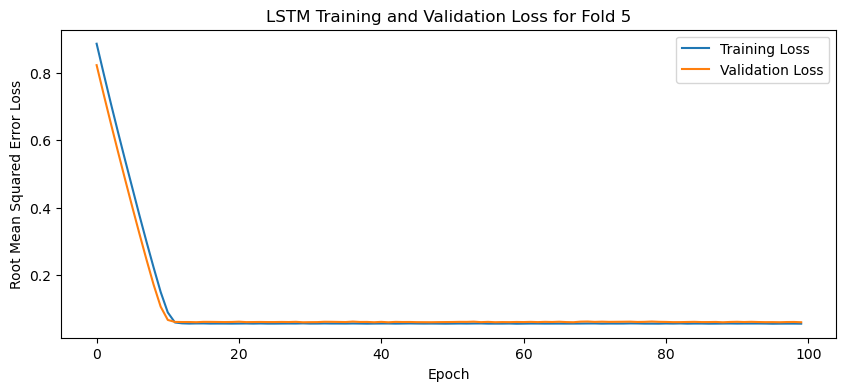

[I 2025-05-09 20:02:04,888] Trial 41 finished with value: 0.04318064525723457 and parameters: {'lr': 0.04184434315678916, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4565138947230828}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04290647432208061, 0.043329525738954544, 0.04244796931743622, 0.04347710311412811, 0.04374215379357338]
Mean Cross Validation Accuracy:
0.04318064525723457
Standard Deviation of Cross Validation Accuracy:
0.00045548396888914314


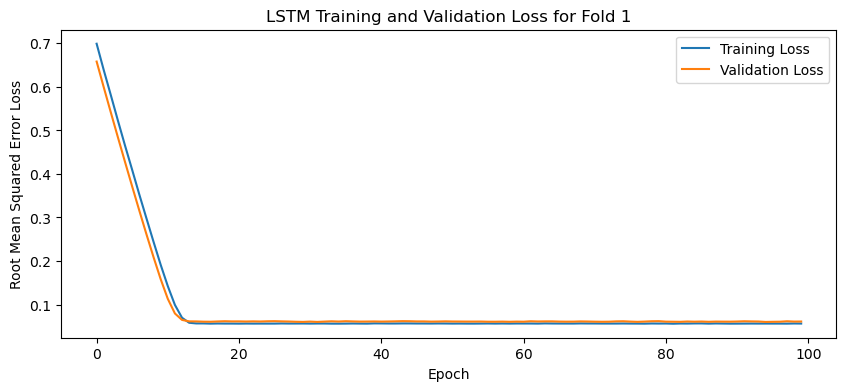

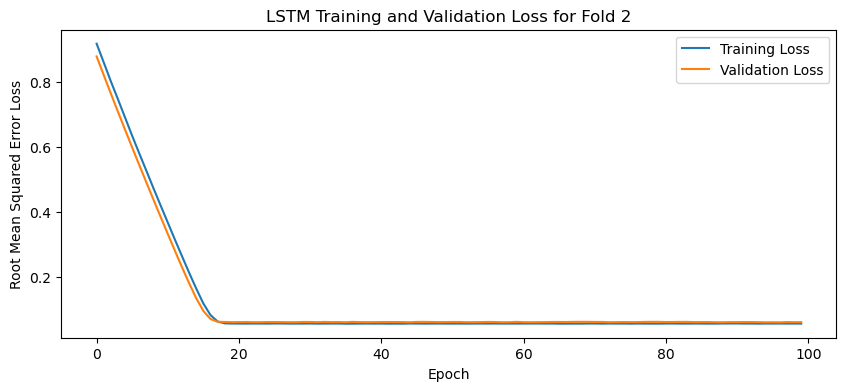

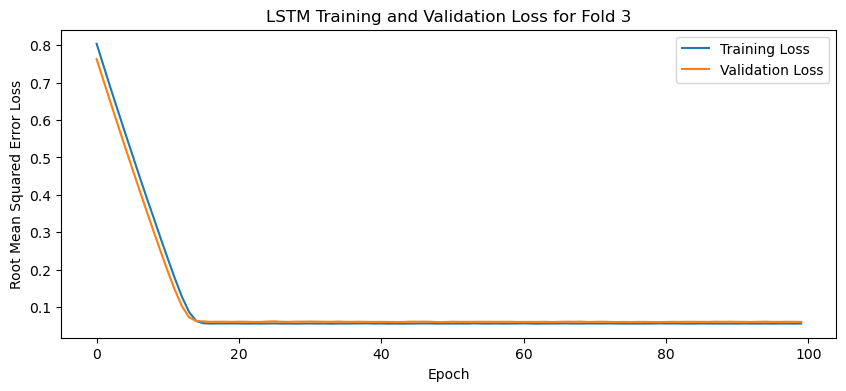

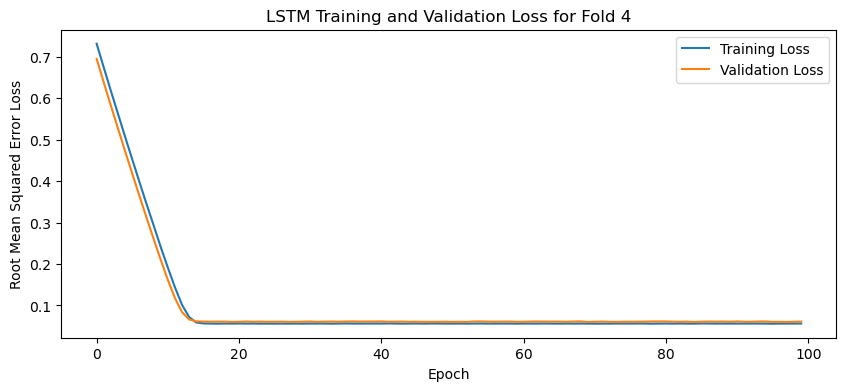

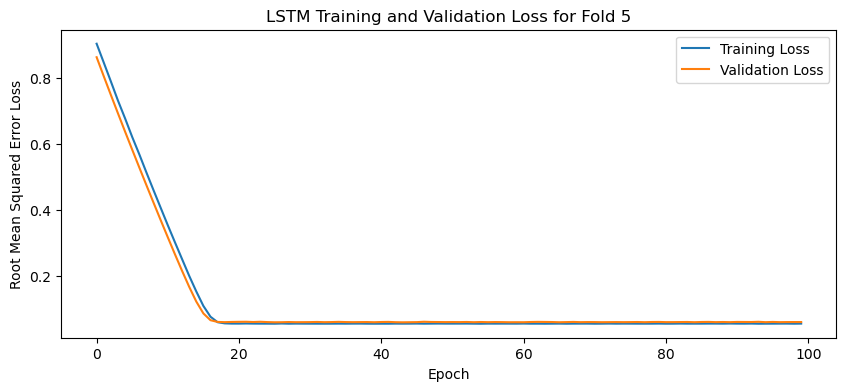

[I 2025-05-09 20:05:03,304] Trial 42 finished with value: 0.04286838248372078 and parameters: {'lr': 0.027974775925643874, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.47787039217499877}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.042417801916599274, 0.043080177158117294, 0.04287305846810341, 0.04295986145734787, 0.04301101341843605]
Mean Cross Validation Accuracy:
0.04286838248372078
Standard Deviation of Cross Validation Accuracy:
0.00023520785809739772


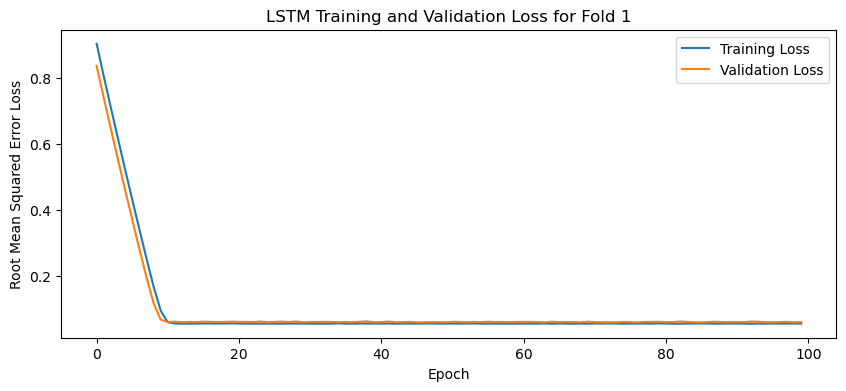

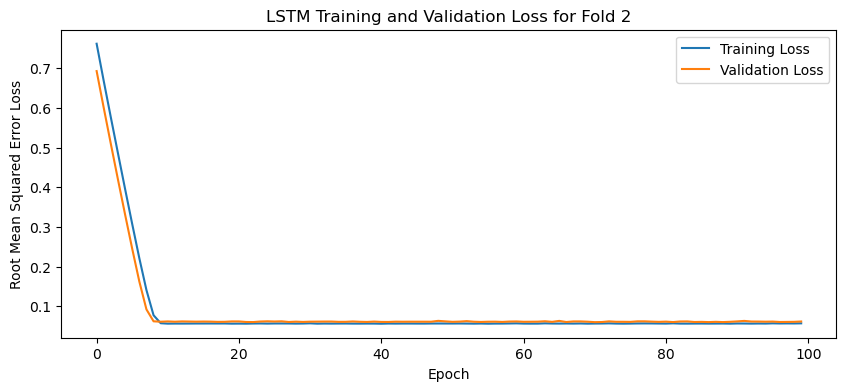

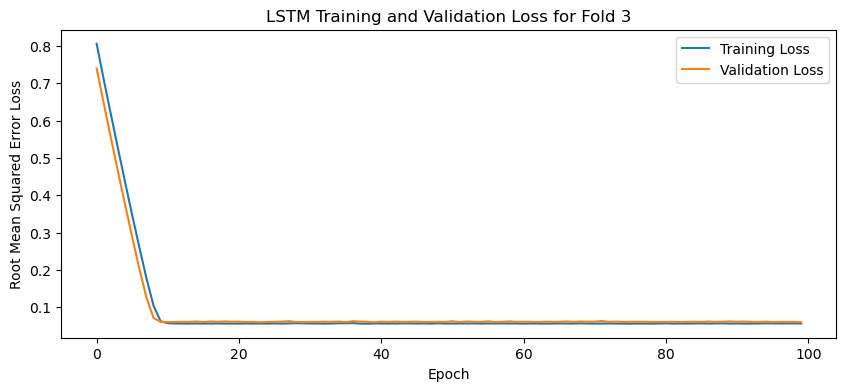

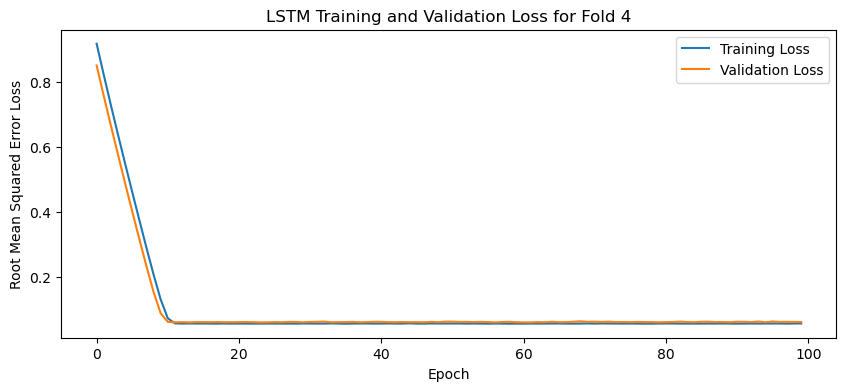

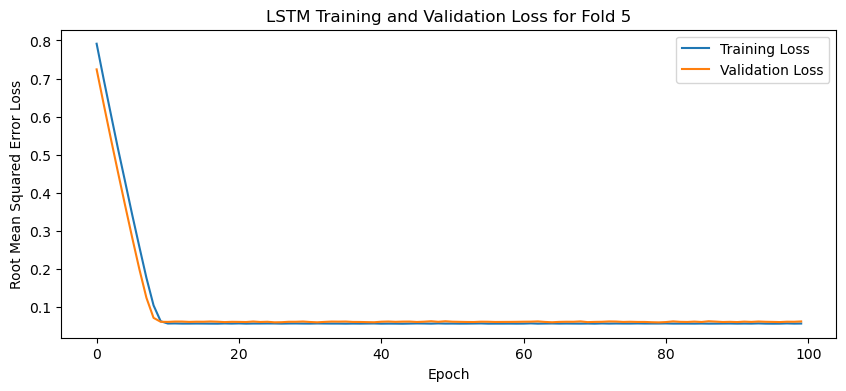

[I 2025-05-09 20:07:52,260] Trial 43 finished with value: 0.04313318356871605 and parameters: {'lr': 0.04656913863604103, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4493543195979019}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04305369034409523, 0.04171285405755043, 0.04536597058176994, 0.04312245175242424, 0.0424109511077404]
Mean Cross Validation Accuracy:
0.04313318356871605
Standard Deviation of Cross Validation Accuracy:
0.0012272512243447608


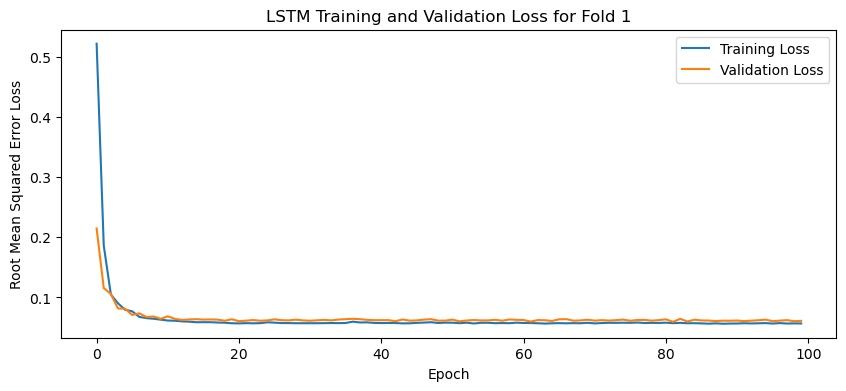

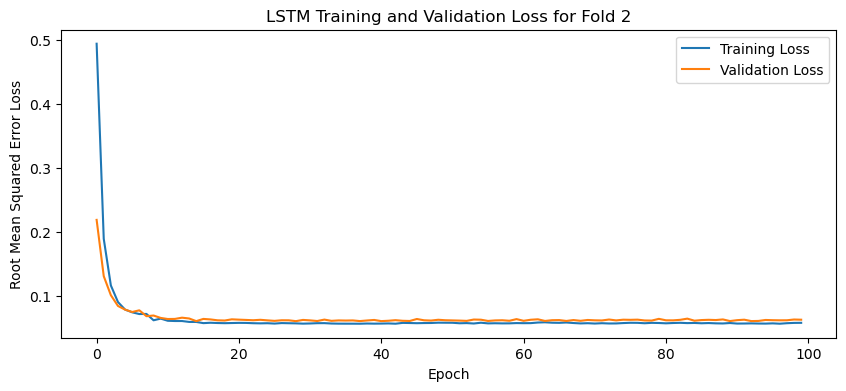

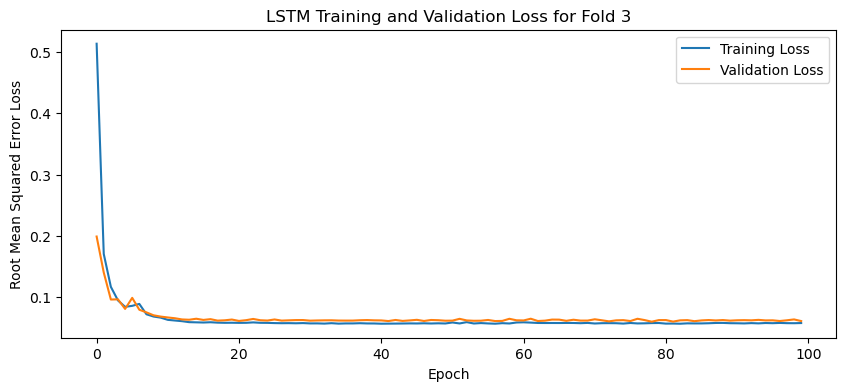

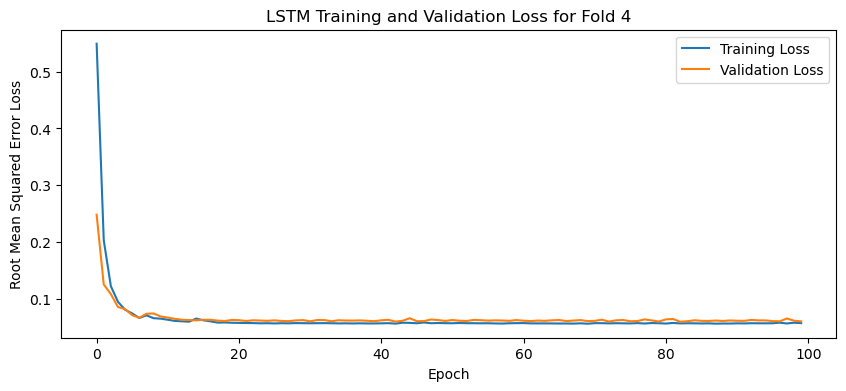

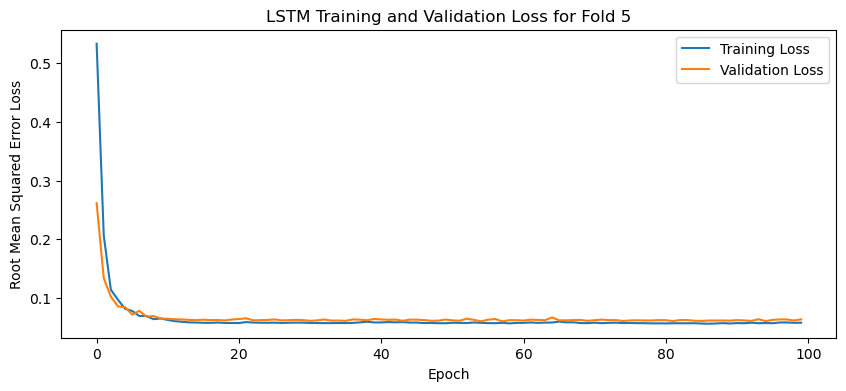

[I 2025-05-09 20:10:57,321] Trial 44 finished with value: 0.0452757827937603 and parameters: {'lr': 0.010288016099723008, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.42476945064941973}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.045684847980737686, 0.045050907880067825, 0.046145256608724594, 0.047303471714258194, 0.0421944297850132]
Mean Cross Validation Accuracy:
0.0452757827937603
Standard Deviation of Cross Validation Accuracy:
0.001707638515127738


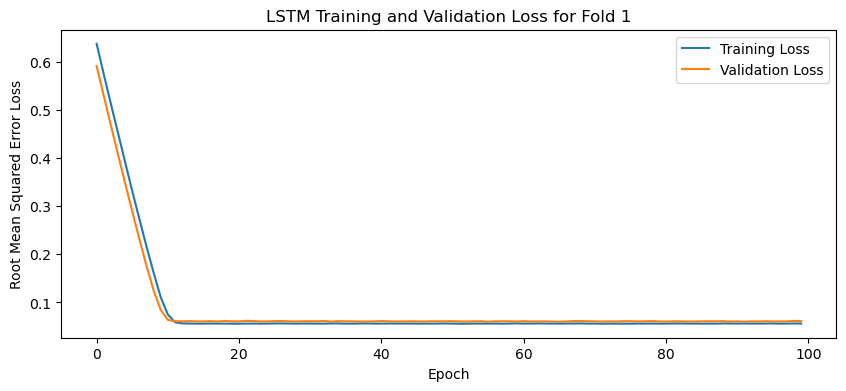

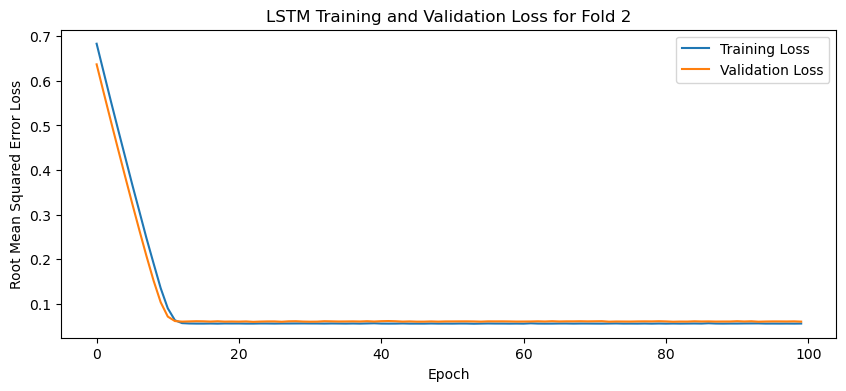

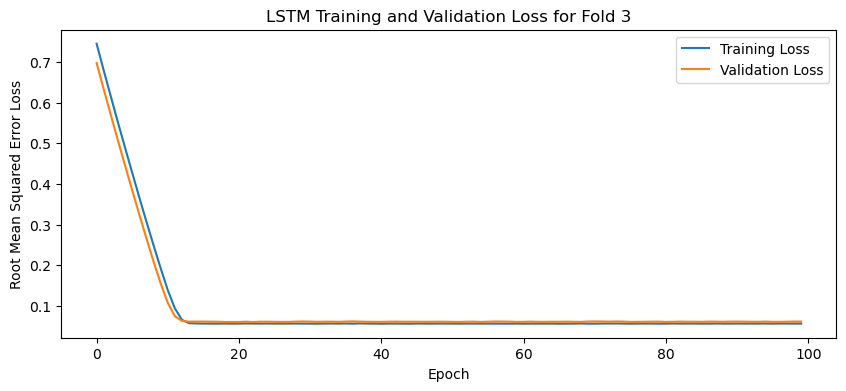

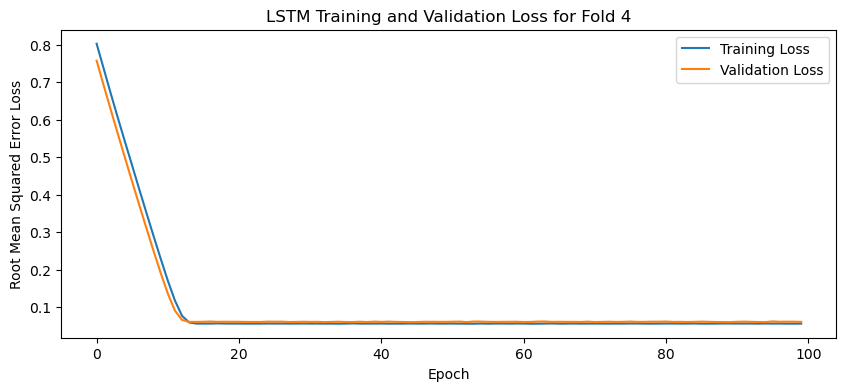

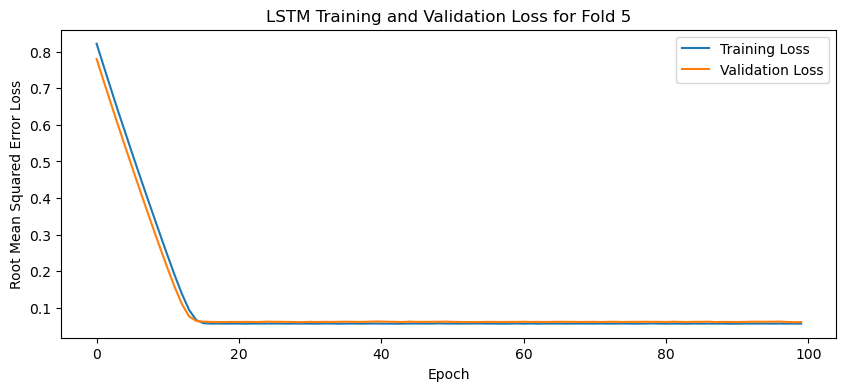

[I 2025-05-09 20:12:28,583] Trial 45 finished with value: 0.04265149980783463 and parameters: {'lr': 0.03174498023172892, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.398847592870754}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.041600197553634644, 0.04339553788304329, 0.042213600128889084, 0.04267522692680359, 0.04337293654680252]
Mean Cross Validation Accuracy:
0.04265149980783463
Standard Deviation of Cross Validation Accuracy:
0.0006887117191356603


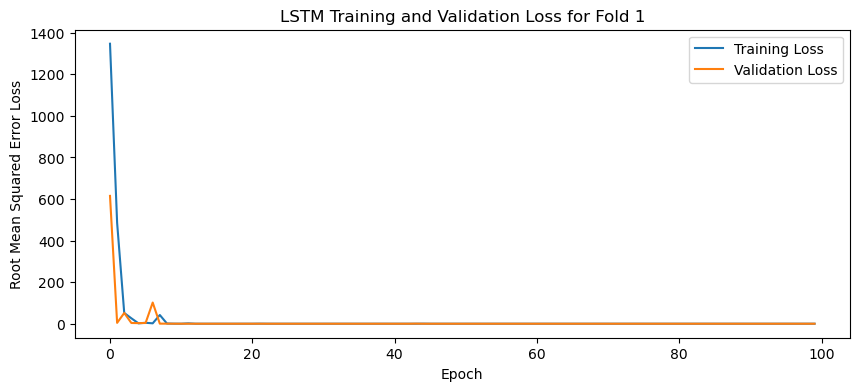

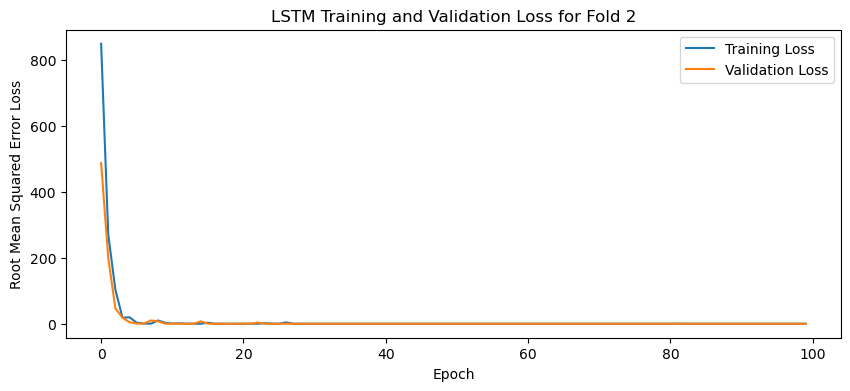

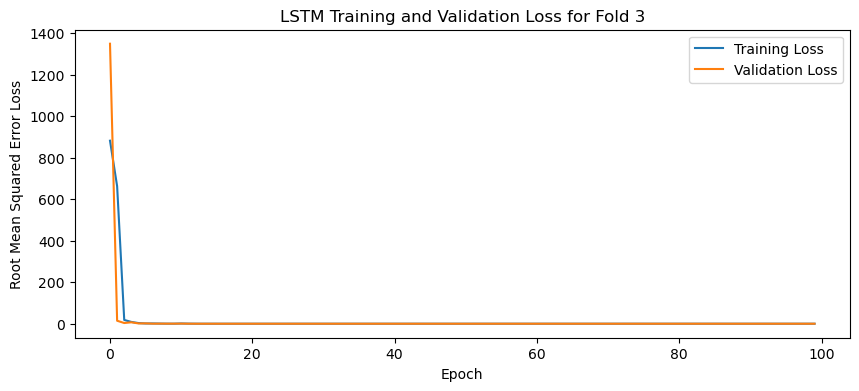

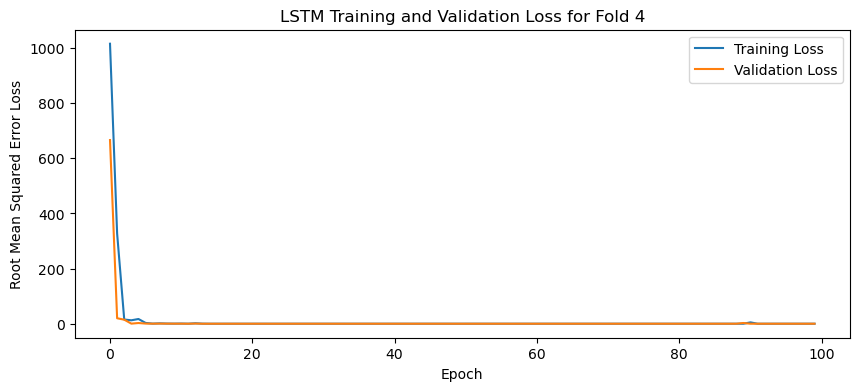

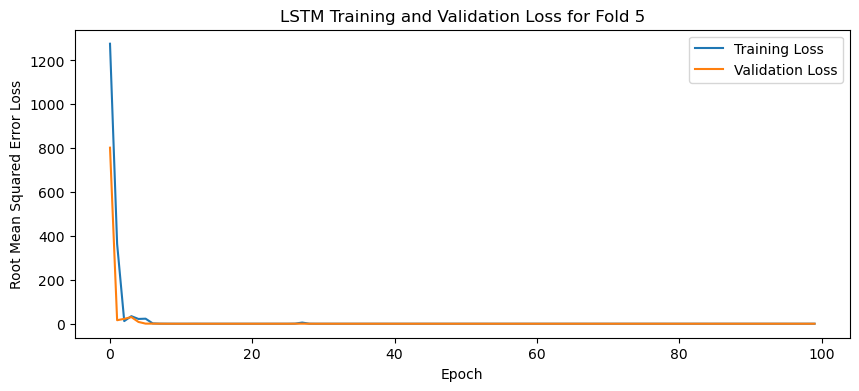

[I 2025-05-09 20:17:09,705] Trial 46 finished with value: 0.056801918894052505 and parameters: {'lr': 0.060335393870954906, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.4841655913563144}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.06445294618606567, 0.06242334470152855, 0.06005220487713814, 0.054901912808418274, 0.04217918589711189]
Mean Cross Validation Accuracy:
0.056801918894052505
Standard Deviation of Cross Validation Accuracy:
0.007976682883620157


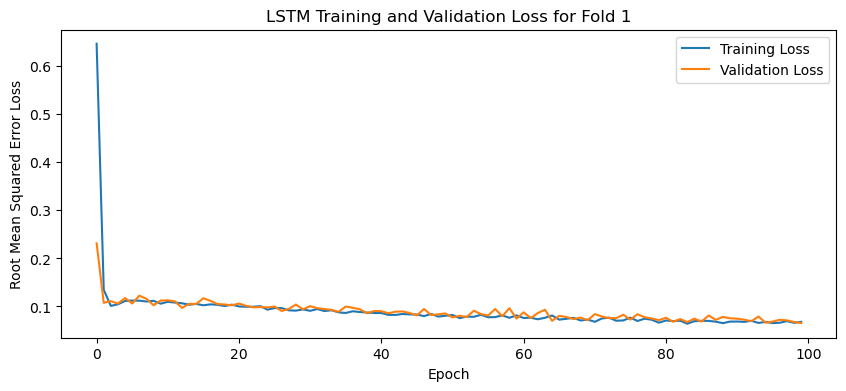

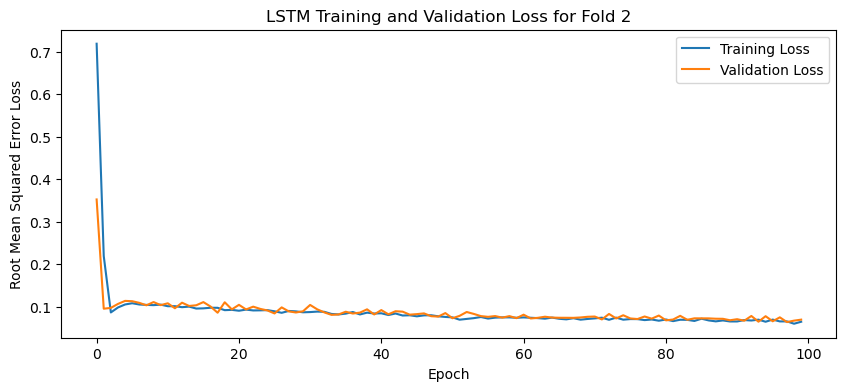

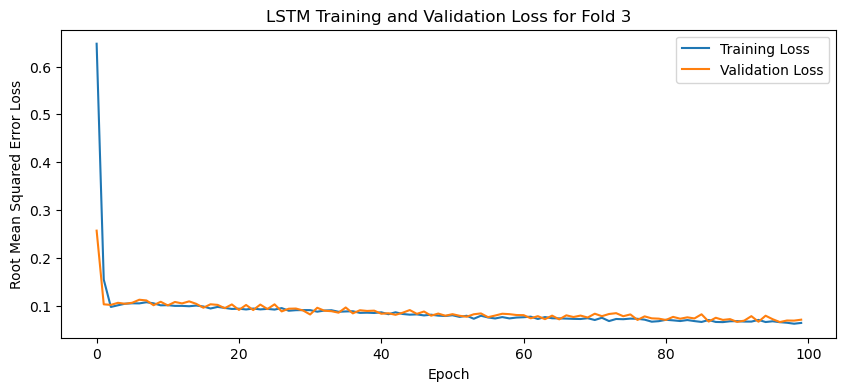

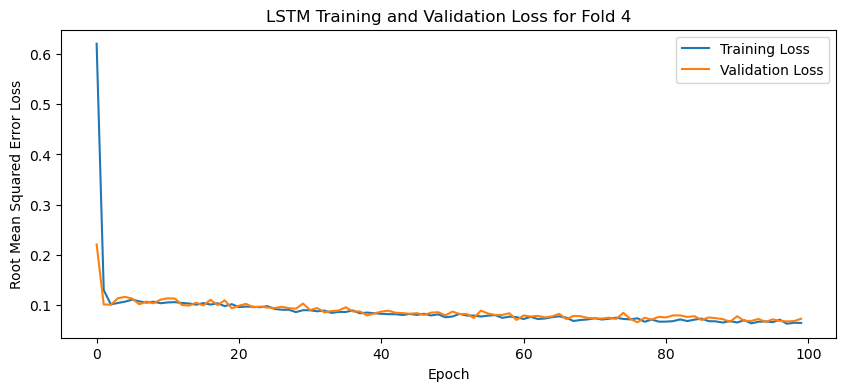

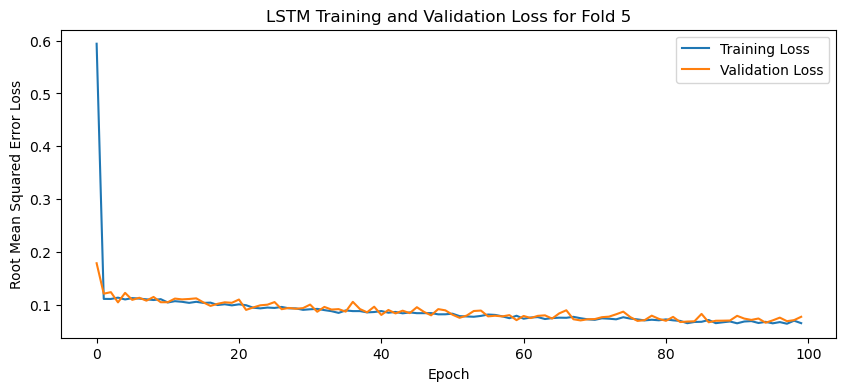

[I 2025-05-09 20:18:47,417] Trial 47 finished with value: 0.05428832173347473 and parameters: {'lr': 0.28707933761075677, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.35476843325021706}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.05312331020832062, 0.05469754710793495, 0.052570000290870667, 0.05866720527410507, 0.05238354578614235]
Mean Cross Validation Accuracy:
0.05428832173347473
Standard Deviation of Cross Validation Accuracy:
0.002335814132712456


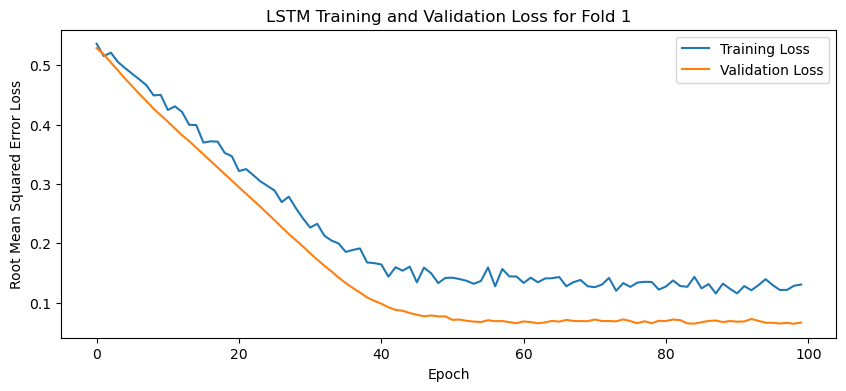

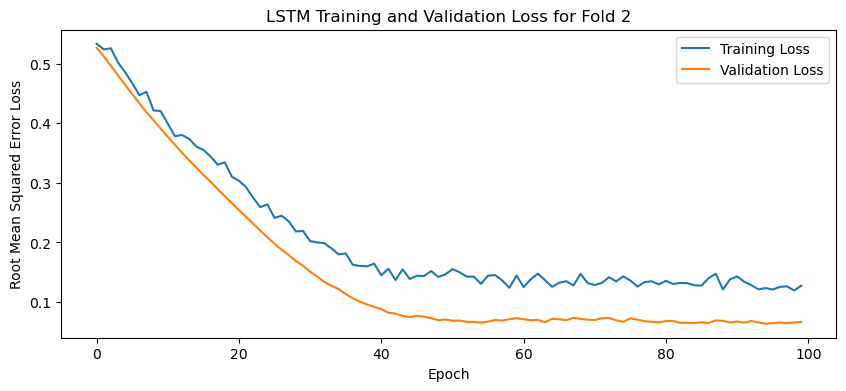

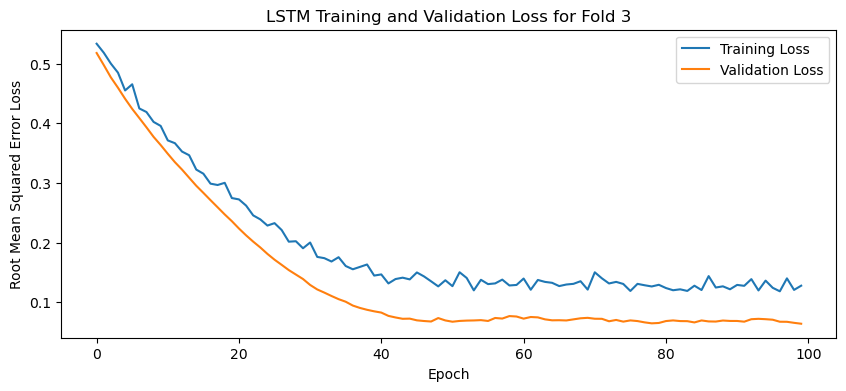

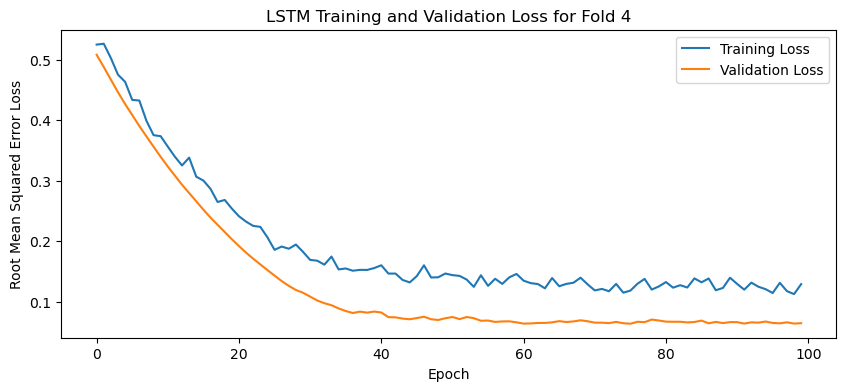

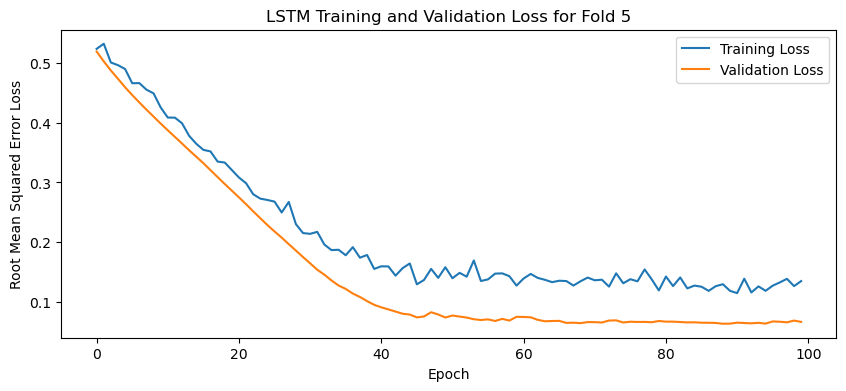

[I 2025-05-09 20:21:20,793] Trial 48 finished with value: 0.049755191802978514 and parameters: {'lr': 0.014361124391024969, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.4995768556079569}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.052197109907865524, 0.04894740879535675, 0.045072369277477264, 0.051029935479164124, 0.051529135555028915]
Mean Cross Validation Accuracy:
0.049755191802978514
Standard Deviation of Cross Validation Accuracy:
0.002581323385363918


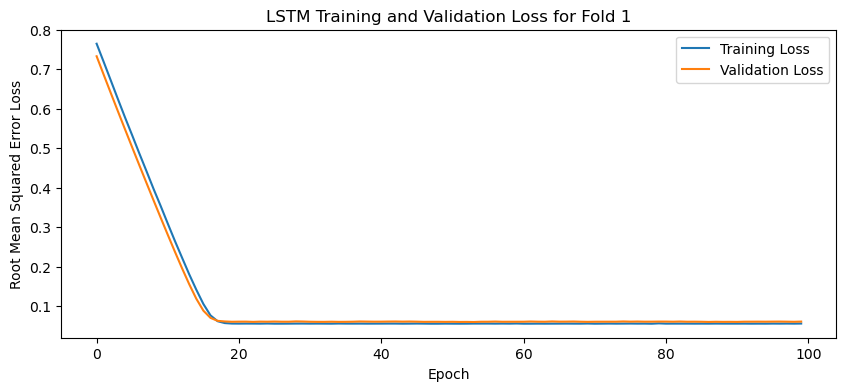

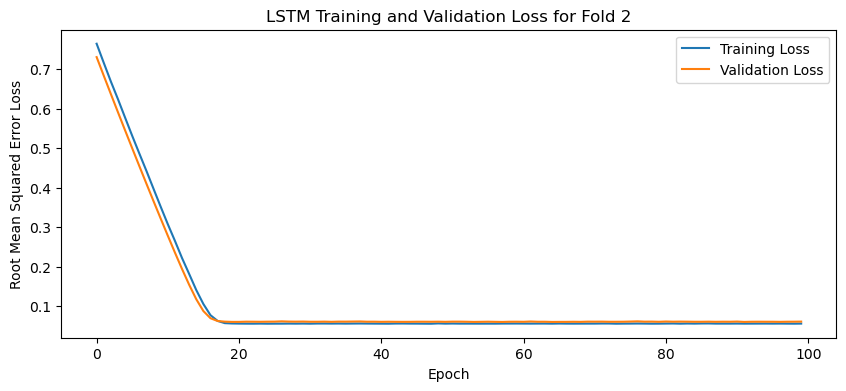

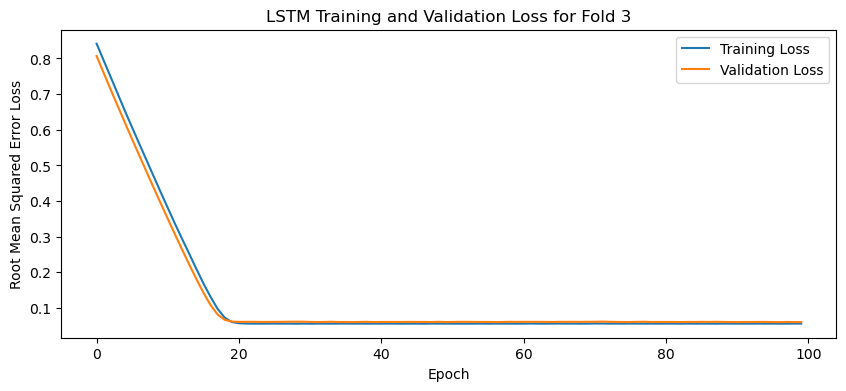

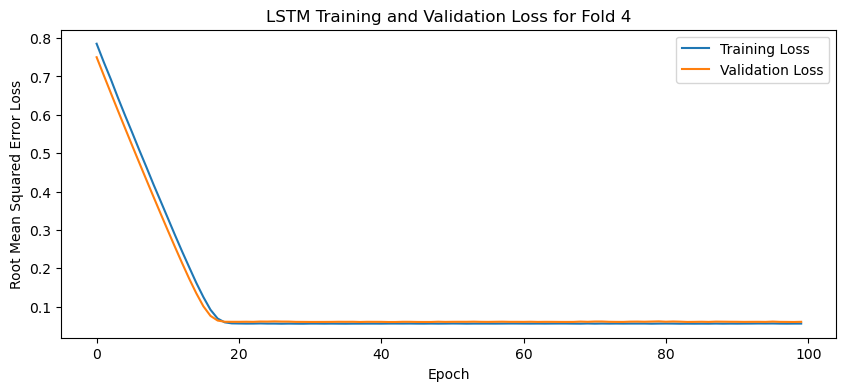

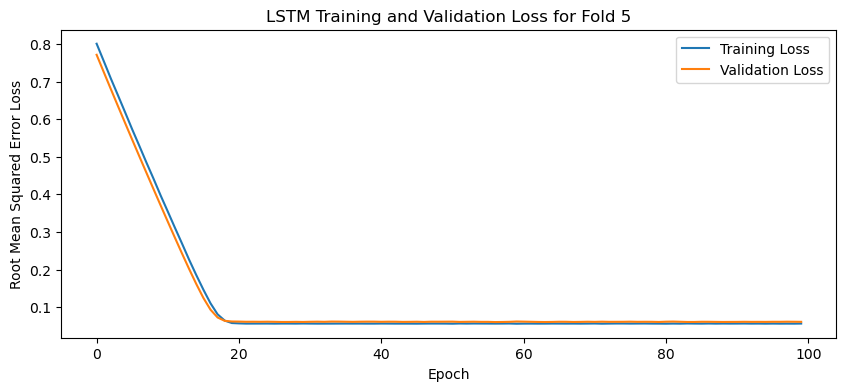

[I 2025-05-09 20:22:42,118] Trial 49 finished with value: 0.042715467512607574 and parameters: {'lr': 0.022677102918243607, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.47484990336358185}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04210788384079933, 0.04211515560746193, 0.043619513511657715, 0.042722977697849274, 0.04301180690526962]
Mean Cross Validation Accuracy:
0.042715467512607574
Standard Deviation of Cross Validation Accuracy:
0.0005717875319787627


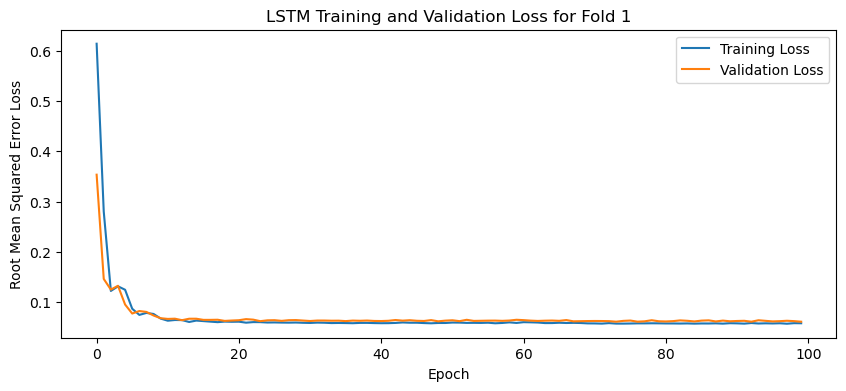

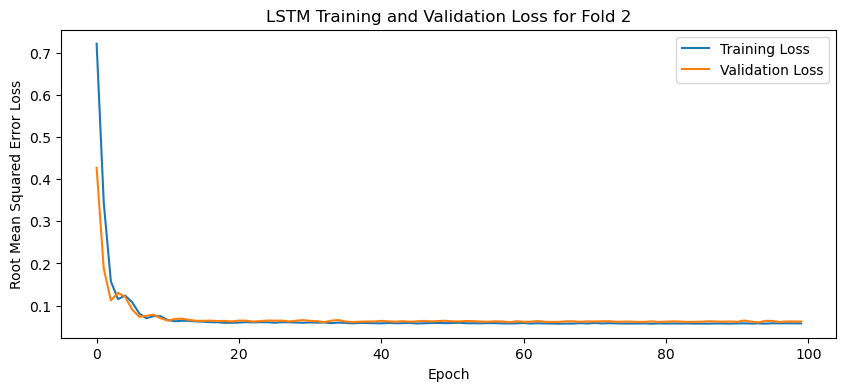

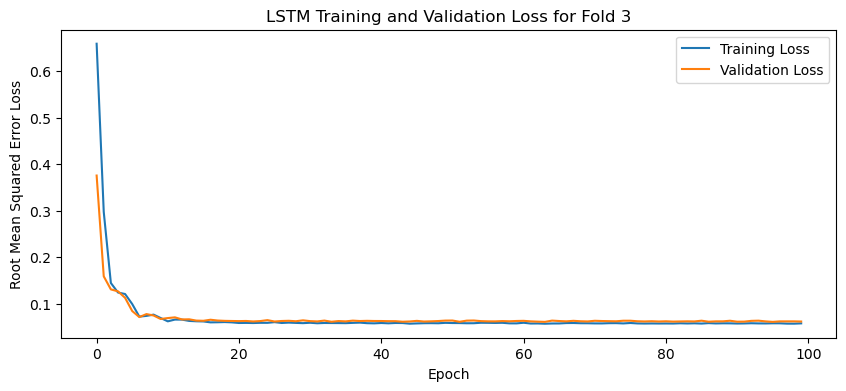

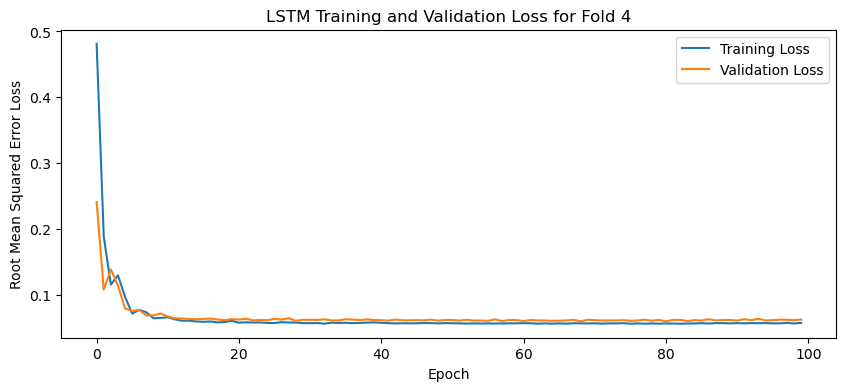

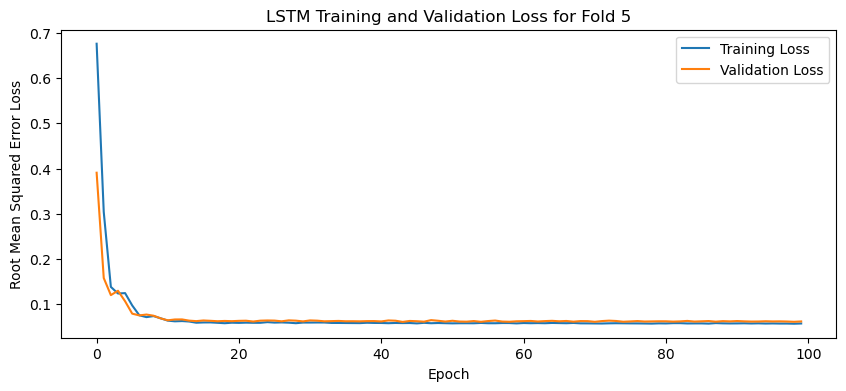

[I 2025-05-09 20:24:27,358] Trial 50 finished with value: 0.04465597718954086 and parameters: {'lr': 0.001575207429191059, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.3734475302587414}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.0475064180791378, 0.04669725522398949, 0.043850578367710114, 0.04192056506872177, 0.04330506920814514]
Mean Cross Validation Accuracy:
0.04465597718954086
Standard Deviation of Cross Validation Accuracy:
0.0021094041047716606


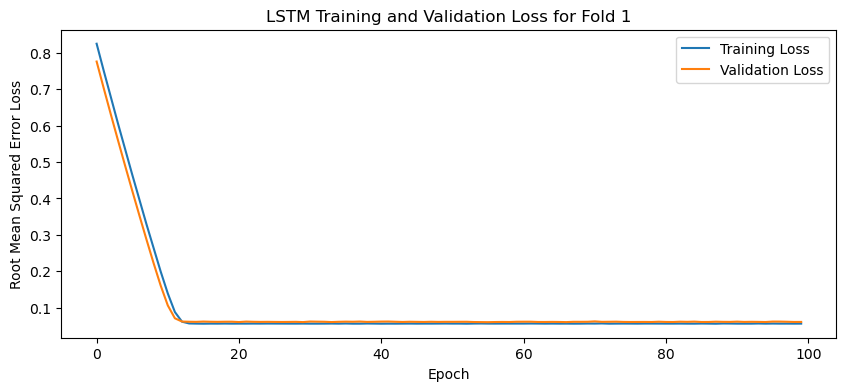

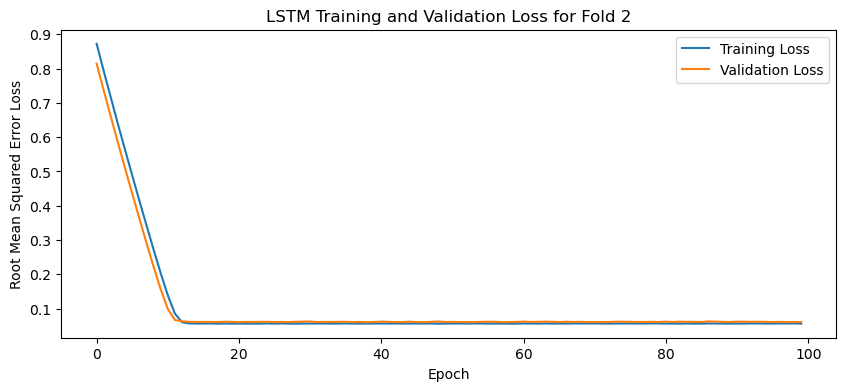

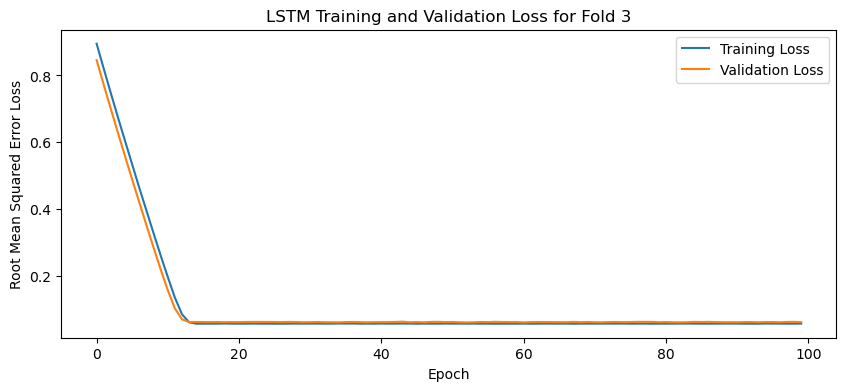

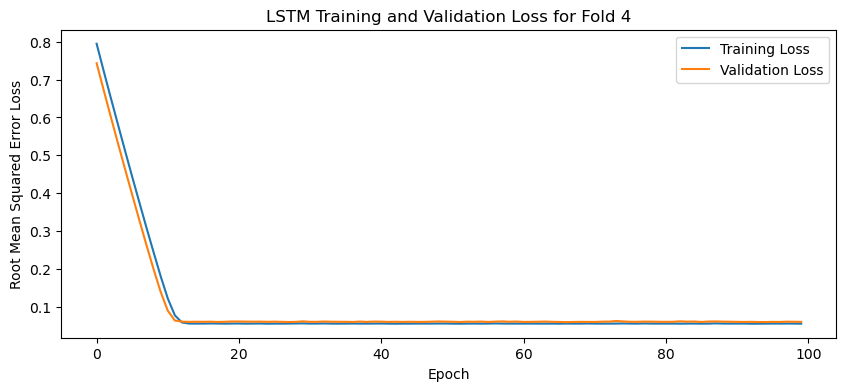

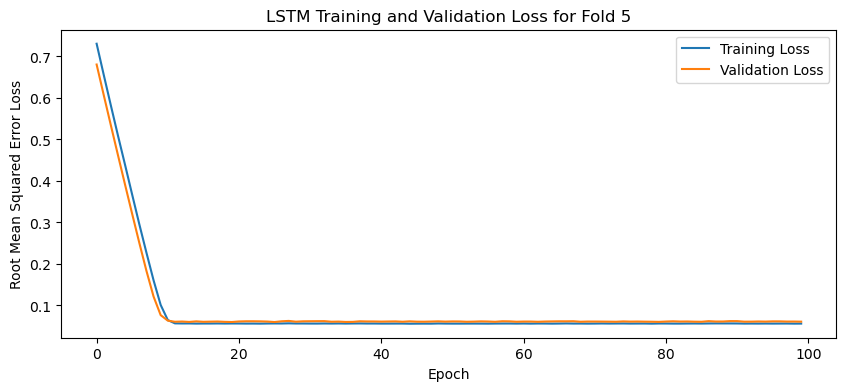

[I 2025-05-09 20:27:00,959] Trial 51 finished with value: 0.04323623031377792 and parameters: {'lr': 0.03677582316015077, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3802204471029152}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04269801080226898, 0.0439603328704834, 0.04347275570034981, 0.04318194463849068, 0.04286810755729675]
Mean Cross Validation Accuracy:
0.04323623031377792
Standard Deviation of Cross Validation Accuracy:
0.0004490902608763624


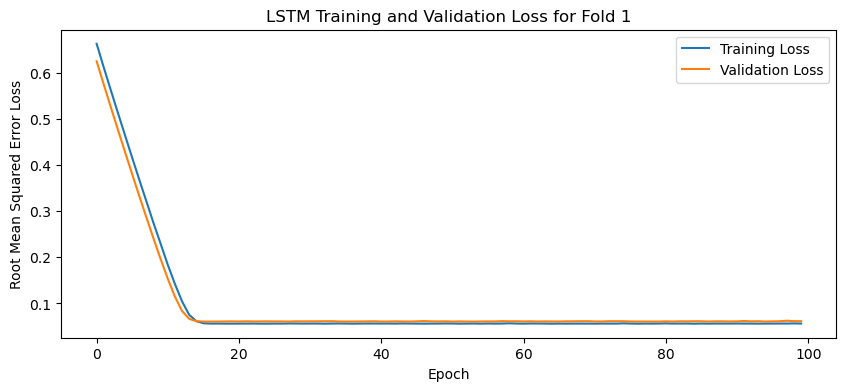

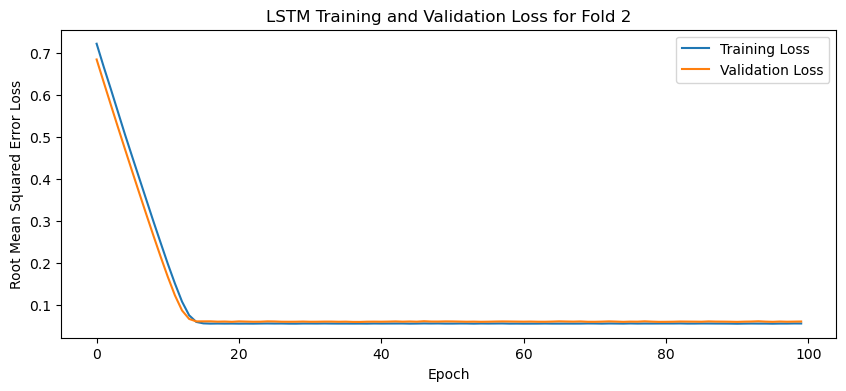

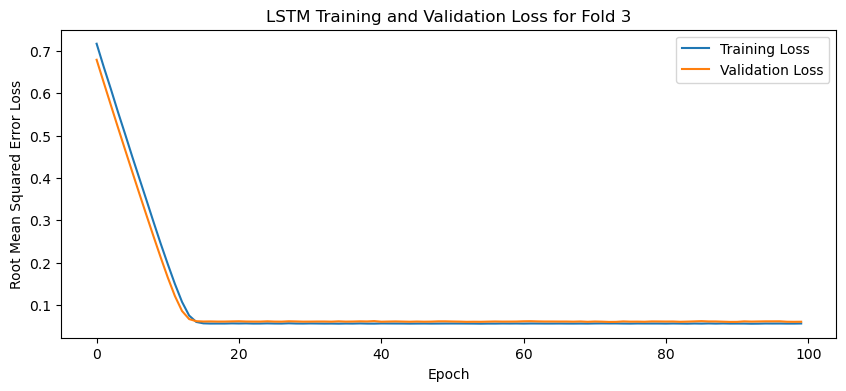

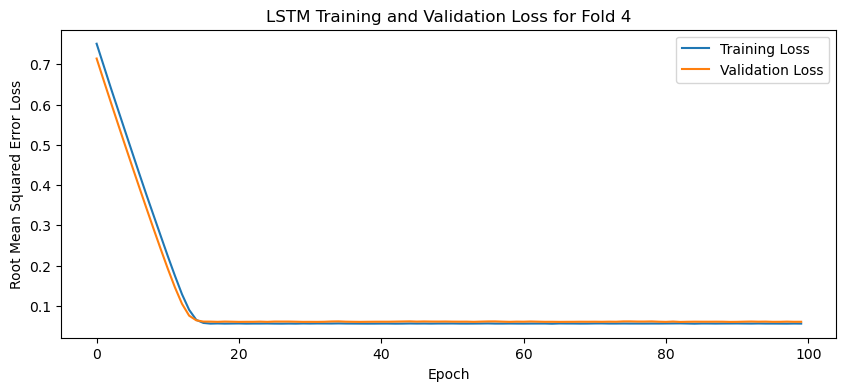

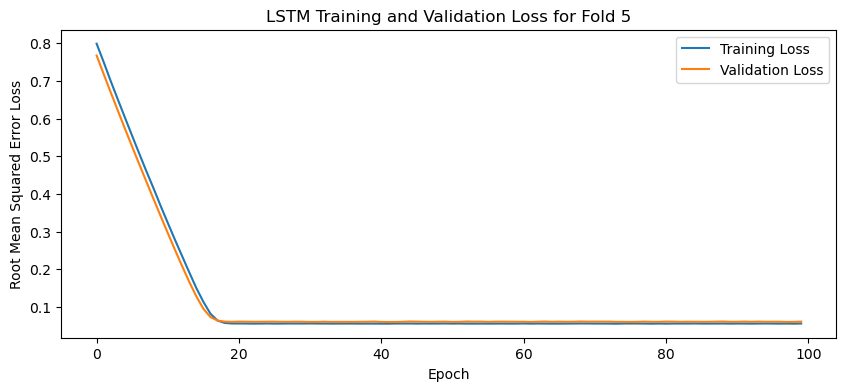

[I 2025-05-09 20:29:35,835] Trial 52 finished with value: 0.04252987429499626 and parameters: {'lr': 0.026809076337707804, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4283952131708433}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04163748770952225, 0.042354028671979904, 0.043604154139757156, 0.04320833086967468, 0.04184537008404732]
Mean Cross Validation Accuracy:
0.04252987429499626
Standard Deviation of Cross Validation Accuracy:
0.0007629157259433949


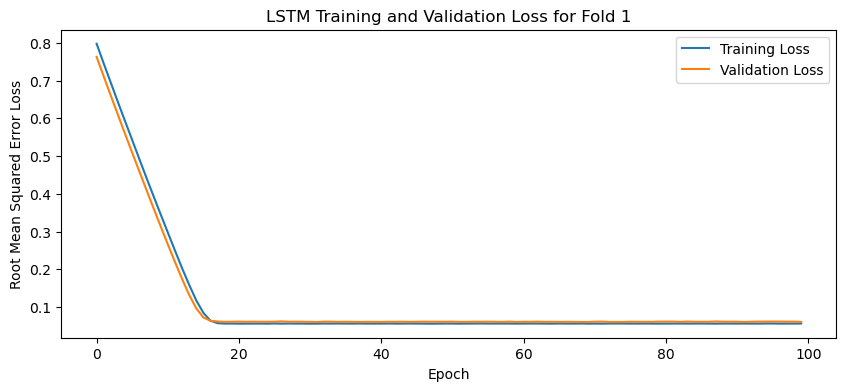

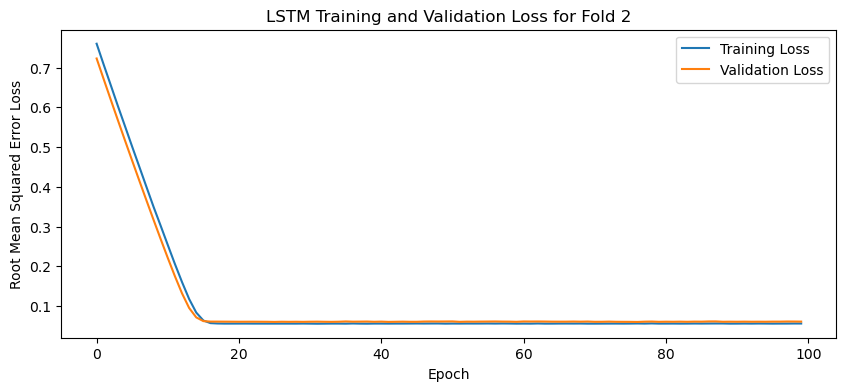

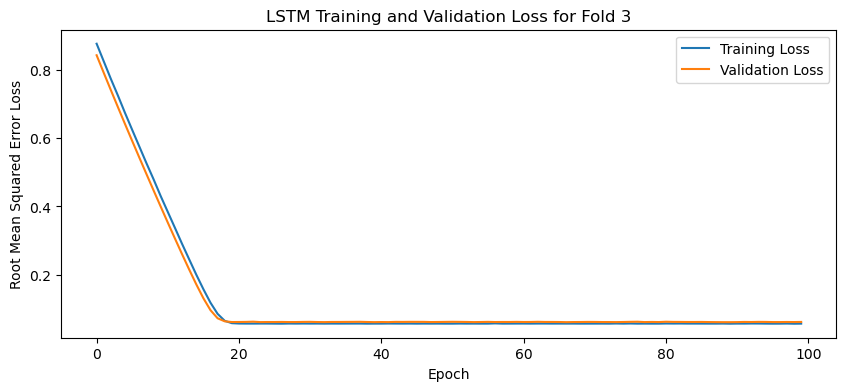

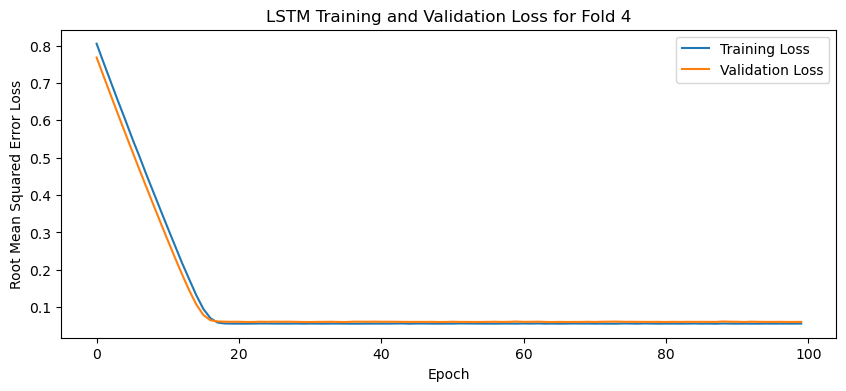

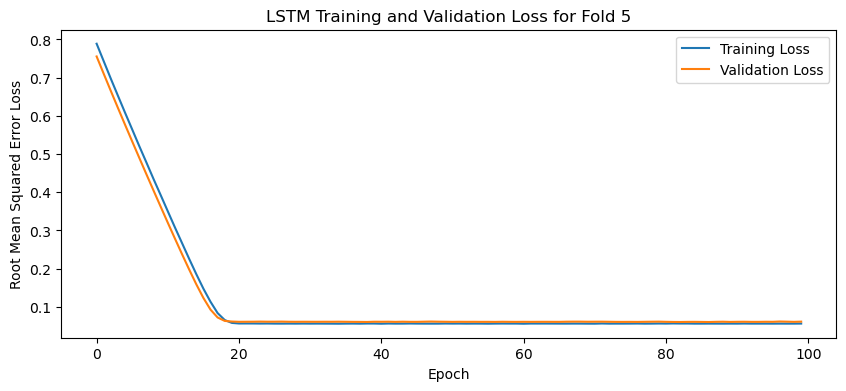

[I 2025-05-09 20:32:06,712] Trial 53 finished with value: 0.042505060136318204 and parameters: {'lr': 0.02528508212322227, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.42963984125906324}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.0429438054561615, 0.04269349202513695, 0.042202193289995193, 0.04277205094695091, 0.04191375896334648]
Mean Cross Validation Accuracy:
0.042505060136318204
Standard Deviation of Cross Validation Accuracy:
0.00038487752055163906


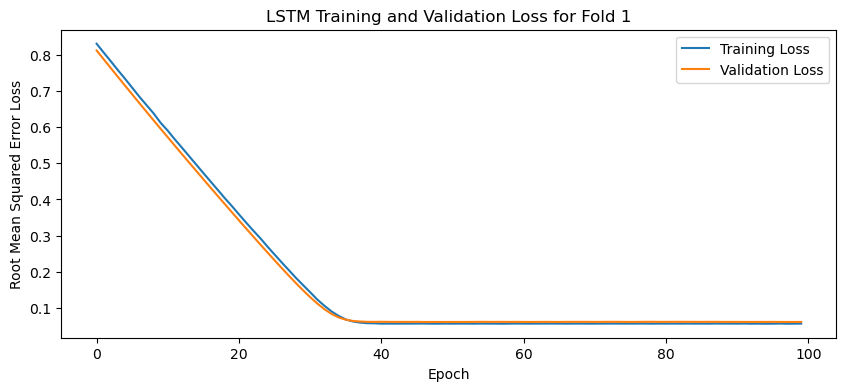

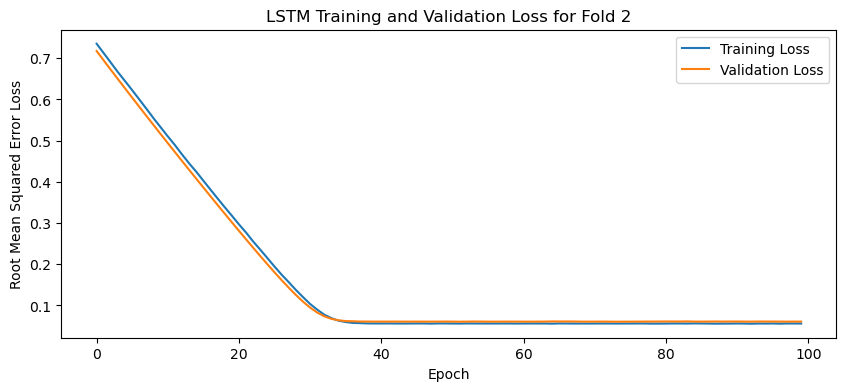

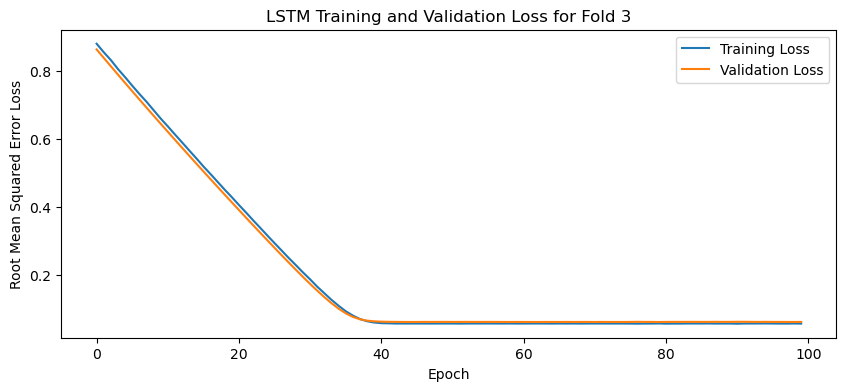

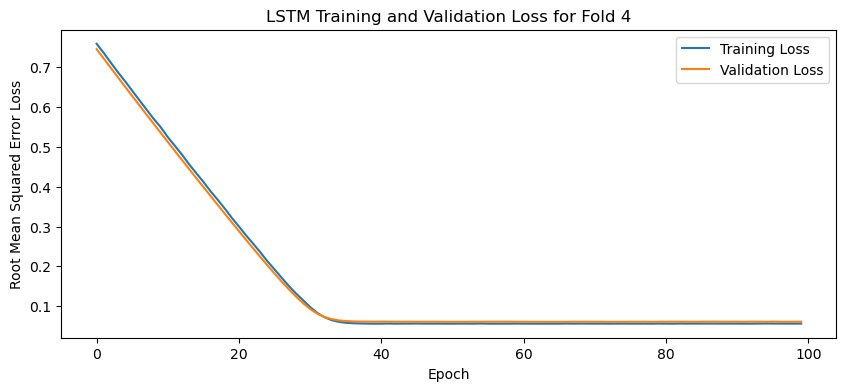

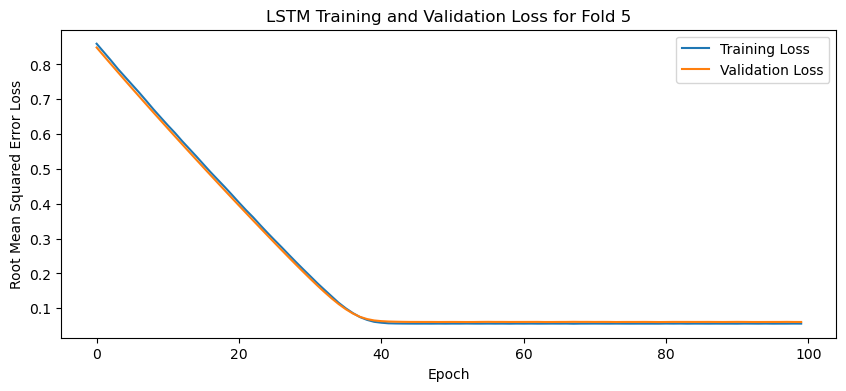

[I 2025-05-09 20:35:34,746] Trial 54 finished with value: 0.04270835295319557 and parameters: {'lr': 0.011401114996283056, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4492697037418606}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04287482798099518, 0.04303983598947525, 0.04253264144062996, 0.04240405187010765, 0.04269040748476982]
Mean Cross Validation Accuracy:
0.04270835295319557
Standard Deviation of Cross Validation Accuracy:
0.00022864411773569477


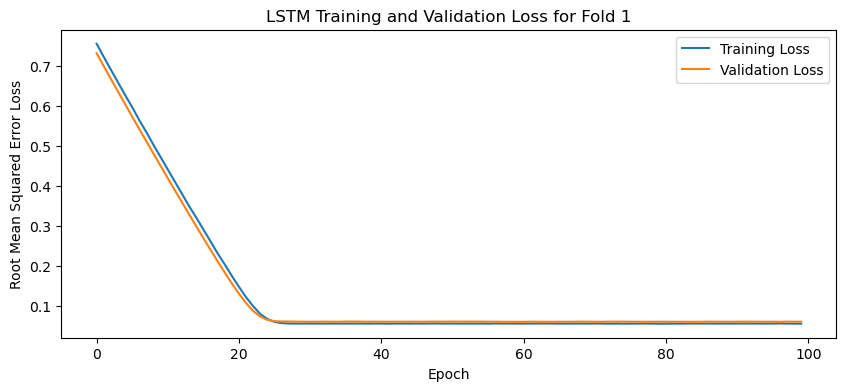

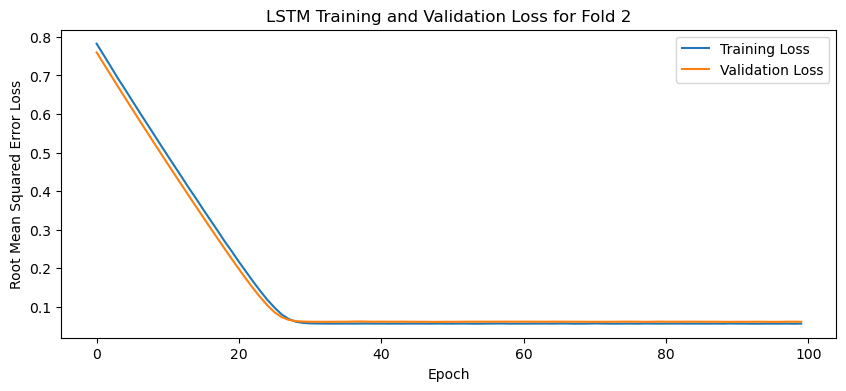

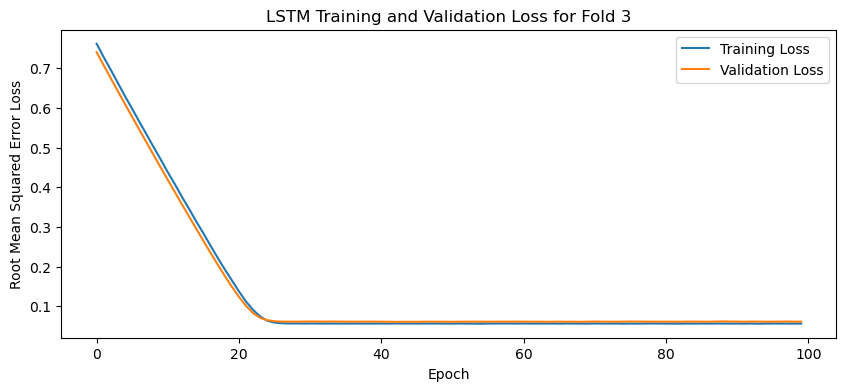

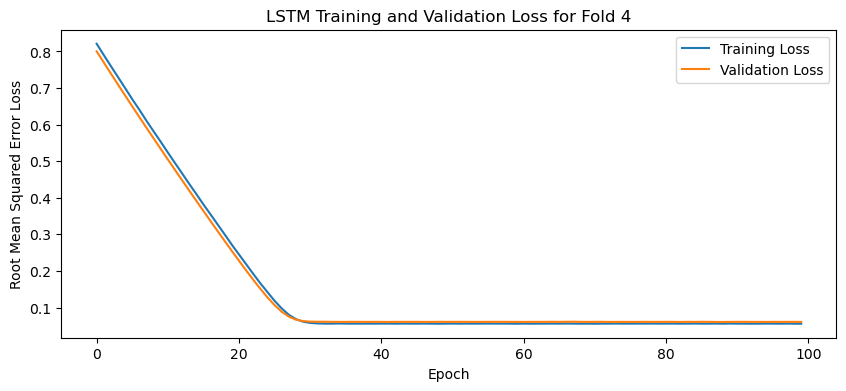

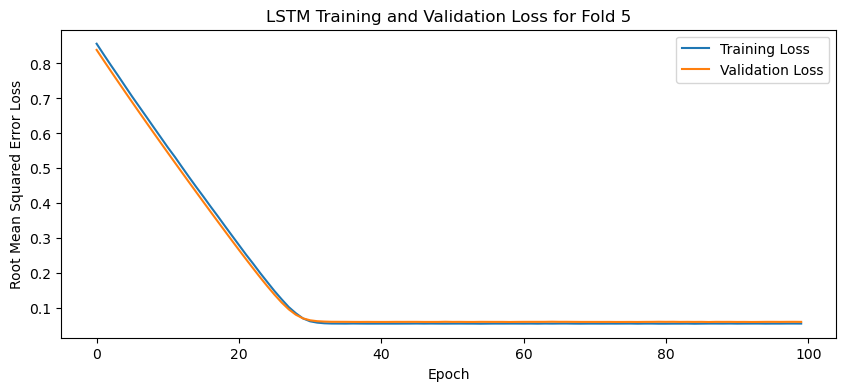

[I 2025-05-09 20:38:30,131] Trial 55 finished with value: 0.04267777055501938 and parameters: {'lr': 0.01540933482961133, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.41244950040860096}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04292036592960358, 0.04274244233965874, 0.042610205709934235, 0.04277807101607323, 0.04233776777982712]
Mean Cross Validation Accuracy:
0.04267777055501938
Standard Deviation of Cross Validation Accuracy:
0.0001966021533023074


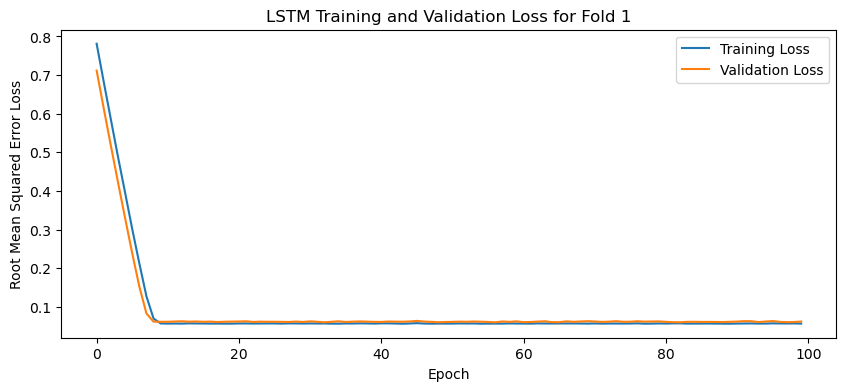

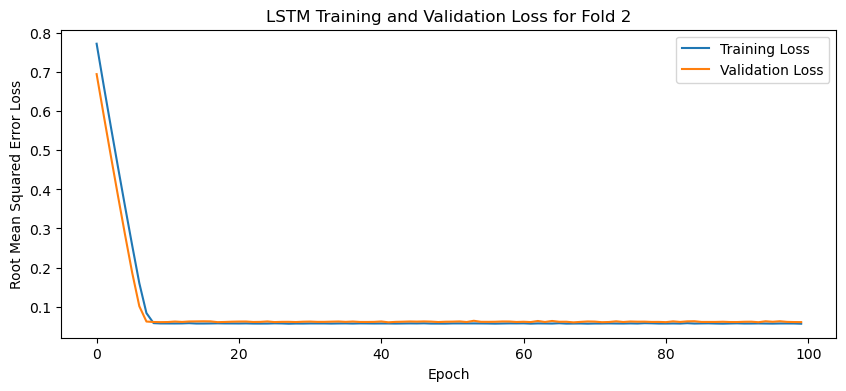

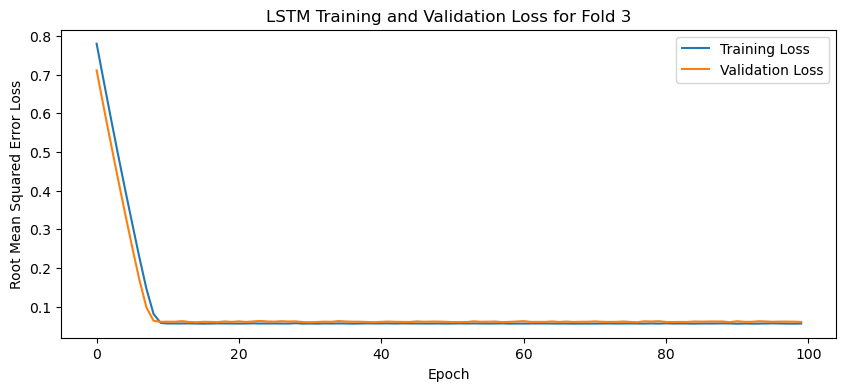

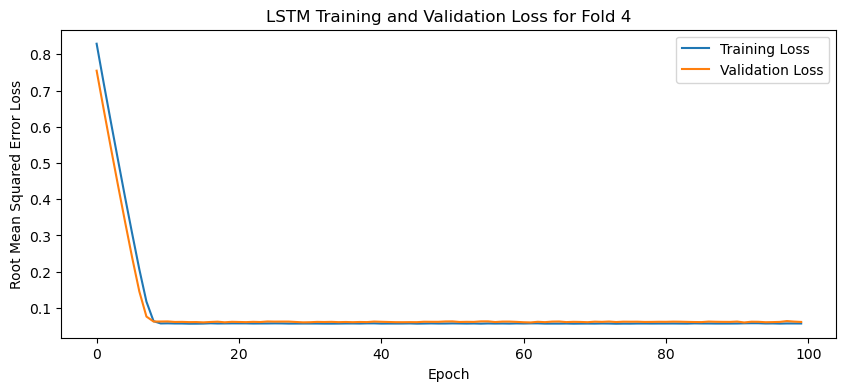

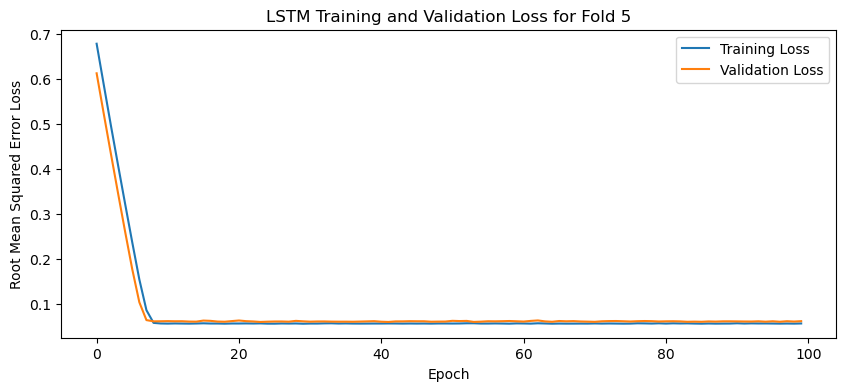

[I 2025-05-09 20:40:24,429] Trial 56 finished with value: 0.042960689216852185 and parameters: {'lr': 0.04871849365267494, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4835301024544632}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.041209541261196136, 0.04413878172636032, 0.04421226307749748, 0.04234018549323082, 0.04290267452597618]
Mean Cross Validation Accuracy:
0.042960689216852185
Standard Deviation of Cross Validation Accuracy:
0.0011321880433561844


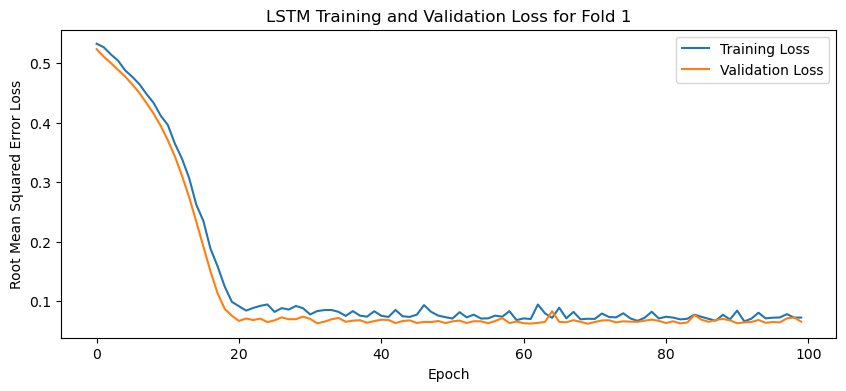

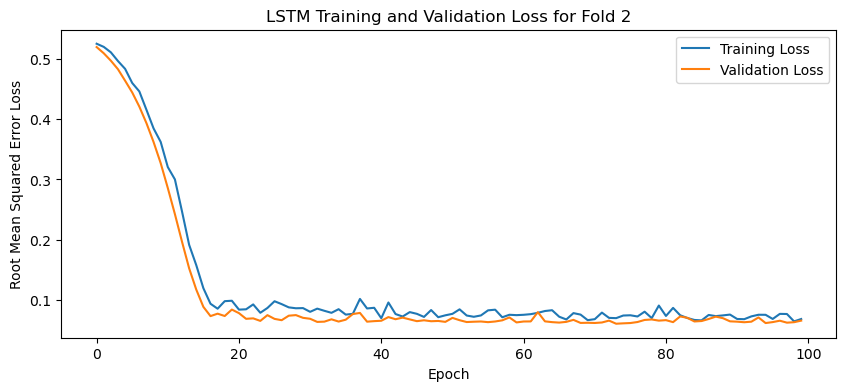

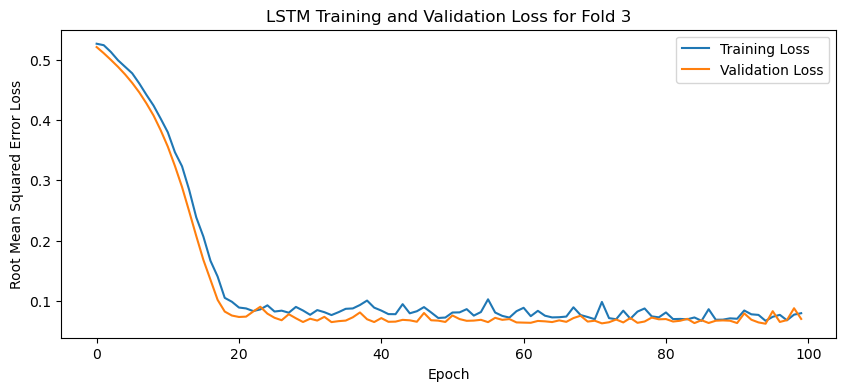

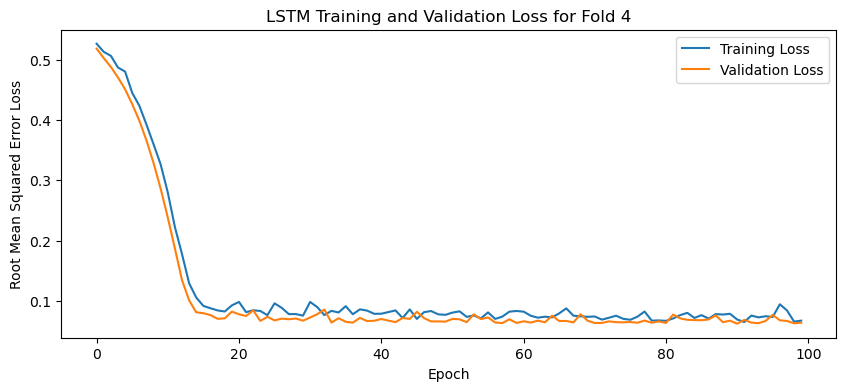

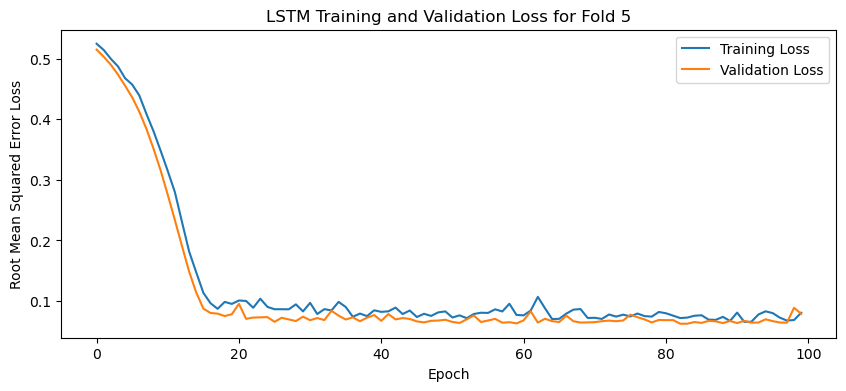

[I 2025-05-09 20:43:26,964] Trial 57 finished with value: 0.05332150831818581 and parameters: {'lr': 0.07388210307468357, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.4515492660942089}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04965098947286606, 0.05215561389923096, 0.05031117424368858, 0.047811925411224365, 0.06667783856391907]
Mean Cross Validation Accuracy:
0.05332150831818581
Standard Deviation of Cross Validation Accuracy:
0.0068211610605797505


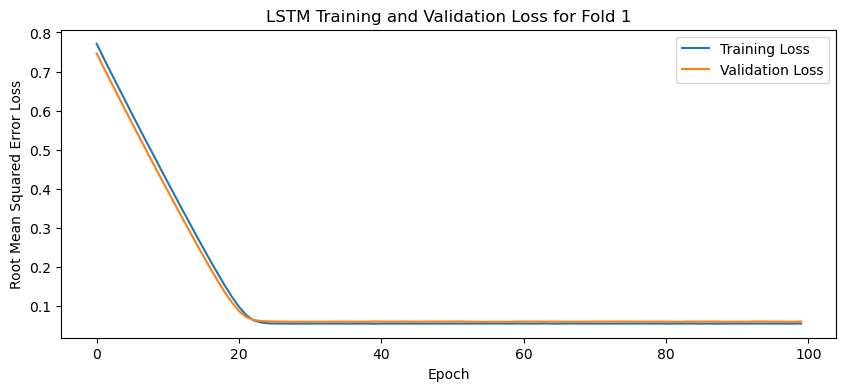

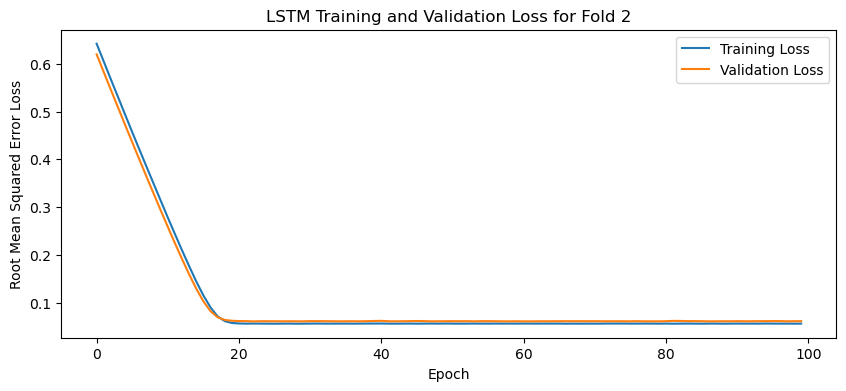

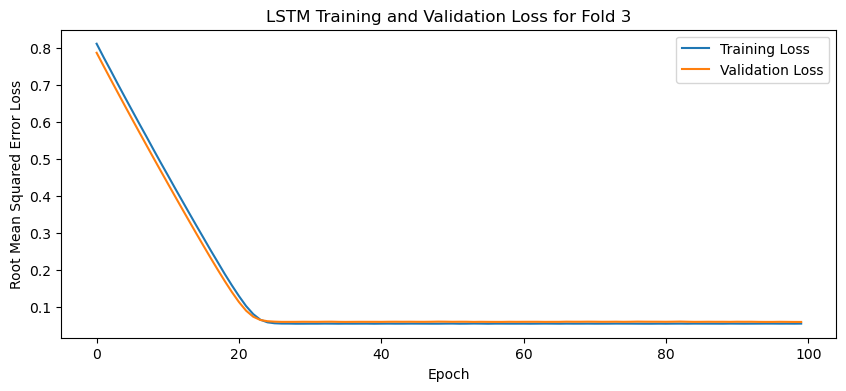

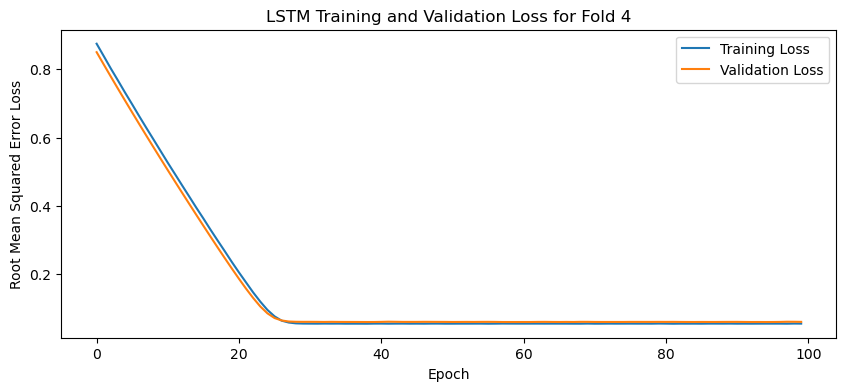

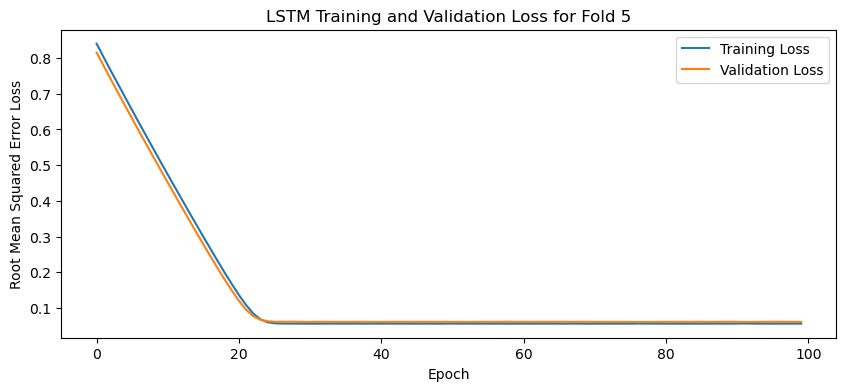

[I 2025-05-09 20:46:29,584] Trial 58 finished with value: 0.04276483207941055 and parameters: {'lr': 0.018008695133298405, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.1729611405985115}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04220065101981163, 0.04237848147749901, 0.04367080703377724, 0.04230567440390587, 0.04326854646205902]
Mean Cross Validation Accuracy:
0.04276483207941055
Standard Deviation of Cross Validation Accuracy:
0.0005920999280204455


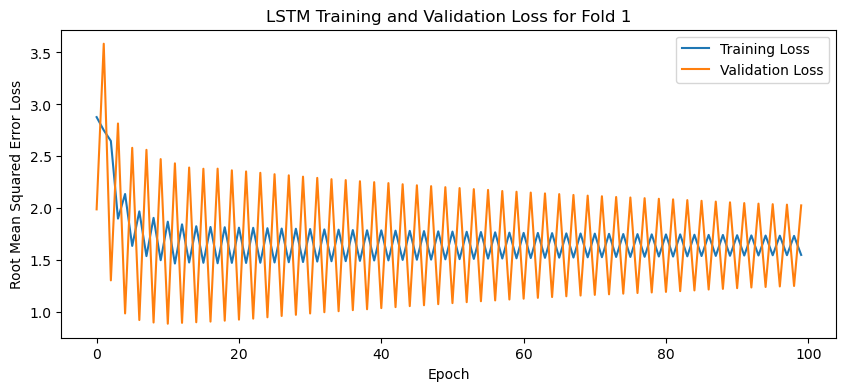

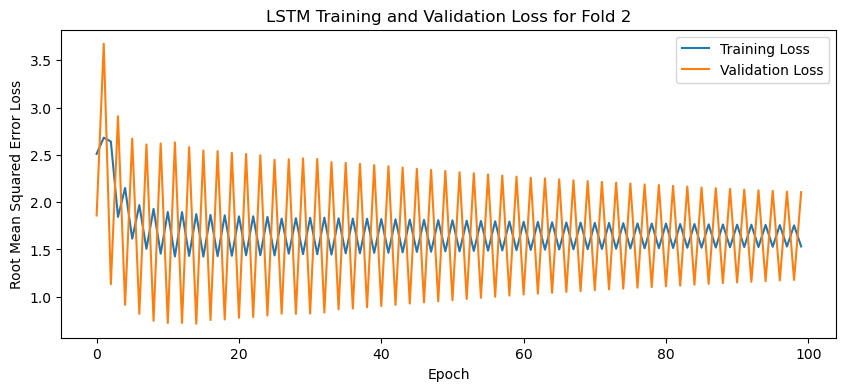

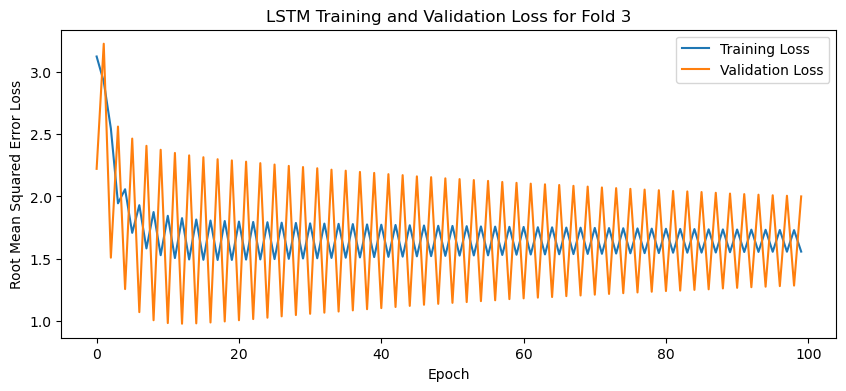

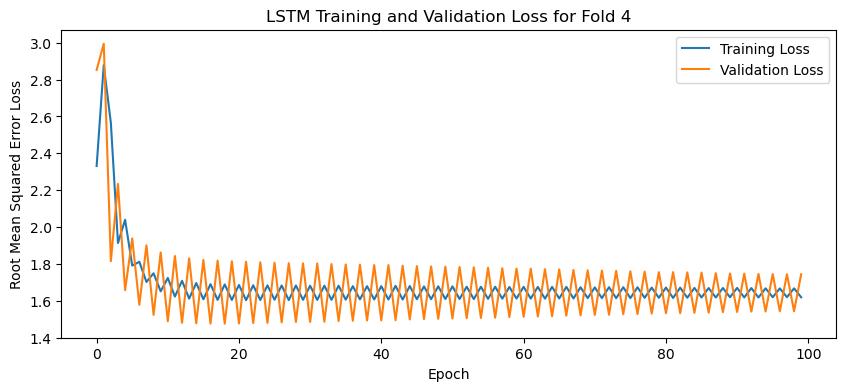

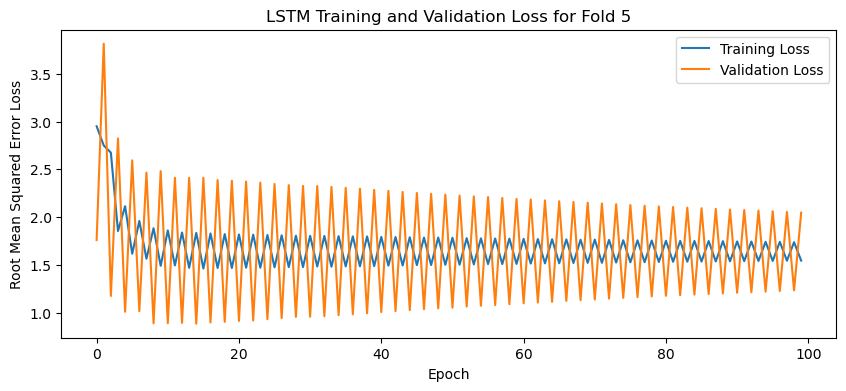

[I 2025-05-09 20:48:59,241] Trial 59 finished with value: 1.9850623846054076 and parameters: {'lr': 0.025457970560224585, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.3324204598433183}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[2.0258185863494873, 2.108214855194092, 2.000675678253174, 1.7476154565811157, 2.04298734664917]
Mean Cross Validation Accuracy:
1.9850623846054076
Standard Deviation of Cross Validation Accuracy:
0.12394169499177975


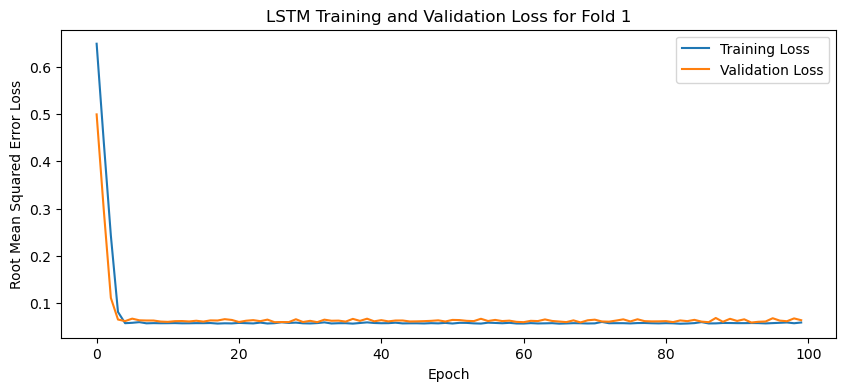

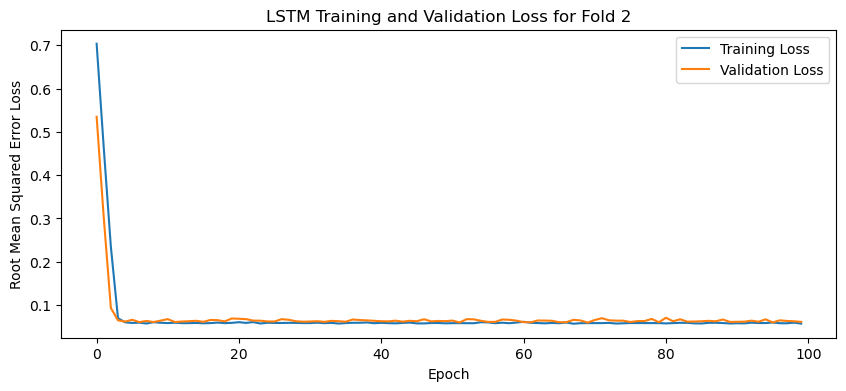

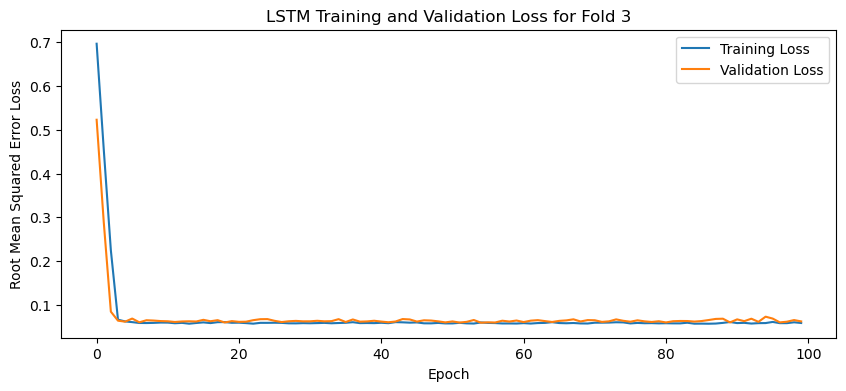

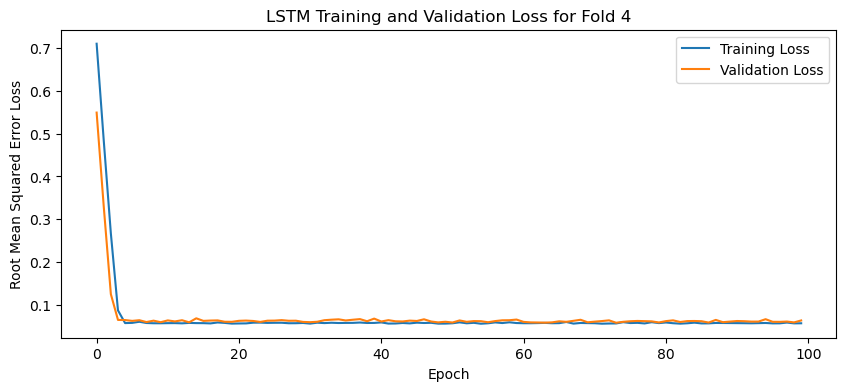

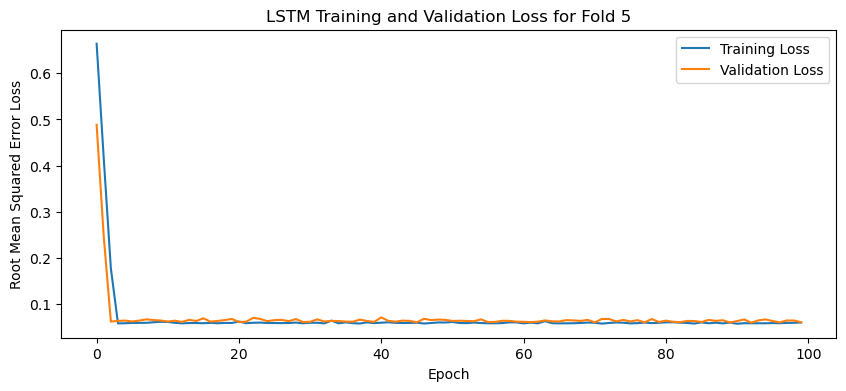

[I 2025-05-09 20:52:04,158] Trial 60 finished with value: 0.046393170952796936 and parameters: {'lr': 0.11629051467359104, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4315134674191189}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04405582696199417, 0.04650630056858063, 0.052567146718502045, 0.041341230273246765, 0.04749535024166107]
Mean Cross Validation Accuracy:
0.046393170952796936
Standard Deviation of Cross Validation Accuracy:
0.003750489456359477


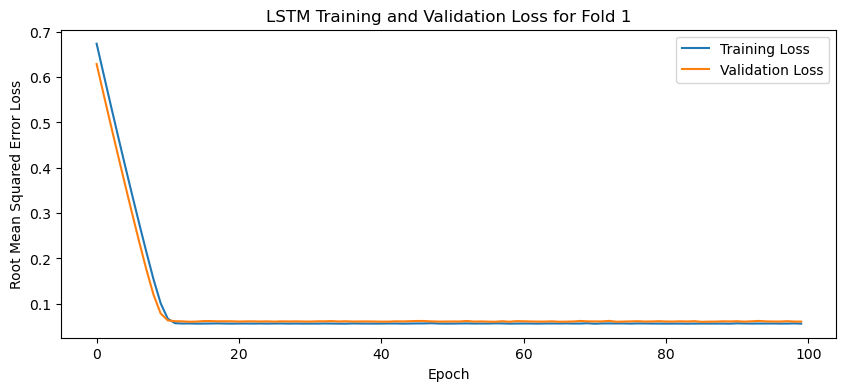

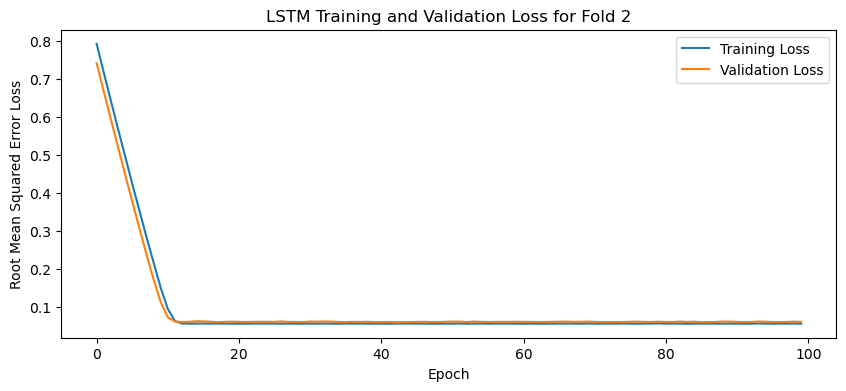

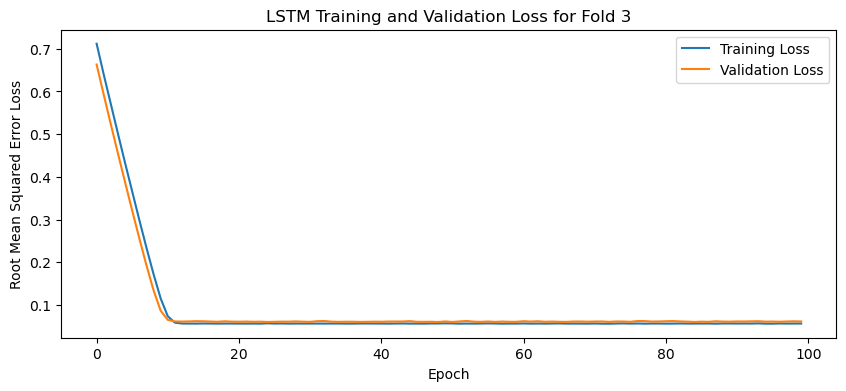

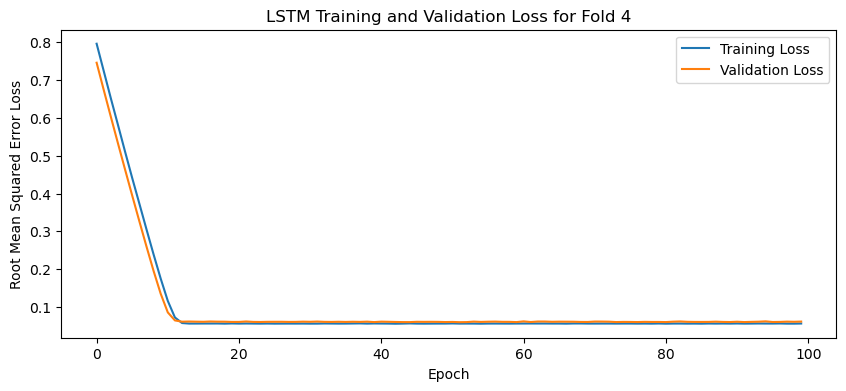

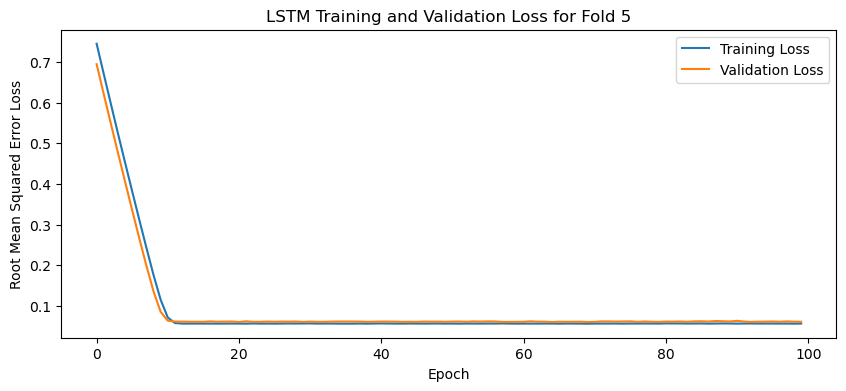

[I 2025-05-09 20:54:56,071] Trial 61 finished with value: 0.04283720776438713 and parameters: {'lr': 0.0355547114159739, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.40178321456159743}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.042935408651828766, 0.04362110793590546, 0.042393043637275696, 0.041870854794979095, 0.04336562380194664]
Mean Cross Validation Accuracy:
0.04283720776438713
Standard Deviation of Cross Validation Accuracy:
0.0006378849794825503


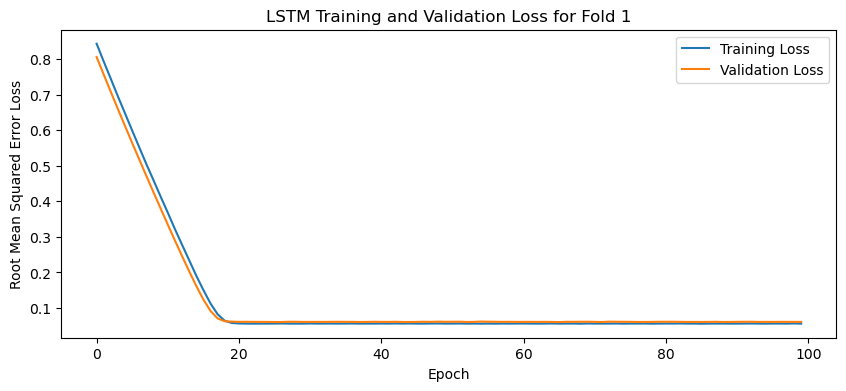

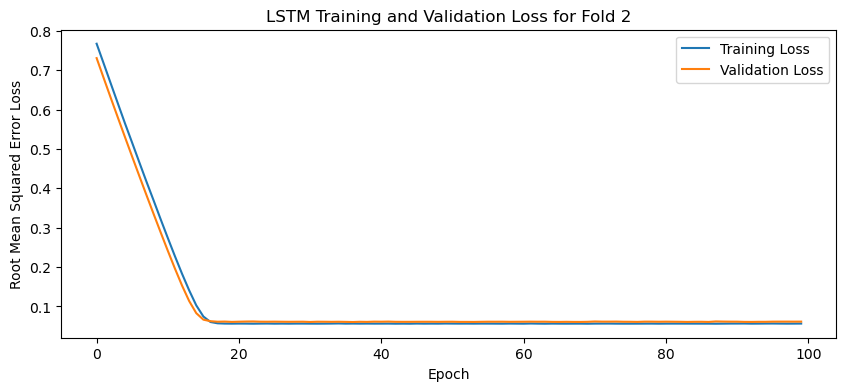

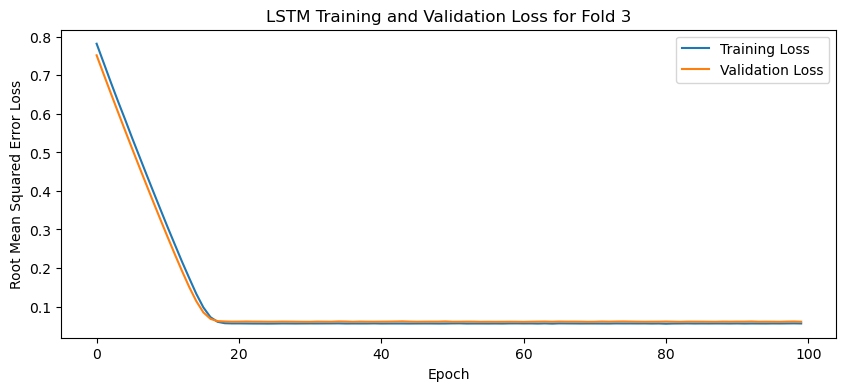

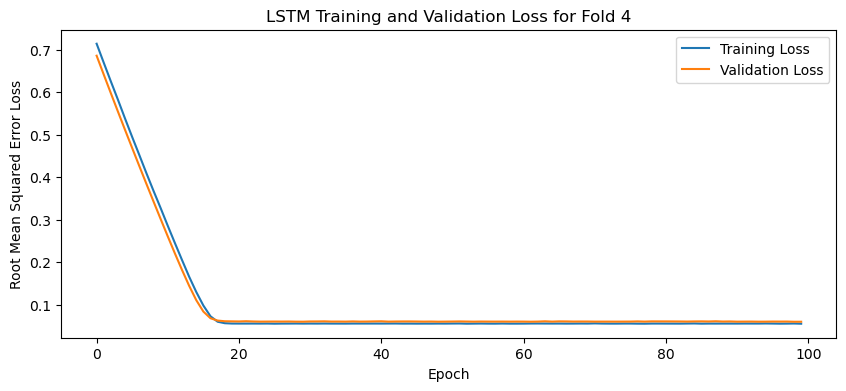

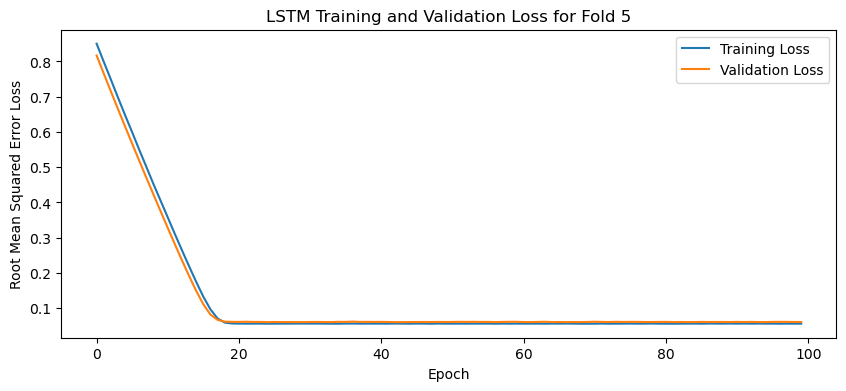

[I 2025-05-09 20:57:39,337] Trial 62 finished with value: 0.042739350348711014 and parameters: {'lr': 0.024376755784875206, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.42864151766310987}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04261007532477379, 0.04215800017118454, 0.04271947965025902, 0.04357364401221275, 0.04263555258512497]
Mean Cross Validation Accuracy:
0.042739350348711014
Standard Deviation of Cross Validation Accuracy:
0.00046084591743133005


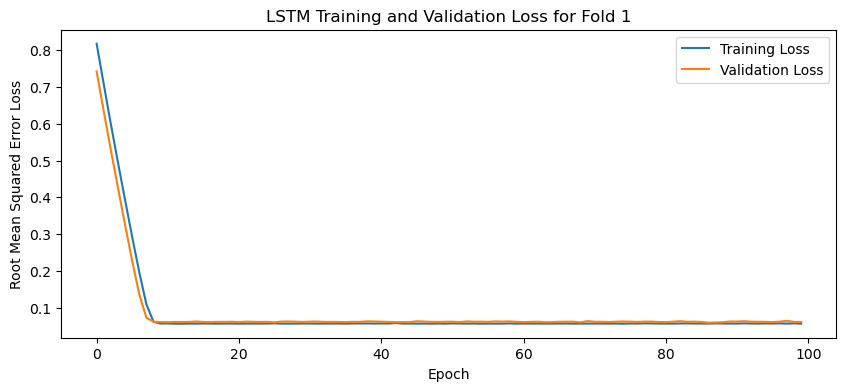

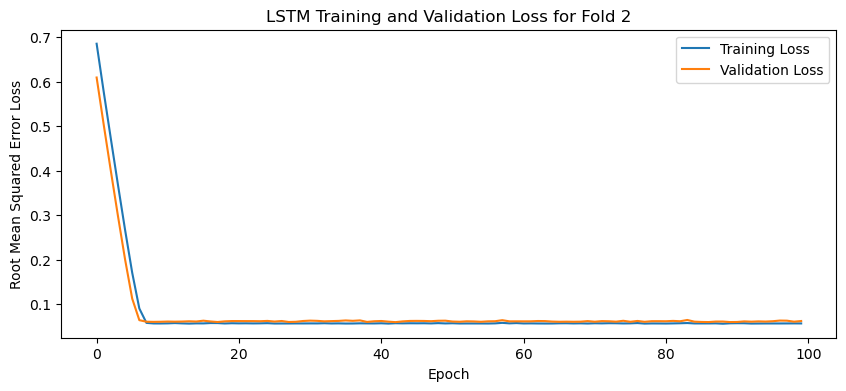

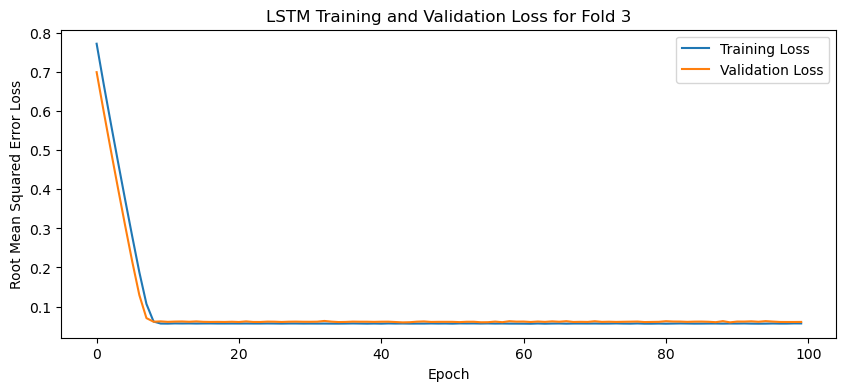

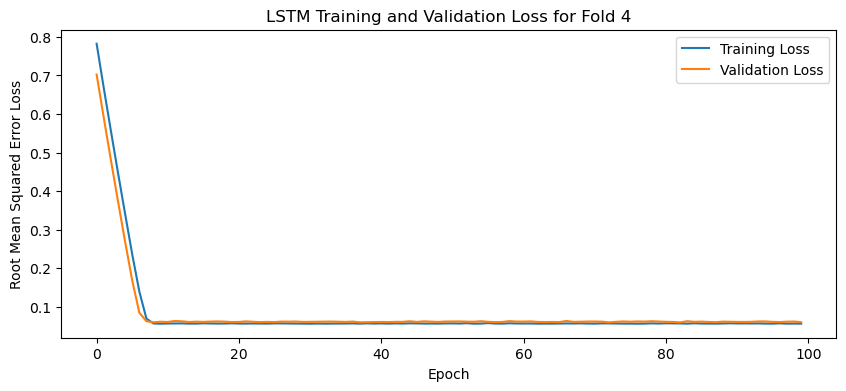

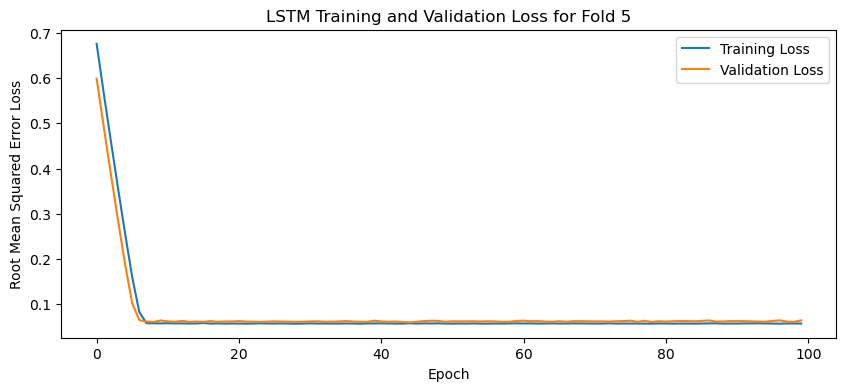

[I 2025-05-09 21:00:32,784] Trial 63 finished with value: 0.043007165938615796 and parameters: {'lr': 0.05558727250822622, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.46999290897143015}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04387484863400459, 0.04106343165040016, 0.04406312108039856, 0.04592844471335411, 0.04010598361492157]
Mean Cross Validation Accuracy:
0.043007165938615796
Standard Deviation of Cross Validation Accuracy:
0.0021258761045541757


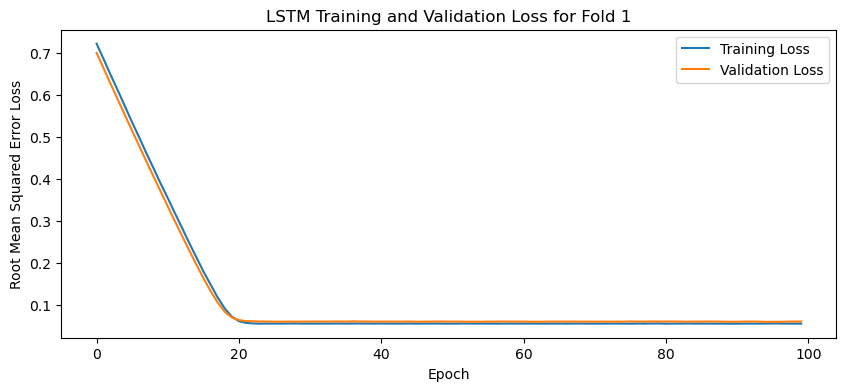

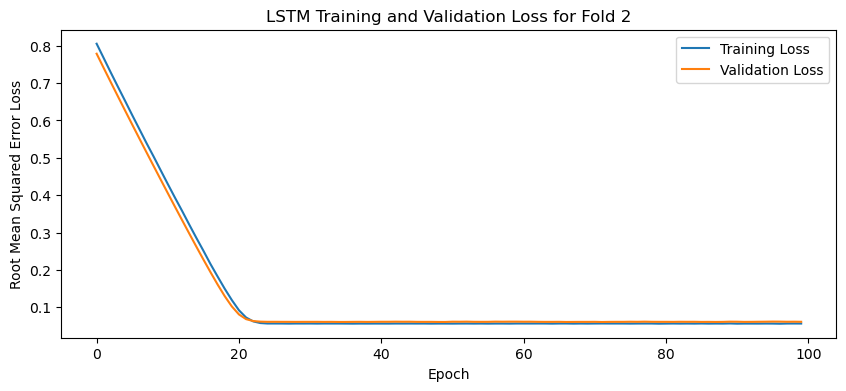

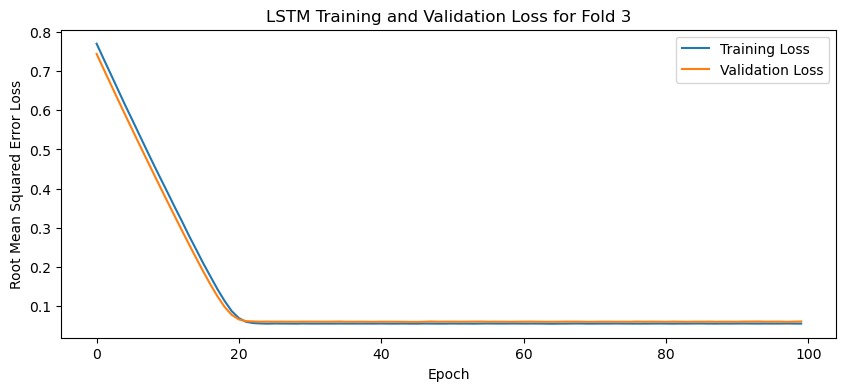

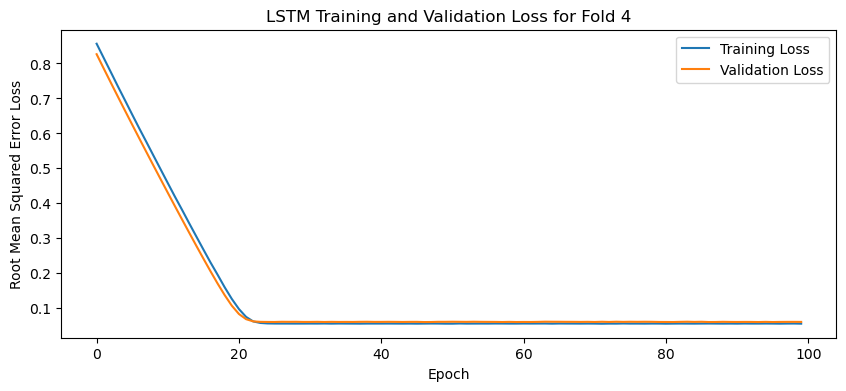

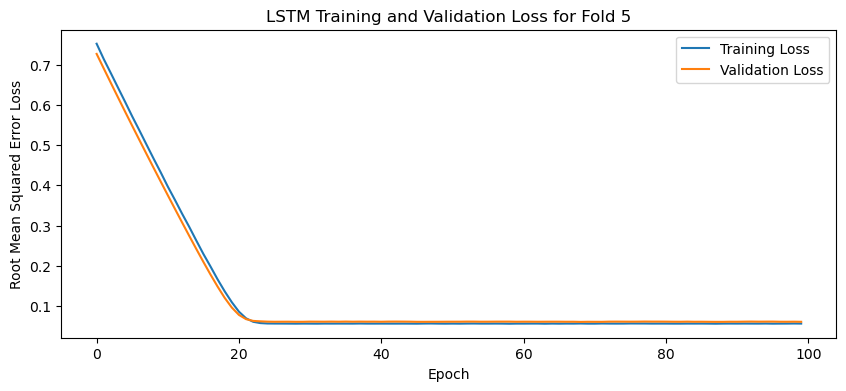

[I 2025-05-09 21:03:22,677] Trial 64 finished with value: 0.04242325201630592 and parameters: {'lr': 0.01887588902976634, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4486317148804852}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04224654287099838, 0.0423608124256134, 0.041598957031965256, 0.04271621257066727, 0.04319373518228531]
Mean Cross Validation Accuracy:
0.04242325201630592
Standard Deviation of Cross Validation Accuracy:
0.0005280259920116954


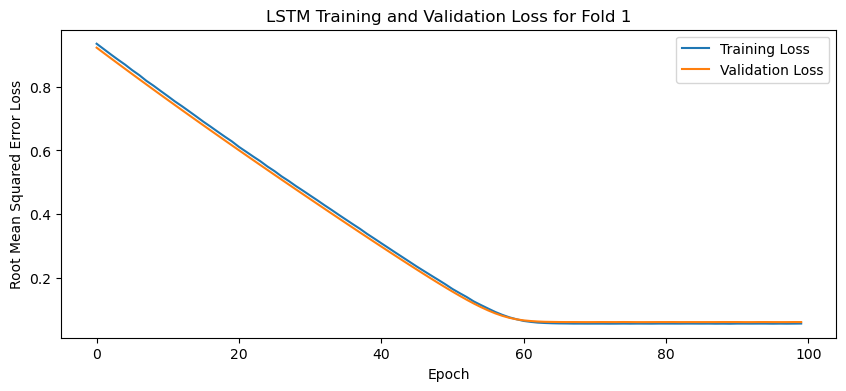

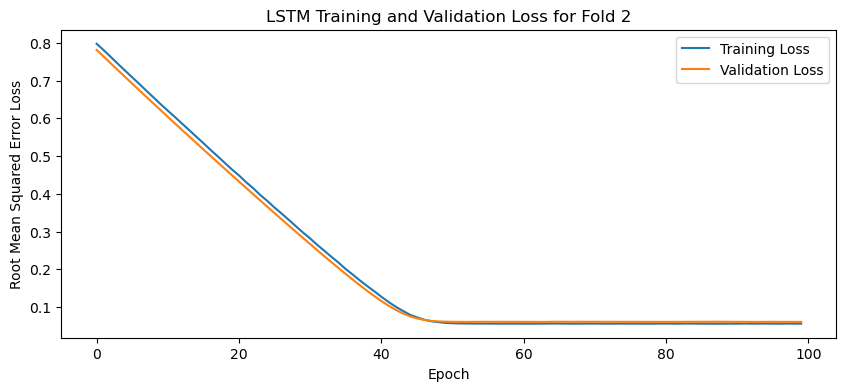

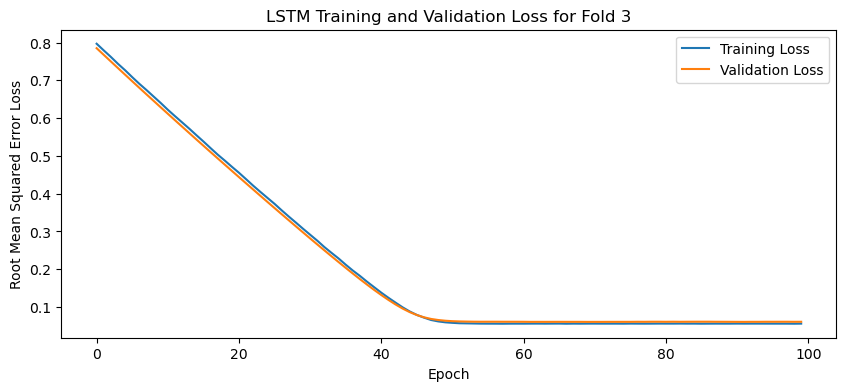

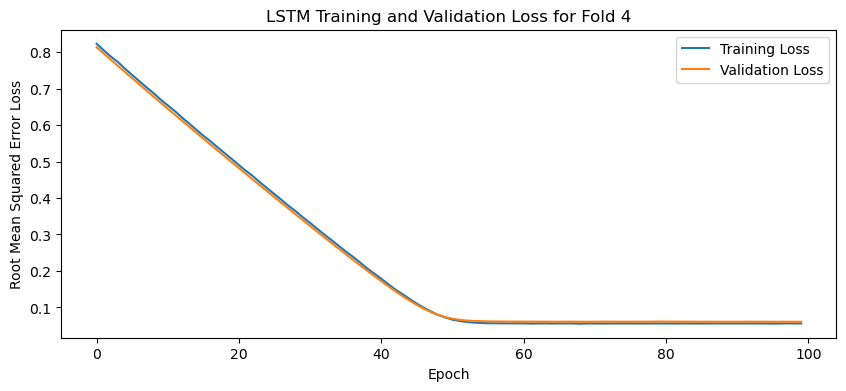

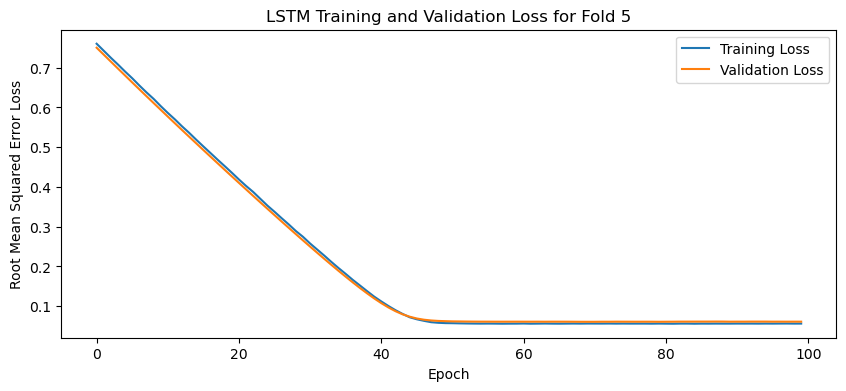

[I 2025-05-09 21:06:05,519] Trial 65 finished with value: 0.04267070069909096 and parameters: {'lr': 0.008285510419505152, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4449069443618311}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.042575735598802567, 0.04292752221226692, 0.042245250195264816, 0.04286319762468338, 0.0427417978644371]
Mean Cross Validation Accuracy:
0.04267070069909096
Standard Deviation of Cross Validation Accuracy:
0.00024416947573006973


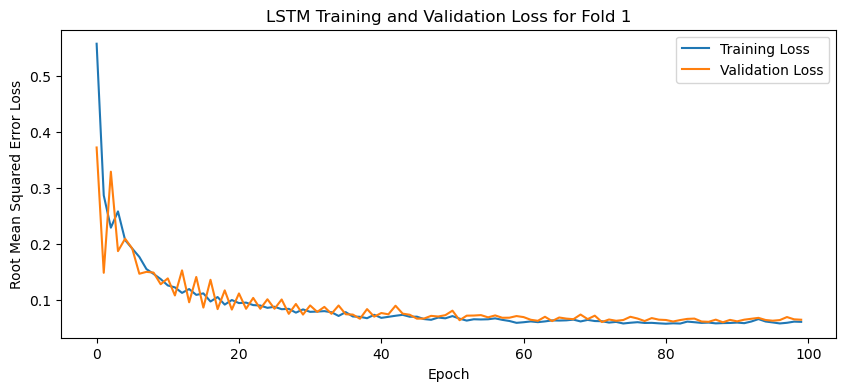

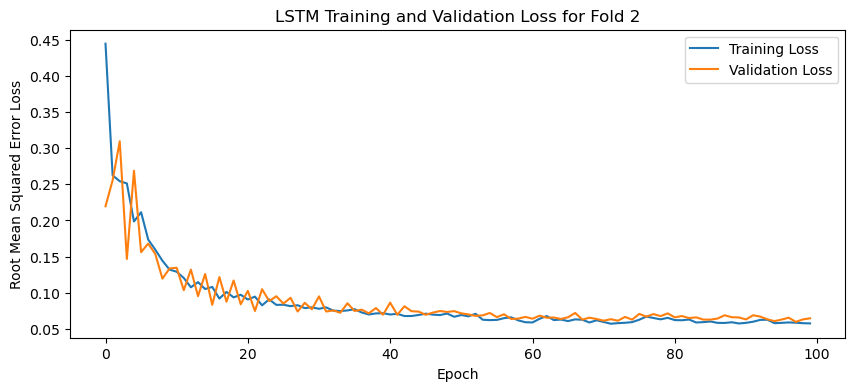

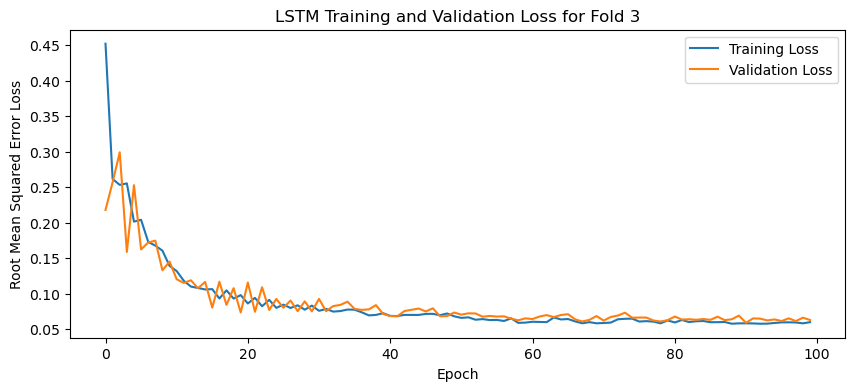

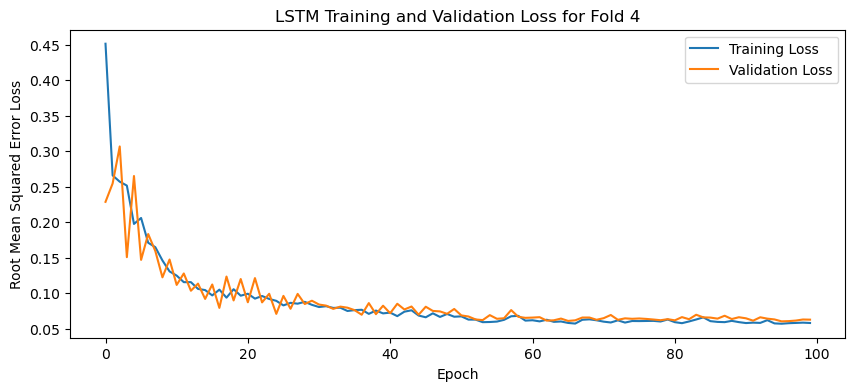

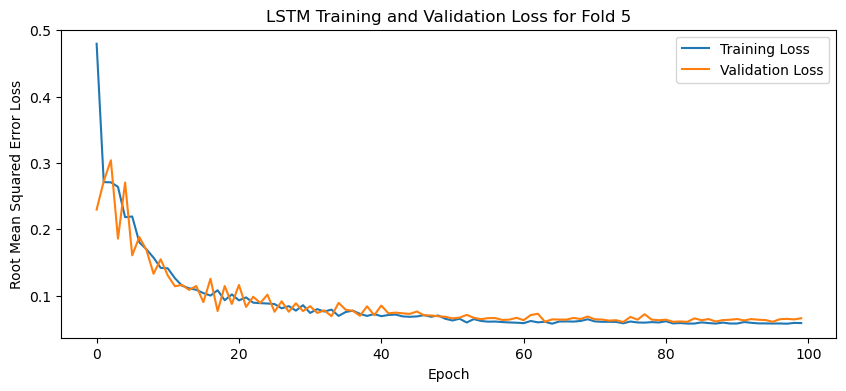

[I 2025-05-09 21:09:12,156] Trial 66 finished with value: 0.04364299327135086 and parameters: {'lr': 0.9483966180577038, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4918039196118179}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.045317720621824265, 0.04043050482869148, 0.043375346809625626, 0.04155252128839493, 0.047538872808218]
Mean Cross Validation Accuracy:
0.04364299327135086
Standard Deviation of Cross Validation Accuracy:
0.0025590771304679983


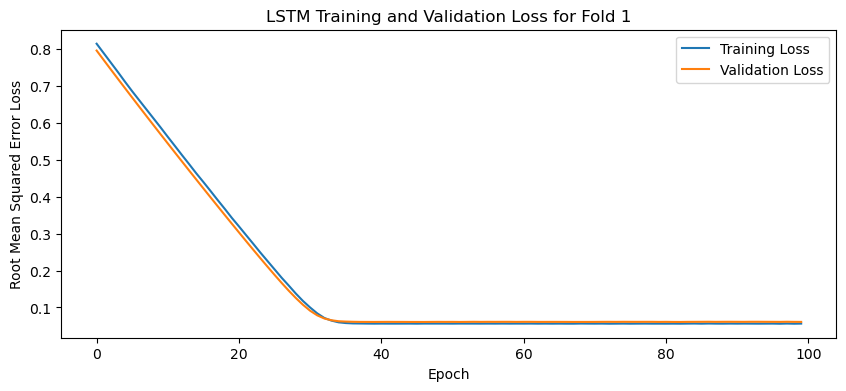

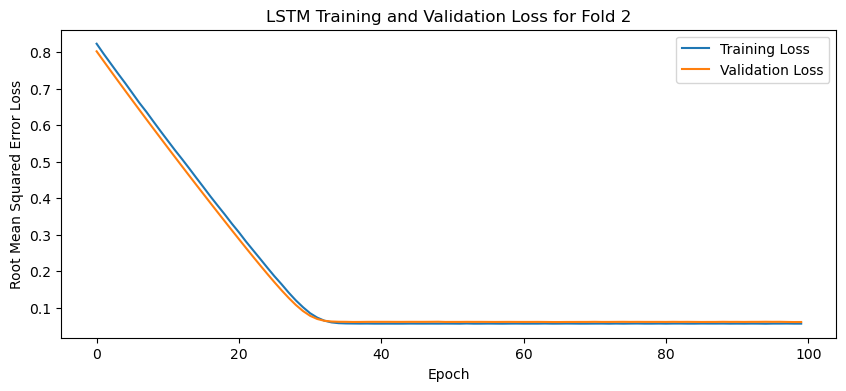

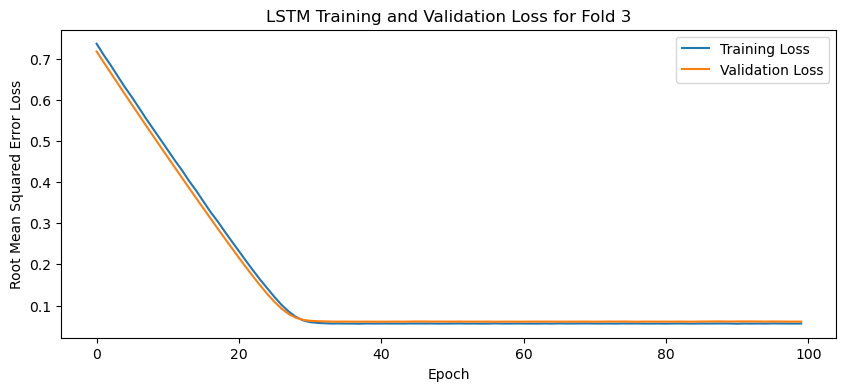

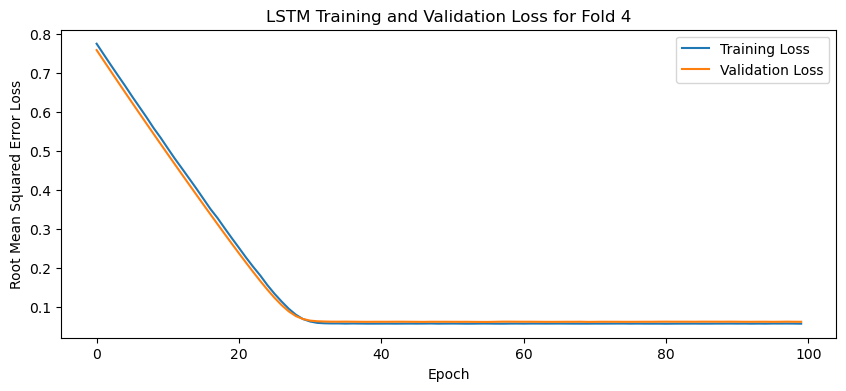

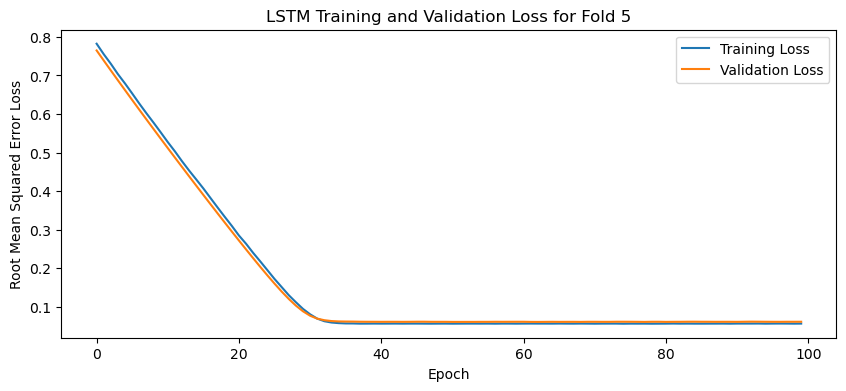

[I 2025-05-09 21:11:43,624] Trial 67 finished with value: 0.042701177299022675 and parameters: {'lr': 0.012955563582947829, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.4636208797238251}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.042856909334659576, 0.04298655316233635, 0.04255571961402893, 0.042770639061927795, 0.04233606532216072]
Mean Cross Validation Accuracy:
0.042701177299022675
Standard Deviation of Cross Validation Accuracy:
0.00023020924419462778


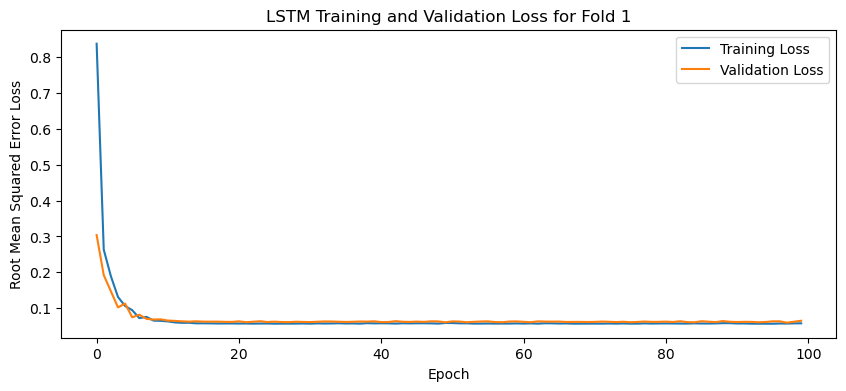

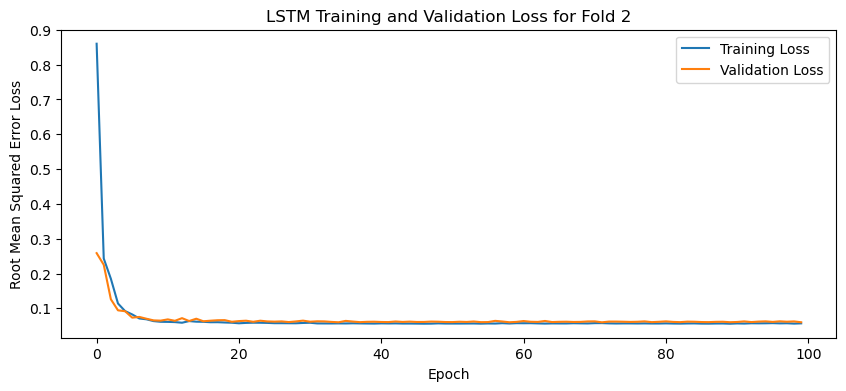

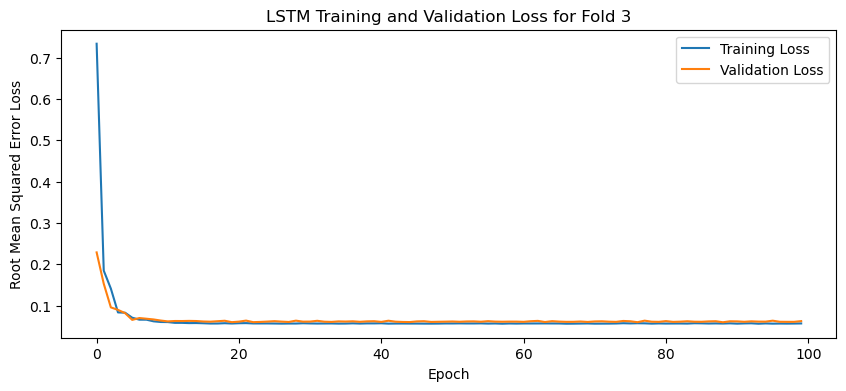

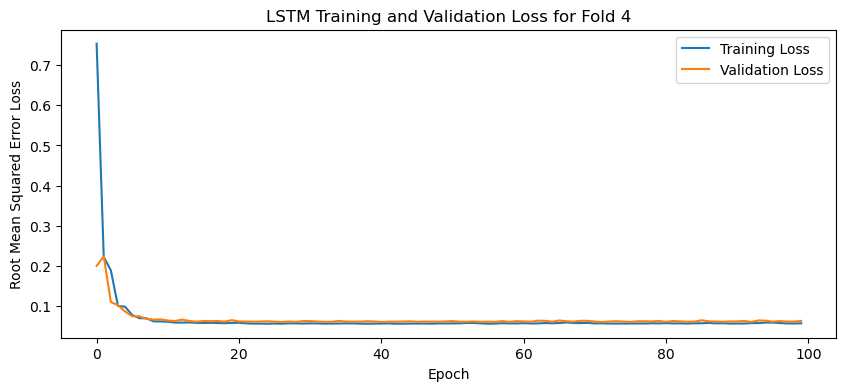

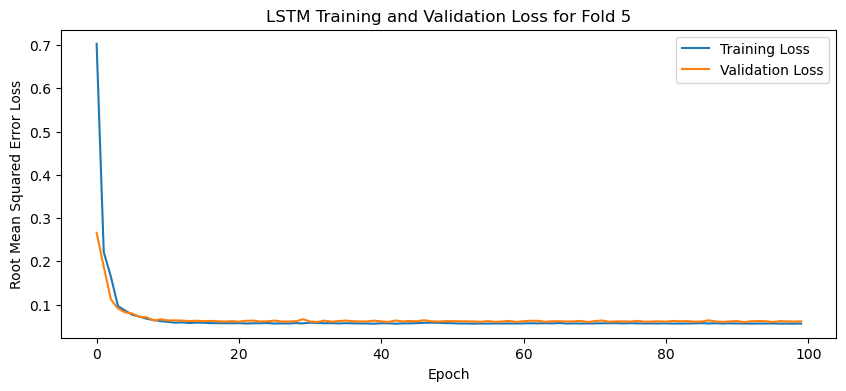

[I 2025-05-09 21:15:01,109] Trial 68 finished with value: 0.042420956492424014 and parameters: {'lr': 0.02000915903982495, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4584665853717621}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.03915797546505928, 0.04493260011076927, 0.041548557579517365, 0.04432876408100128, 0.04213688522577286]
Mean Cross Validation Accuracy:
0.042420956492424014
Standard Deviation of Cross Validation Accuracy:
0.0020705991883185493


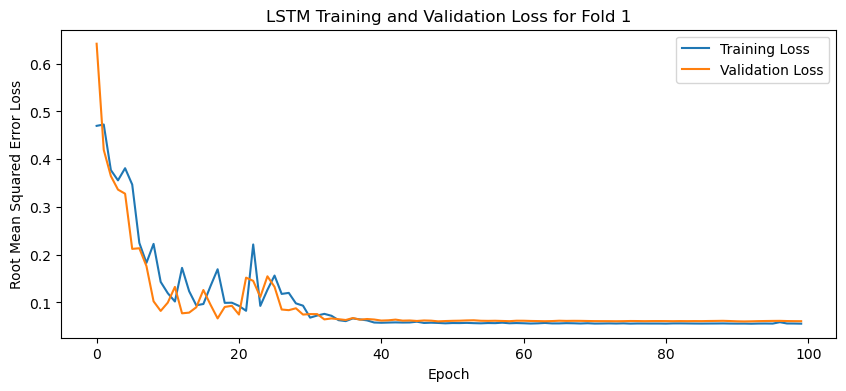

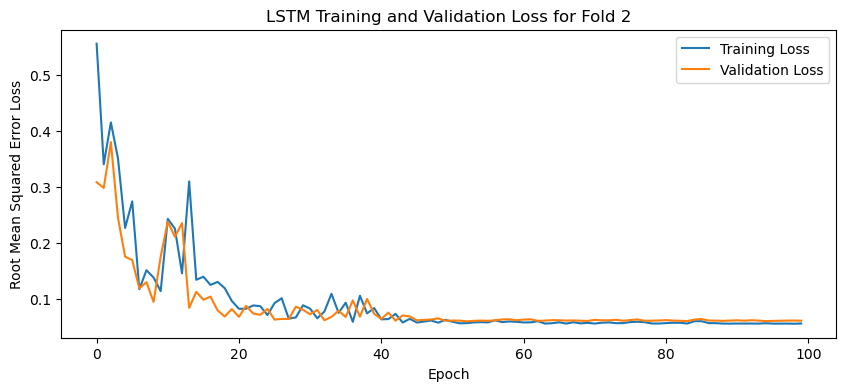

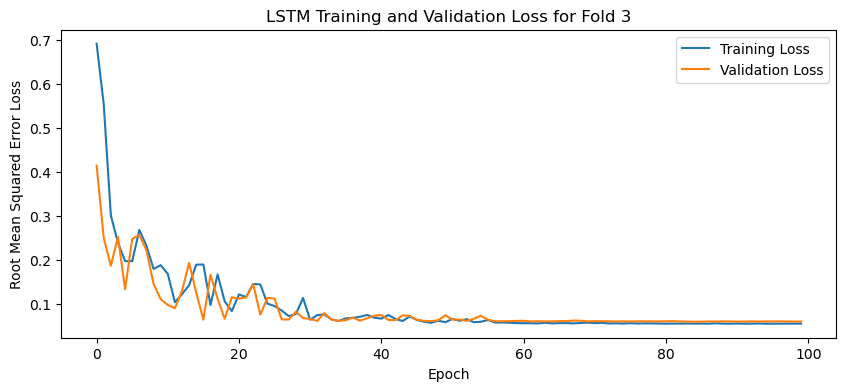

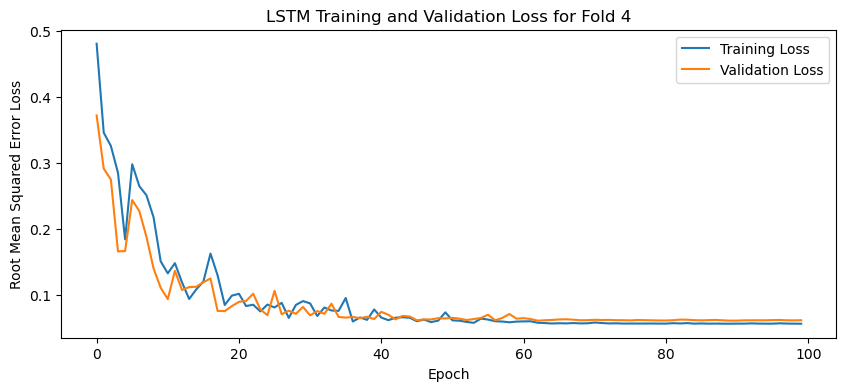

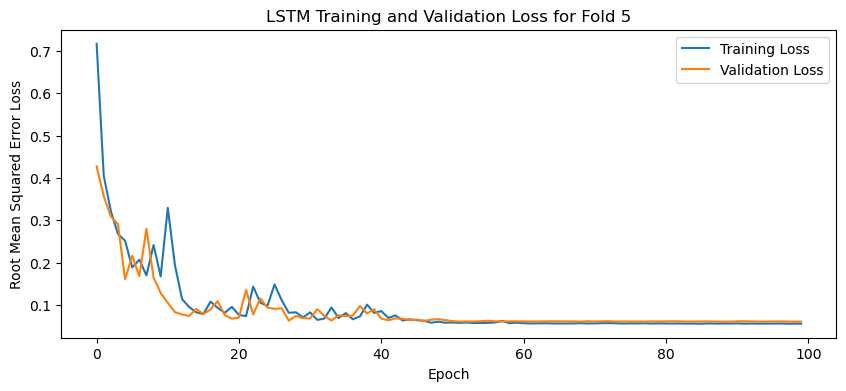

[I 2025-05-09 21:16:32,743] Trial 69 finished with value: 0.04315791055560112 and parameters: {'lr': 0.018175411299255973, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4576103746857479}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04338640719652176, 0.04217829555273056, 0.04414884373545647, 0.0425160750746727, 0.043559931218624115]
Mean Cross Validation Accuracy:
0.04315791055560112
Standard Deviation of Cross Validation Accuracy:
0.0007165721504182809


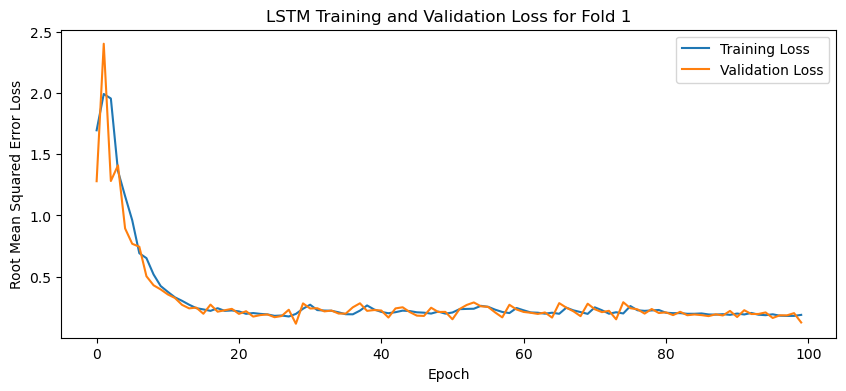

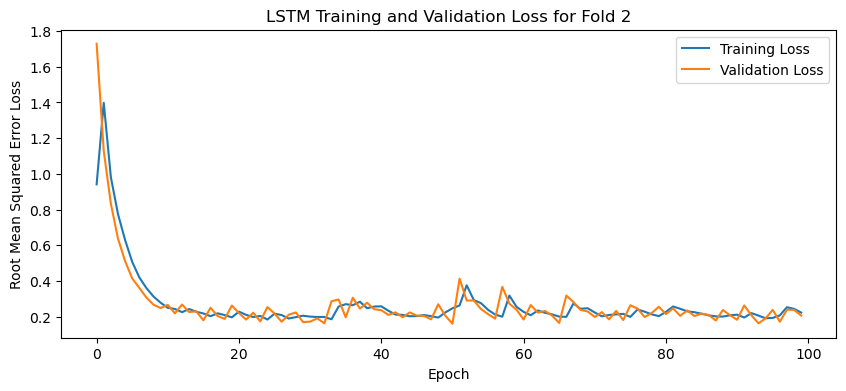

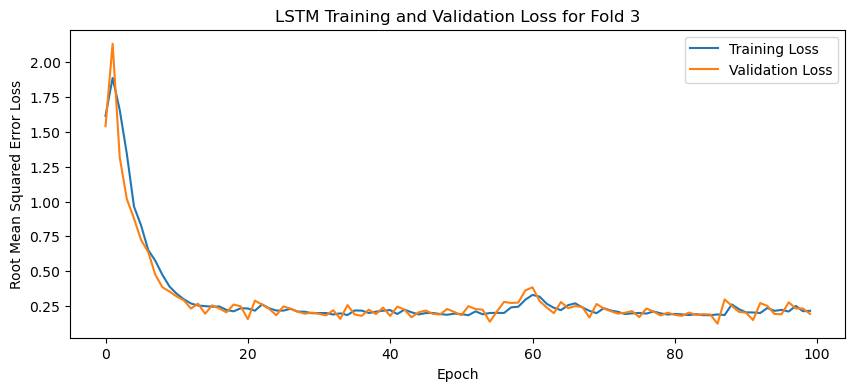

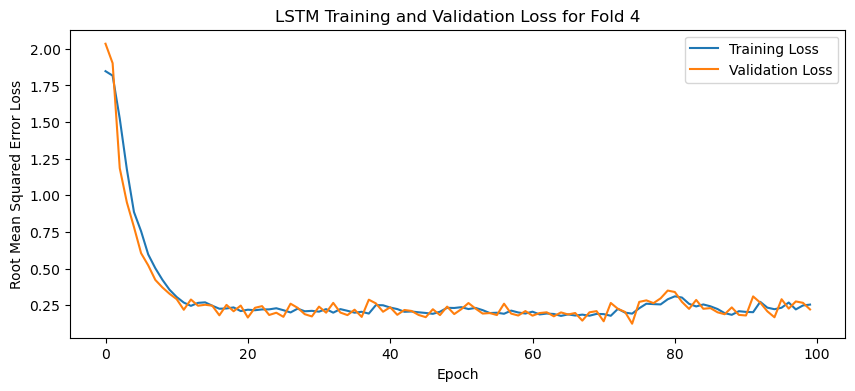

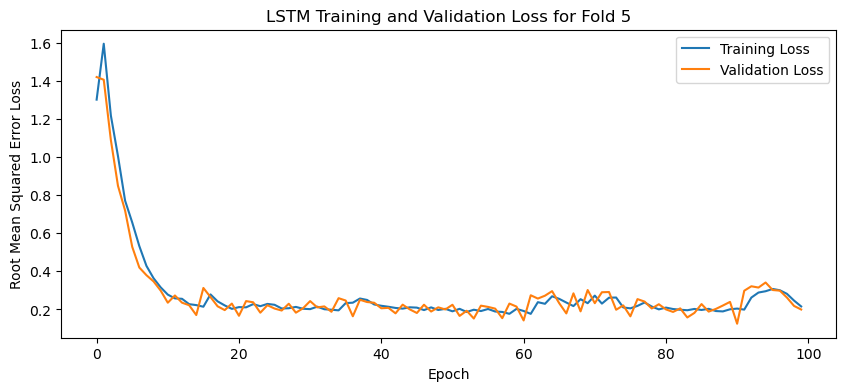

[I 2025-05-09 21:19:49,637] Trial 70 finished with value: 0.18458277434110643 and parameters: {'lr': 0.03883604549592125, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.48754022304091654}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.10945773869752884, 0.21286755800247192, 0.18832001090049744, 0.2183210253715515, 0.19394753873348236]
Mean Cross Validation Accuracy:
0.18458277434110643
Standard Deviation of Cross Validation Accuracy:
0.039201365534986


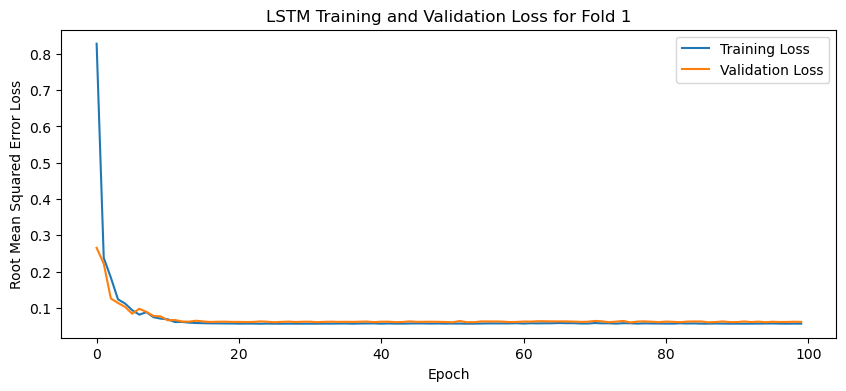

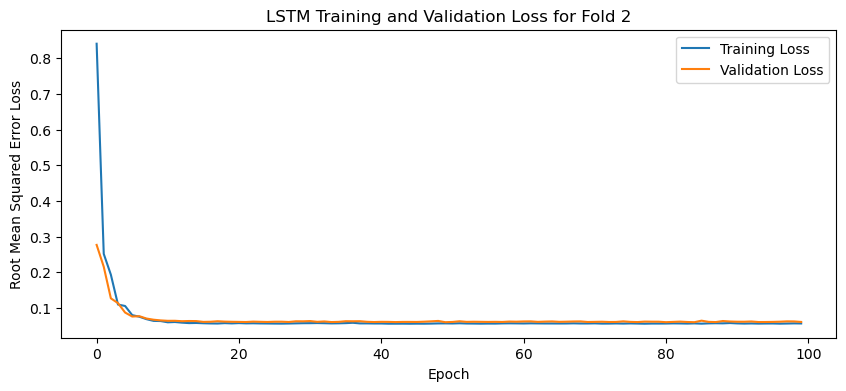

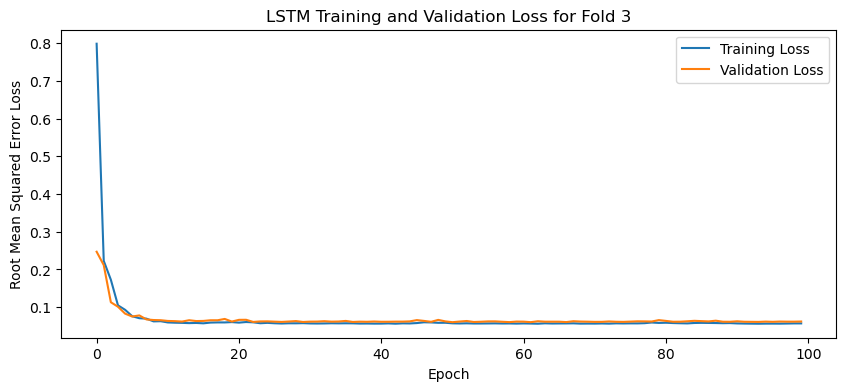

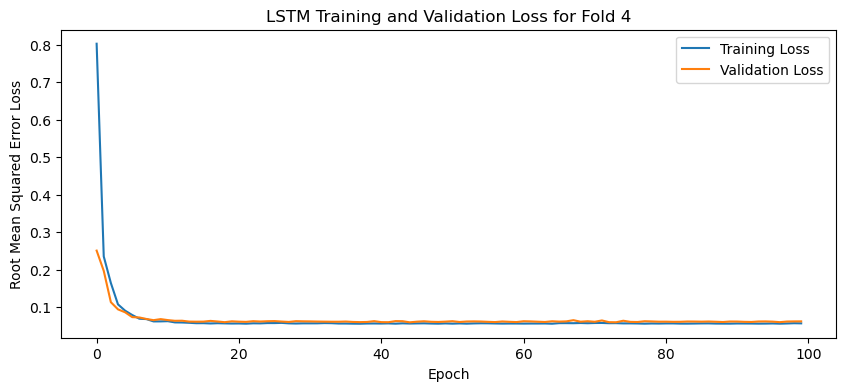

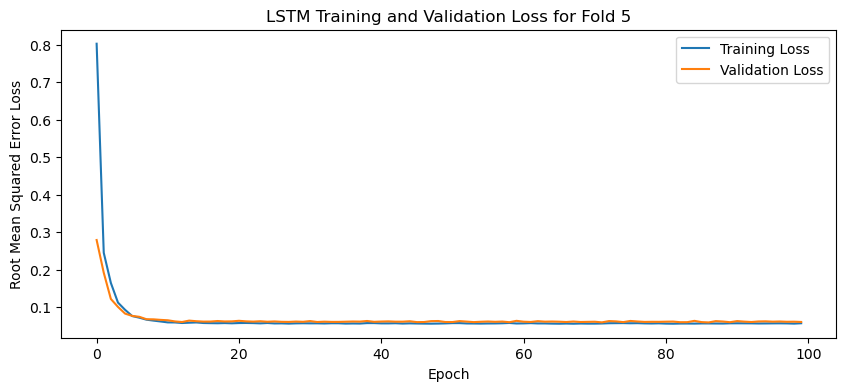

[I 2025-05-09 21:23:07,183] Trial 71 finished with value: 0.04359601214528084 and parameters: {'lr': 0.02117213646864342, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4428243360892959}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04521682858467102, 0.043459899723529816, 0.04248920455574989, 0.04355907812714577, 0.043255049735307693]
Mean Cross Validation Accuracy:
0.04359601214528084
Standard Deviation of Cross Validation Accuracy:
0.0008931086214460137


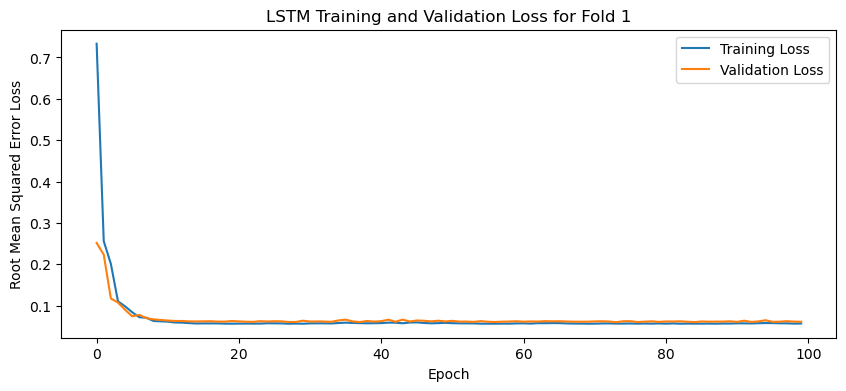

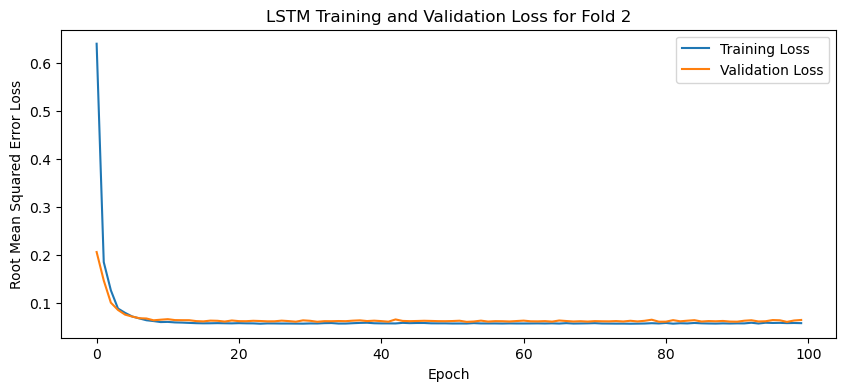

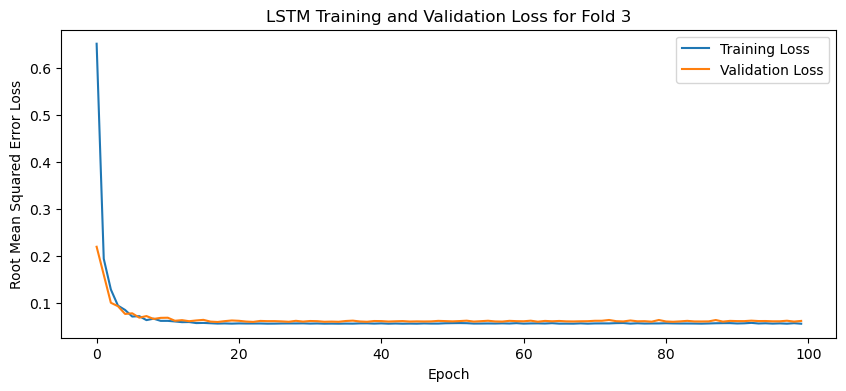

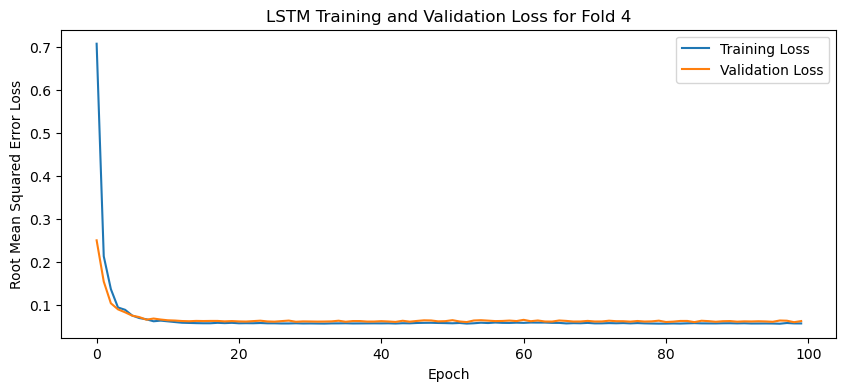

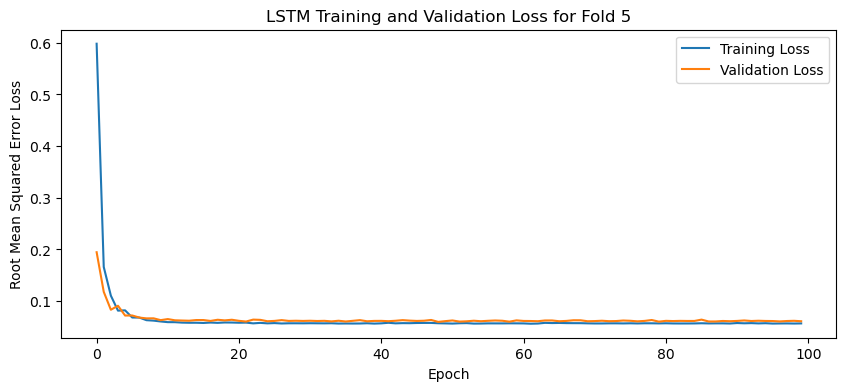

[I 2025-05-09 21:26:38,395] Trial 72 finished with value: 0.043261338770389554 and parameters: {'lr': 0.015812187699979045, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.475330176994796}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.044810257852077484, 0.03989211842417717, 0.04716810956597328, 0.04136408120393753, 0.04307212680578232]
Mean Cross Validation Accuracy:
0.043261338770389554
Standard Deviation of Cross Validation Accuracy:
0.00255534896063862


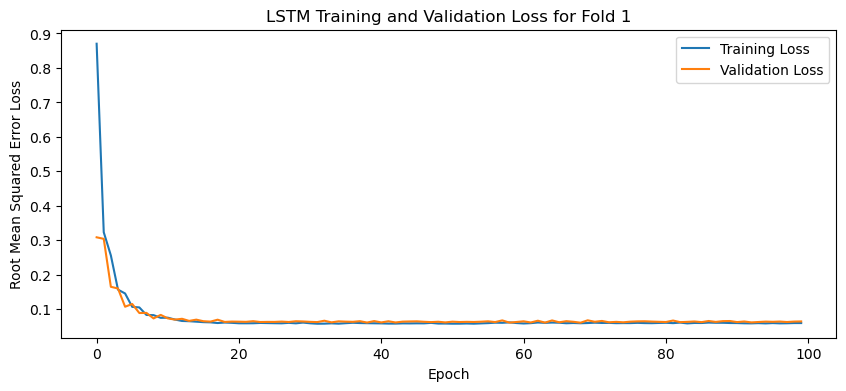

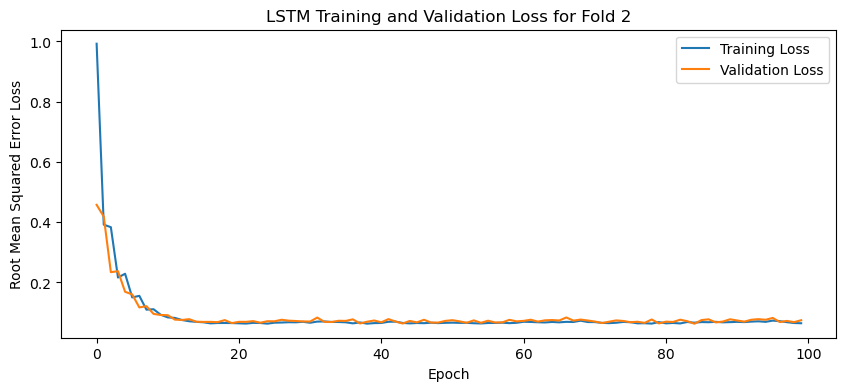

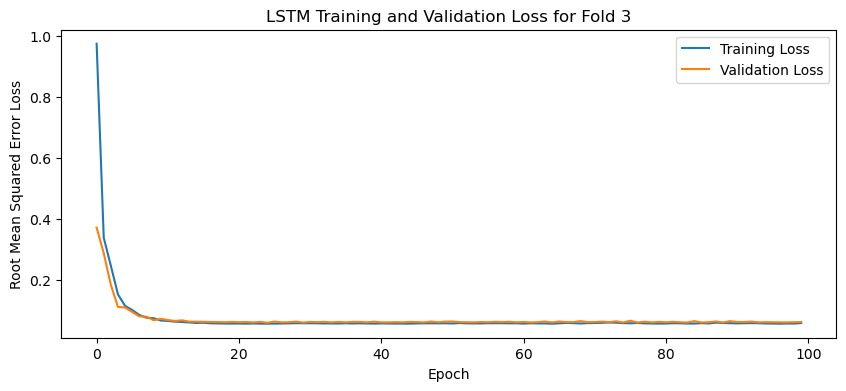

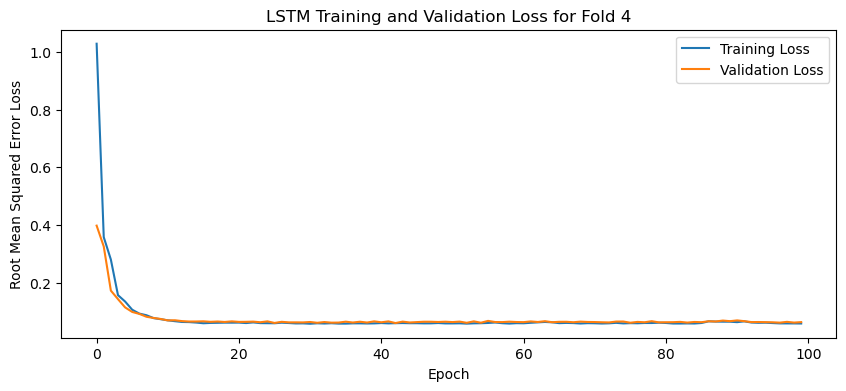

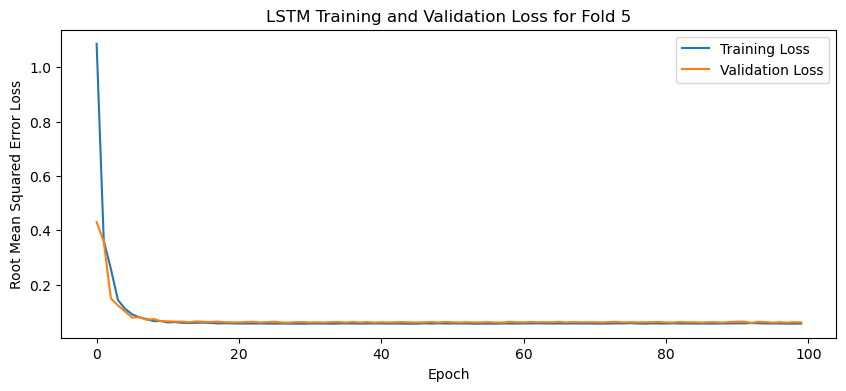

[I 2025-05-09 21:29:58,254] Trial 73 finished with value: 0.046663996577262876 and parameters: {'lr': 0.03113955907355689, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.41120346168381705}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.0465402752161026, 0.05028429999947548, 0.04386556148529053, 0.04743067920207977, 0.04519916698336601]
Mean Cross Validation Accuracy:
0.046663996577262876
Standard Deviation of Cross Validation Accuracy:
0.002176541788913142


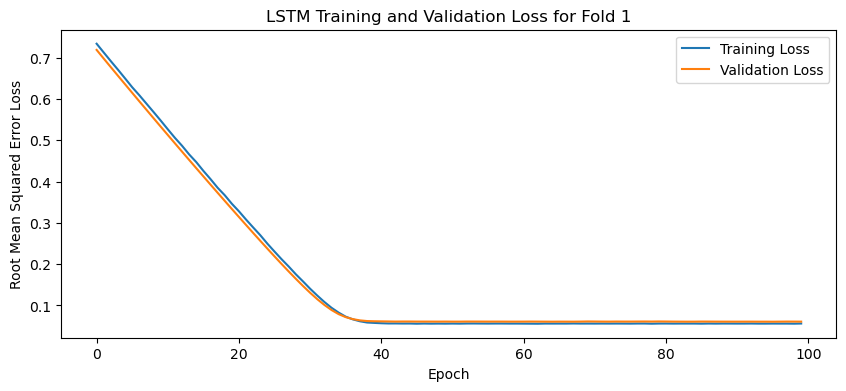

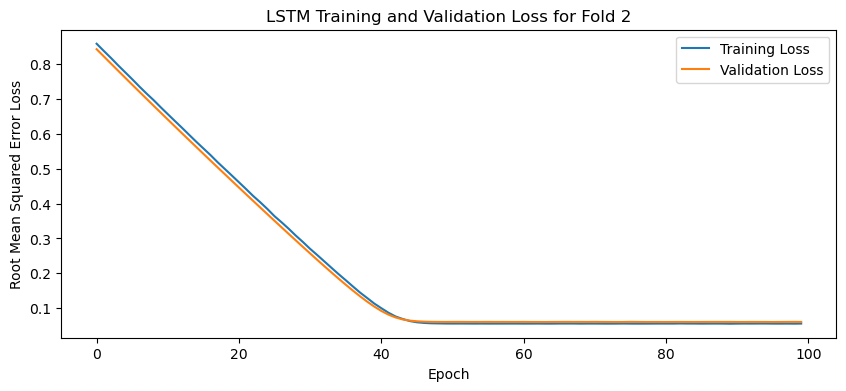

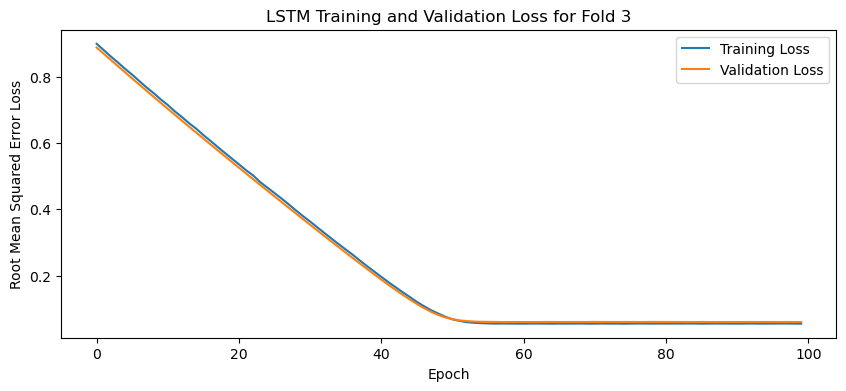

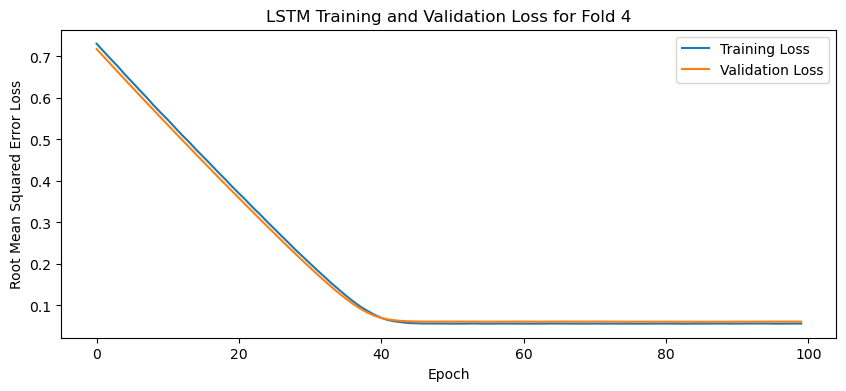

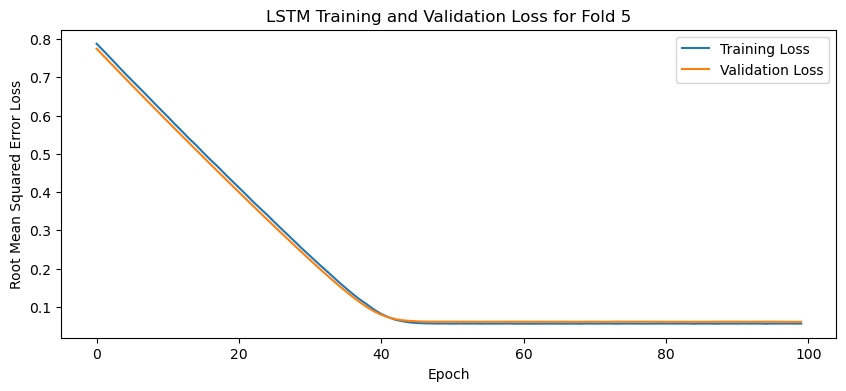

[I 2025-05-09 21:32:38,863] Trial 74 finished with value: 0.042696813493967055 and parameters: {'lr': 0.009360539657161947, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4669923992998499}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.0427684411406517, 0.042660731822252274, 0.04254084825515747, 0.0425756610929966, 0.04293838515877724]
Mean Cross Validation Accuracy:
0.042696813493967055
Standard Deviation of Cross Validation Accuracy:
0.0001440779900056314


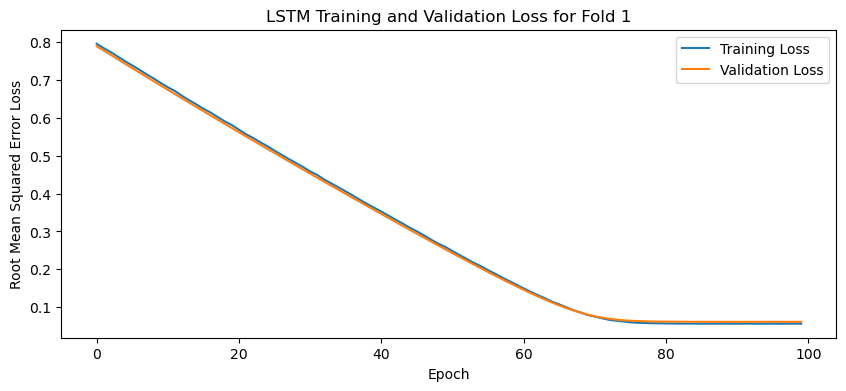

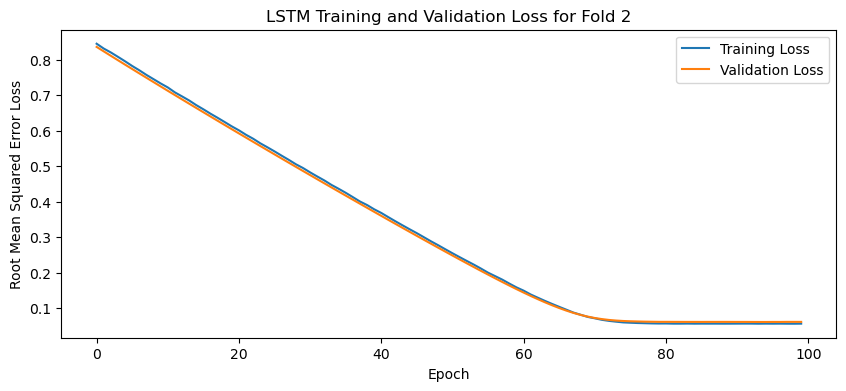

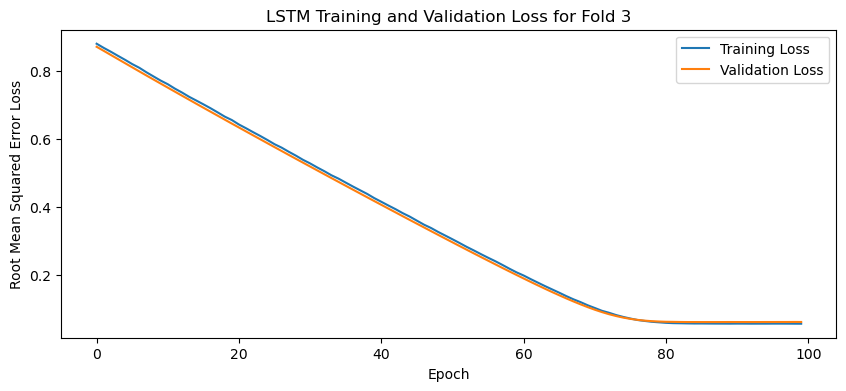

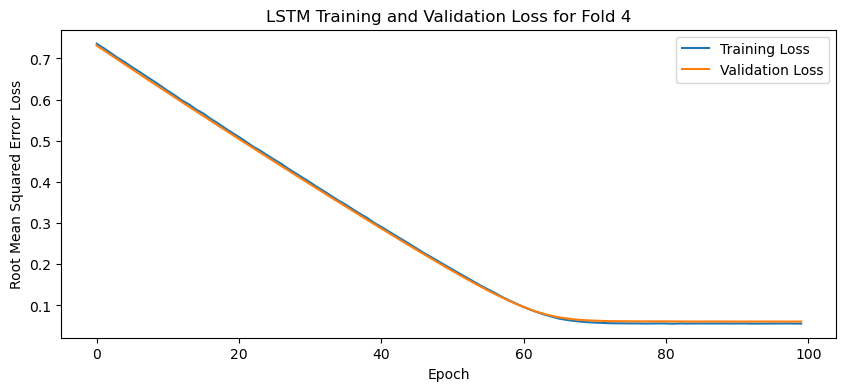

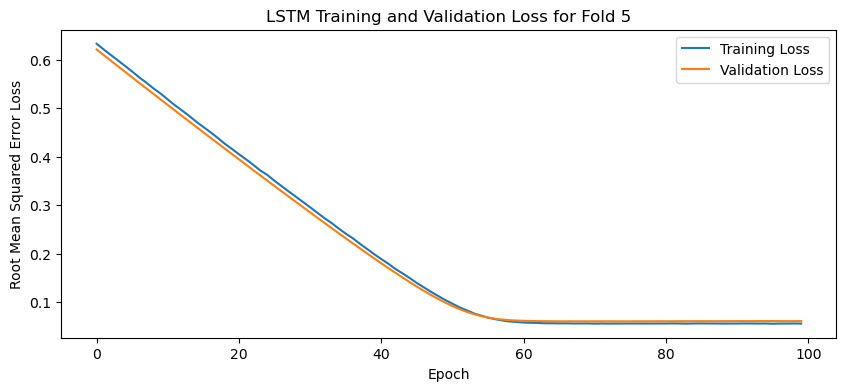

[I 2025-05-09 21:35:18,744] Trial 75 finished with value: 0.042394920438528064 and parameters: {'lr': 0.005731055936370757, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4534767835143057}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.042630769312381744, 0.04248529672622681, 0.04214983806014061, 0.042600035667419434, 0.04210866242647171]
Mean Cross Validation Accuracy:
0.042394920438528064
Standard Deviation of Cross Validation Accuracy:
0.0002226539213496681


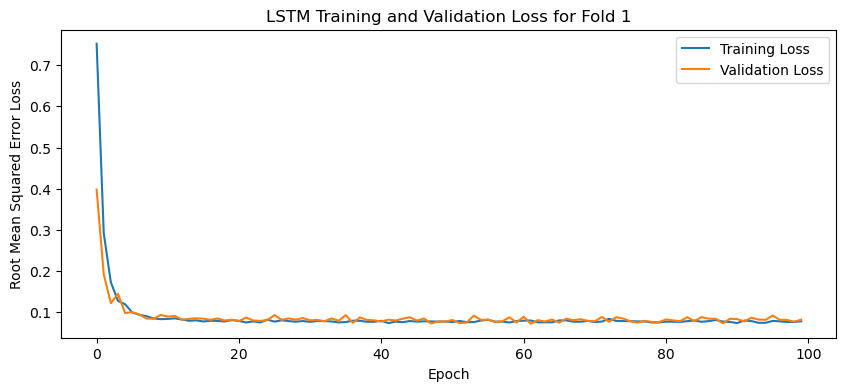

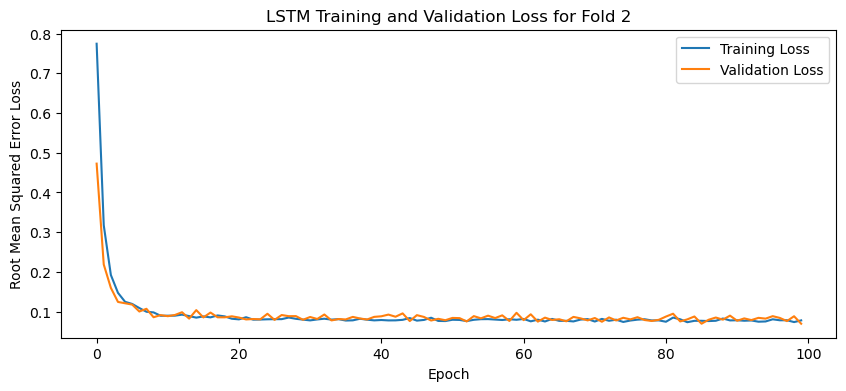

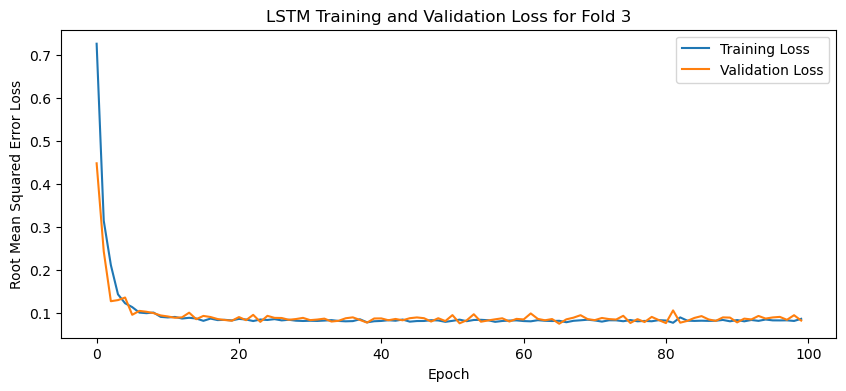

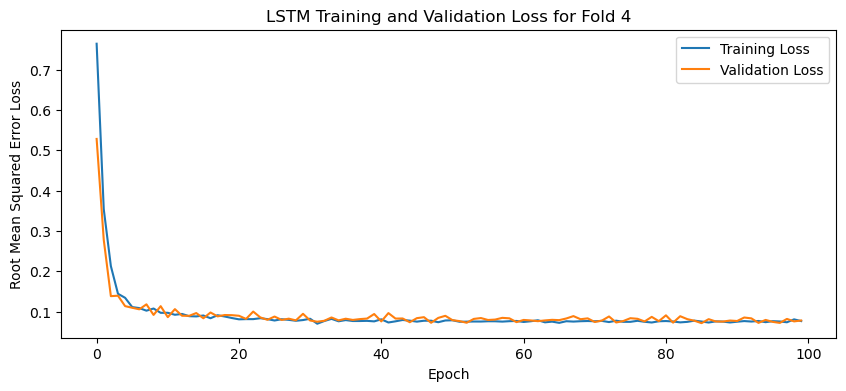

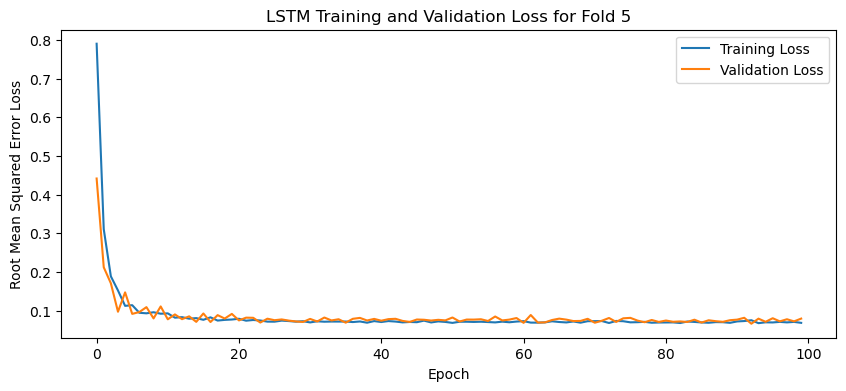

[I 2025-05-09 21:39:56,737] Trial 76 finished with value: 0.0686887226998806 and parameters: {'lr': 0.007178695636649488, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3905242057388098}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.061484143137931824, 0.062208715826272964, 0.08620540052652359, 0.07204365730285645, 0.061501696705818176]
Mean Cross Validation Accuracy:
0.0686887226998806
Standard Deviation of Cross Validation Accuracy:
0.009629531521921843


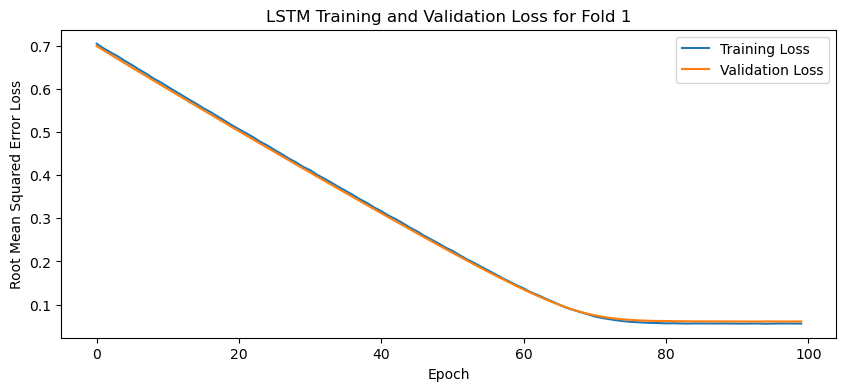

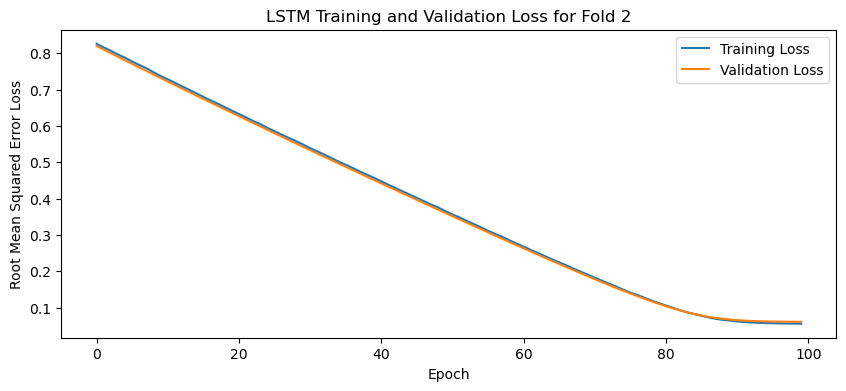

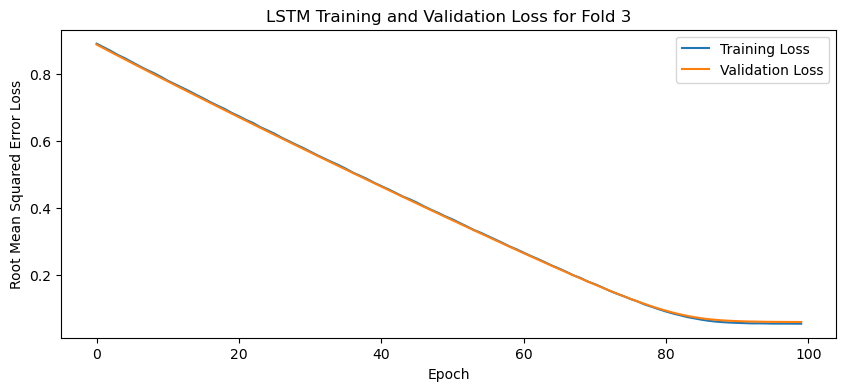

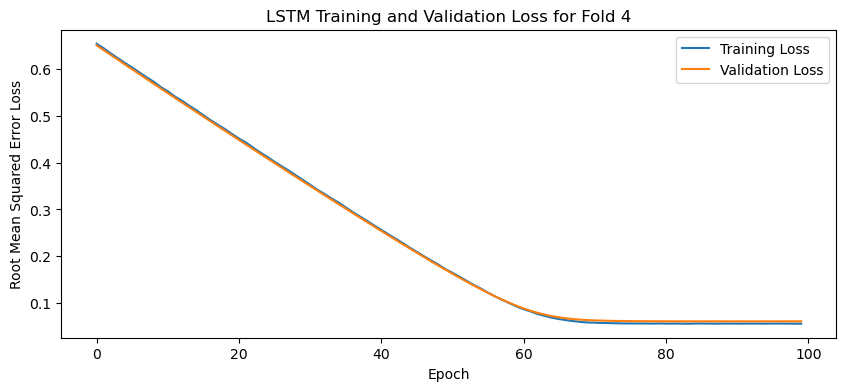

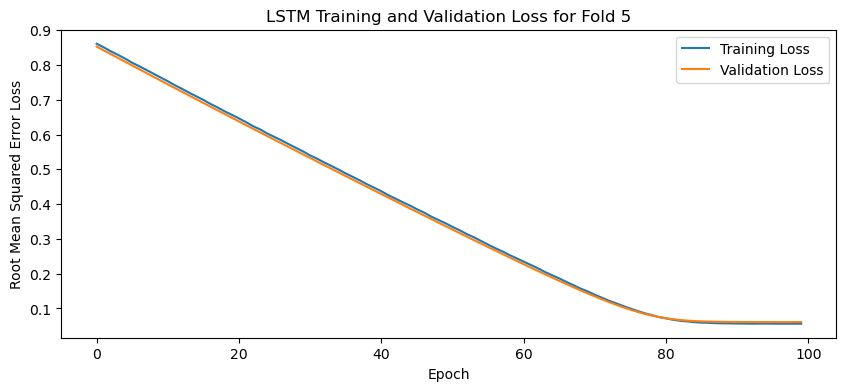

[I 2025-05-09 21:42:37,280] Trial 77 finished with value: 0.042417917400598526 and parameters: {'lr': 0.005068341759306556, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4539041943472102}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04245474189519882, 0.04220808669924736, 0.04225800931453705, 0.042484916746616364, 0.042683832347393036]
Mean Cross Validation Accuracy:
0.042417917400598526
Standard Deviation of Cross Validation Accuracy:
0.0001709708945496158


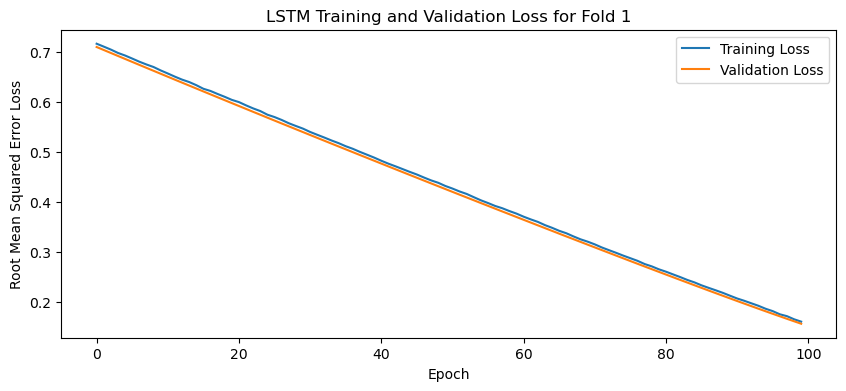

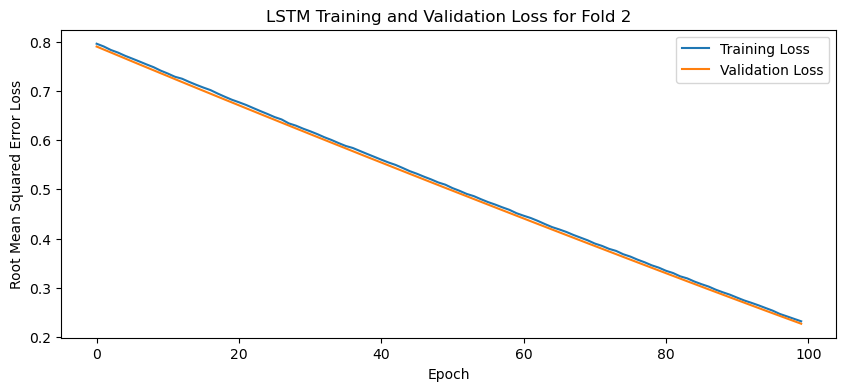

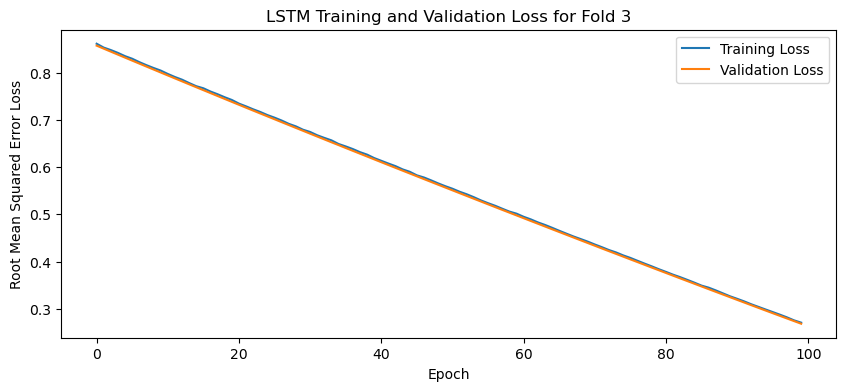

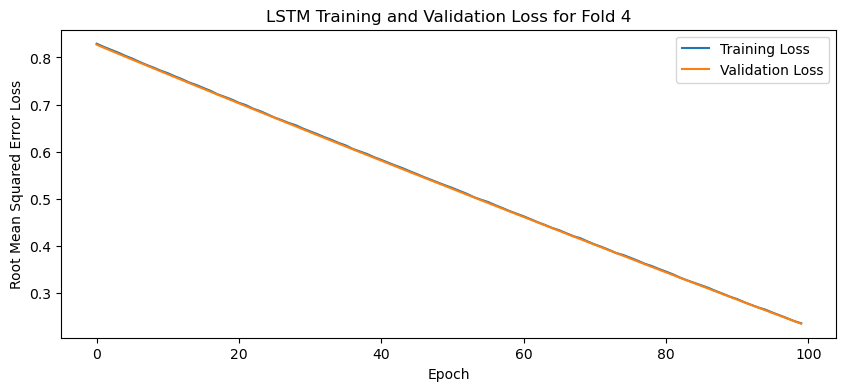

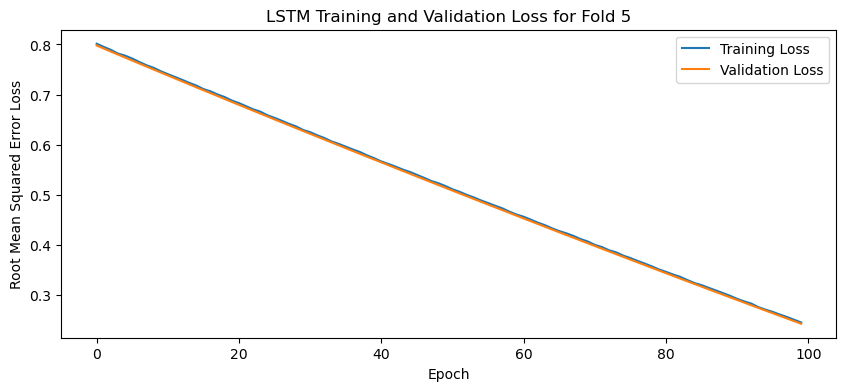

[I 2025-05-09 21:44:21,362] Trial 78 finished with value: 0.2213812679052353 and parameters: {'lr': 0.002998339178472893, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.44803660962096487}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.15412768721580505, 0.225749209523201, 0.26330965757369995, 0.2268235683441162, 0.23689621686935425]
Mean Cross Validation Accuracy:
0.2213812679052353
Standard Deviation of Cross Validation Accuracy:
0.036250365970965134


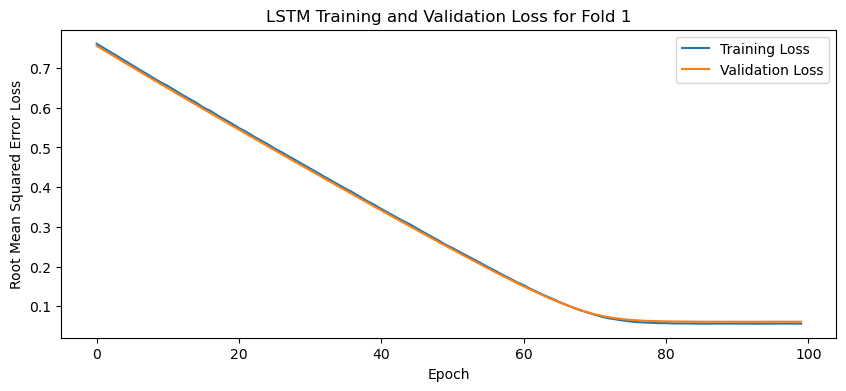

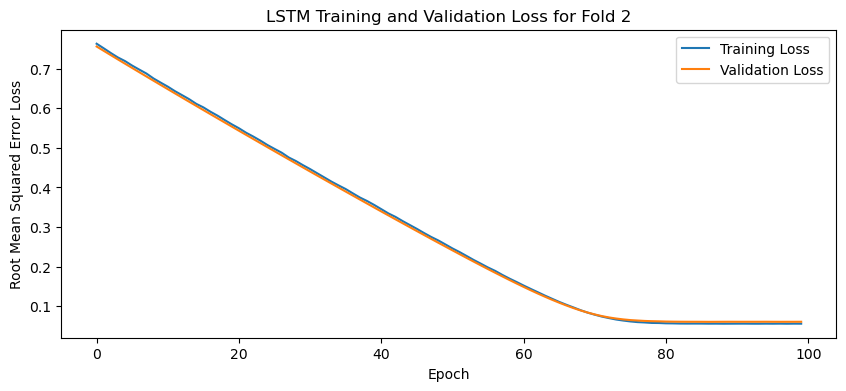

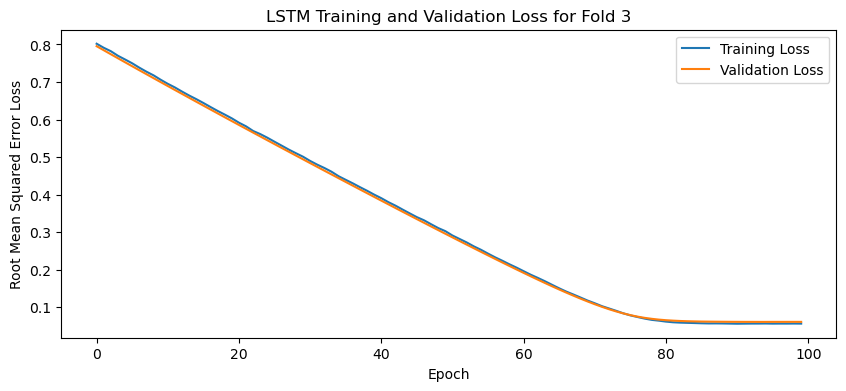

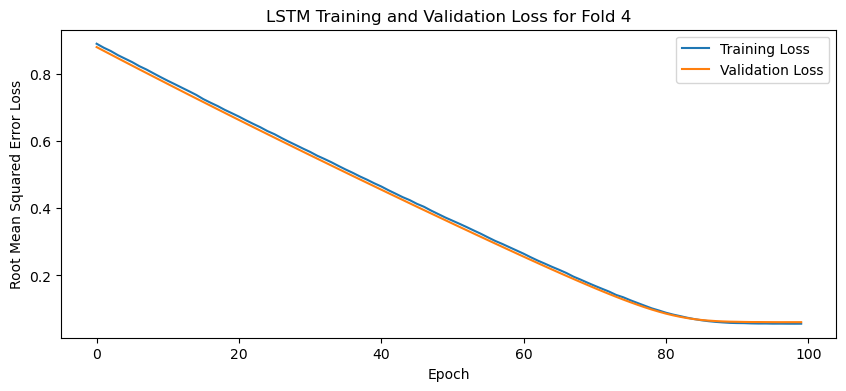

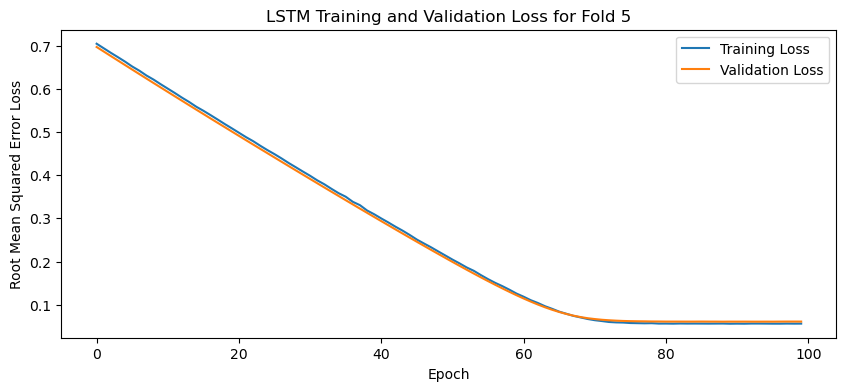

[I 2025-05-09 21:47:08,593] Trial 79 finished with value: 0.042463735491037366 and parameters: {'lr': 0.005145071815069288, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4997548391334234}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.042395398020744324, 0.04228261485695839, 0.04277025908231735, 0.0424453541636467, 0.04242505133152008]
Mean Cross Validation Accuracy:
0.042463735491037366
Standard Deviation of Cross Validation Accuracy:
0.00016325792069030209


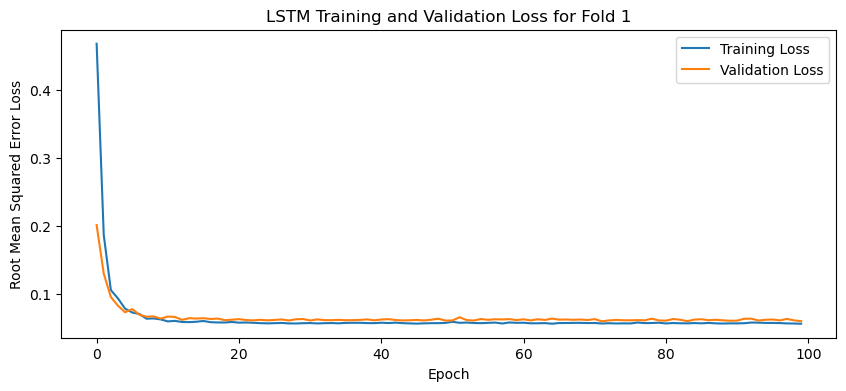

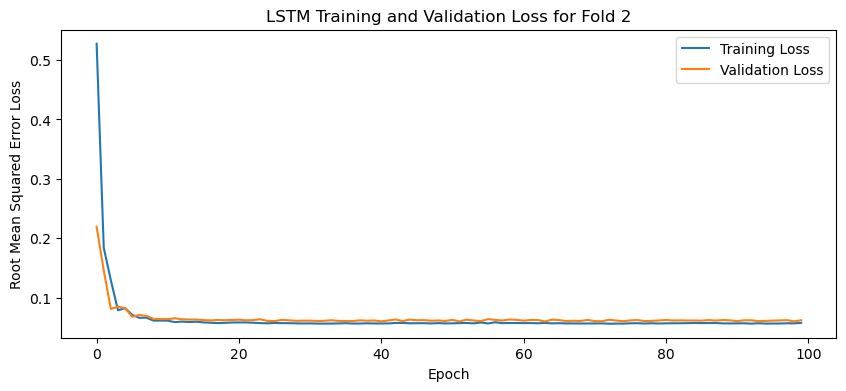

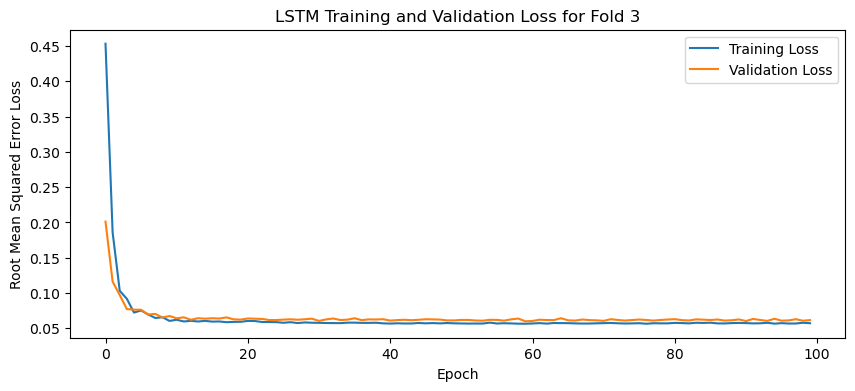

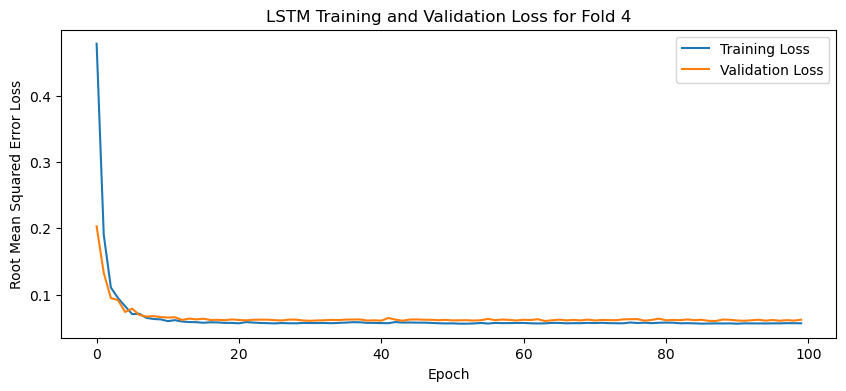

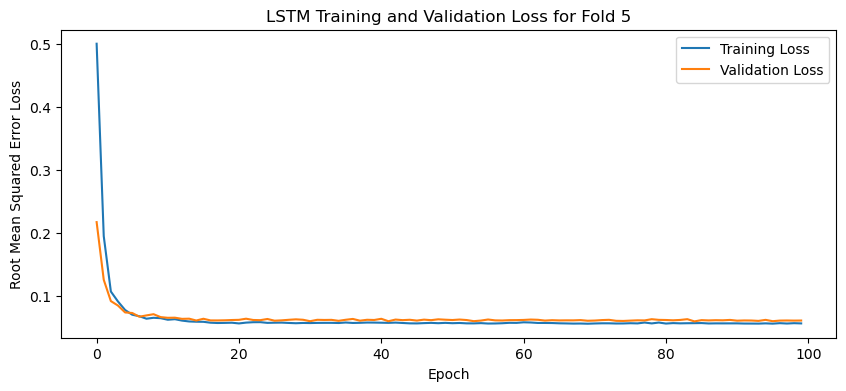

[I 2025-05-09 21:50:42,174] Trial 80 finished with value: 0.04425574764609337 and parameters: {'lr': 0.00540400484579439, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.30644752181251544}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.045691248029470444, 0.041898734867572784, 0.045945264399051666, 0.04320792108774185, 0.044535569846630096]
Mean Cross Validation Accuracy:
0.04425574764609337
Standard Deviation of Cross Validation Accuracy:
0.0015262292362297222


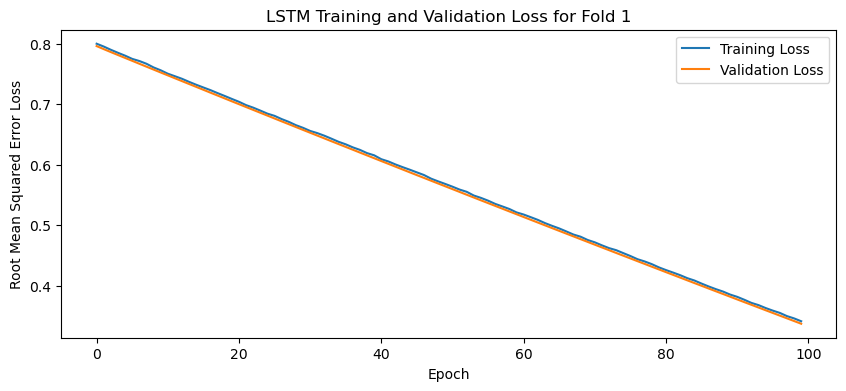

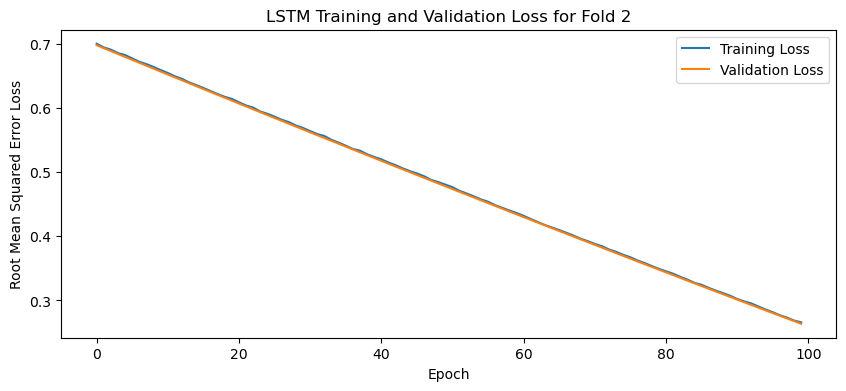

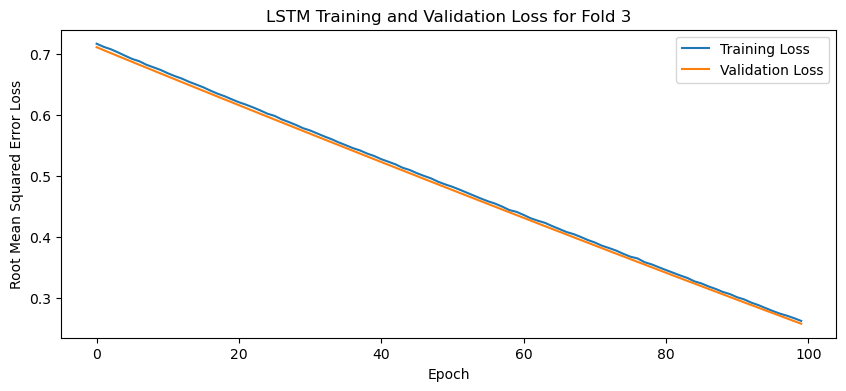

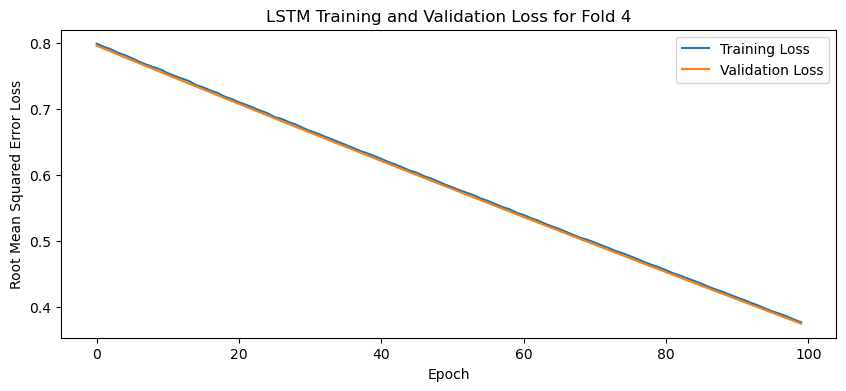

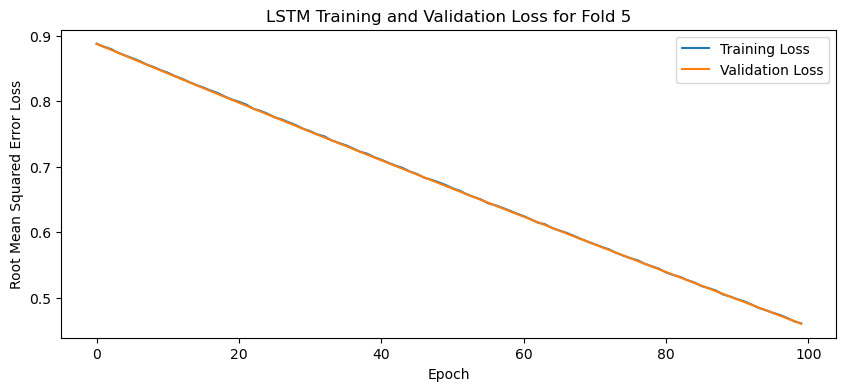

[I 2025-05-09 21:53:20,876] Trial 81 finished with value: 0.33510547280311587 and parameters: {'lr': 0.0022266115138010233, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.46243238325172437}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.33647286891937256, 0.2578284740447998, 0.2560296058654785, 0.37159597873687744, 0.4536004364490509]
Mean Cross Validation Accuracy:
0.33510547280311587
Standard Deviation of Cross Validation Accuracy:
0.07429563981005051


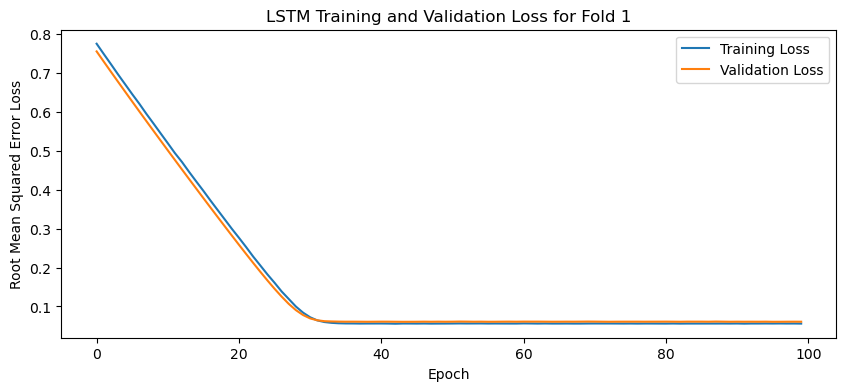

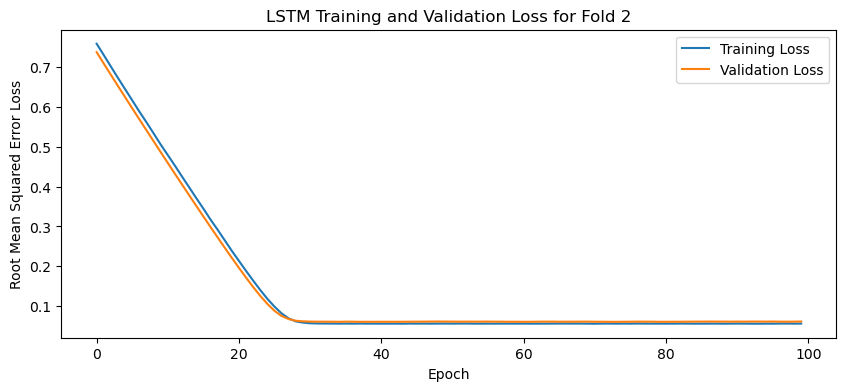

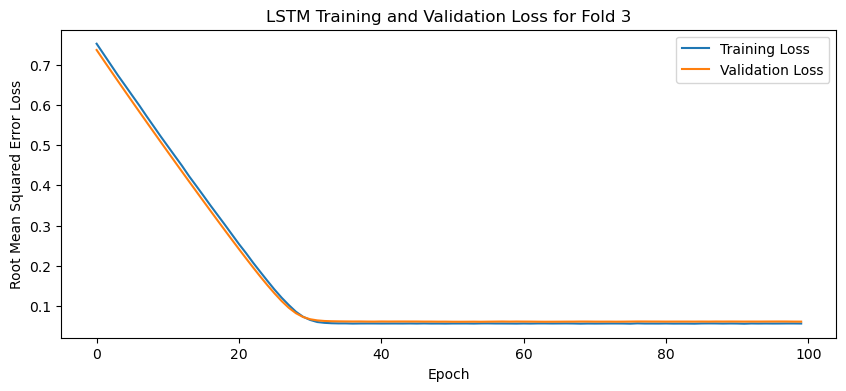

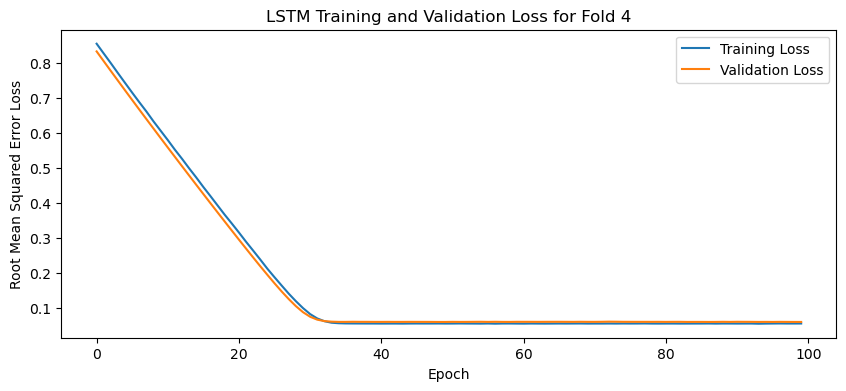

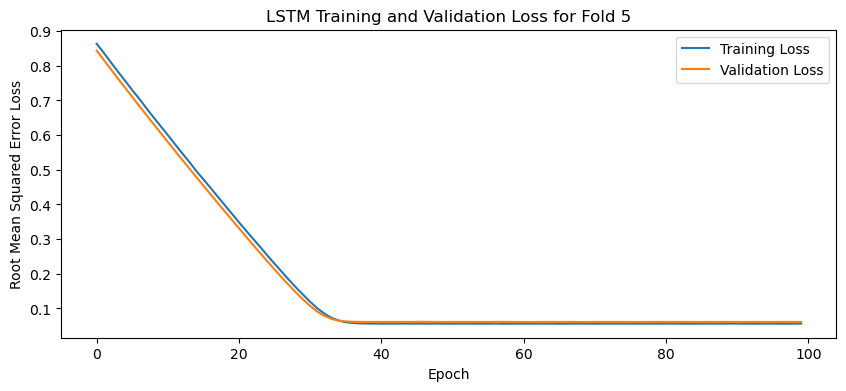

[I 2025-05-09 21:56:09,460] Trial 82 finished with value: 0.04268905147910118 and parameters: {'lr': 0.01295716764541252, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4371366386644878}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04295012727379799, 0.042128343135118484, 0.04297954961657524, 0.042986899614334106, 0.042400337755680084]
Mean Cross Validation Accuracy:
0.04268905147910118
Standard Deviation of Cross Validation Accuracy:
0.000357494814289016


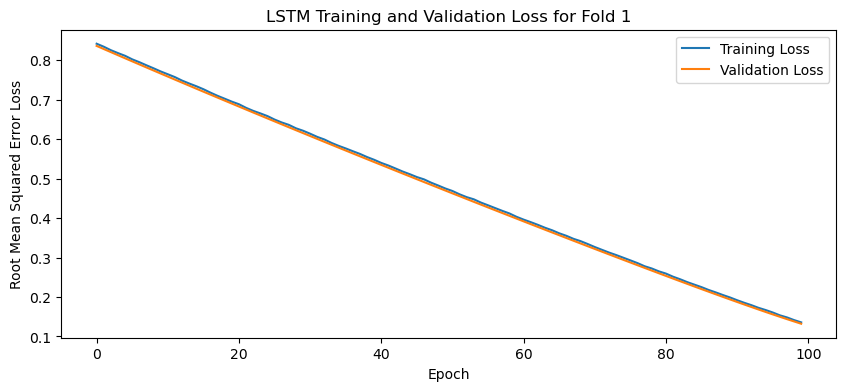

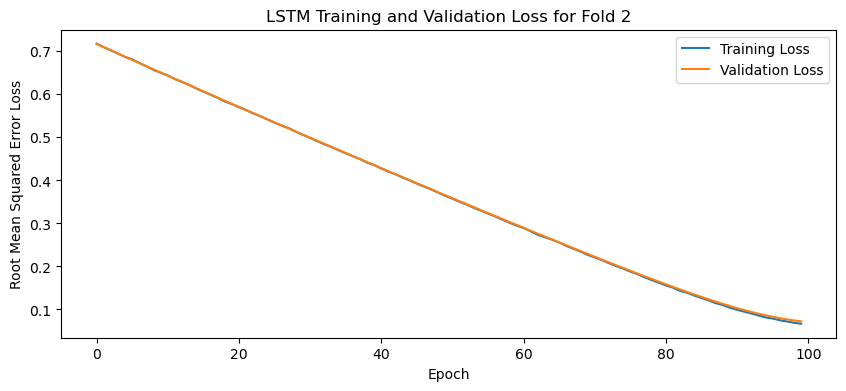

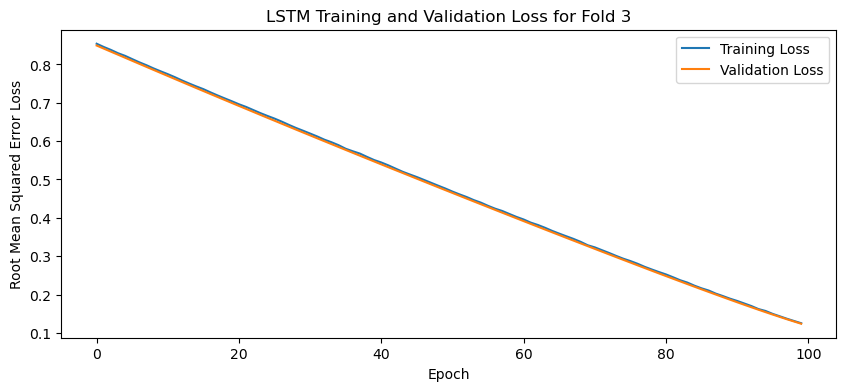

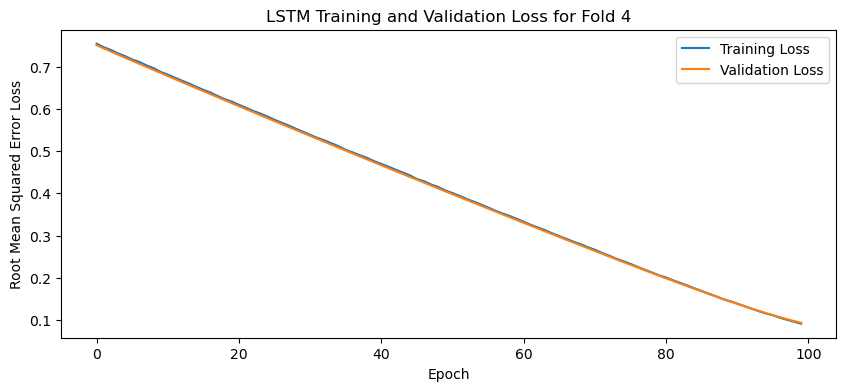

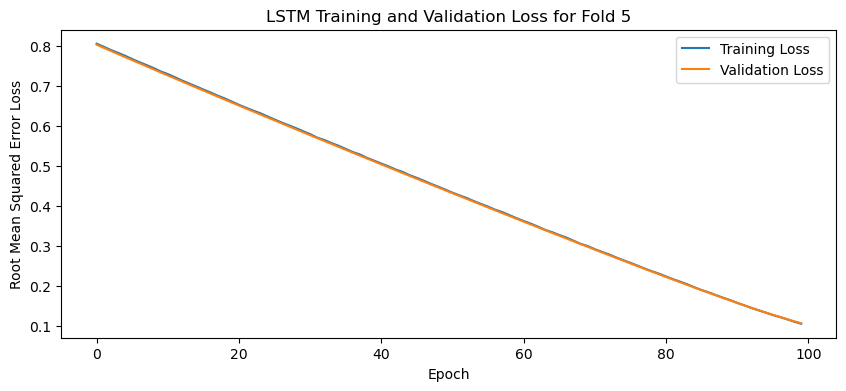

[I 2025-05-09 21:58:36,090] Trial 83 finished with value: 0.09248432666063308 and parameters: {'lr': 0.0037608658168001388, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4558977380839685}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.12959341704845428, 0.04925954341888428, 0.11444156616926193, 0.07727908343076706, 0.09184802323579788]
Mean Cross Validation Accuracy:
0.09248432666063308
Standard Deviation of Cross Validation Accuracy:
0.02813962027559998


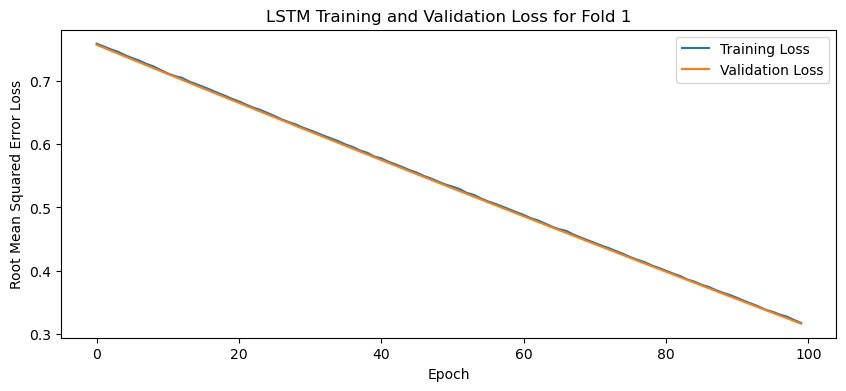

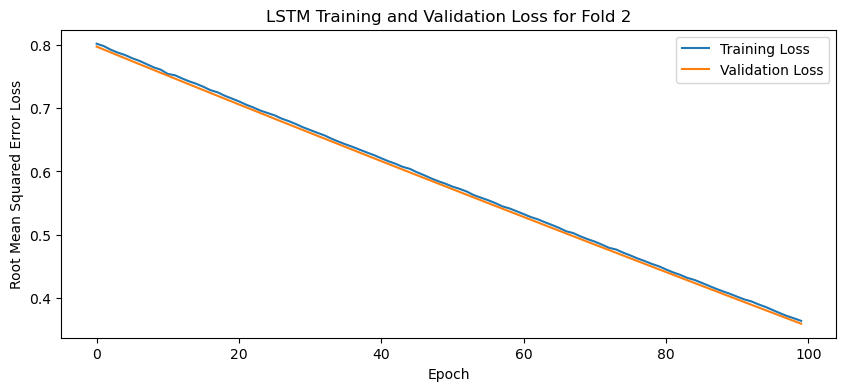

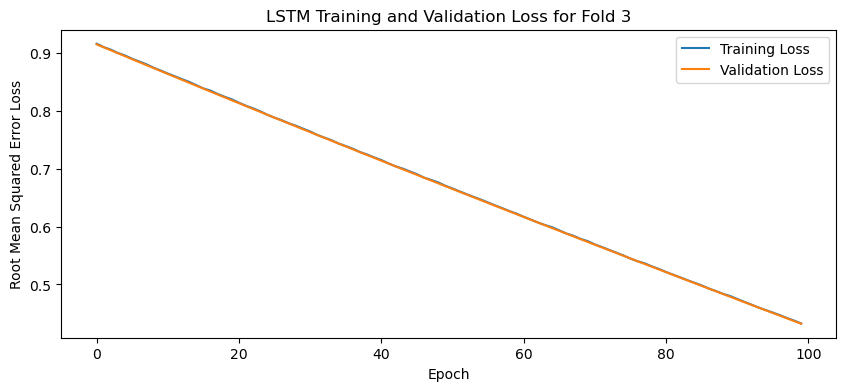

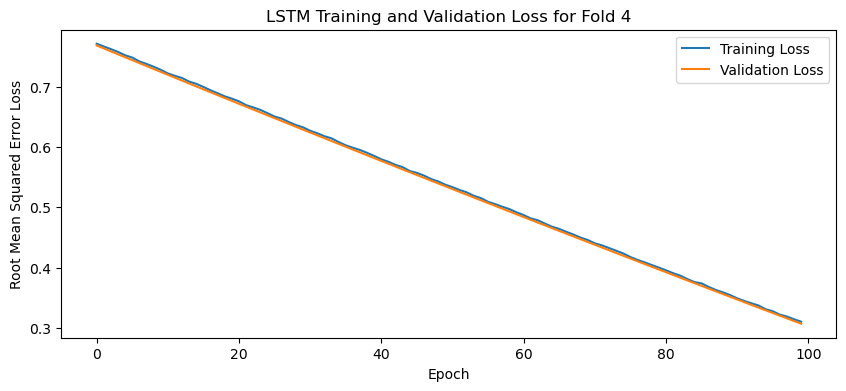

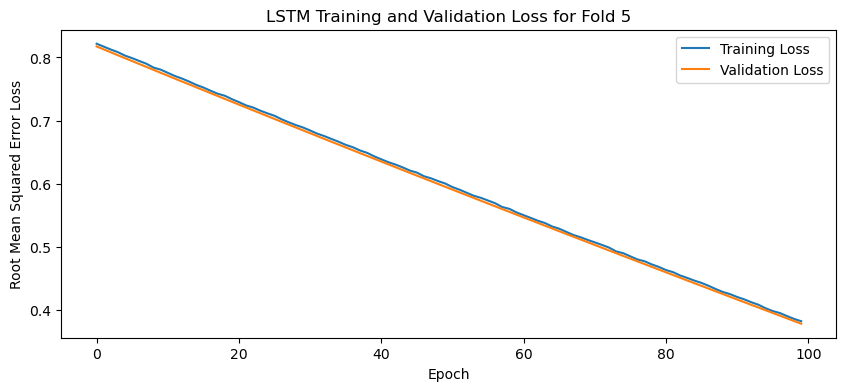

[I 2025-05-09 22:01:11,745] Trial 84 finished with value: 0.35497530102729796 and parameters: {'lr': 0.0023734209139683903, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.47371628326730386}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.3107523024082184, 0.360507994890213, 0.4226780831813812, 0.30407223105430603, 0.3768658936023712]
Mean Cross Validation Accuracy:
0.35497530102729796
Standard Deviation of Cross Validation Accuracy:
0.04390961533789672


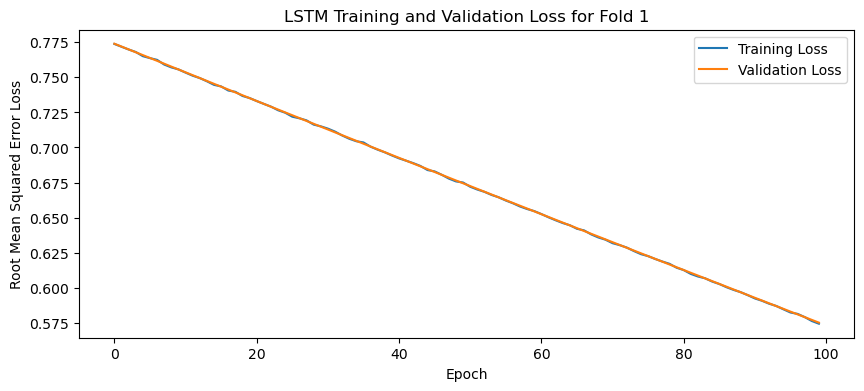

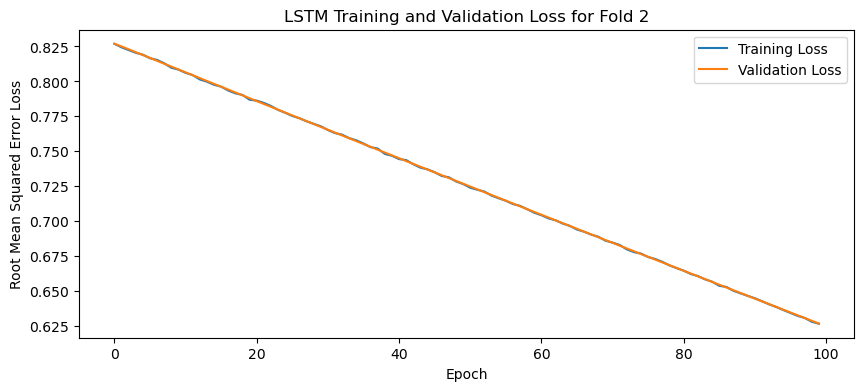

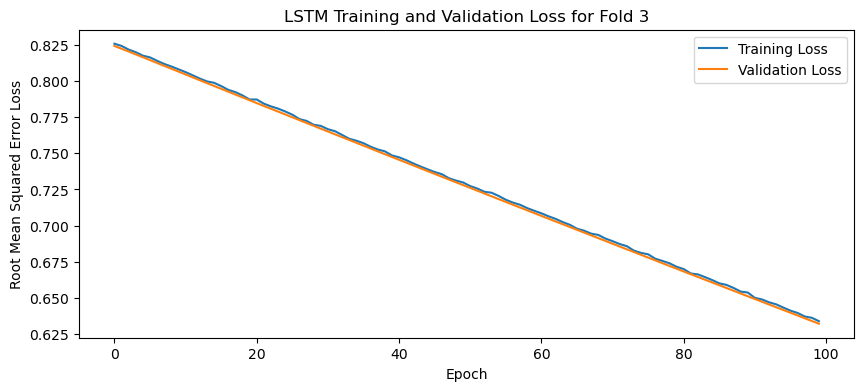

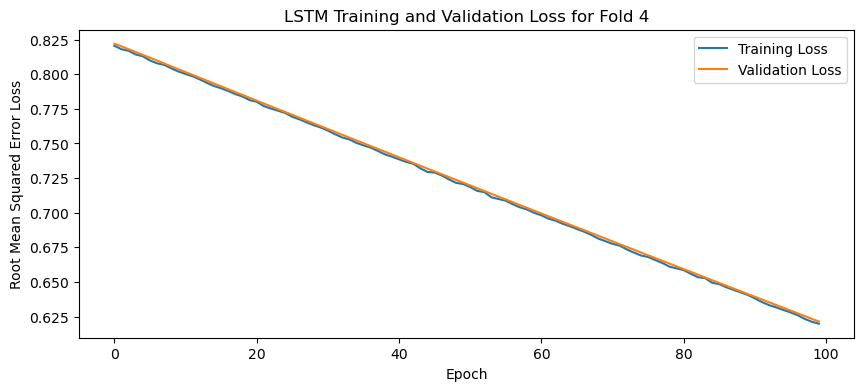

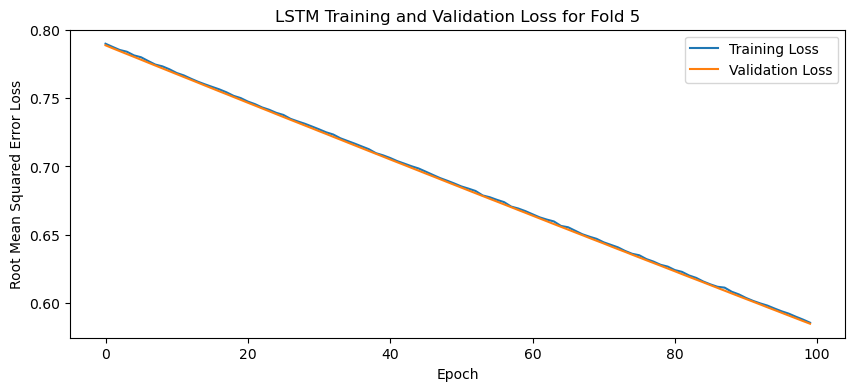

[I 2025-05-09 22:02:43,188] Trial 85 finished with value: 0.6040965437889099 and parameters: {'lr': 0.0010172960276660027, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4227516873852763}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.5709214210510254, 0.6233163475990295, 0.6295919418334961, 0.6152186989784241, 0.5814343094825745]
Mean Cross Validation Accuracy:
0.6040965437889099
Standard Deviation of Cross Validation Accuracy:
0.02348311797202392


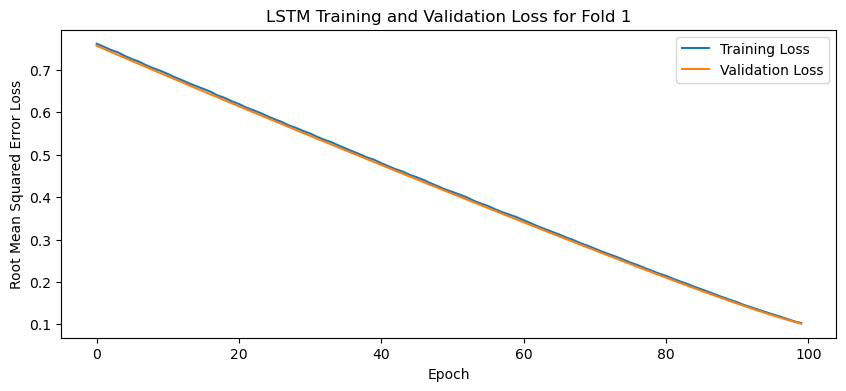

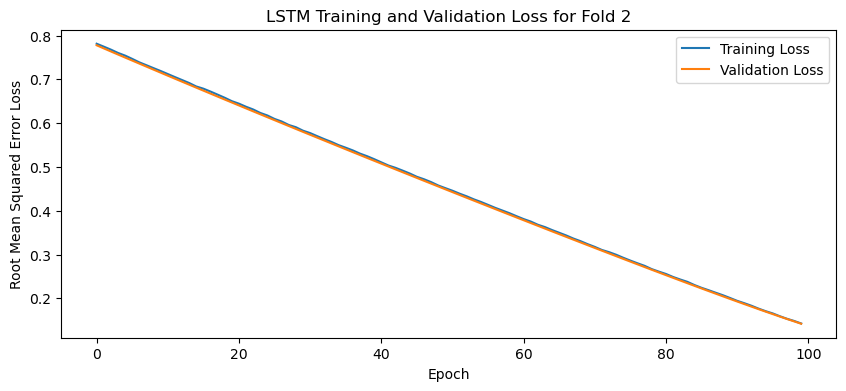

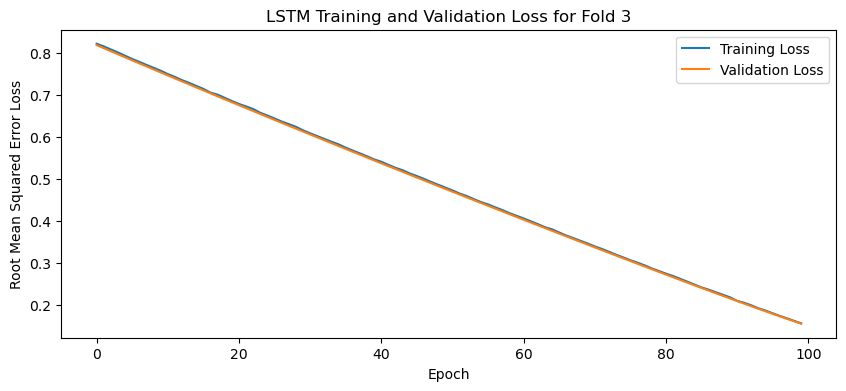

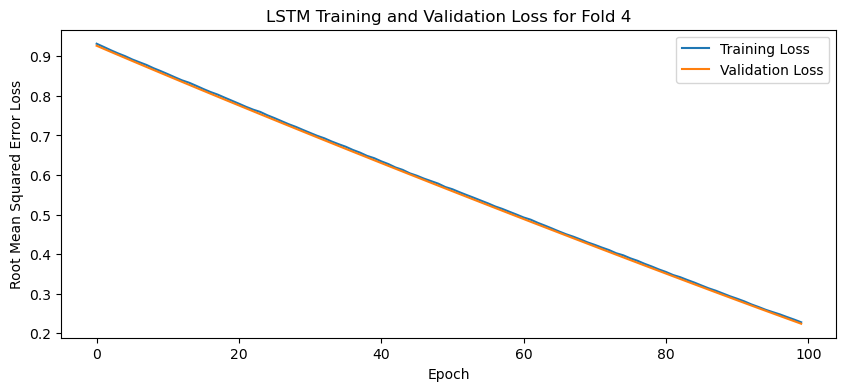

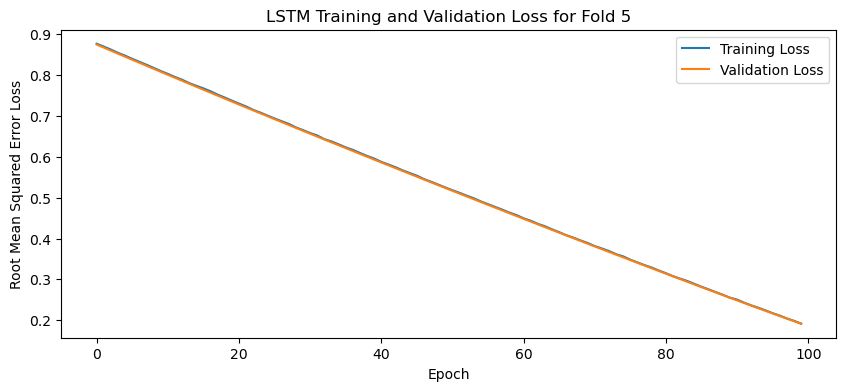

[I 2025-05-09 22:05:54,073] Trial 86 finished with value: 0.15440042167901993 and parameters: {'lr': 0.0035246757173360566, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4835220943791722}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.09073852747678757, 0.1331690102815628, 0.14817096292972565, 0.2199787050485611, 0.17994490265846252]
Mean Cross Validation Accuracy:
0.15440042167901993
Standard Deviation of Cross Validation Accuracy:
0.04357854407356538


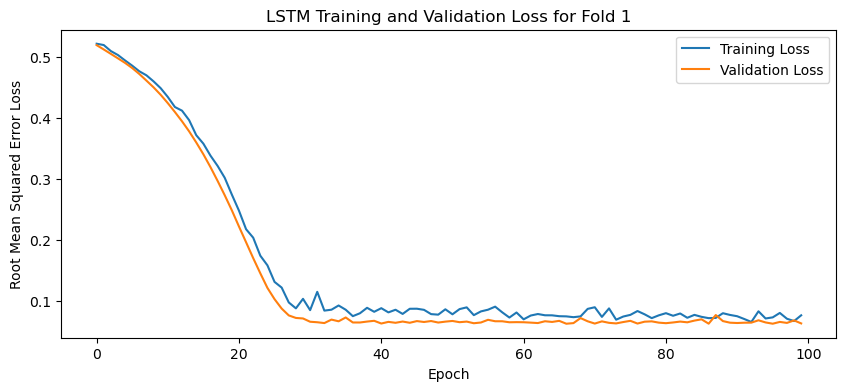

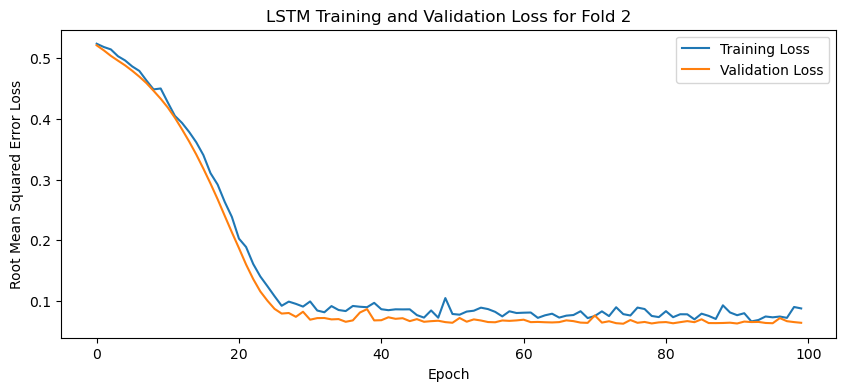

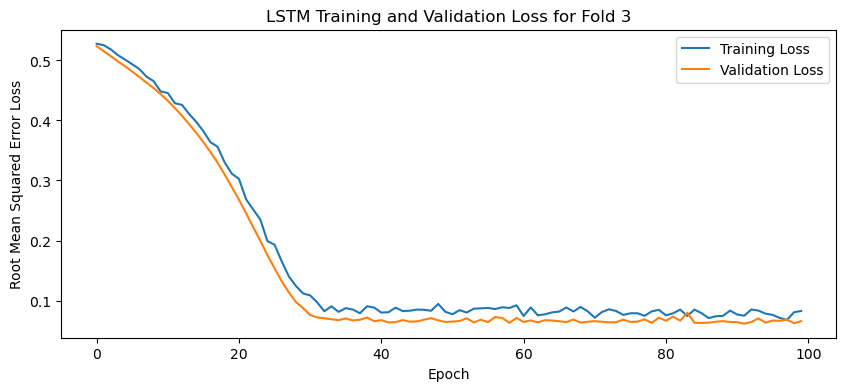

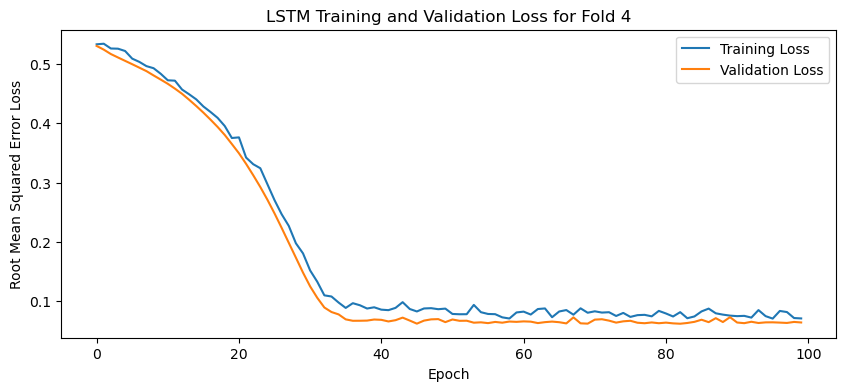

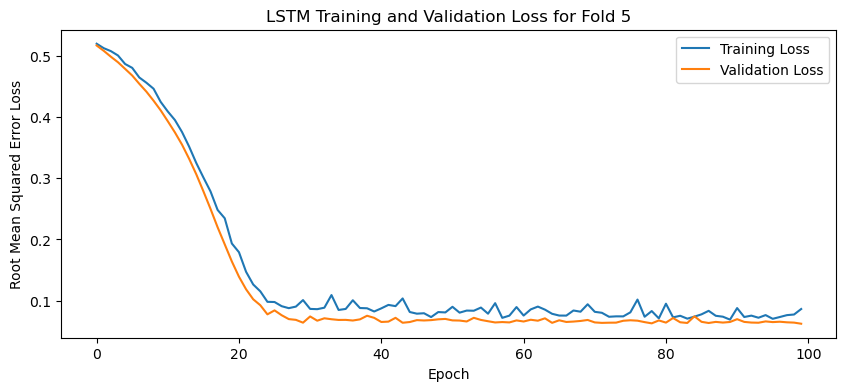

[I 2025-05-09 22:08:33,799] Trial 87 finished with value: 0.047299855202436444 and parameters: {'lr': 0.04415316141182958, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.45320718503394875}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04670008644461632, 0.04977972432971001, 0.04646366462111473, 0.049850452691316605, 0.043705347925424576]
Mean Cross Validation Accuracy:
0.047299855202436444
Standard Deviation of Cross Validation Accuracy:
0.002308017255322232


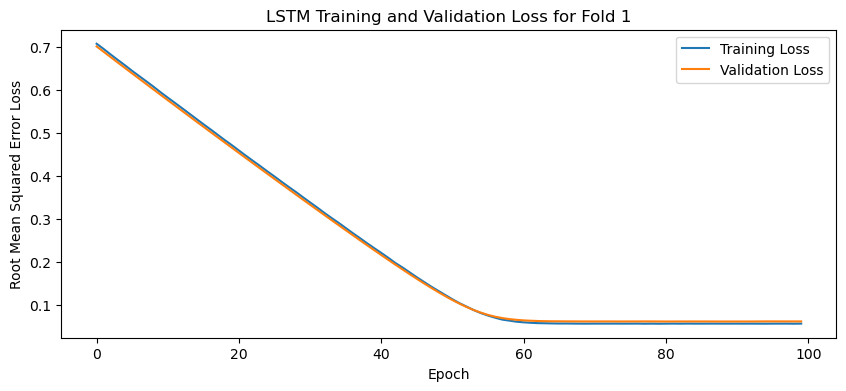

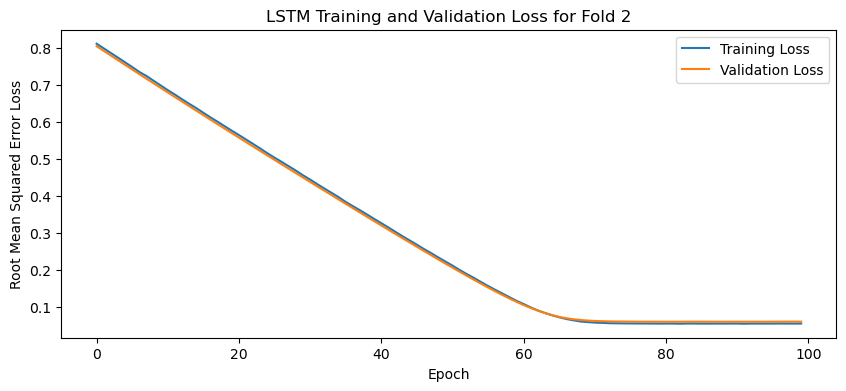

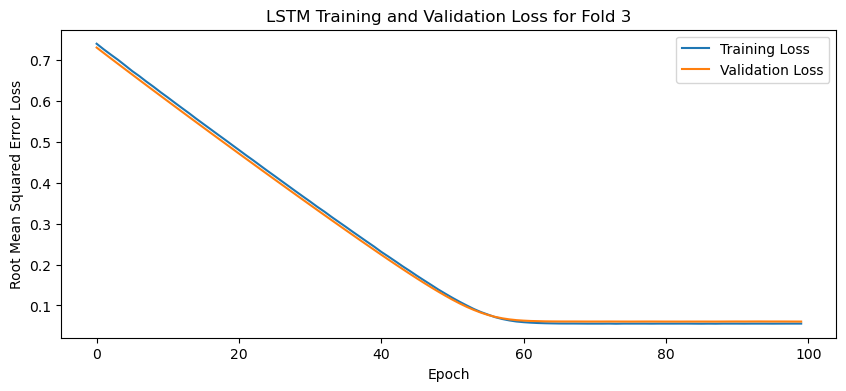

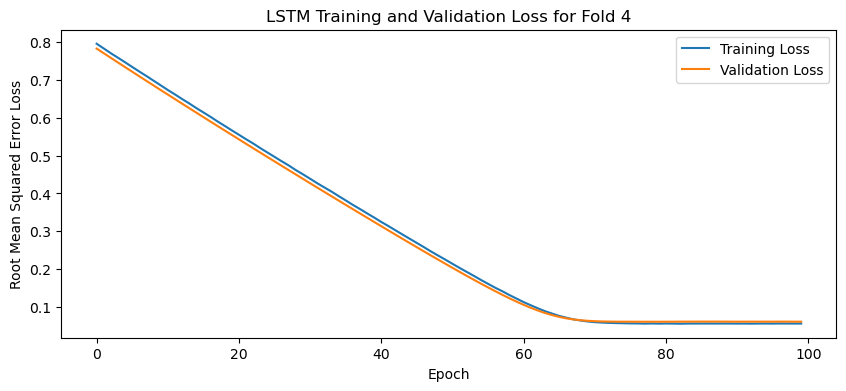

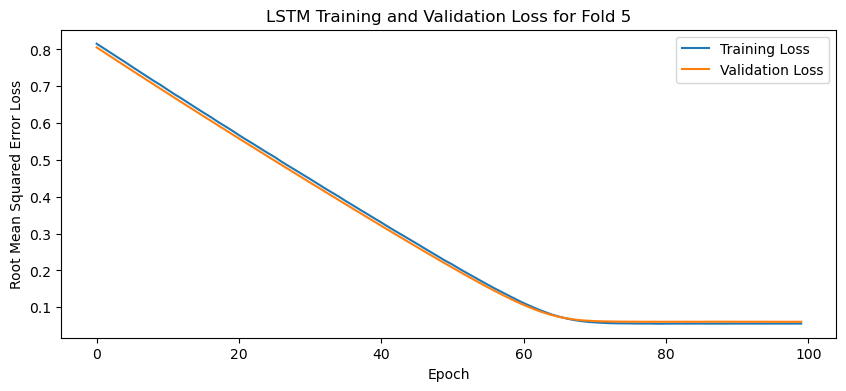

[I 2025-05-09 22:10:17,330] Trial 88 finished with value: 0.0425928995013237 and parameters: {'lr': 0.0060573048649183465, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.22465033342098958}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04239421710371971, 0.04235656559467316, 0.042726293206214905, 0.04275855794548988, 0.042728863656520844]
Mean Cross Validation Accuracy:
0.0425928995013237
Standard Deviation of Cross Validation Accuracy:
0.00017835428936642506


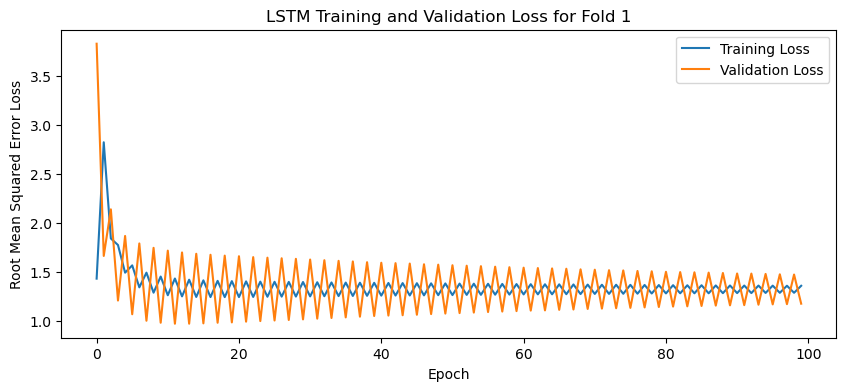

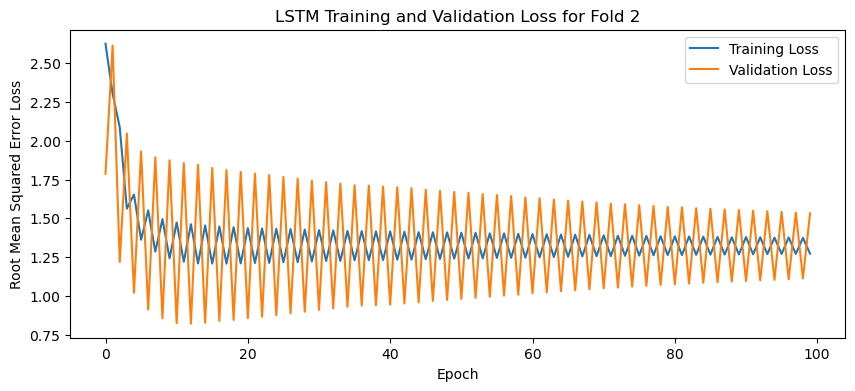

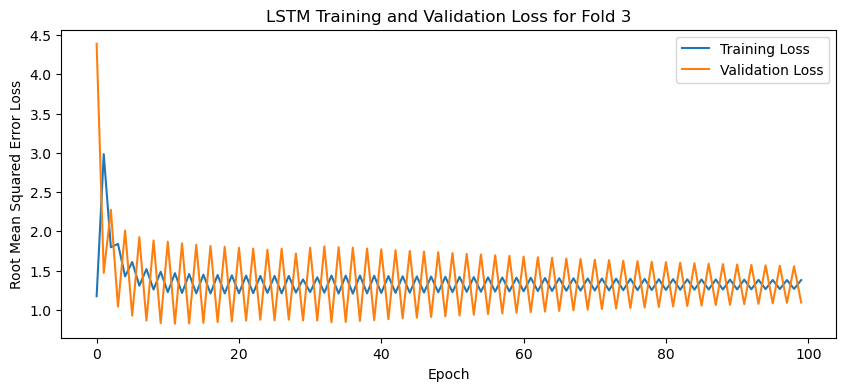

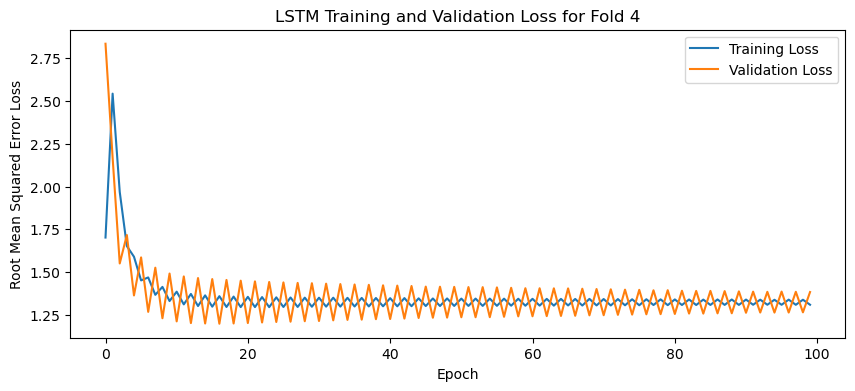

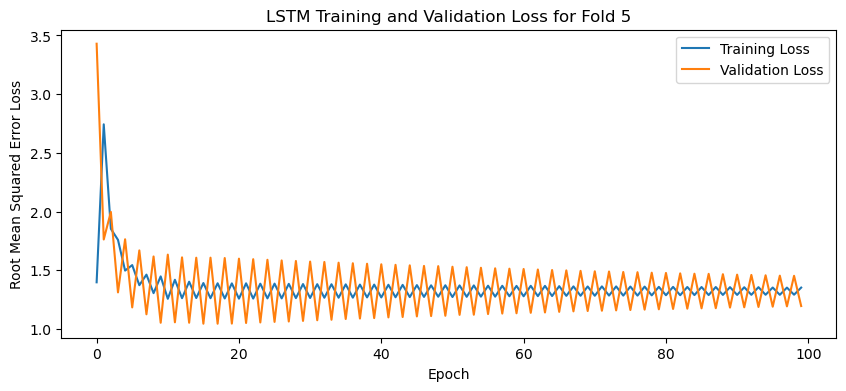

[I 2025-05-09 22:14:54,310] Trial 89 finished with value: 1.2785155773162842 and parameters: {'lr': 0.020502560757710106, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.4423872279545952}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[1.1777600049972534, 1.5407124757766724, 1.0885636806488037, 1.3847390413284302, 1.2008026838302612]
Mean Cross Validation Accuracy:
1.2785155773162842
Standard Deviation of Cross Validation Accuracy:
0.16266735387524156


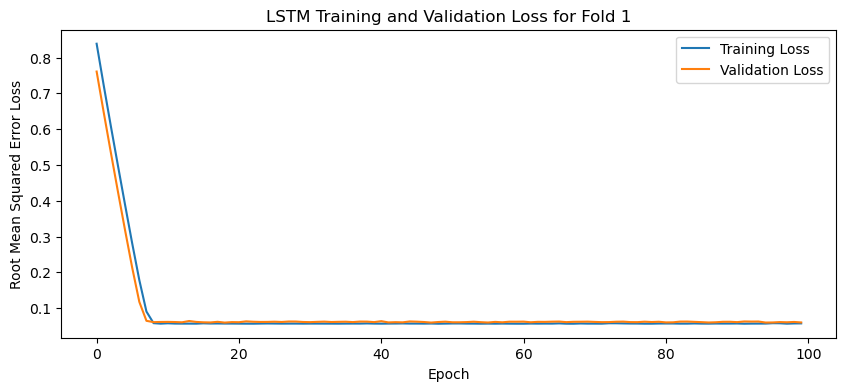

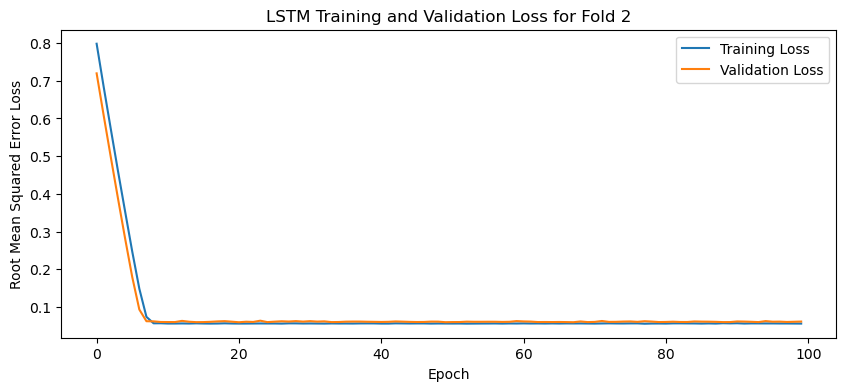

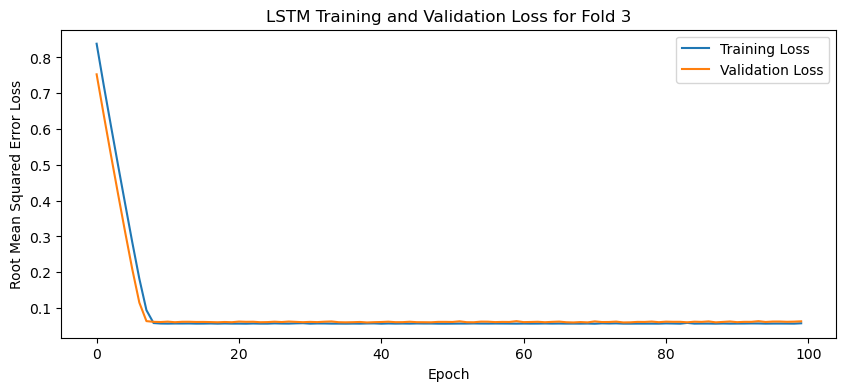

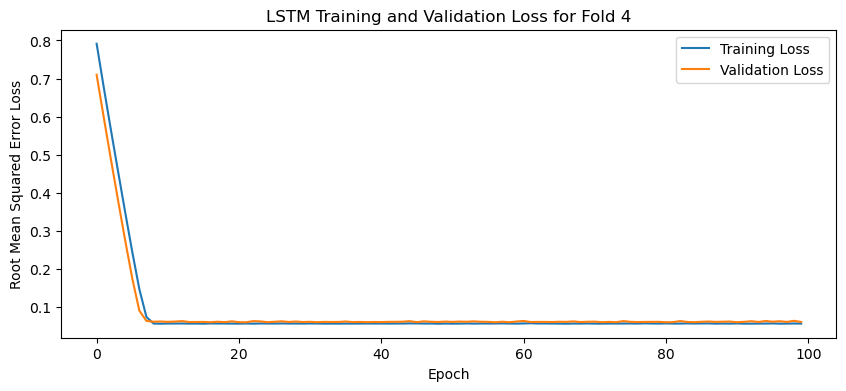

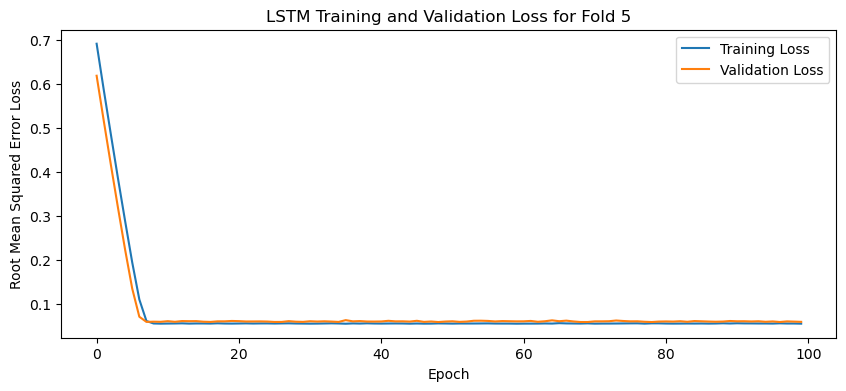

[I 2025-05-09 22:17:33,691] Trial 90 finished with value: 0.0431332640349865 and parameters: {'lr': 0.05392202208984217, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4181747892042064}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04565985128283501, 0.04168899729847908, 0.0402216874063015, 0.04418851062655449, 0.043907273560762405]
Mean Cross Validation Accuracy:
0.0431332640349865
Standard Deviation of Cross Validation Accuracy:
0.0019318107623100614


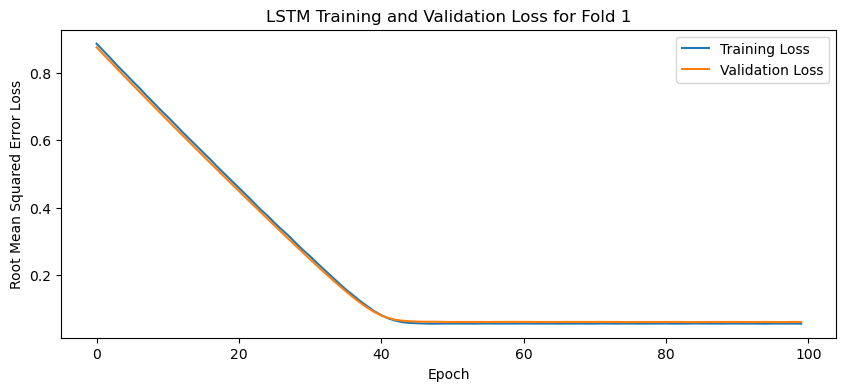

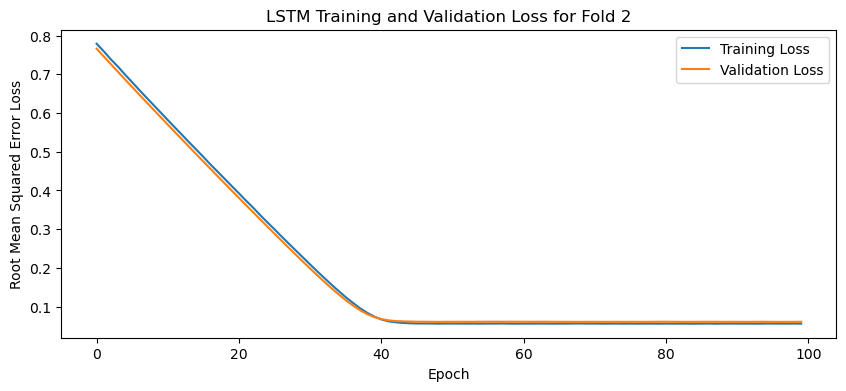

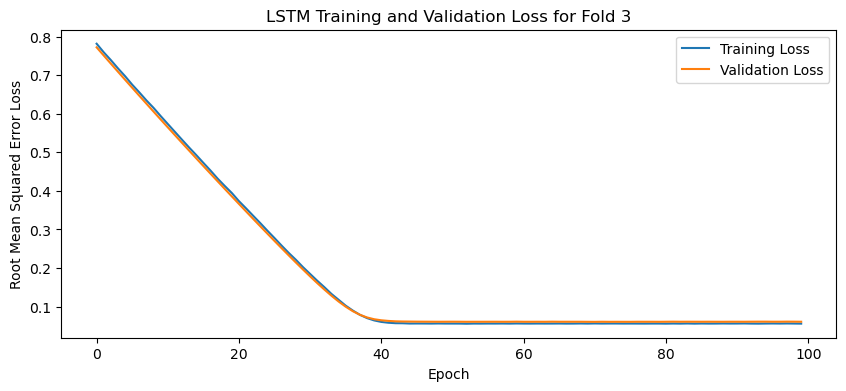

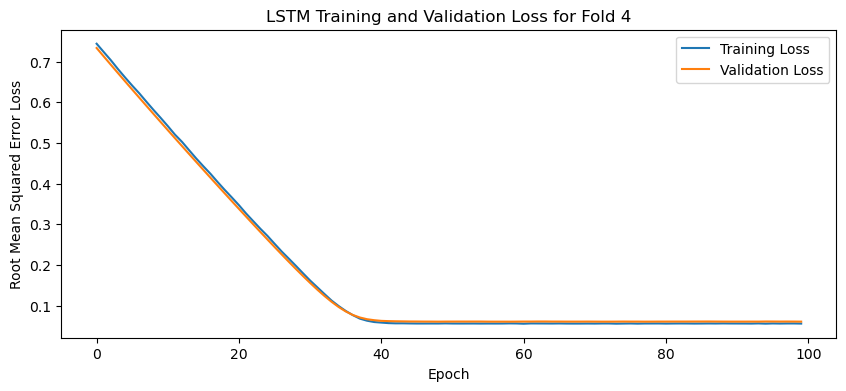

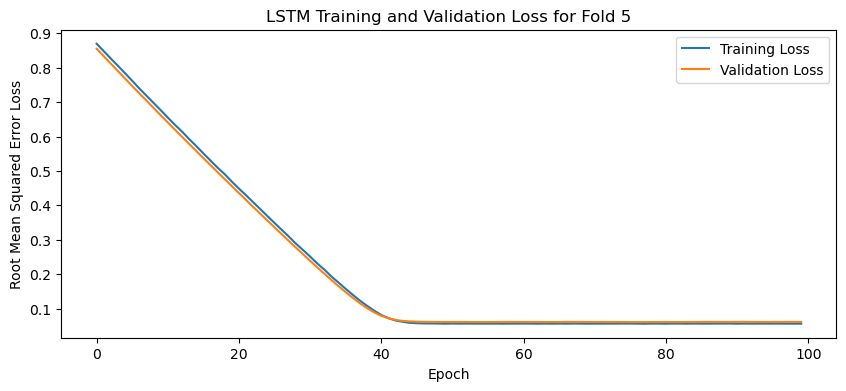

[I 2025-05-09 22:20:19,148] Trial 91 finished with value: 0.04243398308753967 and parameters: {'lr': 0.010135326373912481, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.49616963441656325}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04215151444077492, 0.0422167107462883, 0.04280119761824608, 0.04263849928975105, 0.042361993342638016]
Mean Cross Validation Accuracy:
0.04243398308753967
Standard Deviation of Cross Validation Accuracy:
0.00024853640319995893


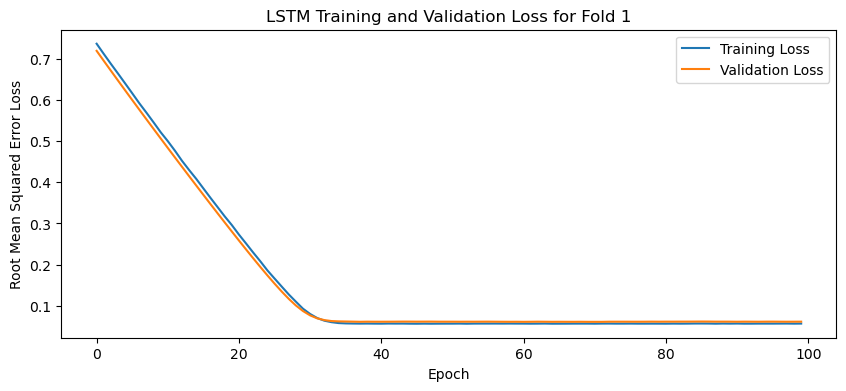

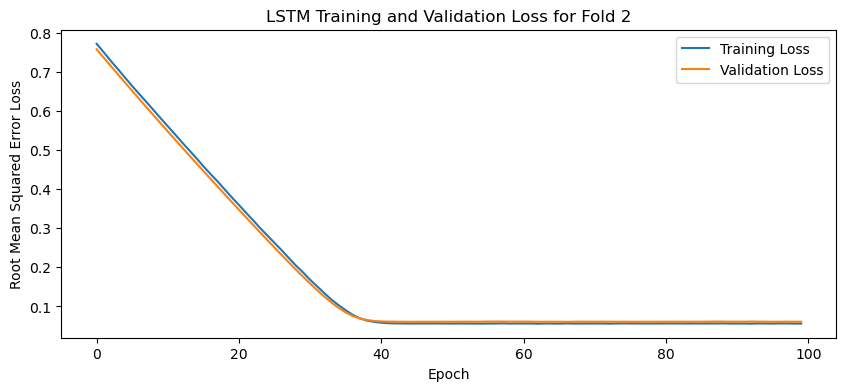

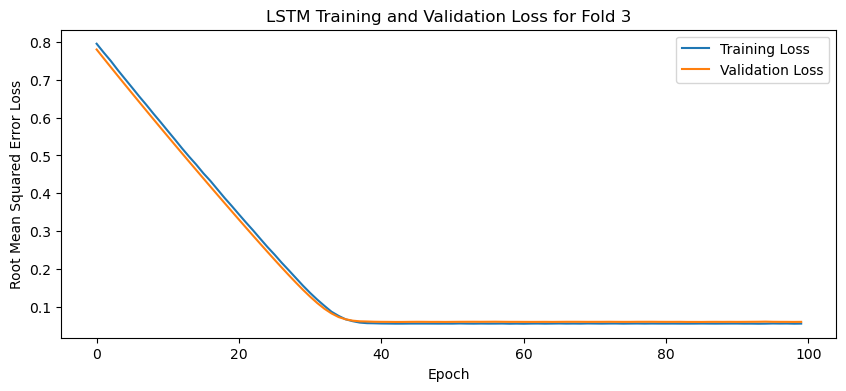

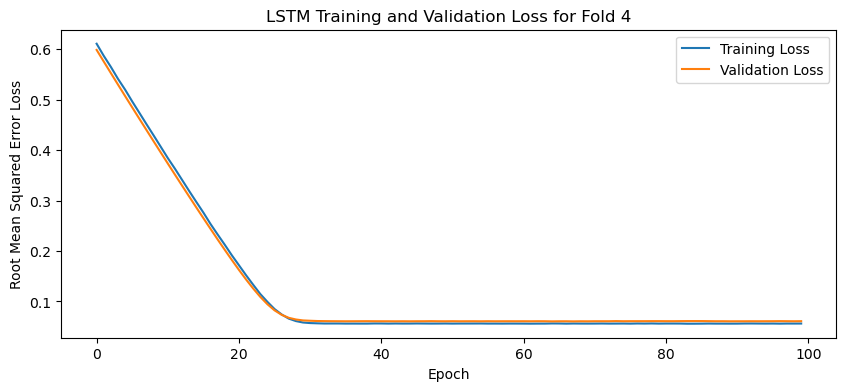

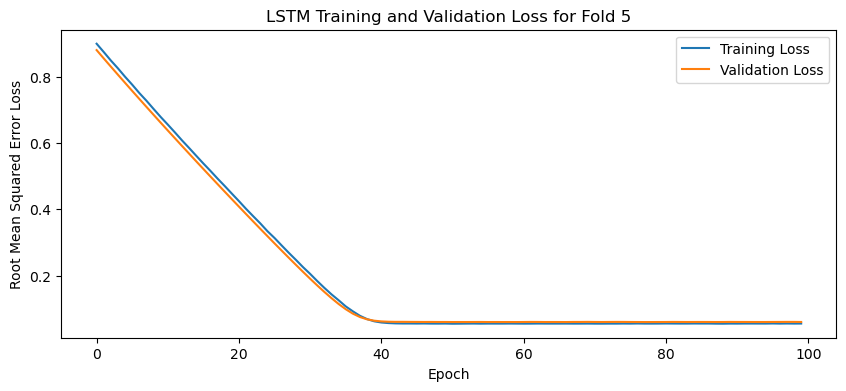

[I 2025-05-09 22:23:17,778] Trial 92 finished with value: 0.04258594289422035 and parameters: {'lr': 0.01166888108388743, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.49025190445565153}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04269375279545784, 0.042565200477838516, 0.04265892505645752, 0.04250715300440788, 0.04250468313694]
Mean Cross Validation Accuracy:
0.04258594289422035
Standard Deviation of Cross Validation Accuracy:
7.770535829262867e-05


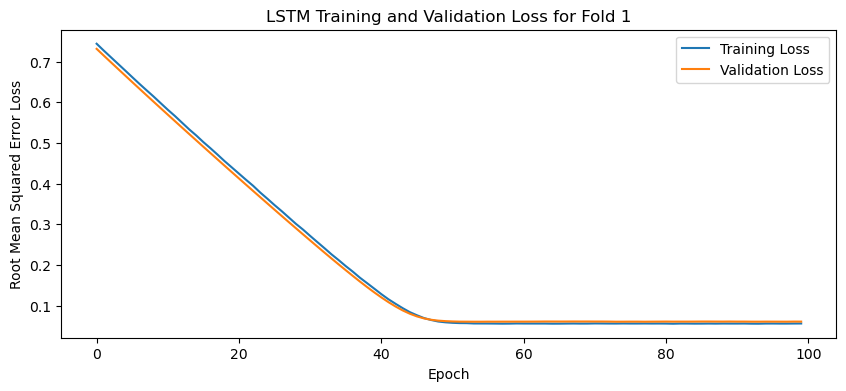

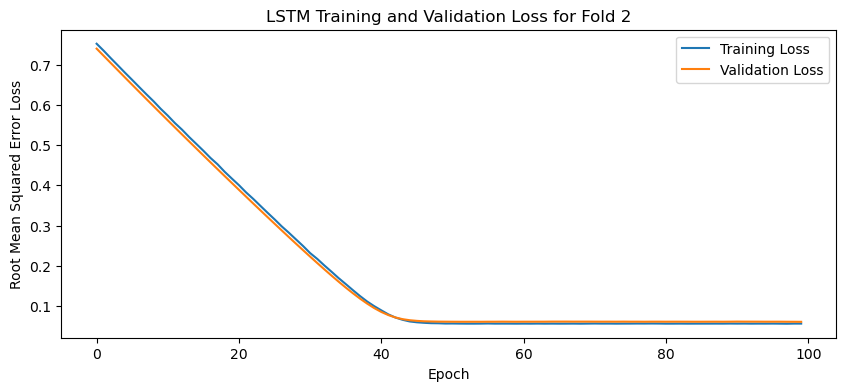

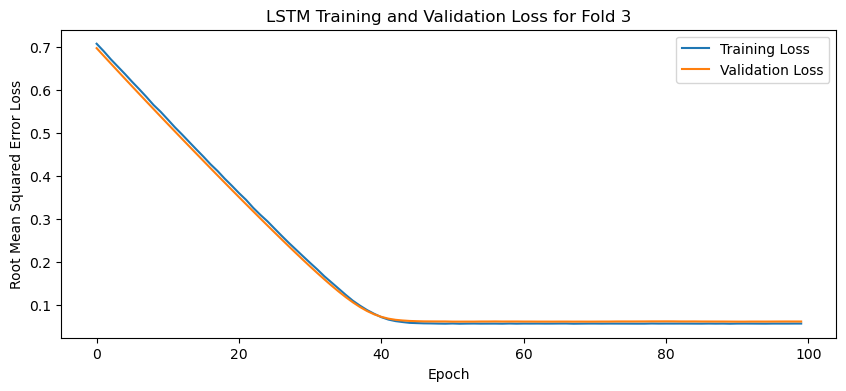

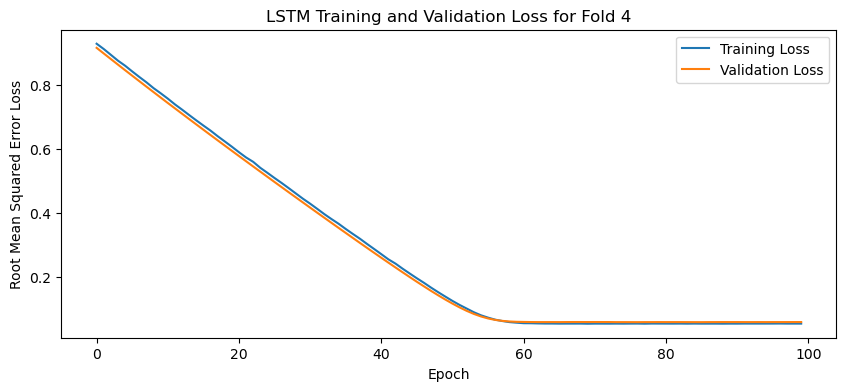

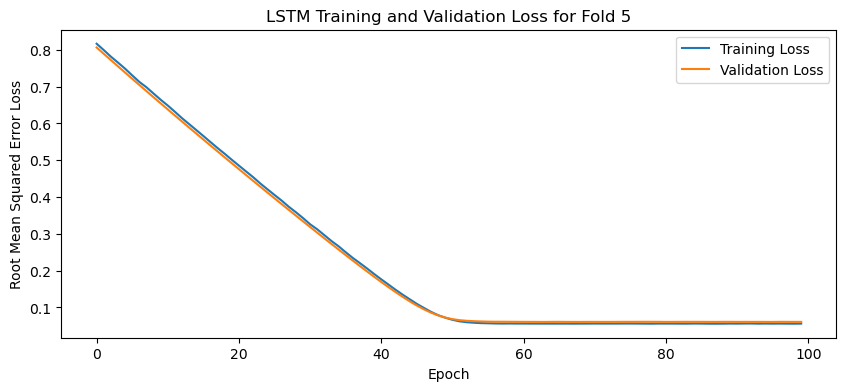

[I 2025-05-09 22:26:15,485] Trial 93 finished with value: 0.042689725011587146 and parameters: {'lr': 0.008479897958823543, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.47399069869735105}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04290119186043739, 0.043203845620155334, 0.042404353618621826, 0.0423104390501976, 0.04262879490852356]
Mean Cross Validation Accuracy:
0.042689725011587146
Standard Deviation of Cross Validation Accuracy:
0.00032803822283589915


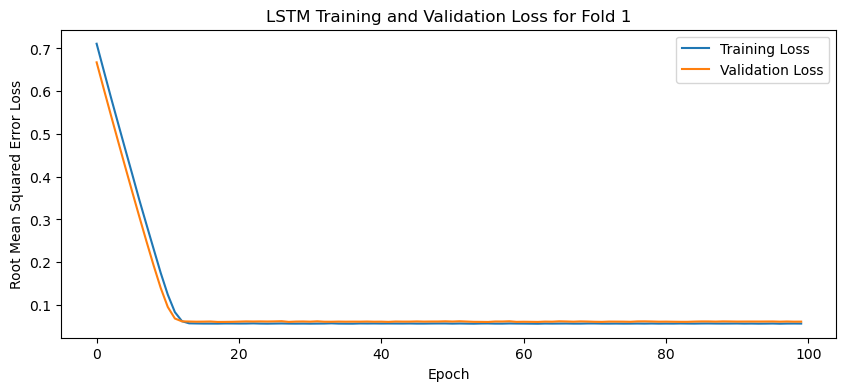

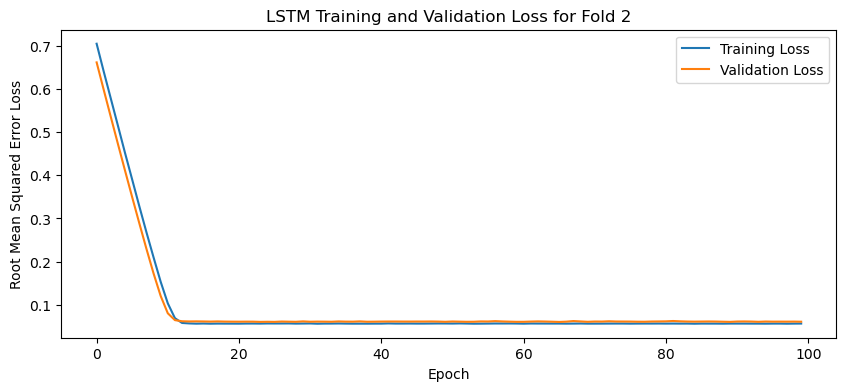

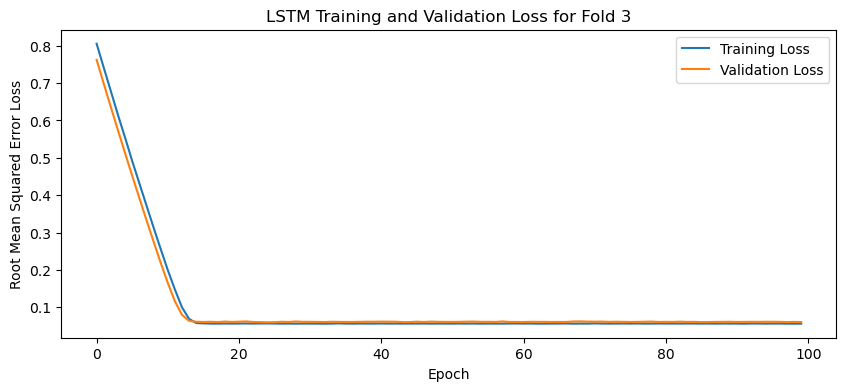

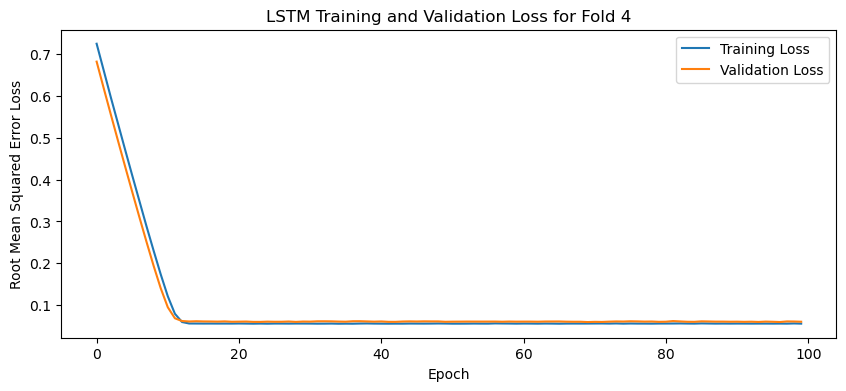

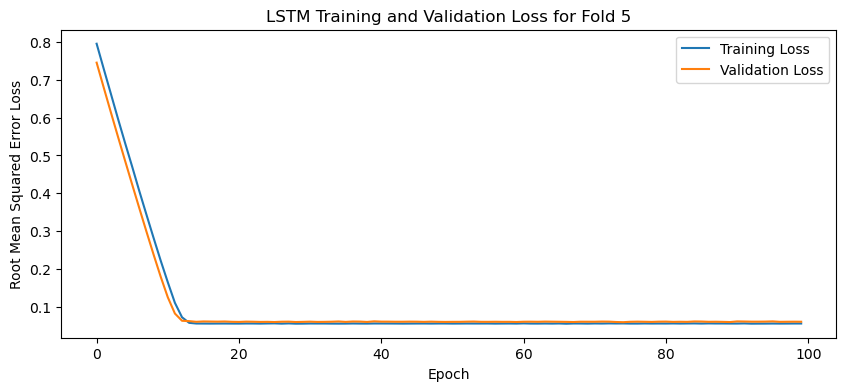

[I 2025-05-09 22:28:57,918] Trial 94 finished with value: 0.04319249838590622 and parameters: {'lr': 0.032259551626289754, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4641351342356043}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04277931526303291, 0.043641164898872375, 0.044019848108291626, 0.04332058131694794, 0.042201582342386246]
Mean Cross Validation Accuracy:
0.04319249838590622
Standard Deviation of Cross Validation Accuracy:
0.0006410693158380415


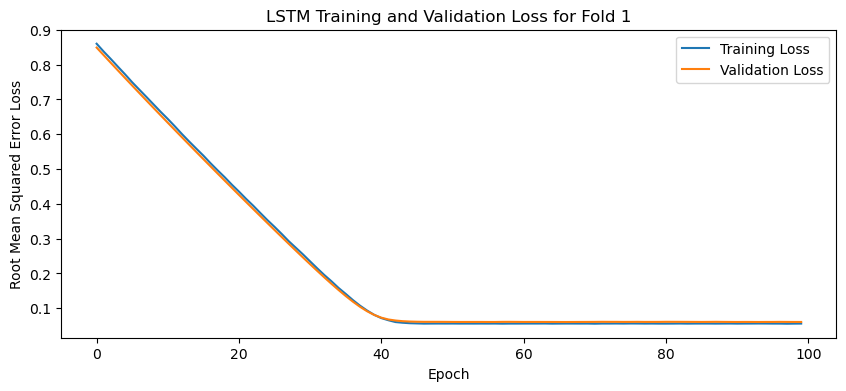

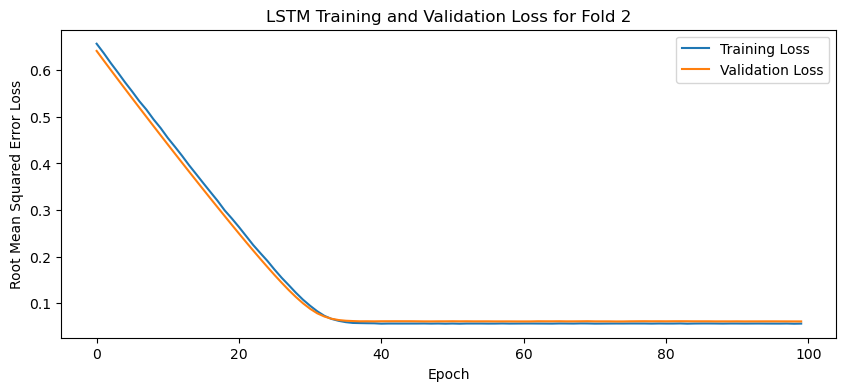

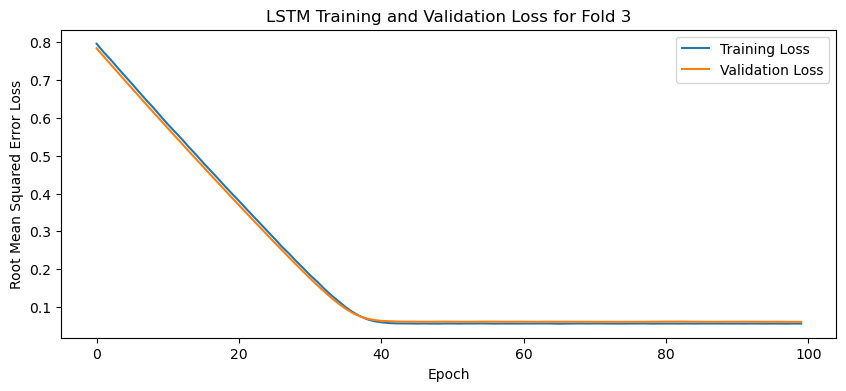

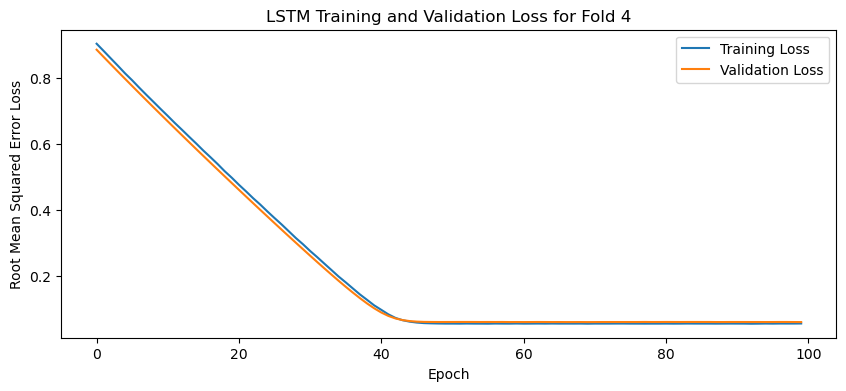

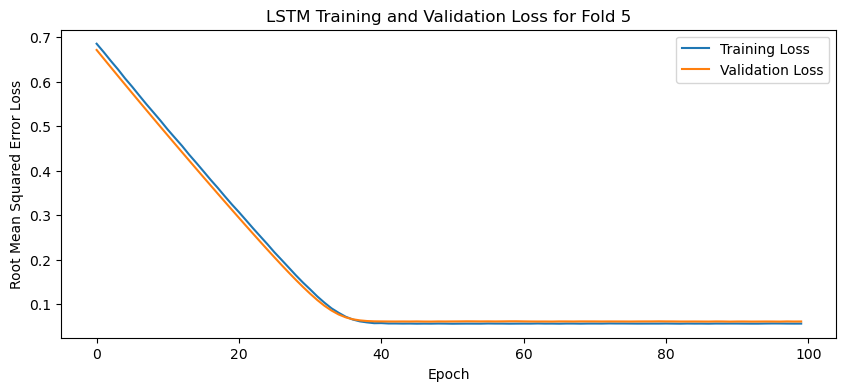

[I 2025-05-09 22:32:33,128] Trial 95 finished with value: 0.04286871999502182 and parameters: {'lr': 0.010394365203781099, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4809745569674297}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04283076897263527, 0.042871441692113876, 0.04297579079866409, 0.043008819222450256, 0.042656779289245605]
Mean Cross Validation Accuracy:
0.04286871999502182
Standard Deviation of Cross Validation Accuracy:
0.00012446565873268999


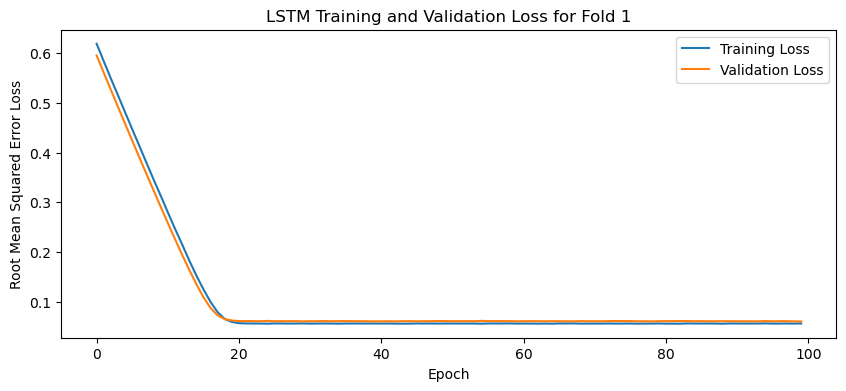

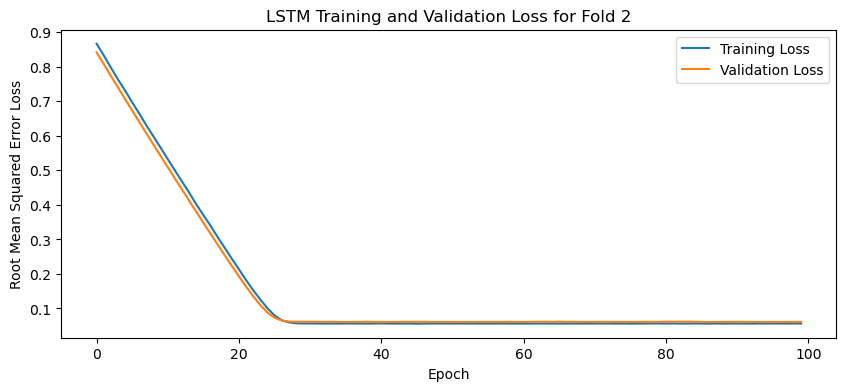

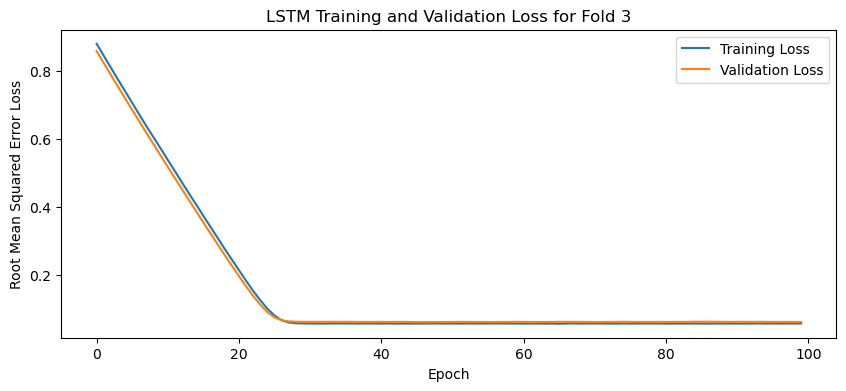

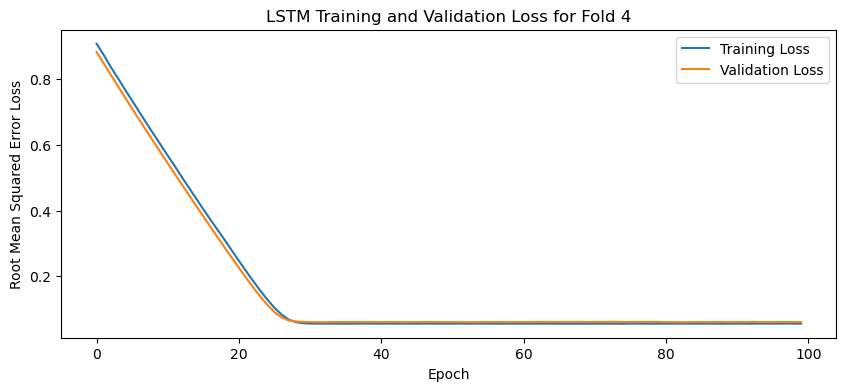

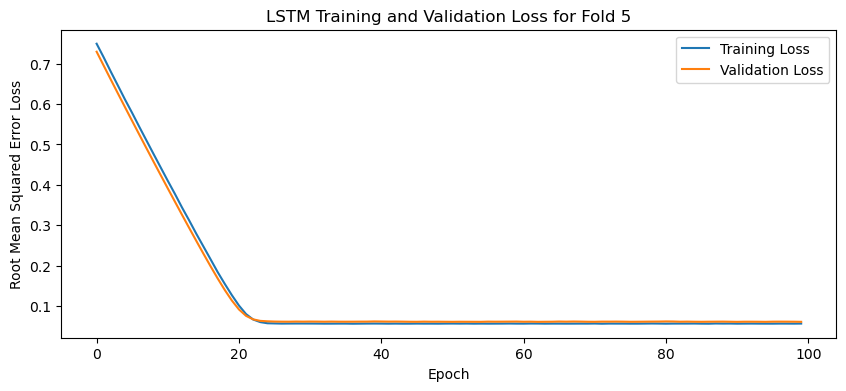

[I 2025-05-09 22:35:20,852] Trial 96 finished with value: 0.04307530000805855 and parameters: {'lr': 0.017106060750551686, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.437628470066915}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.0434076152741909, 0.04228375107049942, 0.043229687958955765, 0.0429643876850605, 0.04349105805158615]
Mean Cross Validation Accuracy:
0.04307530000805855
Standard Deviation of Cross Validation Accuracy:
0.0004349655366091816


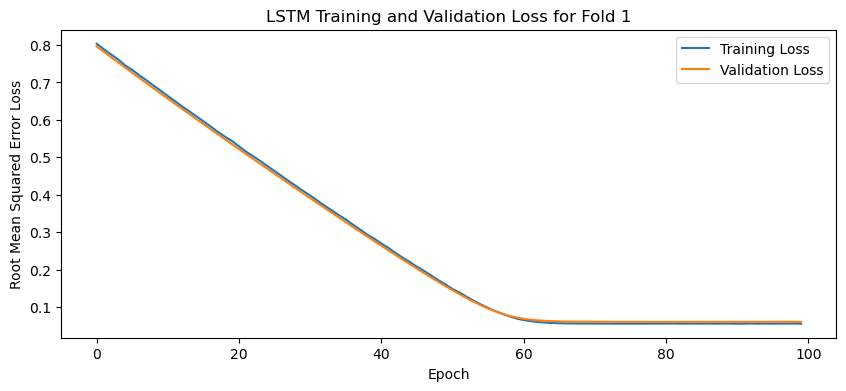

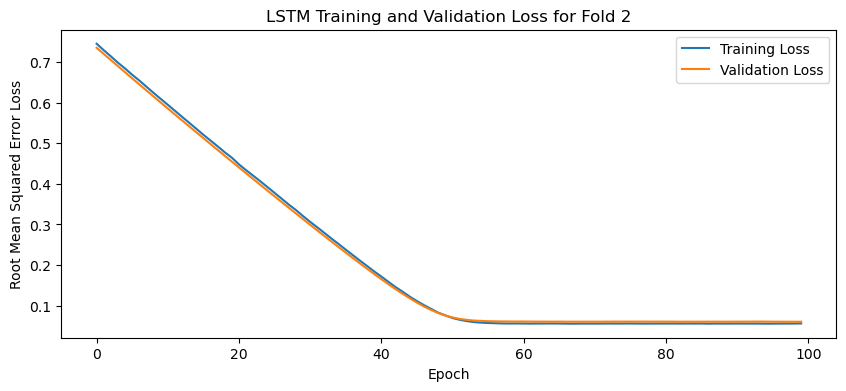

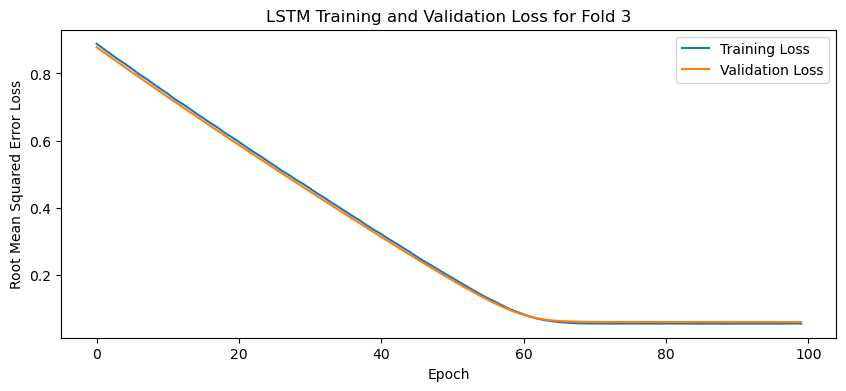

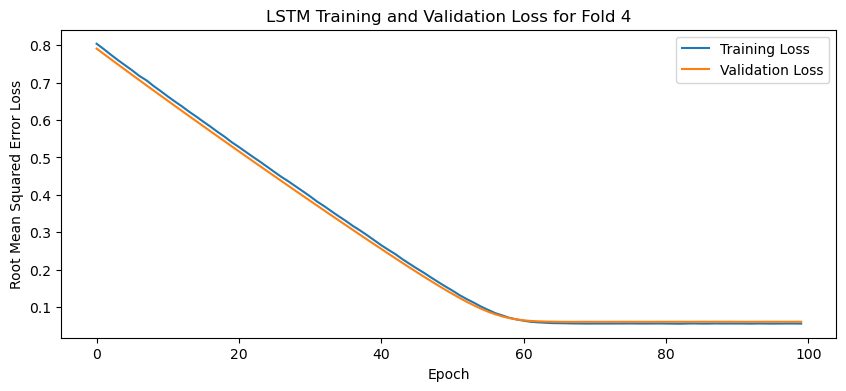

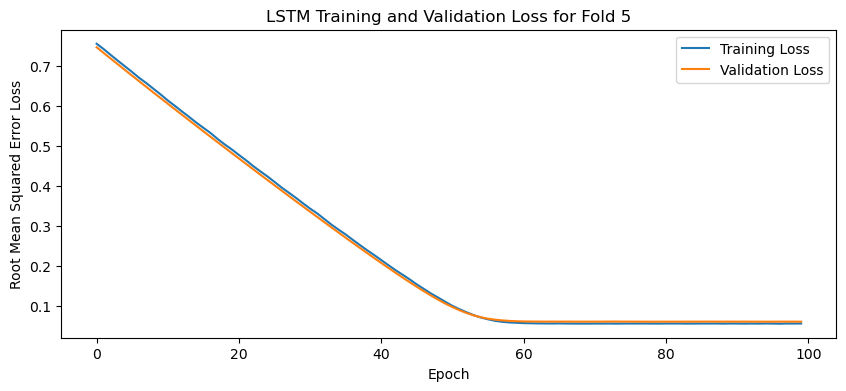

[I 2025-05-09 22:37:28,103] Trial 97 finished with value: 0.04280957952141762 and parameters: {'lr': 0.007035606243735894, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 512, 'dropout_rate': 0.45553164874043034}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04244334250688553, 0.043042972683906555, 0.043150387704372406, 0.04262378439307213, 0.04278741031885147]
Mean Cross Validation Accuracy:
0.04280957952141762
Standard Deviation of Cross Validation Accuracy:
0.0002606773637806879


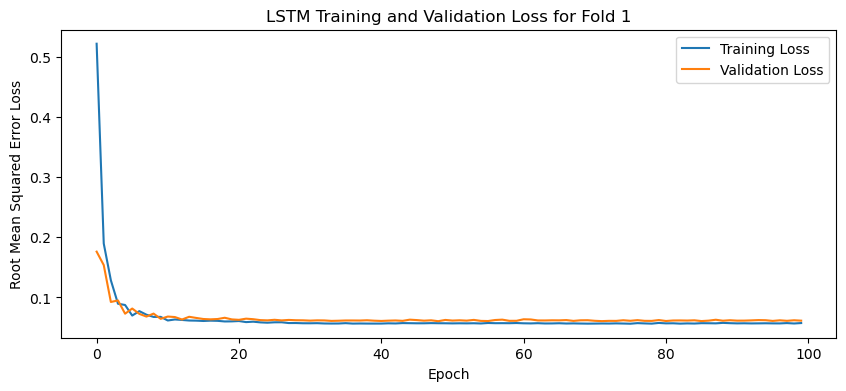

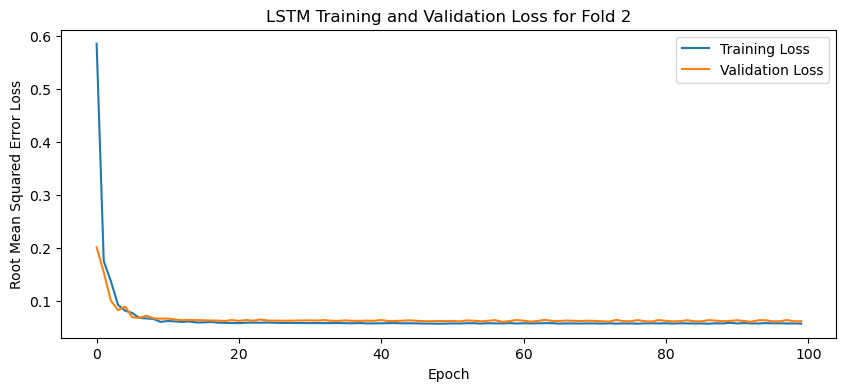

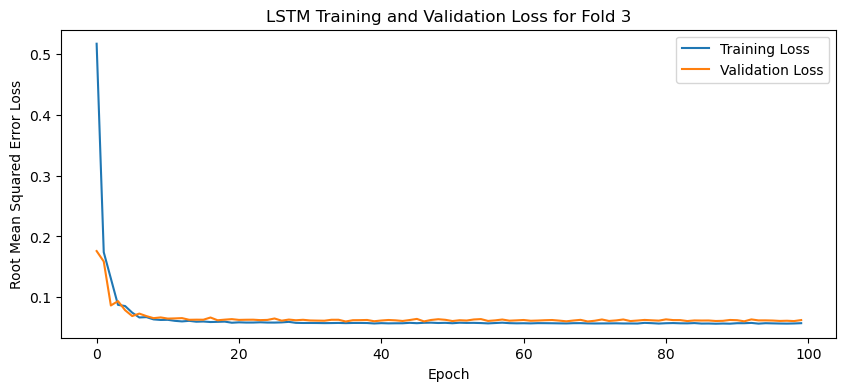

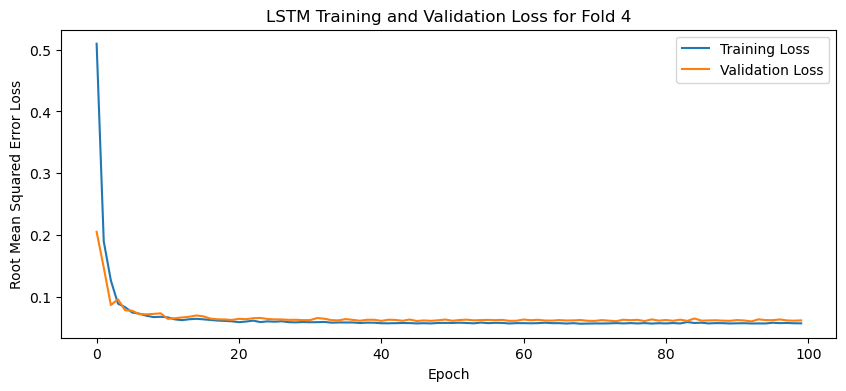

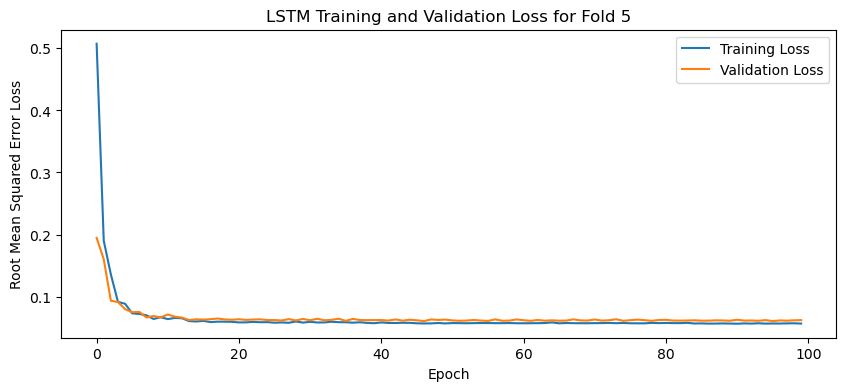

[I 2025-05-09 22:41:15,674] Trial 98 finished with value: 0.042359568923711774 and parameters: {'lr': 0.004716974286779543, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.40339794755081654}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.043260954320430756, 0.04353375732898712, 0.04053393006324768, 0.0424630343914032, 0.04200616851449013]
Mean Cross Validation Accuracy:
0.042359568923711774
Standard Deviation of Cross Validation Accuracy:
0.0010639331036846787


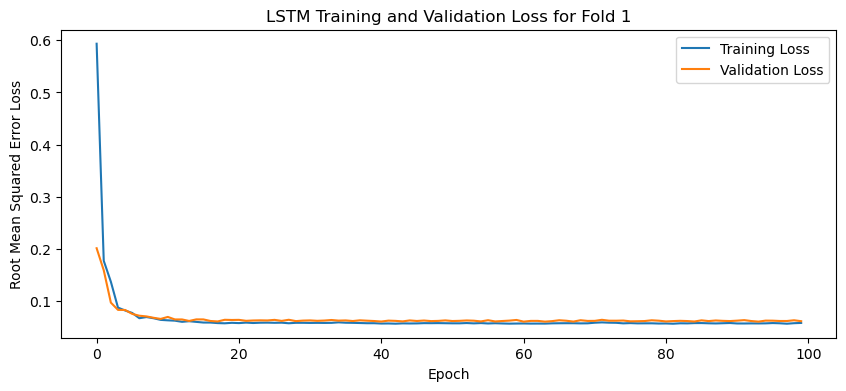

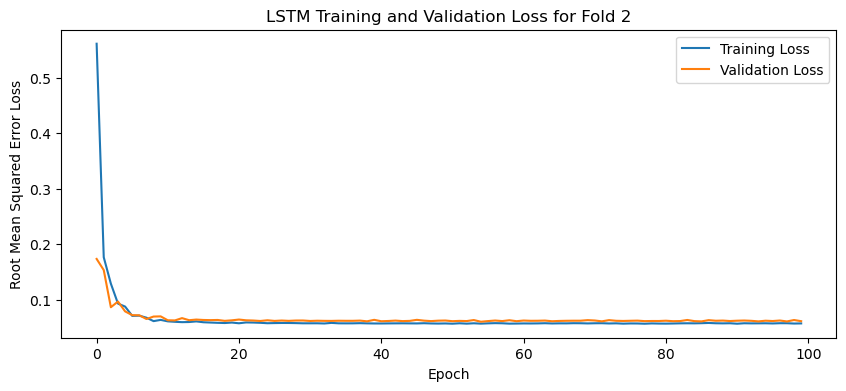

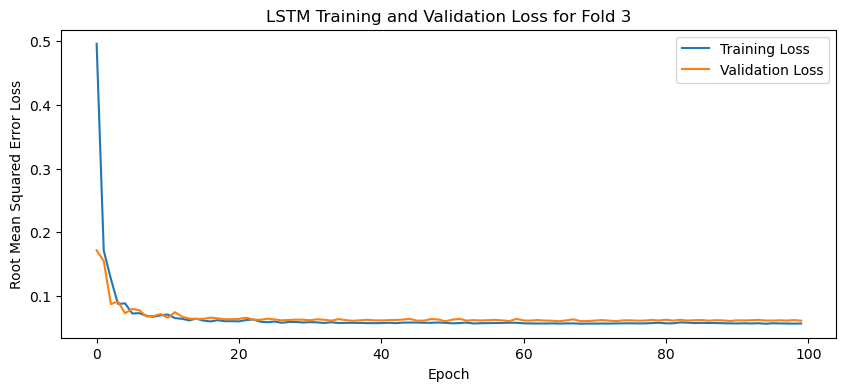

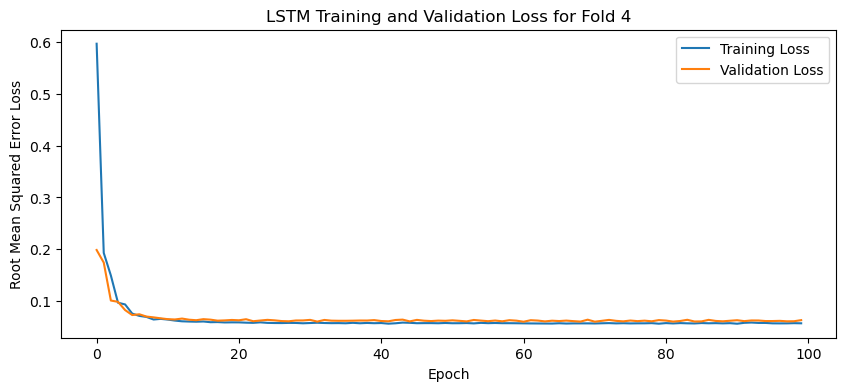

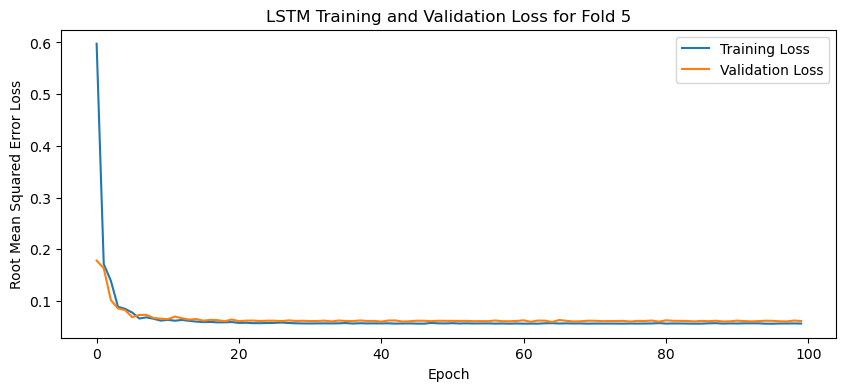

[I 2025-05-09 22:44:47,754] Trial 99 finished with value: 0.04346418976783752 and parameters: {'lr': 0.004421219246503716, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.40218212124005265}. Best is trial 25 with value: 0.042280546575784686.


Cross Validation Accuracies:
[0.04524518549442291, 0.044286828488111496, 0.04381989687681198, 0.04164057597517967, 0.04232846200466156]
Mean Cross Validation Accuracy:
0.04346418976783752
Standard Deviation of Cross Validation Accuracy:
0.0013107747790070583
Number of finished trials: 100
Best trial: {'lr': 0.021628368036700416, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4669824117789497}
Best hyperparameters:  {'lr': 0.021628368036700416, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.4669824117789497}


TypeError: create_model() missing 1 required positional argument: 'nb_epoch'

In [28]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    #filters = trial.suggest_categorical('filters', [64, 128, 256]) #Used for CNN-LSTM model later
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    #model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        plt.figure(figsize=(10, 4))
        plt.plot(history.history['loss'], label='Training Loss')
        plt.plot(history.history['val_loss'], label='Validation Loss')
        title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        plt.title(title1)
        plt.xlabel('Epoch')
        plt.ylabel('Root Mean Squared Error Loss')
        plt.legend()
        plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)
best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

# Plotting the training and validation loss
plt.figure(figsize=(10, 4))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
title1 = "LSTM Training and Validation Loss for Best Model"
plt.title(title1)
plt.xlabel('Epoch')
plt.ylabel('Root Mean Squared Error Loss')
plt.legend()
plt.show()

Epoch 1/100
84/84 [==============================] - 9s 49ms/step - loss: 0.2677 - val_loss: 0.0604
Epoch 2/100
84/84 [==============================] - 3s 37ms/step - loss: 0.0564 - val_loss: 0.0613
Epoch 3/100
84/84 [==============================] - 3s 37ms/step - loss: 0.0569 - val_loss: 0.0602
Epoch 4/100
84/84 [==============================] - 3s 37ms/step - loss: 0.0563 - val_loss: 0.0610
Epoch 5/100
84/84 [==============================] - 3s 39ms/step - loss: 0.0569 - val_loss: 0.0628
Epoch 6/100
84/84 [==============================] - 3s 38ms/step - loss: 0.0562 - val_loss: 0.0645
Epoch 7/100
84/84 [==============================] - 3s 38ms/step - loss: 0.0566 - val_loss: 0.0689
Epoch 8/100
84/84 [==============================] - 3s 37ms/step - loss: 0.0558 - val_loss: 0.0655
Epoch 9/100
84/84 [==============================] - 3s 38ms/step - loss: 0.0567 - val_loss: 0.0624
Epoch 10/100
84/84 [==============================] - 3s 38ms/step - loss: 0.0567 - val_loss: 0.0593

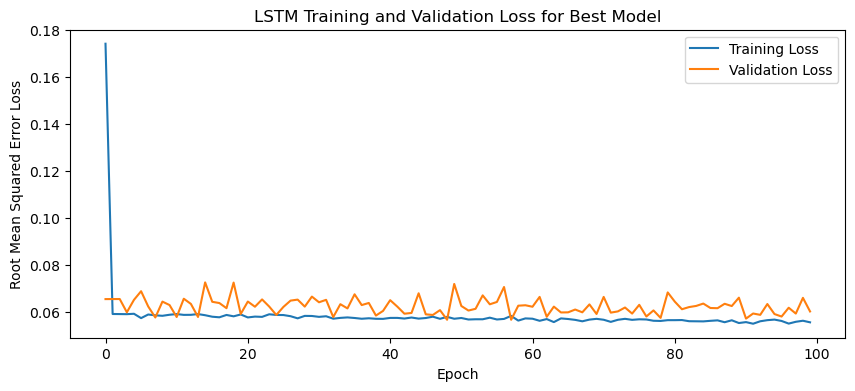

In [29]:
best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

# Plotting the training and validation loss
plt.figure(figsize=(10, 4))
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
title1 = "LSTM Training and Validation Loss for Best Model"
plt.title(title1)
plt.xlabel('Epoch')
plt.ylabel('Root Mean Squared Error Loss')
plt.legend()
plt.show()

In [30]:
print(X.shape)

(84, 1, 1980)


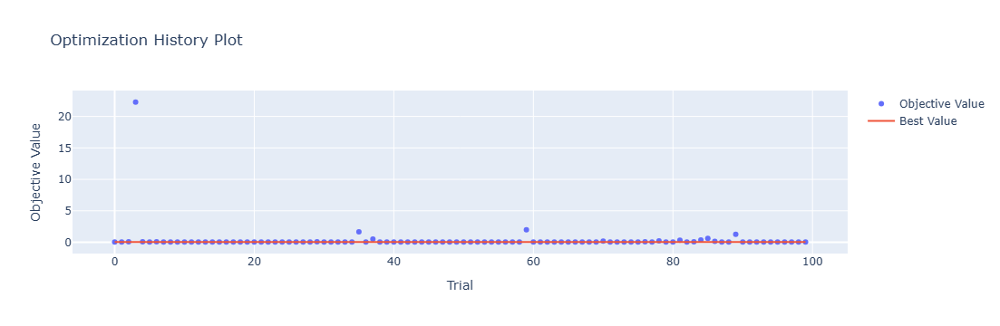

In [31]:
optuna.visualization.plot_optimization_history(study)

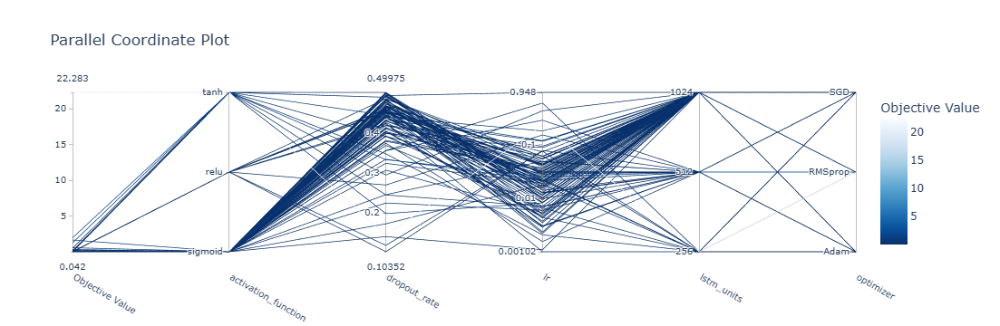

In [32]:
optuna.visualization.plot_parallel_coordinate(study)

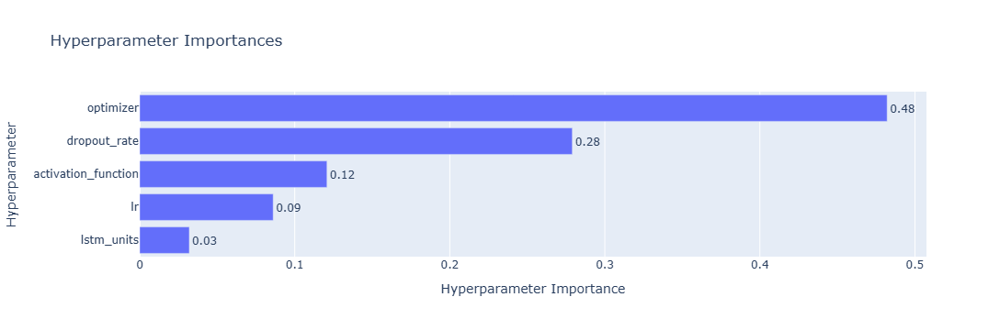

In [33]:
optuna.visualization.plot_param_importances(study)

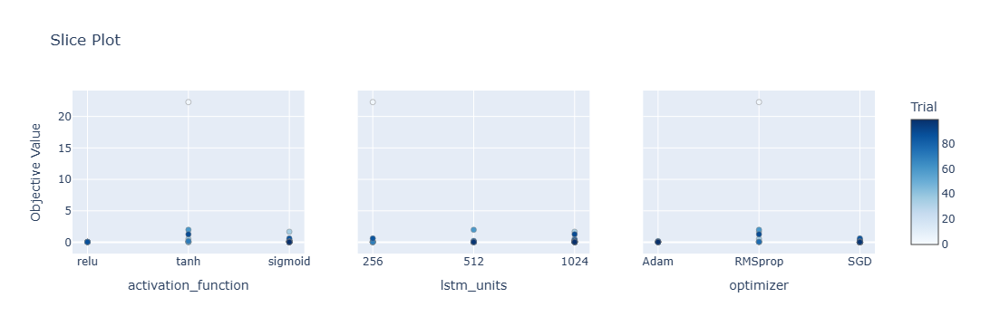

In [34]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

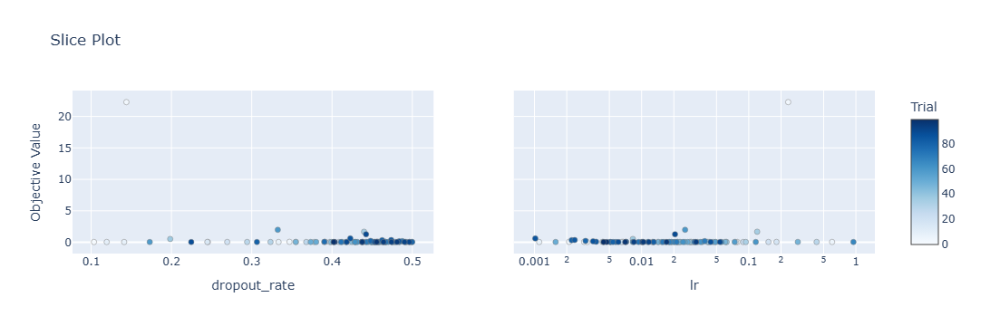

In [35]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from best model
    lr = 0.021628368036700416
    optimizer = SGD(learning_rate = lr)
    activation_function = 'sigmoid'
    lstm_units = 1024
    dropout_rate = 0.4669824117789497

    # design network
    model = Sequential()
    #model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# make one forecast with an LSTM,
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
n_batch = 1
n_test = 11
nb_epoch = 100
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    #print("Forecasts:")
    #print(forecasts)
    #print("Actual:")
    #print(actual)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    # plot forecasts
    plot_forecasts(series, forecasts, n_test+2)
    best_model.summary()

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('LSTM Training and Validation Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

    # Plot training & validation accuracy
    plt.subplot(1, 2, 2)
    plt.plot(history.history['accuracy'], label='Training Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title('Model Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(['Training', 'Validation'])
    plt.tight_layout()

In [ ]:
# Extract the dates corresponding to the test set predictions
test_dates = df.index[-len(actual[0]):]

# Print out plots of actual and predicted values for each weather station
for j in range(11):
    print("Weather Station "+str(j+1)+":")
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'Month': test_dates,
        'Actual': actual[j],
        'Predicted': forecasts[j]
    })
            
    # Plotting the results
    plt.figure(figsize=(15, 6))
    plt.plot(results_df['Month'], results_df['Actual'], label='Actual Temp')
    plt.plot(results_df['Month'], results_df['Predicted'], label='Predicted Temp', alpha=0.7)
    plt.title('LSTM Model Comparison Temperature Prediction')
    plt.xlabel('Month')
    plt.ylabel('Temperature')
    plt.legend()
    plt.show()

    # Plot model architecture
    filename = "lstm_model_optimized_ws_"+str(j)+".png"
    plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)

In [ ]:
print(np.mean(rmse))
print(np.std(rmse))

In [13]:
print(len(actual))
print(len(actual[0]))
print(len(forecasts))
print(len(forecasts[0]))

11
60
11
60
